In [1]:
# L2 only loss landscape
# TODO -
# Repeat with actual HDX data
import os


os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"
import jax

jax.config.update("jax_platform_name", "cpu")
os.environ["JAX_PLATFORM_NAME"] = "cpu"

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from jaxent.src.data.splitting.sparse_map import apply_sparse_mapping,create_sparse_map
from tqdm.auto import tqdm
import jax.numpy as jnp
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from MDAnalysis import Universe
import jax
from jaxent.src.types.config import FeaturiserSettings, OptimiserSettings

from jaxent.src.data.loader import Dataset, ExpD_Dataloader, ExpD_Datapoint
from jaxent.src.interfaces.builder import Experiment_Builder
from jaxent.src.interfaces.simulation import Simulation_Parameters
from jaxent.src.models.core import Simulation   

from jaxent.src.types.HDX import HDX_peptide, HDX_protection_factor


from jaxent.src.featurise import run_featurise


from jaxent.src.models.func.common import find_common_residues
from jaxent.src.models.HDX.BV.features import BV_input_features
from jaxent.src.models.HDX.BV.forwardmodel import BV_model, BV_model_Config, linear_BV_model, linear_BV_model_Config
from jaxent.src.opt.losses import (
    hdx_uptake_l2_loss,
    hdx_pf_mae_loss,
    hdx_uptake_l2_loss,
    hdx_uptake_l1_loss,
    hdx_uptake_monotonicity_loss,
    mask_L0_loss,
    max_entropy_loss,
)
from jaxent.src.opt.optimiser import OptaxOptimizer, Optimisable_Parameters
from jaxent.src.opt.run import run_optimise
from jaxent.src.data.splitting.split import DataSplitter


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:

def plot_split_visualization(train_data, val_data, exp_data):
    """
    Create a visualization of the train/validation split along residue indices.
    """
    plt.figure(figsize=(12, 6))

    # Get residue indices for each dataset
    train_residues = [d.top.residue_start for d in train_data]
    val_residues = [d.top.residue_start for d in val_data]
    all_residues = [d.top.residue_start for d in exp_data]

    # Create boolean masks for plotting
    residue_range = np.arange(min(all_residues), max(all_residues) + 1)
    train_mask = np.isin(residue_range, train_residues)
    val_mask = np.isin(residue_range, val_residues)

    # Plot residue coverage
    plt.scatter(
        residue_range[train_mask],
        np.ones_like(residue_range[train_mask]),
        label="Training",
        alpha=0.6,
        s=100,
    )
    plt.scatter(
        residue_range[val_mask],
        np.zeros_like(residue_range[val_mask]),
        label="Validation",
        alpha=0.6,
        s=100,
    )

    plt.yticks([0, 1], ["Validation", "Training"])
    plt.xlabel("Residue Index")
    plt.title("Train/Validation Split by Residue")
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    return plt.gcf()


def plot_total_losses(opt_history):
    """
    Plot training and validation loss components over optimization steps.
    """
    steps = range(len(opt_history.states))
    train_losses = [state.losses.total_train_loss for state in opt_history.states]
    val_losses = [state.losses.total_val_loss for state in opt_history.states]

    plt.figure(figsize=(10, 6))
    plt.plot(steps, train_losses, label="Training Loss", marker="o", markersize=3)
    plt.plot(steps, val_losses, label="Validation Loss", marker="o", markersize=3)

    plt.xlabel("Optimization Step")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss Over Time")
    plt.legend()
    plt.grid(True, alpha=0.3)
    # plt.yscale("log")
    plt.tight_layout()

    return plt.gcf()


def plot_loss_components(opt_history):
    """
    Plot training and validation loss components over optimization steps,
    showing both total loss and individual components on separate subplots.
    """
    steps = range(len(opt_history.states))

    # Get individual loss components
    train_components = np.array([state.losses.train_losses for state in opt_history.states])
    val_components = np.array([state.losses.val_losses for state in opt_history.states])
    scaled_train = np.array([state.losses.scaled_train_losses for state in opt_history.states])
    scaled_val = np.array([state.losses.scaled_val_losses for state in opt_history.states])
    total_train = np.array([state.losses.total_train_loss for state in opt_history.states])
    total_val = np.array([state.losses.total_val_loss for state in opt_history.states])

    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

    # Plot training losses
    colors = plt.cm.Set2(np.linspace(0, 1, train_components.shape[1]))

    ax1.set_title("Training Loss Components")
    # Plot individual components
    for i, color in enumerate(colors):
        ax1.plot(
            steps,
            train_components[:, i],
            label=f"Component {i + 1}",
            color=color,
            linestyle="--",
            alpha=0.7,
        )
        ax1.plot(
            steps, scaled_train[:, i], label=f"Scaled Component {i + 1}", color=color, alpha=1.0
        )
    # Plot total loss
    ax1.plot(steps, total_train, label="Total Loss", color="black", linewidth=2)
    # ax1.set_yscale("log")
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    ax1.set_xlabel("Optimization Step")
    ax1.set_ylabel("Loss")

    # Plot validation losses
    ax2.set_title("Validation Loss Components")
    # Plot individual components
    for i, color in enumerate(colors):
        ax2.plot(
            steps,
            val_components[:, i],
            label=f"Component {i + 1}",
            color=color,
            linestyle="--",
            alpha=0.7,
        )
        ax2.plot(steps, scaled_val[:, i], label=f"Scaled Component {i + 1}", color=color, alpha=1.0)
    # Plot total loss
    ax2.plot(steps, total_val, label="Total Loss", color="black", linewidth=2)
    # ax2.set_yscale("log")
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.set_xlabel("Optimization Step")
    ax2.set_ylabel("Loss")

    plt.tight_layout()
    return fig


def plot_frame_weights_heatmap(opt_history):
    """
    Create a heatmap showing the evolution of frame weights during optimization.
    """
    # Extract frame weights from each state
    frame_weights = [state.params.frame_weights for state in opt_history.states]
    frame_mask = [state.params.frame_mask for state in opt_history.states]

    # Apply frame mask
    frame_weights = [weights * mask for weights, mask in zip(frame_weights, frame_mask)]

    # Convert to 2D array (steps × frames)
    weights_array = jnp.vstack(frame_weights)

    plt.figure(figsize=(12, 6))
    cmap = sns.color_palette("viridis", as_cmap=True)
    cmap.set_under("black")  # Set color for values under the minimum (i.e., zero)

    sns.heatmap(
        weights_array,
        cmap=cmap,
        xticklabels=100,
        yticklabels=50,
        cbar_kws={"label": "Frame Weight"},
        vmin=1e-9,  # Ensure black is shown for 0 by setting a minimum value slightly above zero
    )

    plt.xlabel("Frame Index")
    plt.ylabel("Optimization Step")
    plt.title("Frame Weights Evolution During Optimization")
    plt.tight_layout()

    return plt.gcf()


# Add these visualizations to the test function
def visualize_optimization_results(train_data, val_data, exp_data, opt_simulation):
    """
    Create and display all visualization plots.
    """
    simulation, history = opt_simulation

    # Create all plots
    split_fig = plot_split_visualization(train_data, val_data, exp_data)
    total_loss_fig = plot_total_losses(history)
    loss_fig = plot_loss_components(history)
    weights_fig = plot_frame_weights_heatmap(history)

    # Display plots
    plt.show()


In [3]:
bv_config = BV_model_Config(num_timepoints=3)

opt_settings = OptimiserSettings(name="test", n_steps=500, learning_rate=1e-3)

featuriser_settings = FeaturiserSettings(name="BV", batch_size=None)

topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/HOIP/train_HOIP_max_plddt_1/HOIP_apo697_1_af_sample_127_10000_protonated_max_plddt_1969.pdb"
topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
# trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
test_universe = Universe(topology_path, trajectory_path)

universes = [test_universe]

models = [BV_model(bv_config)]

ensemble = Experiment_Builder(universes, models)

features, feature_topology = run_featurise(ensemble, featuriser_settings)
top_segments = find_common_residues(
    universes, ignore_mda_selection="(resname PRO or resid 1) "
)[0]

Initialising <jaxent.src.models.HDX.BV.forwardmodel.BV_model object at 0x13bcb7e00>


In [4]:
print(len(features[0].heavy_contacts))
print(len(features[0].k_ints))

53
53


In [5]:

# Function to create datasets with mappings for each seed
def create_datasets_with_mappings(ensemble, features, feature_topology, exp_data, seeds):
    """
    Creates datasets with train/val splits for multiple seeds.
    
    Parameters:
    -----------
    ensemble : list
        List of universe objects
    features : list
        List of feature objects
    feature_topology : list
        List of feature topology objects
    exp_data : list
        List of experimental data
    seeds : list
        List of random seeds
        
    Returns:
    --------
    datasets : list
        List of dataset objects for each seed
    """
    datasets = []
    
    for seed in seeds:
        # Create a dataset object
        dataset = ExpD_Dataloader(data=exp_data)
        
        # Create a splitter with the current seed
        splitter = DataSplitter(dataset, random_seed=seed, ensemble=ensemble, common_residues=set(feature_topology[0]), peptide=False)
        
        # Generate train/val split
        train_data, val_data = splitter.random_split()
        
        # Create sparse maps
        train_sparse_map = create_sparse_map(features[0], feature_topology[0], train_data)
        val_sparse_map = create_sparse_map(features[0], feature_topology[0], val_data)
        test_sparse_map = create_sparse_map(features[0], feature_topology[0], exp_data)
        
        # Add train, val, and test sets to the dataset
        dataset.train = Dataset(
            data=train_data,
            y_true=jnp.array([data.extract_features() for data in train_data]),
            residue_feature_ouput_mapping=train_sparse_map,
        )
        
        dataset.val = Dataset(
            data=val_data,
            y_true=jnp.array([data.extract_features() for data in val_data]),
            residue_feature_ouput_mapping=val_sparse_map,
        )
        
        dataset.test = Dataset(
            data=exp_data,
            y_true=jnp.array([data.extract_features() for data in exp_data]),
            residue_feature_ouput_mapping=test_sparse_map,
        )
        
        datasets.append(dataset)
    
    return datasets


In [6]:

# Function to run optimization for each dataset seed and replicate
def run_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates):
    """
    Runs optimization for each dataset and replicate with randomized frame weights.
    
    Parameters:
    -----------
    simulation : Simulation
        Simulation object
    datasets : list
        List of dataset objects
    models : list
        List of forward model objects
    opt_settings : OptimiserSettings
        Optimization settings
    n_replicates : int
        Number of replicates per dataset
        
    Returns:
    --------
    results : dict
        Dictionary of optimization results for each dataset and replicate
    """
    results = {}
    rng_key = jax.random.PRNGKey(0)

    
    for i, dataset in enumerate(datasets):
        seed_results = []
        
        for j in range(n_replicates):
            try:
                # Generate a new random key for each replicate
                rng_key, subkey = jax.random.split(rng_key)
                
                # Get the trajectory length from simulation
                trajectory_length = simulation.input_features[0].features_shape[2]
                
                # Randomize frame weights
                random_weights = jax.random.uniform(subkey, shape=(trajectory_length,))
                random_weights = simulation.params.frame_weights + random_weights
                random_weights = random_weights / jnp.sum(random_weights)  # Normalize
                
                # Create new parameters with random weights, preserving all other values
                new_params = Simulation_Parameters(
                    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
                    frame_mask=jnp.ones(trajectory_length),
                    model_parameters=simulation.params.model_parameters,
                    forward_model_weights=jnp.array(1000/((5*j)+1)),
                    forward_model_scaling=simulation.params.forward_model_scaling,
                    normalise_loss_functions=jnp.zeros(1),
                )
                
                # Create a new simulation with the updated parameters
                new_simulation = Simulation(
                    forward_models=simulation.forward_models,
                    input_features=simulation.input_features,
                    params=new_params
                )
                new_simulation.initialise()
                
                optimiser = OptaxOptimizer(parameter_masks={Optimisable_Parameters.frame_weights})
                # Run optimization
                print(f"Running optimization for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                opt_result = run_optimise(
                    new_simulation,
                    optimizer=optimiser,
                    data_to_fit=(dataset,),
                    config=opt_settings,
                    forward_models=models,
                    indexes=[0],
                    loss_functions=[hdx_uptake_l2_loss],
                )
                
                # Store the result
                seed_results.append(opt_result)
                
                # Visualize this optimization run
                print(f"Visualizing results for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                visualize_optimization_results(
                    dataset.train.data, 
                    dataset.val.data, 
                    dataset.test.data, 
                    opt_result
                )
            except Exception as e:
                print(f"Error in Dataset Seed {i+1}, Replicate {j+1}: {e}")
                # Add a placeholder for failed runs to maintain indexing
                seed_results.append(None)
        
        results[f"seed_{i}"] = seed_results
    jax.clear_caches()
    return results
# Enhanced 2D PCA visualization with gradient coloring
def visualize_pca_trajectories(optimization_results, n_seeds, n_replicates):
    """
    Performs PCA on frame weights and visualizes trajectories with gradient coloring.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates per seed
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        PCA visualization figure with enhanced coloring
    """
    # Collect all frame weights from all optimization runs
    all_frame_weights = []
    trajectories_info = []  # To keep track of each trajectory's info
    
    for seed_idx in range(n_seeds):
        seed_key = f"seed_{seed_idx}"
        
        for rep_idx in range(n_replicates):
            # Skip if the result is None (failed run)
            if optimization_results[seed_key][rep_idx] is None:
                print(f"Skipping PCA for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
                continue
                
            # Get the optimization history for this seed and replicate
            _, history = optimization_results[seed_key][rep_idx]
            
            # Get the number of steps in this optimization
            n_steps = len(history.states)
            
            # Add trajectory info
            trajectories_info.append({
                'seed_idx': seed_idx,
                'rep_idx': rep_idx,
                'start_idx': len(all_frame_weights),
                'n_steps': n_steps
            })
            
            # Extract frame weights from each optimization step
            for state in history.states:
                # Apply mask to frame weights
                masked_weights = np.array(state.params.frame_weights * state.params.frame_mask)
                all_frame_weights.append(masked_weights)
    
    # Convert to numpy array for PCA
    all_frame_weights = np.array(all_frame_weights)
    
    # Perform PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(all_frame_weights)
    
    # Create a figure
    plt.figure(figsize=(12, 10))
    
    # Define base colors and markers
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    markers = ['o', 's', '^', 'D', 'v']
    
    # Plot trajectories with gradient coloring
    for traj_info in trajectories_info:
        seed_idx = traj_info['seed_idx']
        rep_idx = traj_info['rep_idx']
        start_idx = traj_info['start_idx']
        n_steps = traj_info['n_steps']
        
        try:
            # Extract the PCA trajectory for this optimization
            trajectory = pca_result[start_idx:start_idx + n_steps]
            
            # Get base color for this seed
            base_color = base_colors[seed_idx]
            
            # Convert RGB to HSV for better control over lightness
            base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_color[:3])
            
            # Plot trajectory with gradient coloring
            for i in range(n_steps - 1):
                # Calculate color for this segment (from light to dark)
                # Adjust value (brightness) from 0.9 (lighter) to 0.3 (darker)
                progress = i / (n_steps - 1)
                current_hsv = base_color_hsv.copy()
                current_hsv[2] = 0.9 - progress * 0.6  # Adjust brightness from 0.9 to 0.3
                
                # Convert back to RGB
                current_color = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
                
                # Plot segment as a line
                plt.plot(
                    trajectory[i:i+2, 0],
                    trajectory[i:i+2, 1],
                    color=current_color,
                    linewidth=2,
                    alpha=0.8
                )
                
                # Add markers at points
                if i % max(1, n_steps // 10) == 0:  # Add markers at roughly 10 points along trajectory
                    plt.scatter(
                        trajectory[i, 0],
                        trajectory[i, 1],
                        color=current_color,
                        marker=markers[rep_idx % len(markers)],
                        s=50,
                        alpha=0.8,
                        edgecolor='none'
                    )
            
            # Highlight start and end points
            plt.scatter(
                trajectory[0, 0], 
                trajectory[0, 1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.9]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='black',
                linewidth=1.5,
                zorder=10
            )
            
            plt.scatter(
                trajectory[-1, 0], 
                trajectory[-1, 1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.3]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='white',
                linewidth=1.5,
                zorder=10
            )
            
        except Exception as e:
            print(f"Error plotting trajectory for Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
    
    # Add labels and legend
    plt.xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.2%} variance)")
    plt.ylabel(f"PC2 ({pca.explained_variance_ratio_[1]:.2%} variance)")
    plt.title("PCA of Frame Weights Trajectories")
    
    # Create a legend for the seeds with gradient examples
    seed_handles = []
    for i in range(n_seeds):
        # Create a gradient line for the legend
        gradient = np.linspace(0, 1, 100)
        gradient_colors = np.zeros((100, 4))
        
        # Get base color and convert to HSV
        base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_colors[i][:3])
        
        # Create gradient colors
        for j, g in enumerate(gradient):
            current_hsv = base_color_hsv.copy()
            current_hsv[2] = 0.9 - g * 0.6  # Adjust brightness from 0.9 to 0.3
            gradient_colors[j, :3] = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
            gradient_colors[j, 3] = 1.0  # Full alpha
        
        # Create a custom line collection for the gradient
        x = np.linspace(0, 1, 100)
        points = np.array([x, np.zeros(100)]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = plt.matplotlib.collections.LineCollection(segments, colors=gradient_colors, linewidth=4)
        
        # Add to handles
        seed_handles.append((lc, f"Seed {i+1}"))
    
    # Create a legend for the replicates
    rep_handles = [plt.Line2D([0], [0], color='gray', marker=markers[i % len(markers)], 
                             linestyle='None', markersize=10, label=f"Replicate {i+1}") 
                  for i in range(n_replicates)]
                  
    # Add labels to explain the gradient
    explanation_handles = [
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='lightgray', 
                  markersize=10, markeredgecolor='black', label="Start of optimization"),
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='darkgray', 
                  markersize=10, markeredgecolor='white', label="End of optimization")
    ]
    
    # Create the legend for seed gradients
    legend1 = plt.legend(
        [handle for handle, _ in seed_handles],
        [label for _, label in seed_handles],
        loc='upper left',
        title="Seeds (Light → Dark = Start → End)"
    )
    plt.gca().add_artist(legend1)
    
    # Create the legend for replicates and explanation
    plt.legend(
        rep_handles + explanation_handles, 
        [h.get_label() for h in rep_handles + explanation_handles],
        loc='upper right',
        title="Replicates & Progression"
    )
    
    plt.grid(alpha=0.3)
    plt.tight_layout()
    
    return plt.gcf()

# Enhanced 2D t-SNE visualization with gradient coloring
def visualize_tsne_trajectories(optimization_results, n_seeds, n_replicates, perplexity=30, n_iter=1000):
    """
    Performs t-SNE on frame weights and visualizes trajectories with gradient coloring.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates per seed
    perplexity : int, optional
        Perplexity parameter for t-SNE (default=30)
    n_iter : int, optional
        Number of iterations for t-SNE (default=1000)
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        t-SNE visualization figure with enhanced coloring
    """
    # Collect all frame weights from all optimization runs
    all_frame_weights = []
    trajectories_info = []  # To keep track of each trajectory's info
    
    for seed_idx in range(n_seeds):
        seed_key = f"seed_{seed_idx}"
        
        for rep_idx in range(n_replicates):
            # Skip if the result is None (failed run)
            if optimization_results[seed_key][rep_idx] is None:
                print(f"Skipping t-SNE for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
                continue
                
            # Get the optimization history for this seed and replicate
            _, history = optimization_results[seed_key][rep_idx]
            
            # Get the number of steps in this optimization
            n_steps = len(history.states)
            
            # Add trajectory info
            trajectories_info.append({
                'seed_idx': seed_idx,
                'rep_idx': rep_idx,
                'start_idx': len(all_frame_weights),
                'n_steps': n_steps
            })
            
            # Extract frame weights from each optimization step
            for state in history.states:
                # Apply mask to frame weights
                masked_weights = np.array(state.params.frame_weights * state.params.frame_mask)
                all_frame_weights.append(masked_weights)
    
    # Convert to numpy array for t-SNE
    all_frame_weights = np.array(all_frame_weights)
    
    # Perform t-SNE
    print(f"Performing t-SNE with perplexity={perplexity}, n_iter={n_iter}...")
    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=n_iter, random_state=42)
    tsne_result = tsne.fit_transform(all_frame_weights)
    
    # Create a figure
    plt.figure(figsize=(12, 10))
    
    # Define base colors and markers
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    markers = ['o', 's', '^', 'D', 'v']
    
    # Plot trajectories with gradient coloring
    for traj_info in trajectories_info:
        seed_idx = traj_info['seed_idx']
        rep_idx = traj_info['rep_idx']
        start_idx = traj_info['start_idx']
        n_steps = traj_info['n_steps']
        
        try:
            # Extract the t-SNE trajectory for this optimization
            trajectory = tsne_result[start_idx:start_idx + n_steps]
            
            # Get base color for this seed
            base_color = base_colors[seed_idx]
            
            # Convert RGB to HSV for better control over lightness
            base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_color[:3])
            
            # Plot trajectory with gradient coloring
            for i in range(n_steps - 1):
                # Calculate color for this segment (from light to dark)
                # Adjust value (brightness) from 0.9 (lighter) to 0.3 (darker)
                progress = i / (n_steps - 1)
                current_hsv = base_color_hsv.copy()
                current_hsv[2] = 0.9 - progress * 0.6  # Adjust brightness from 0.9 to 0.3
                
                # Convert back to RGB
                current_color = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
                
                # Plot segment as a line
                plt.plot(
                    trajectory[i:i+2, 0],
                    trajectory[i:i+2, 1],
                    color=current_color,
                    linewidth=2,
                    alpha=0.8
                )
                
                # Add markers at points
                if i % max(1, n_steps // 10) == 0:  # Add markers at roughly 10 points along trajectory
                    plt.scatter(
                        trajectory[i, 0],
                        trajectory[i, 1],
                        color=current_color,
                        marker=markers[rep_idx % len(markers)],
                        s=50,
                        alpha=0.8,
                        edgecolor='none'
                    )
            
            # Highlight start and end points
            plt.scatter(
                trajectory[0, 0], 
                trajectory[0, 1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.9]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='black',
                linewidth=1.5,
                zorder=10
            )
            
            plt.scatter(
                trajectory[-1, 0], 
                trajectory[-1, 1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.3]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='white',
                linewidth=1.5,
                zorder=10
            )
            
        except Exception as e:
            print(f"Error plotting trajectory for Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
    
    # Add labels and legend
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.title("t-SNE of Frame Weights Trajectories")
    
    # Create a legend for the seeds with gradient examples
    seed_handles = []
    for i in range(n_seeds):
        # Create a gradient line for the legend
        gradient = np.linspace(0, 1, 100)
        gradient_colors = np.zeros((100, 4))
        
        # Get base color and convert to HSV
        base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_colors[i][:3])
        
        # Create gradient colors
        for j, g in enumerate(gradient):
            current_hsv = base_color_hsv.copy()
            current_hsv[2] = 0.9 - g * 0.6  # Adjust brightness from 0.9 to 0.3
            gradient_colors[j, :3] = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
            gradient_colors[j, 3] = 1.0  # Full alpha
        
        # Create a custom line collection for the gradient
        x = np.linspace(0, 1, 100)
        points = np.array([x, np.zeros(100)]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = plt.matplotlib.collections.LineCollection(segments, colors=gradient_colors, linewidth=4)
        
        # Add to handles
        seed_handles.append((lc, f"Seed {i+1}"))
    
    # Create a legend for the replicates
    rep_handles = [plt.Line2D([0], [0], color='gray', marker=markers[i % len(markers)], 
                             linestyle='None', markersize=10, label=f"Replicate {i+1}") 
                  for i in range(n_replicates)]
                  
    # Add labels to explain the gradient
    explanation_handles = [
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='lightgray', 
                  markersize=10, markeredgecolor='black', label="Start of optimization"),
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='darkgray', 
                  markersize=10, markeredgecolor='white', label="End of optimization")
    ]
    
    # Create the legend for seed gradients
    legend1 = plt.legend(
        [handle for handle, _ in seed_handles],
        [label for _, label in seed_handles],
        loc='upper left',
        title="Seeds (Light → Dark = Start → End)"
    )
    plt.gca().add_artist(legend1)
    
    # Create the legend for replicates and explanation
    plt.legend(
        rep_handles + explanation_handles, 
        [h.get_label() for h in rep_handles + explanation_handles],
        loc='upper right',
        title="Replicates & Progression"
    )
    
    plt.grid(alpha=0.3)
    plt.tight_layout()
    
    return plt.gcf()

# Save visualization functions
def save_visualization(fig, filename):
    """
    Saves a matplotlib figure to disk.
    """
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Visualization saved to {filename}")
# Save the PCA visualization
def save_pca_visualization(fig, filename="pca_trajectories.png"):
    """
    Saves the PCA visualization to disk.
    """
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"PCA visualization saved to {filename}")

# Save the t-SNE visualization
def save_tsne_visualization(fig, filename="tsne_trajectories.png"):
    """
    Saves the t-SNE visualization to disk.
    """
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"t-SNE visualization saved to {filename}")


In [7]:
# def compute_test_losses(optimization_results, datasets, prediction_index=0):
#     """
#     Compute residue-average test losses for all optimization states.
    
#     Parameters:
#     -----------
#     optimization_results : dict
#         Dictionary of optimization results from run_optimization_replicates
#     datasets : list
#         List of dataset objects
#     prediction_index : int
#         Index of the prediction to use (default: 0)
        
#     Returns:
#     --------
#     test_losses : dict
#         Dictionary with the same structure as optimization_results, containing
#         residue-average test losses for each optimization state
#     """
#     test_losses = {}
    
#     for seed_idx, dataset in enumerate(datasets):
#         seed_key = f"seed_{seed_idx}"
#         seed_test_losses = []
        
#         for rep_idx, opt_result in enumerate(optimization_results[seed_key]):
#             # Skip if the result is None (failed run)
#             if opt_result is None:
#                 print(f"Skipping test loss computation for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
#                 seed_test_losses.append(None)
#                 continue
                
#             # Get the simulation and history for this seed and replicate
#             sim, history = opt_result
            
#             # Compute test losses for each state in the optimization history
#             rep_test_losses = []
            
#             print(f"Computing test losses for Dataset Seed {seed_idx+1}, Replicate {rep_idx+1}")
            
#             for state in tqdm(history.states, desc=f"Replicate {rep_idx+1}"):
#                 try:
#                     # Create a simulation with this state's parameters
#                     state_sim = Simulation(
#                         forward_models=sim.forward_models,
#                         input_features=sim.input_features,
#                         params=state.params
#                     )
#                     # state_sim.initialise()
                    
#                     # Forward pass with current parameters to get predictions
#                     state_sim.forward(state.params)
                    
#                     # Extract test data
#                     test_data = dataset.test
                    
#                     # Get predictions for test data
#                     predictions = state_sim.outputs
                    
#                     # Calculate loss for test data
#                     pred_pf = jnp.array(predictions[prediction_index].uptake).reshape(-1)  # Flatten to 1D
#                     pred_pf = apply_sparse_mapping(test_data.residue_feature_ouput_mapping, pred_pf)
#                     true_pf = test_data.y_true.reshape(-1)  # Flatten to 1D
#                     test_loss = jnp.mean((pred_pf - true_pf) ** 2)
                    
#                     # Count unique residues in the test set
#                     test_residues = set()
#                     for data in test_data.data:
#                         for r in data.top.extract_residues():
#                             test_residues.add(r.residue_start)
                    
#                     # Compute average loss per residue
#                     residue_avg_loss = test_loss / len(test_residues)
                    
#                     rep_test_losses.append(residue_avg_loss)
#                 except Exception as e:
#                     print(f"Error computing test loss for state {len(rep_test_losses)} in Dataset Seed {seed_idx+1}, Replicate {rep_idx+1}: {e}")
#                     # Use validation loss as fallback
#                     rep_test_losses.append(state.losses.total_val_loss)
            
#             seed_test_losses.append(rep_test_losses)
        
#         test_losses[seed_key] = seed_test_losses
    
#     return test_losses
def compute_test_losses(optimization_results, datasets, prediction_index=0):
    """
    Compute residue-average test losses for all optimization states.
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results from run_optimization_replicates
    datasets : list
        List of dataset objects
    prediction_index : int
        Index of the prediction to use (default: 0)
    Returns:
    --------
    test_losses : dict
        Dictionary with the same structure as optimization_results, containing
        residue-average test losses for each optimization state
    """
    test_losses = {}
    for seed_idx, dataset in enumerate(datasets):
        seed_key = f"seed_{seed_idx}"
        seed_test_losses = []
        for rep_idx, opt_result in enumerate(optimization_results[seed_key]):
            # Skip if the result is None (failed run)
            if opt_result is None:
                print(f"Skipping test loss computation for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
                seed_test_losses.append(None)
                continue
                
            # Get the simulation and history for this seed and replicate
            sim, history = opt_result
            
            # Compute test losses for each state in the optimization history
            rep_test_losses = []
            print(f"Computing test losses for Dataset Seed {seed_idx+1}, Replicate {rep_idx+1}")



            state_sim = Simulation(
                forward_models=sim.forward_models,
                input_features=sim.input_features,
                params=history.states[0].params
            )
            state_sim.initialise()

            for state in tqdm(history.states, desc=f"Replicate {rep_idx+1}"):
                try:
                    # Create a simulation with this state's parameters
                    # Forward pass with current parameters to get predictions
                    state_sim.forward(state.params)
                    
                    # Extract test data
                    test_data = dataset.test
                    
                    # Get predictions for test data
                    predictions = state_sim.outputs[prediction_index]
                    
                    # Calculate loss for test data - handle multiple timepoints correctly
                    total_loss = 0.0
                    
                    # Get number of timepoints from the test data shape
                    num_timepoints = test_data.y_true.shape[0]
                    
                    # Iterate over timepoints
                    for timepoint_idx in range(num_timepoints):
                        # Get the true uptake for this timepoint
                        true_uptake_timepoint = test_data.y_true[timepoint_idx, :]
                        
                        # Get the predicted uptake for this timepoint
                        pred_uptake_timepoint = predictions.uptake[timepoint_idx]
                        
                        # Apply sparse mapping to predicted uptake
                        pred_mapped = apply_sparse_mapping(
                            test_data.residue_feature_ouput_mapping, 
                            pred_uptake_timepoint
                        )
                        
                        # Compute L2 loss for this timepoint
                        timepoint_loss = jnp.mean((pred_mapped - true_uptake_timepoint) ** 2)
                        
                        # Accumulate loss
                        total_loss += timepoint_loss
                    
                    # Average loss across timepoints
                    test_loss = total_loss / num_timepoints
                    
                    # Count unique residues in the test set
                    test_residues = set()
                    for data in test_data.data:
                        for r in data.top.extract_residues():
                            test_residues.add(r.residue_start)
                    
                    # Compute average loss per residue
                    residue_avg_loss = test_loss / len(test_residues)
                    rep_test_losses.append(residue_avg_loss)
                except Exception as e:
                    print(f"Error computing test loss for state {len(rep_test_losses)} in Dataset Seed {seed_idx+1}, Replicate {rep_idx+1}: {e}")
                    # Use validation loss as fallback
                    rep_test_losses.append(state.losses.total_val_loss)
            
            seed_test_losses.append(rep_test_losses)
        test_losses[seed_key] = seed_test_losses
    return test_losses
# This function is the original run_optimization_replicates, doesn't need modification
# We'll use compute_test_losses as a separate function to get test losses from optimization results

# Function to visualize PCA trajectories with test loss as the z-axis
def visualize_pca_3d_test_loss(optimization_results, test_losses, n_seeds, n_replicates):
    """
    Performs PCA on frame weights and visualizes trajectories in 3D with residue-average test loss.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results
    test_losses : dict
        Dictionary of residue-average test losses
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates per seed
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        3D PCA visualization figure
    """
    # Collect all frame weights and test losses
    all_frame_weights = []
    all_losses = []
    trajectories_info = []  # To keep track of each trajectory's info
    
    for seed_idx in range(n_seeds):
        seed_key = f"seed_{seed_idx}"
        
        for rep_idx in range(n_replicates):
            # Skip if the result is None (failed run)
            if optimization_results[seed_key][rep_idx] is None or test_losses[seed_key][rep_idx] is None:
                print(f"Skipping 3D PCA for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
                continue
                
            # Get the optimization history and test losses for this seed and replicate
            _, history = optimization_results[seed_key][rep_idx]
            rep_test_losses = test_losses[seed_key][rep_idx]
            
            # Get the number of steps in this optimization
            n_steps = len(history.states)
            
            # Add trajectory info
            trajectories_info.append({
                'seed_idx': seed_idx,
                'rep_idx': rep_idx,
                'start_idx': len(all_frame_weights),
                'n_steps': n_steps
            })
            
            # Extract frame weights and test losses from each optimization step
            for i, state in enumerate(history.states):
                # Apply mask to frame weights
                masked_weights = np.array(state.params.frame_weights * state.params.frame_mask)
                test_loss = rep_test_losses[i]
                
                all_frame_weights.append(masked_weights)
                all_losses.append(test_loss)
    
    # Convert to numpy array for PCA
    all_frame_weights = np.array(all_frame_weights)
    all_losses = np.array(all_losses)
    
    # Perform PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(all_frame_weights)
    
    # Create a figure for 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Define base colors and markers
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    markers = ['o', 's', '^', 'D', 'v']
    
    # Plot trajectories in 3D
    for traj_info in trajectories_info:
        seed_idx = traj_info['seed_idx']
        rep_idx = traj_info['rep_idx']
        start_idx = traj_info['start_idx']
        n_steps = traj_info['n_steps']
        
        try:
            # Extract the PCA trajectory and test losses for this optimization
            trajectory = pca_result[start_idx:start_idx + n_steps]
            losses = all_losses[start_idx:start_idx + n_steps]
            
            # Get base color for this seed
            base_color = base_colors[seed_idx]
            
            # Create color gradient from light to dark for this trajectory
            # Convert RGB to HSV for better control over lightness
            base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_color[:3])
            
            # Plot trajectory with gradient coloring
            for i in range(n_steps - 1):
                # Calculate color for this segment (from light to dark)
                # Adjust value (brightness) from 0.9 (lighter) to 0.3 (darker)
                progress = i / (n_steps - 1)
                current_hsv = base_color_hsv.copy()
                current_hsv[2] = 0.9 - progress * 0.6  # Adjust brightness from 0.9 to 0.3
                
                # Convert back to RGB
                current_color = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
                
                # Plot segment as a 3D line
                ax.plot(
                    trajectory[i:i+2, 0],
                    trajectory[i:i+2, 1],
                    losses[i:i+2],
                    color=current_color,
                    linewidth=2,
                    alpha=0.8
                )
                
                # Add markers at points
                if i % max(1, n_steps // 10) == 0:  # Add markers at roughly 10 points along trajectory
                    ax.scatter(
                        trajectory[i, 0],
                        trajectory[i, 1],
                        losses[i],
                        color=current_color,
                        marker=markers[rep_idx % len(markers)],
                        s=50,
                        alpha=0.8,
                        edgecolor='none'
                    )
            
            # Add label for the trajectory
            ax.plot(
                [], [], [], 
                color=base_color,
                marker=markers[rep_idx % len(markers)],
                markersize=5,
                label=f"Seed {seed_idx+1}, Rep {rep_idx+1}" if rep_idx == 0 else ""
            )
            
            # Highlight start and end points
            ax.scatter(
                trajectory[0, 0], 
                trajectory[0, 1],
                losses[0],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.9]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='black',
                linewidth=1.5,
                zorder=10
            )
            
            ax.scatter(
                trajectory[-1, 0], 
                trajectory[-1, 1],
                losses[-1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.3]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='white',
                linewidth=1.5,
                zorder=10
            )
        except Exception as e:
            print(f"Error plotting 3D trajectory for Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
    
    # Add labels and legend
    ax.set_xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.2%} variance)")
    ax.set_ylabel(f"PC2 ({pca.explained_variance_ratio_[1]:.2%} variance)")
    ax.set_zlabel("Residue-Average Test Loss")
    ax.set_title("3D PCA of Frame Weights Trajectories with Residue-Average Test Loss")
    
    # Create a legend for the seeds with gradient examples
    seed_handles = []
    for i in range(n_seeds):
        # Create a gradient line for the legend
        gradient = np.linspace(0, 1, 100)
        gradient_colors = np.zeros((100, 4))
        
        # Get base color and convert to HSV
        base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_colors[i][:3])
        
        # Create gradient colors
        for j, g in enumerate(gradient):
            current_hsv = base_color_hsv.copy()
            current_hsv[2] = 0.9 - g * 0.6  # Adjust brightness from 0.9 to 0.3
            gradient_colors[j, :3] = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
            gradient_colors[j, 3] = 1.0  # Full alpha
        
        # Create a custom line collection for the gradient
        x = np.linspace(0, 1, 100)
        points = np.array([x, np.zeros(100)]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = plt.matplotlib.collections.LineCollection(segments, colors=gradient_colors, linewidth=4)
        
        # Add to handles
        seed_handles.append((lc, f"Seed {i+1}"))
    
    # Create a legend for the replicates
    rep_handles = [plt.Line2D([0], [0], color='gray', marker=markers[i % len(markers)], 
                             linestyle='None', markersize=10, label=f"Replicate {i+1}") 
                  for i in range(n_replicates)]
                  
    # Add labels to explain the gradient
    explanation_handles = [
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='lightgray', 
                  markersize=10, label="Start of optimization"),
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='darkgray', 
                  markersize=10, label="End of optimization")
    ]
    
    # Create the legend for seed gradients
    legend1 = plt.legend(
        [handle for handle, _ in seed_handles],
        [label for _, label in seed_handles],
        loc='upper left',
        title="Seeds (Light → Dark = Start → End)"
    )
    ax.add_artist(legend1)
    
    # Create the legend for replicates and explanation
    ax.legend(
        rep_handles + explanation_handles, 
        [h.get_label() for h in rep_handles + explanation_handles],
        loc='upper right',
        title="Replicates & Progression"
    )
    
    # Set the best view angle for a 3D plot
    ax.view_init(elev=30, azim=45)
    
    plt.tight_layout()
    
    return fig

# Similarly, modify the t-SNE 3D visualization function
def visualize_tsne_3d_loss(optimization_results, test_losses, n_seeds, n_replicates, perplexity=30, n_iter=1000):
    """
    Performs t-SNE on frame weights and visualizes trajectories in 3D with residue-average test loss.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results
    test_losses : dict
        Dictionary of residue-average test losses
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates per seed
    perplexity : int, optional
        Perplexity parameter for t-SNE (default=30)
    n_iter : int, optional
        Number of iterations for t-SNE (default=1000)
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        3D t-SNE visualization figure
    """
    # Collect all frame weights and test losses
    all_frame_weights = []
    all_losses = []
    trajectories_info = []  # To keep track of each trajectory's info
    
    for seed_idx in range(n_seeds):
        seed_key = f"seed_{seed_idx}"
        
        for rep_idx in range(n_replicates):
            # Skip if the result is None (failed run)
            if optimization_results[seed_key][rep_idx] is None or test_losses[seed_key][rep_idx] is None:
                print(f"Skipping 3D t-SNE for Seed {seed_idx+1}, Replicate {rep_idx+1} (failed run)")
                continue
                
            # Get the optimization history and test losses for this seed and replicate
            _, history = optimization_results[seed_key][rep_idx]
            rep_test_losses = test_losses[seed_key][rep_idx]
            
            # Get the number of steps in this optimization
            n_steps = len(history.states)
            
            # Add trajectory info
            trajectories_info.append({
                'seed_idx': seed_idx,
                'rep_idx': rep_idx,
                'start_idx': len(all_frame_weights),
                'n_steps': n_steps
            })
            
            # Extract frame weights and test losses from each optimization step
            for i, state in enumerate(history.states):
                # Apply mask to frame weights
                masked_weights = np.array(state.params.frame_weights * state.params.frame_mask)
                test_loss = rep_test_losses[i]
                
                all_frame_weights.append(masked_weights)
                all_losses.append(test_loss)
    
    # Convert to numpy array for t-SNE
    all_frame_weights = np.array(all_frame_weights)
    all_losses = np.array(all_losses)
    
    # Perform t-SNE
    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=n_iter, random_state=42)
    tsne_result = tsne.fit_transform(all_frame_weights)
    
    # Create a figure for 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Define base colors and markers
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    markers = ['o', 's', '^', 'D', 'v']
    
    # Plot trajectories in 3D
    for traj_info in trajectories_info:
        seed_idx = traj_info['seed_idx']
        rep_idx = traj_info['rep_idx']
        start_idx = traj_info['start_idx']
        n_steps = traj_info['n_steps']
        
        try:
            # Extract the t-SNE trajectory and test losses for this optimization
            trajectory = tsne_result[start_idx:start_idx + n_steps]
            losses = all_losses[start_idx:start_idx + n_steps]
            
            # Get base color for this seed
            base_color = base_colors[seed_idx]
            
            # Create color gradient from light to dark for this trajectory
            # Convert RGB to HSV for better control over lightness
            base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_color[:3])
            
            # Plot trajectory with gradient coloring
            for i in range(n_steps - 1):
                # Calculate color for this segment (from light to dark)
                # Adjust value (brightness) from 0.9 (lighter) to 0.3 (darker)
                progress = i / (n_steps - 1)
                current_hsv = base_color_hsv.copy()
                current_hsv[2] = 0.9 - progress * 0.6  # Adjust brightness from 0.9 to 0.3
                
                # Convert back to RGB
                current_color = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
                
                # Plot segment as a 3D line
                ax.plot(
                    trajectory[i:i+2, 0],
                    trajectory[i:i+2, 1],
                    losses[i:i+2],
                    color=current_color,
                    linewidth=2,
                    alpha=0.8
                )
                
                # Add markers at points
                if i % max(1, n_steps // 10) == 0:  # Add markers at roughly 10 points along trajectory
                    ax.scatter(
                        trajectory[i, 0],
                        trajectory[i, 1],
                        losses[i],
                        color=current_color,
                        marker=markers[rep_idx % len(markers)],
                        s=50,
                        alpha=0.8,
                        edgecolor='none'
                    )
            
            # Add label for the trajectory
            ax.plot(
                [], [], [], 
                color=base_color,
                marker=markers[rep_idx % len(markers)],
                markersize=5,
                label=f"Seed {seed_idx+1}, Rep {rep_idx+1}" if rep_idx == 0 else ""
            )
            
            # Highlight start and end points
            ax.scatter(
                trajectory[0, 0], 
                trajectory[0, 1],
                losses[0],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.9]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='black',
                linewidth=1.5,
                zorder=10
            )
            
            ax.scatter(
                trajectory[-1, 0], 
                trajectory[-1, 1],
                losses[-1],
                color=plt.matplotlib.colors.hsv_to_rgb([base_color_hsv[0], base_color_hsv[1], 0.3]),
                marker=markers[rep_idx % len(markers)],
                s=100,
                edgecolor='white',
                linewidth=1.5,
                zorder=10
            )
        except Exception as e:
            print(f"Error plotting 3D trajectory for Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
    
    # Add labels and legend
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    ax.set_zlabel("Residue-Average Test Loss")
    ax.set_title("3D t-SNE of Frame Weights Trajectories with Residue-Average Test Loss")
    
    # Create a legend for the seeds with gradient examples
    seed_handles = []
    for i in range(n_seeds):
        # Create a gradient line for the legend
        gradient = np.linspace(0, 1, 100)
        gradient_colors = np.zeros((100, 4))
        
        # Get base color and convert to HSV
        base_color_hsv = plt.matplotlib.colors.rgb_to_hsv(base_colors[i][:3])
        
        # Create gradient colors
        for j, g in enumerate(gradient):
            current_hsv = base_color_hsv.copy()
            current_hsv[2] = 0.9 - g * 0.6  # Adjust brightness from 0.9 to 0.3
            gradient_colors[j, :3] = plt.matplotlib.colors.hsv_to_rgb(current_hsv)
            gradient_colors[j, 3] = 1.0  # Full alpha
        
        # Create a custom line collection for the gradient
        x = np.linspace(0, 1, 100)
        points = np.array([x, np.zeros(100)]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = plt.matplotlib.collections.LineCollection(segments, colors=gradient_colors, linewidth=4)
        
        # Add to handles
        seed_handles.append((lc, f"Seed {i+1}"))
    
    # Create a legend for the replicates
    rep_handles = [plt.Line2D([0], [0], color='gray', marker=markers[i % len(markers)], 
                             linestyle='None', markersize=10, label=f"Replicate {i+1}") 
                  for i in range(n_replicates)]
                  
    # Add labels to explain the gradient
    explanation_handles = [
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='lightgray', 
                  markersize=10, label="Start of optimization"),
        plt.Line2D([0], [0], marker='o', color='none', markerfacecolor='darkgray', 
                  markersize=10, label="End of optimization")
    ]
    
    # Create the legend for seed gradients
    legend1 = plt.legend(
        [handle for handle, _ in seed_handles],
        [label for _, label in seed_handles],
        loc='upper left',
        title="Seeds (Light → Dark = Start → End)"
    )
    ax.add_artist(legend1)
    
    # Create the legend for replicates and explanation
    ax.legend(
        rep_handles + explanation_handles, 
        [h.get_label() for h in rep_handles + explanation_handles],
        loc='upper right',
        title="Replicates & Progression"
    )
    
    # Set the best view angle for a 3D plot
    ax.view_init(elev=30, azim=45)
    
    plt.tight_layout()
    
    return fig

# Add a function to plot a 2D comparison of validation loss vs test loss
def plot_val_vs_test_loss(optimization_results, test_losses, n_seeds, n_replicates):
    """
    Creates a scatter plot comparing validation loss to residue-average test loss 
    for the final state of each optimization.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary of optimization results
    test_losses : dict
        Dictionary of residue-average test losses
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates per seed
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        Scatter plot figure
    """
    # Collect final validation losses and test losses
    final_val_losses = []
    final_test_losses = []
    seeds = []
    reps = []
    
    for seed_idx in range(n_seeds):
        seed_key = f"seed_{seed_idx}"
        
        for rep_idx in range(n_replicates):
            # Skip if the result is None (failed run)
            if optimization_results[seed_key][rep_idx] is None or test_losses[seed_key][rep_idx] is None:
                continue
                
            # Get the optimization history and test losses for this seed and replicate
            _, history = optimization_results[seed_key][rep_idx]
            rep_test_losses = test_losses[seed_key][rep_idx]
            
            # Get the final state
            final_state = history.states[-1]
            final_val_loss = final_state.losses.total_val_loss
            final_test_loss = rep_test_losses[-1]
            
            final_val_losses.append(final_val_loss)
            final_test_losses.append(final_test_loss)
            seeds.append(seed_idx)
            reps.append(rep_idx)
    
    # Create a figure
    plt.figure(figsize=(10, 8))
    
    # Define colors and markers
    colors = plt.cm.tab10(np.array(seeds) % 10)
    markers = ['o', 's', '^', 'D', 'v']
    
    # Create scatter plot
    for i in range(len(final_val_losses)):
        plt.scatter(
            final_val_losses[i],
            final_test_losses[i],
            color=colors[i],
            marker=markers[reps[i] % len(markers)],
            s=100,
            alpha=0.8,
            edgecolor='black',
            linewidth=1
        )
    
    # Add labels and title
    plt.xlabel("Final Validation Loss")
    plt.ylabel("Final Residue-Average Test Loss")
    plt.title("Comparison of Validation Loss vs Residue-Average Test Loss")
    
    # Add a legend for seeds
    seed_handles = [plt.Line2D([0], [0], marker='o', color=plt.cm.tab10(i % 10), 
                              linestyle='None', markersize=10, label=f"Seed {i+1}") 
                   for i in range(n_seeds)]
    
    # Add a legend for replicates
    rep_handles = [plt.Line2D([0], [0], marker=markers[i % len(markers)], color='gray',
                             linestyle='None', markersize=10, label=f"Replicate {i+1}") 
                  for i in range(n_replicates)]
    
    # Create the legends
    plt.legend(seed_handles + rep_handles, 
              [h.get_label() for h in seed_handles + rep_handles],
              loc='best',
              title="Seeds and Replicates")
    
    # Add a diagonal line for reference
    min_val = min(min(final_val_losses), min(final_test_losses))
    max_val = max(max(final_val_losses), max(final_test_losses))
    plt.plot([min(final_val_losses), max(final_val_losses)], [min(final_test_losses), max(final_test_losses)], 'k--', alpha=0.5)
    
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    
    return plt.gcf()

# Update how we run the final code
# %%
# Run optimization and compute test losses


In [8]:


# %% Run the experiment
# Set up parameters
n_seeds = 3
seeds = [42+i for i in range(n_seeds)]
n_replicates = 8


In [9]:

# Create fake experimental dataset
top_segments = find_common_residues(
    universes, ignore_mda_selection="(resname PRO or resid 1) "
)[0]

segs_data = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/BPTI_residue_segs_trimmed.txt"


with open(segs_data, "r") as f:
    segs_text = [line.strip() for line in f.readlines()]
    segs = [line.split() for line in segs_text]


segs = [[start, end] for start, end in segs]

residues = [int(seg[1]) for seg in segs]
print("residues",residues)
dfrac_data = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/BPTI_expt_dfracs_clean_trimmed.dat"

with open(dfrac_data, "r") as f:
    # skip first line and then read in vals
    dfrac_text =[line.strip() for line in f.readlines()[1:]]
    dfracs = [line.split() for line in dfrac_text]

dfracs = [np.array(line,dtype=float) for line in dfracs]

dfrac_dict = {res:dfrac for res, dfrac in zip(residues, dfracs)}

assert len(segs) == len(dfracs), "Lengths of segs and dfracs don't match"


print(segs)
print(dfracs)
top_segments = sorted(top_segments, key=lambda x: x.residue_start)
print([(top.residue_start,top.residue_end) for top in top_segments])

exp_top_segs = []
exp_dfracs = []

print(residues)
print([top.residue_start for top in top_segments])
for top_seg in top_segments:

    residue_start = top_seg.residue_start
    
    if residue_start in residues:
        exp_top_segs.append(top_seg)
        exp_dfracs.append(dfrac_dict[residue_start])
    
# print(exp_top_segs)

assert len(exp_top_segs) ==len(segs), f"Lengths of top segs: {len(exp_top_segs)} and exp segs don't match: {len(segs)}"


for i, top_seg in enumerate(exp_top_segs):
    exp_top_segs[i].fragment_index = i


print([exp_top.fragment_index for exp_top in exp_top_segs])
print([exp_top.residue_start for exp_top in exp_top_segs])

print([feat_top.fragment_index for feat_top in feature_topology[0]])

# Create features
exp_data = [
    # HDX_protection_factor(protection_factor=10 * (i % 5 + 1), top=top)  # Vary protection factors
HDX_peptide(dfrac=df, top=top)  # 
    for i, (top, df) in enumerate(zip(exp_top_segs,exp_dfracs), start=1)
]






# Create simulation
trajectory_length = features[0].features_shape[2]
params = Simulation_Parameters(
    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
    frame_mask=jnp.ones(trajectory_length),
    model_parameters=[bv_config.forward_parameters],
    forward_model_weights=jnp.ones(1),
    forward_model_scaling=jnp.ones(1),
    normalise_loss_functions=jnp.zeros(1),
)




residues [5, 6, 7, 10, 12, 14, 16, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 41, 43, 44, 45, 48, 51, 52, 53, 54, 55, 56]
[['4', '5'], ['5', '6'], ['6', '7'], ['9', '10'], ['11', '12'], ['13', '14'], ['15', '16'], ['17', '18'], ['18', '19'], ['19', '20'], ['20', '21'], ['21', '22'], ['22', '23'], ['23', '24'], ['26', '27'], ['27', '28'], ['28', '29'], ['29', '30'], ['30', '31'], ['31', '32'], ['32', '33'], ['33', '34'], ['34', '35'], ['35', '36'], ['36', '37'], ['40', '41'], ['42', '43'], ['43', '44'], ['44', '45'], ['47', '48'], ['50', '51'], ['51', '52'], ['52', '53'], ['53', '54'], ['54', '55'], ['55', '56']]
[array([0.15669, 0.63957, 0.99996]), array([0.09039, 0.43293, 0.99656]), array([0.02665, 0.14933, 0.80157]), array([0.1868, 0.7101, 1.    ]), array([0.9988, 1.    , 1.    ]), array([0.82092, 0.99997, 1.     ]), array([0.23198, 0.79413, 1.     ]), array([0.00028, 0.00165, 0.01638]), array([0.91192, 1.     , 1.     ]), array([5.00e-05, 3.00e-04, 2.98e

In [10]:
bv_config = BV_model_Config(num_timepoints=3)
jax.clear_caches()
featuriser_settings = FeaturiserSettings(name="BV", batch_size=None)

topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/HOIP/train_HOIP_max_plddt_1/HOIP_apo697_1_af_sample_127_10000_protonated_max_plddt_1969.pdb"
topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
# trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
test_universe = Universe(topology_path, trajectory_path)
segs_data = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/BPTI_residue_segs_trimmed.txt"
dfrac_data = (
    "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/BPTI_expt_dfracs_clean_trimmed.dat"
)

with open(segs_data, "r") as f:
    segs_text = [line.strip() for line in f.readlines()]
    segs = [line.split() for line in segs_text]

segs = [[start, end] for start, end in segs]

exp_residues = [int(seg[1]) for seg in segs]

universes = [test_universe]

models = [BV_model(bv_config)]

ensemble = Experiment_Builder(universes, models)

features, feature_topology = run_featurise(ensemble, featuriser_settings)



Initialising <jaxent.src.models.HDX.BV.forwardmodel.BV_model object at 0x13c561d10>


In [11]:

k_ints_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/BPTI_Intrinsic_rates.dat"

# open as csv - first line is header
with open(k_ints_path, "r") as f:
    k_ints_text = [line.strip() for line in f.readlines()[1:]]
    k_ints = [line.split() for line in k_ints_text]
#create dictionary

k_int_dict = {int(k_int[0]):float(k_int[1]) for k_int in k_ints}

print(len(k_int_dict))

# filter out the residues that are not in the features
feat_res = [feat_top.residue_end for feat_top in feature_topology[0]]

filtered_k_int_dict = {res:k_int_dict[res] for res in k_int_dict if res in feat_res}

print(len(filtered_k_int_dict))
filtered_k_ints = jnp.array([filtered_k_int_dict[res] for res in feat_res])
print(filtered_k_ints)
# now insert the intrinsic rates into the features by creating a new features object

features[0] = BV_input_features(heavy_contacts=features[0].heavy_contacts, 
                                acceptor_contacts=features[0].acceptor_contacts,
                                k_ints=filtered_k_ints, 
                                )

53
53
[ 917.8975    481.71945  5161.717     961.1567    606.44885   391.55627
 1210.0245   1874.1061   2586.9866   3332.6843   1670.2988   1523.3307
  391.55627   138.92941   897.0036   1129.2606    818.07697   781.25745
 4393.3335   2647.2454   1155.5645   1670.2988   1182.481     492.94012
 2772.006    4195.601    1709.2051   1155.5645    290.26468   492.94012
 1326.7655   1749.0176   6649.5796   4393.3335   2102.7817   1155.5645
 2008.1409   6498.2163   8180.77     1523.3307   1326.7655   3915.5627
 2528.0996    983.54486  1129.2607   2970.258    3571.0356   1962.43
 1789.7574   7125.153    3410.3125   1749.0176     29.702679]


In [12]:
print(features[0].k_ints)

[ 917.8975    481.71945  5161.717     961.1567    606.44885   391.55627
 1210.0245   1874.1061   2586.9866   3332.6843   1670.2988   1523.3307
  391.55627   138.92941   897.0036   1129.2606    818.07697   781.25745
 4393.3335   2647.2454   1155.5645   1670.2988   1182.481     492.94012
 2772.006    4195.601    1709.2051   1155.5645    290.26468   492.94012
 1326.7655   1749.0176   6649.5796   4393.3335   2102.7817   1155.5645
 2008.1409   6498.2163   8180.77     1523.3307   1326.7655   3915.5627
 2528.0996    983.54486  1129.2607   2970.258    3571.0356   1962.43
 1789.7574   7125.153    3410.3125   1749.0176     29.702679]


In [13]:
print([top.residue_start for top  in feature_topology[0]])

[np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(10), np.int64(11), np.int64(12), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41), np.int64(42), np.int64(43), np.int64(44), np.int64(45), np.int64(46), np.int64(47), np.int64(48), np.int64(49), np.int64(50), np.int64(51), np.int64(52), np.int64(53), np.int64(54), np.int64(55), np.int64(56), np.int64(57), np.int64(58)]


In [14]:




exp_topology = [top for top in feature_topology[0] if top.residue_end in exp_residues]

print("filtered_topology", [top.residue_end for top in exp_topology])
print("filtered_topology", [top.residue_start for top in exp_topology])

# breakpoint()

with open(dfrac_data, "r") as f:
    # skip first line and then read in vals
    dfrac_text = [line.strip() for line in f.readlines()[1:]]
    dfracs = [line.split() for line in dfrac_text]

dfracs = [jnp.array(line, dtype=float) for line in dfracs]
dfrac_dict = {res: dfrac for res, dfrac in zip(exp_residues, dfracs)}
# print("feature_topology", [top.fragment_index for top in feature_topology[0]])
# print(feature_topology)
assert len(features) == len(models)

BV_features: BV_input_features = features[0]
print("BV Features length", BV_features.features_shape)

# features_length = BV_features.features_shape[0]
trajectory_length = BV_features.features_shape[2]
print(trajectory_length)
# # Create simulation
# trajectory_length = features[0].features_shape[2]
params = Simulation_Parameters(
    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
    frame_mask=jnp.ones(trajectory_length),
    model_parameters=[bv_config.forward_parameters],
    forward_model_weights=jnp.ones(1),
    forward_model_scaling=jnp.ones(1),
    normalise_loss_functions=jnp.zeros(1),
)


simulation = Simulation(forward_models=models, input_features=features, params=params)

simulation.initialise()
simulation.forward(params)
test_prediction = simulation.outputs
print("test prediction", test_prediction[0].uptake)
print(test_prediction[0].uptake.shape)

prior_pfs = test_prediction[0].uptake.T

# print("prior_pfs", prior_pfs)

prior_data = [
    HDX_peptide(dfrac=_prior_df, top=top) for _prior_df, top in zip(prior_pfs, exp_topology)
]

print("prior_data", prior_data)

opt_settings = OptimiserSettings(name="test", n_steps=1000, convergence=1e-5, tolerance=1e-5)

# create fake experimental dataset

# Get common residues
top_segments = find_common_residues(
    universes, ignore_mda_selection="(resname PRO or resid 1) "
)[0]
top_segments = sorted(top_segments, key=lambda x: x.residue_start)
# Create fake dataset with varying protection factors for better stratification testing
exp_data = [HDX_peptide(dfrac=_dfrac, top=top) for _dfrac, top in zip(dfracs, feature_topology[0])]
# print("exp_data", exp_data)
dataset = ExpD_Dataloader(data=exp_data)
# top_segments = [data.top for data in dataset.data]
# print("top_segments", [top.fragment_index for top in top_segments])
# print("top_segments", [top.residue_start for top in top_segments])


filtered_topology [np.int64(5), np.int64(6), np.int64(7), np.int64(10), np.int64(12), np.int64(14), np.int64(16), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(41), np.int64(43), np.int64(44), np.int64(45), np.int64(48), np.int64(51), np.int64(52), np.int64(53), np.int64(54), np.int64(55), np.int64(56)]
filtered_topology [np.int64(5), np.int64(6), np.int64(7), np.int64(10), np.int64(12), np.int64(14), np.int64(16), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(41), np.int64(43), np.int64(44), np.int64(45), np.int64(48), np.int64(51), np.int64(52), np.int64(53), np

In [15]:
for exp in exp_data:
    print(exp)

HDX_peptide(top=Partial_Topology(chain='SYST', fragment_sequence='ASP', residue_start=np.int64(3), residue_end=np.int64(3), peptide_trim=2, fragment_index=0, length=np.int64(1)), dfrac=Array([0.15669, 0.63957, 0.99996], dtype=float32), charge=None, retention_time=None, intensity=None)
HDX_peptide(top=Partial_Topology(chain='SYST', fragment_sequence='PHE', residue_start=np.int64(4), residue_end=np.int64(4), peptide_trim=2, fragment_index=1, length=np.int64(1)), dfrac=Array([0.09039, 0.43293, 0.99656], dtype=float32), charge=None, retention_time=None, intensity=None)
HDX_peptide(top=Partial_Topology(chain='SYST', fragment_sequence='CYS', residue_start=np.int64(5), residue_end=np.int64(5), peptide_trim=2, fragment_index=2, length=np.int64(1)), dfrac=Array([0.02665, 0.14933, 0.80157], dtype=float32), charge=None, retention_time=None, intensity=None)
HDX_peptide(top=Partial_Topology(chain='SYST', fragment_sequence='LEU', residue_start=np.int64(6), residue_end=np.int64(6), peptide_trim=2, fr

In [16]:


simulation = Simulation(forward_models=models, input_features=features, params=params)
simulation.initialise()

simulation.forward(params)

output = simulation.outputs[0]
print(output.uptake.shape)

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









(3, 53)


In [17]:



init_simulation = Simulation(forward_models=models, input_features=features, params=params)
init_simulation.initialise()

init_simulation.forward(params)

output = init_simulation.outputs[0]
print(output.uptake.shape)

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









(3, 53)


In [18]:
print(len(exp_data))

36


In [19]:

# for i, feat_top in enumerate(feature_topology[0]):
#     feat_top.fragment_index = None
# print(feature_topology)


In [20]:

# for exp in exp_data:
#     exp.top.fragment_index = None
# print(exp_data)

In [21]:

# Create datasets for each seed
print("Creating datasets for each seed...")
datasets = create_datasets_with_mappings(universes, features, feature_topology, exp_data, seeds)


Creating datasets for each seed...
Data Length: 36
First Partial Topology: Partial_Topology(chain='SYST', fragment_sequence='ASP', residue_start=np.int64(3), residue_end=np.int64(3), peptide_trim=2, fragment_index=0, length=np.int64(1))
Common residues: 53
Dataset size: 36
Input shapes:
Input features shape: (53, 53, 500)
Number of feature topology fragments: 53
Number of output features: 16

Sample feature topology:
Fragment 0: chain=SYST, start=3, end=3
Fragment 1: chain=SYST, start=4, end=4
Fragment 2: chain=SYST, start=5, end=5

Sample output features:
Fragment 0: chain=SYST, start=6, end=6
Fragment 1: chain=SYST, start=27, end=27
Fragment 2: chain=SYST, start=3, end=3
[Partial_Topology(chain='SYST', fragment_sequence='ASP', residue_start=np.int64(3), residue_end=np.int64(3), peptide_trim=2, fragment_index=0, length=np.int64(1)), Partial_Topology(chain='SYST', fragment_sequence='PHE', residue_start=np.int64(4), residue_end=np.int64(4), peptide_trim=2, fragment_index=1, length=np.in

In [22]:
datasets[0].y_true.shape

(3, 36)

Running optimization experiments...
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

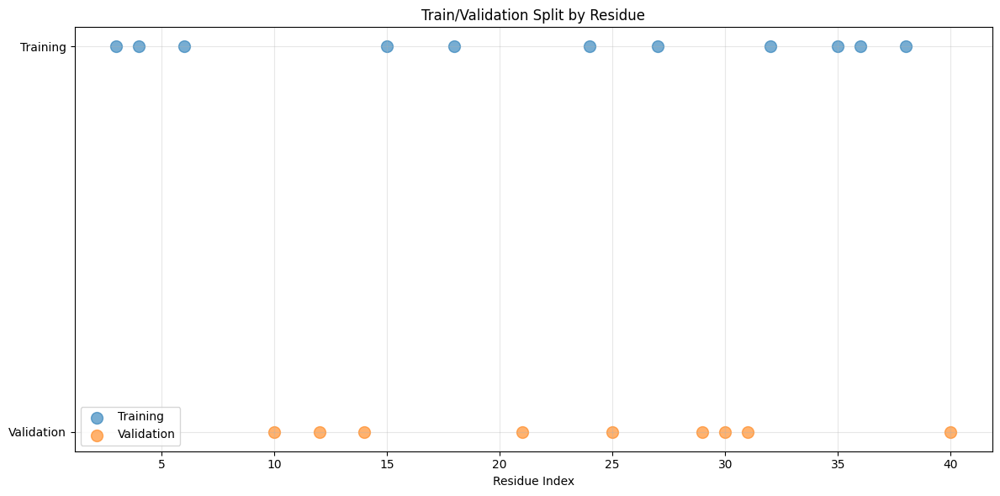

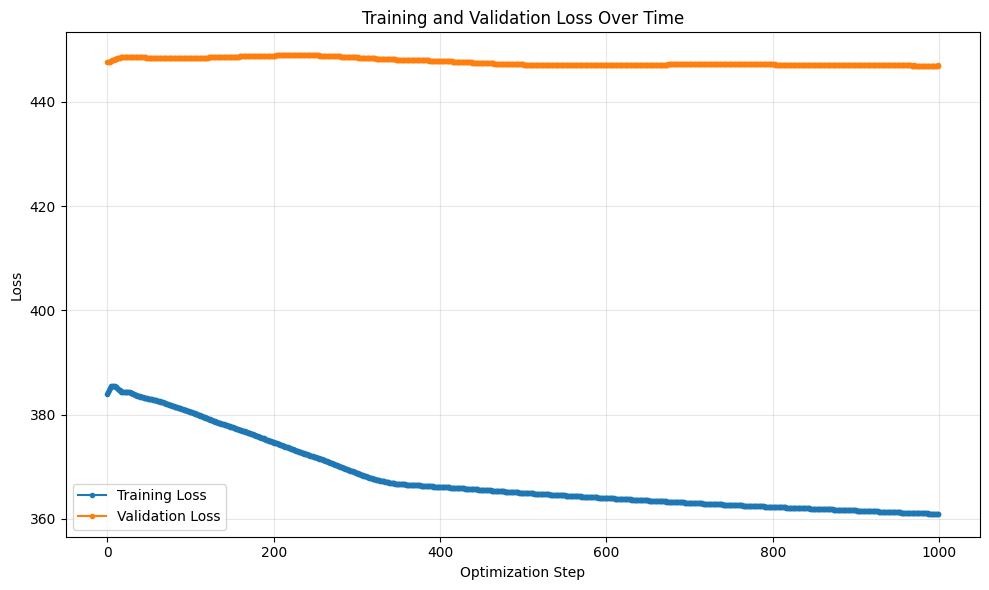

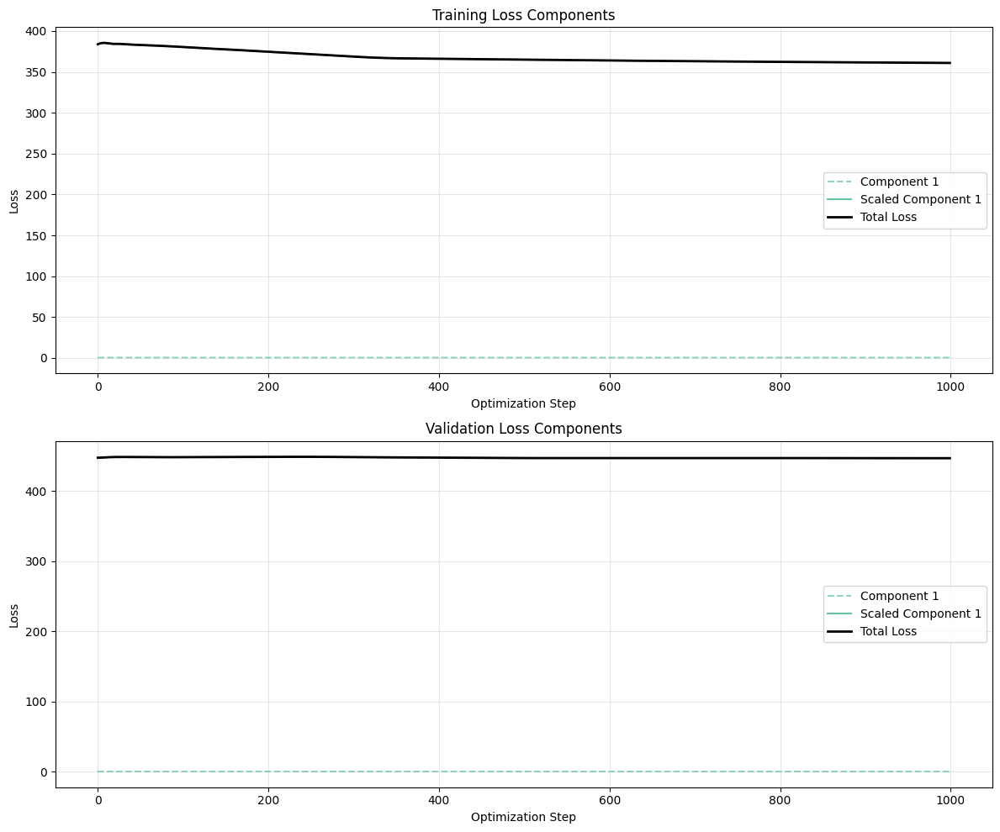

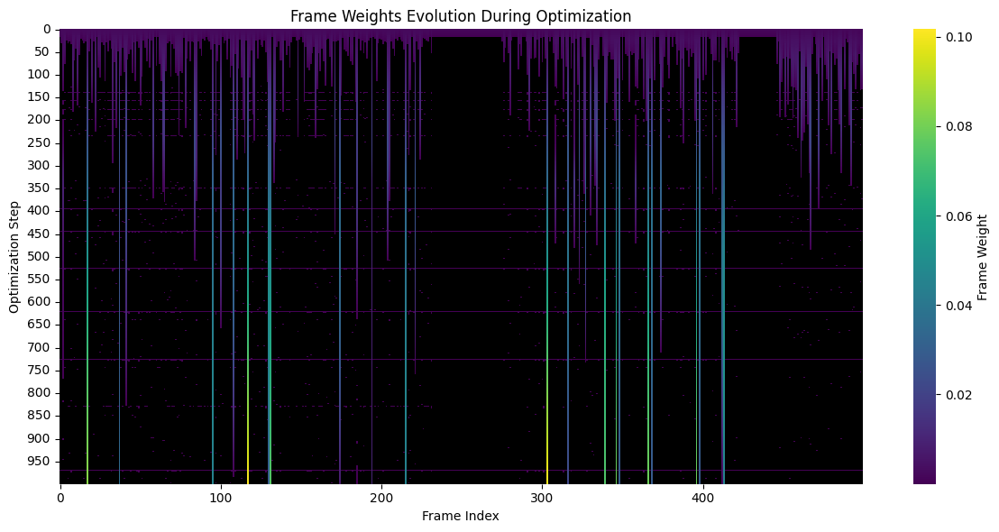

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

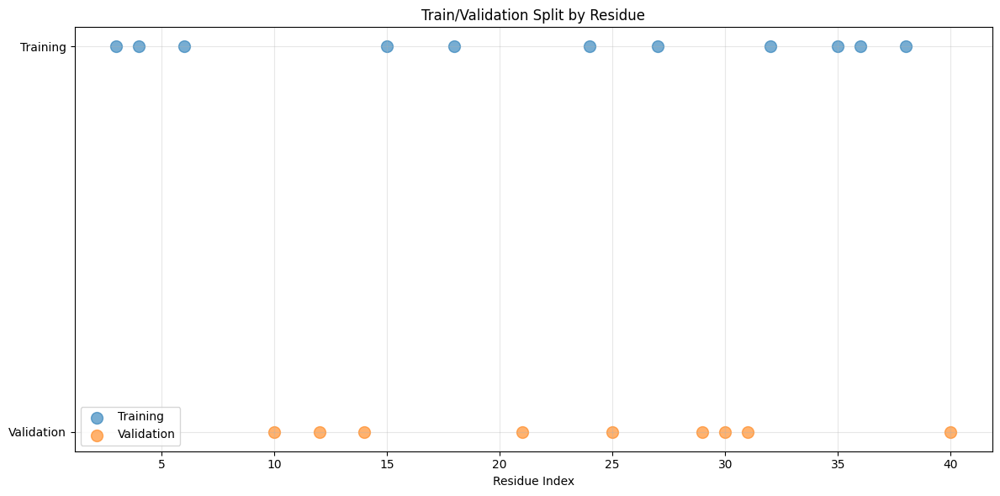

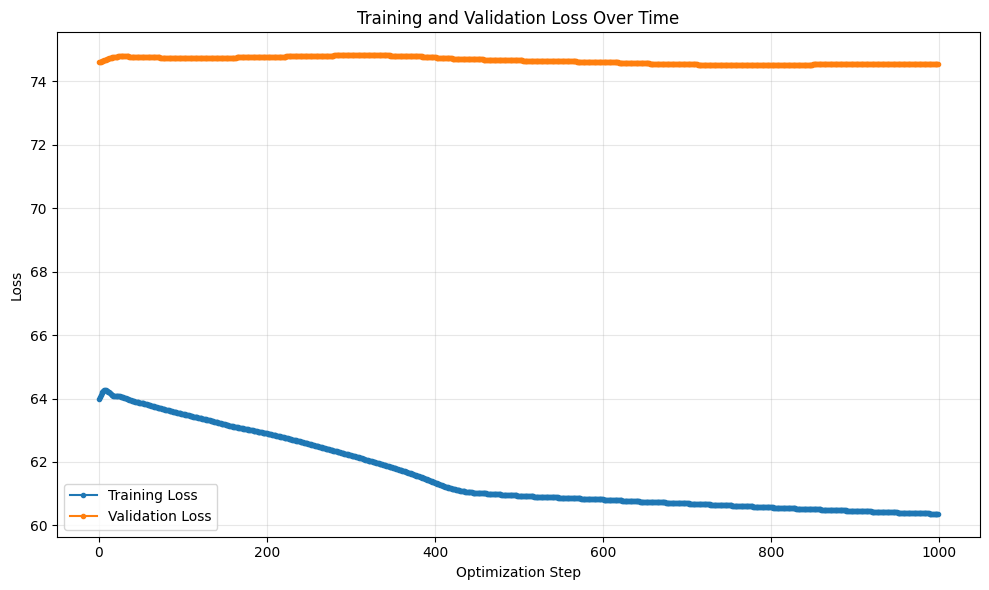

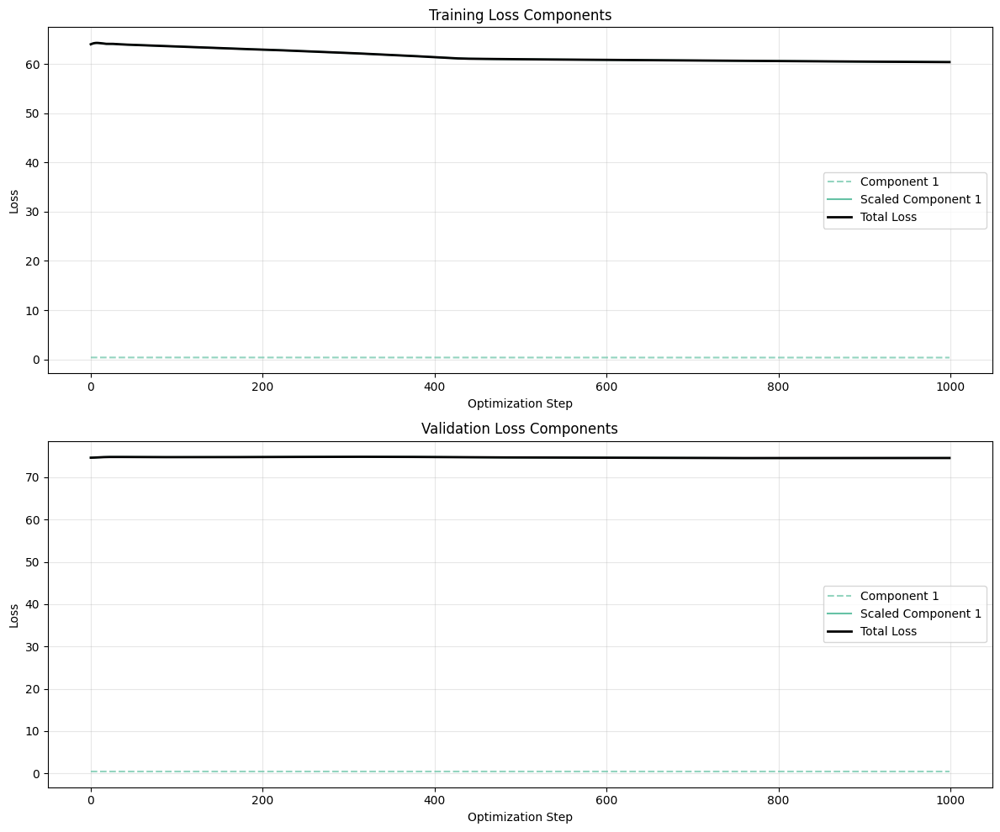

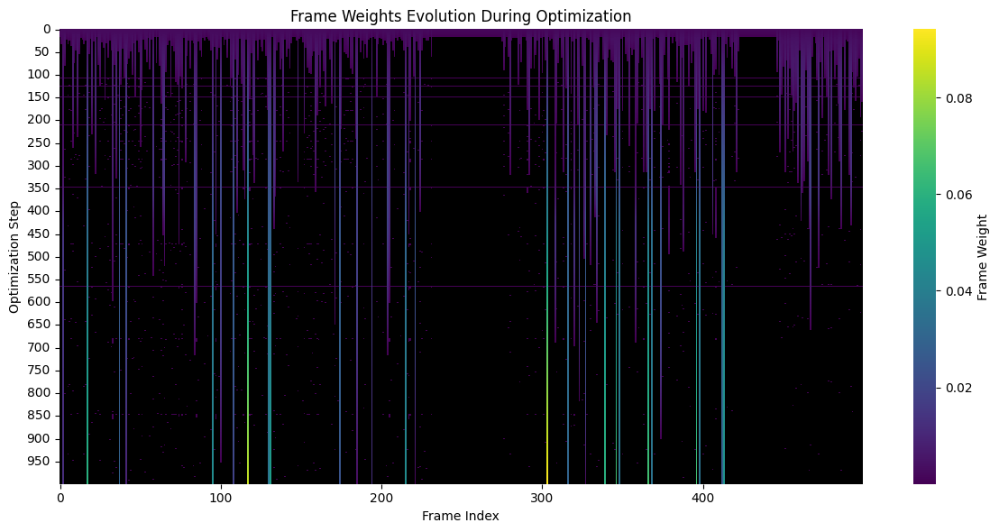

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

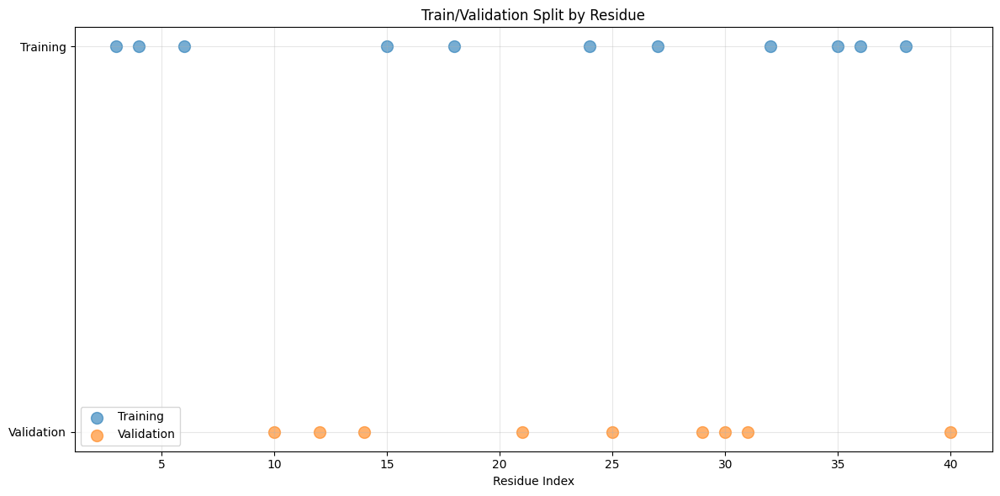

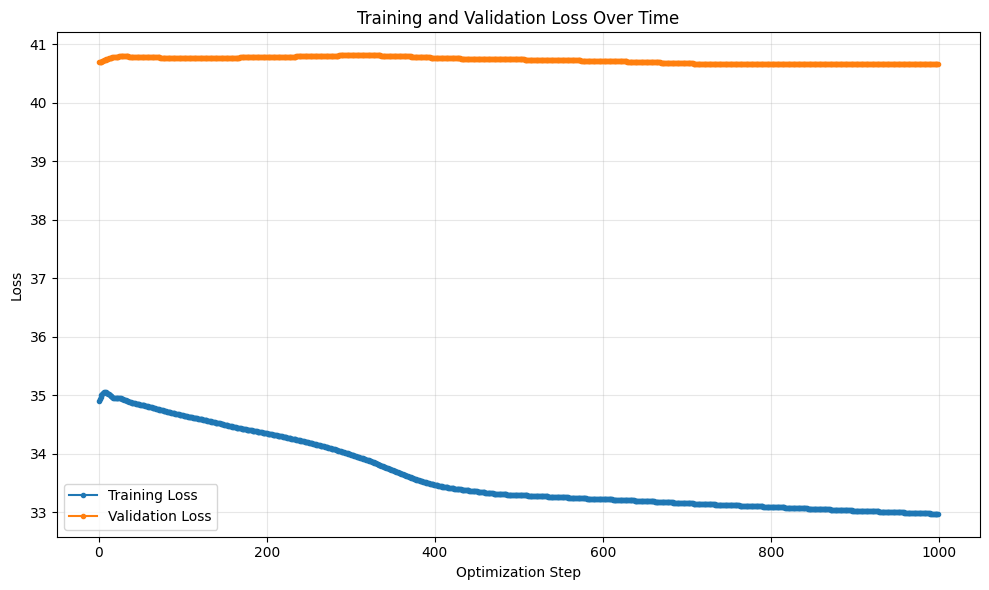

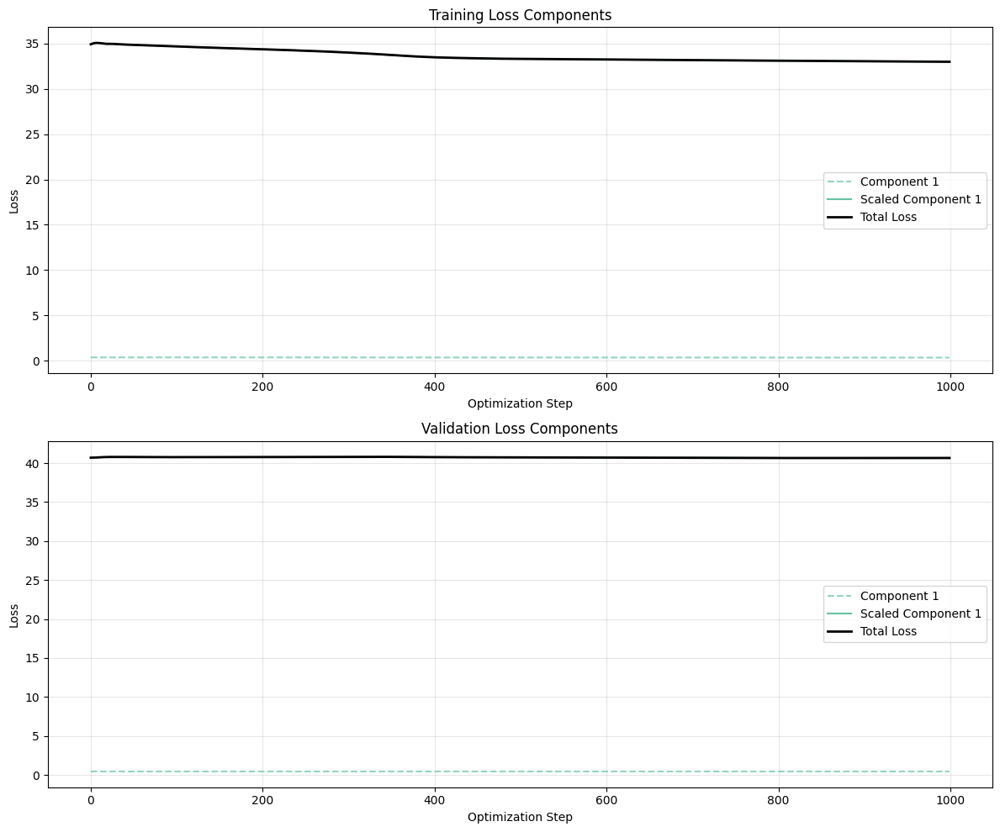

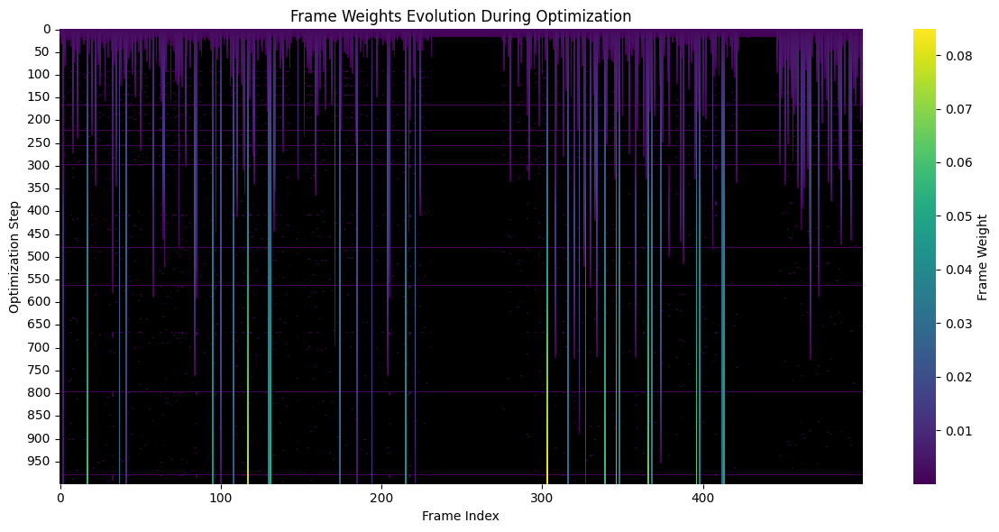

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

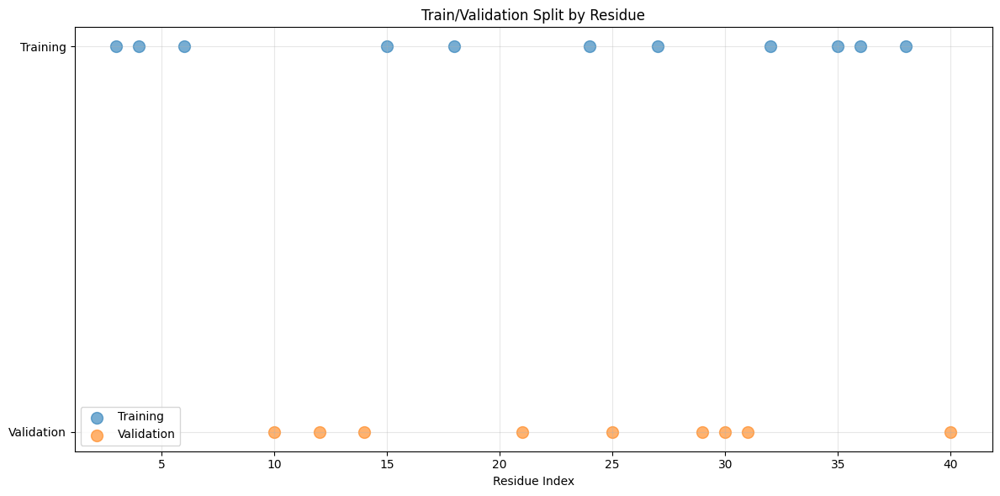

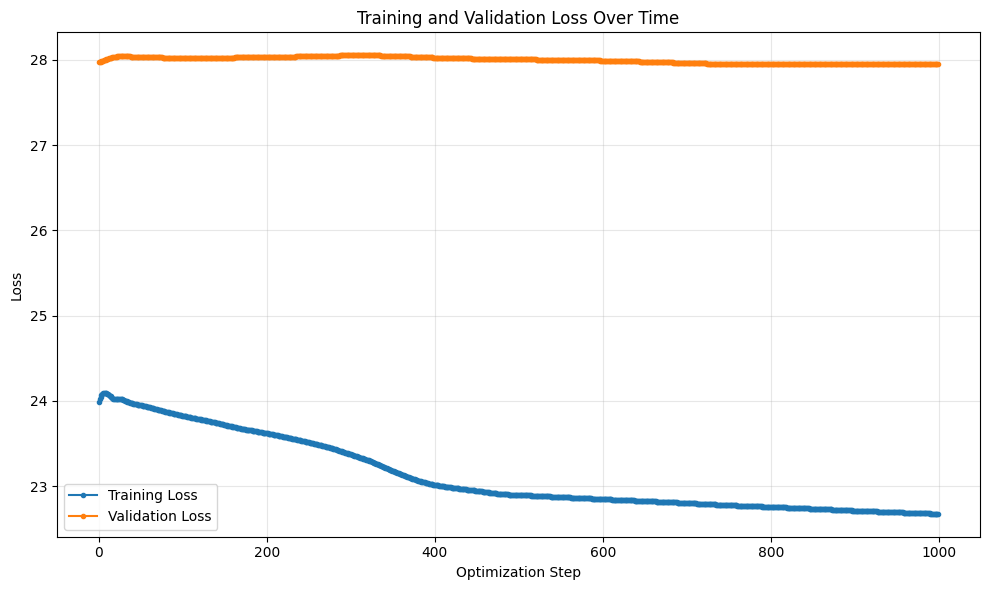

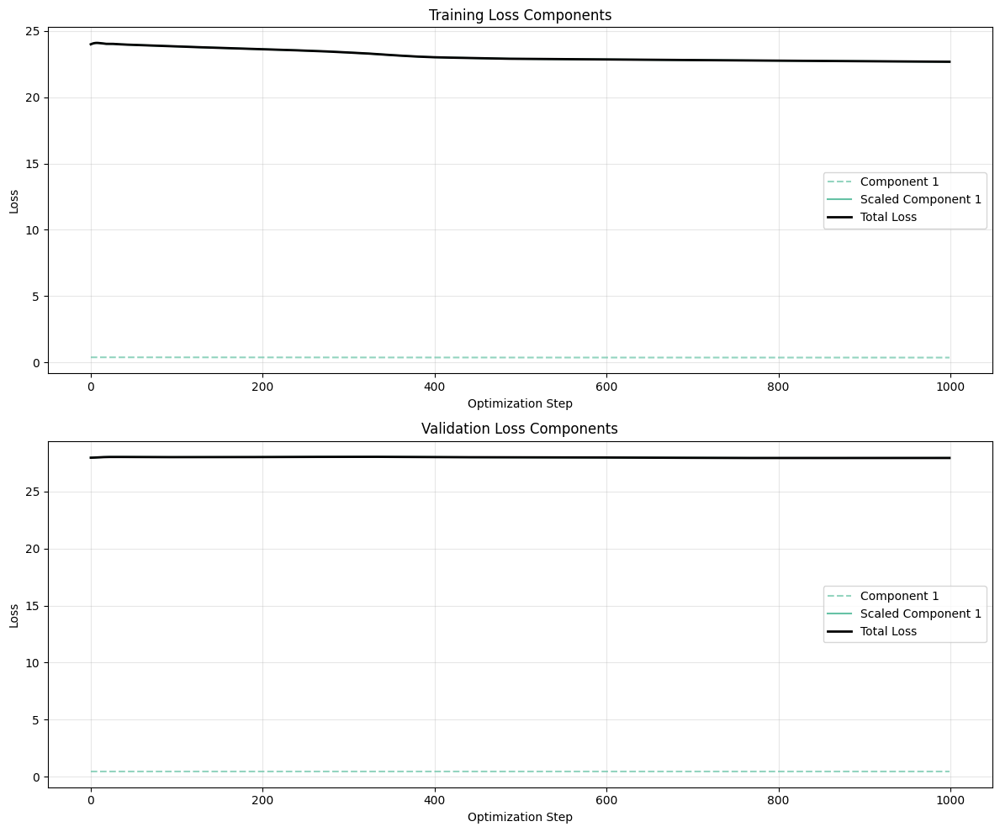

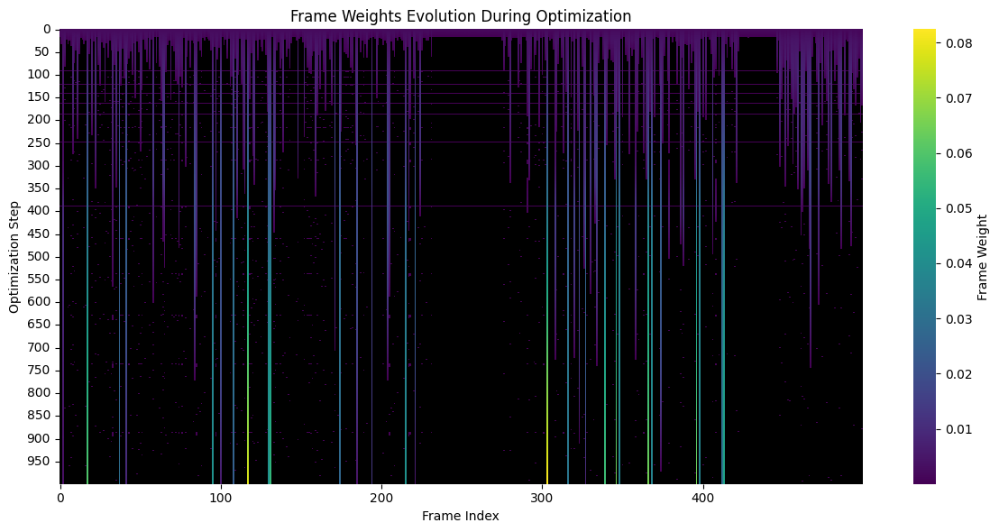

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

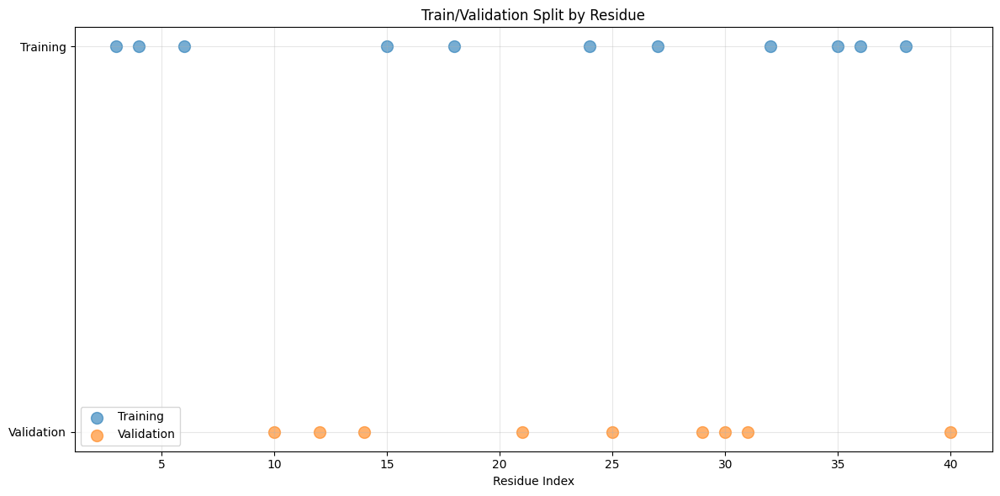

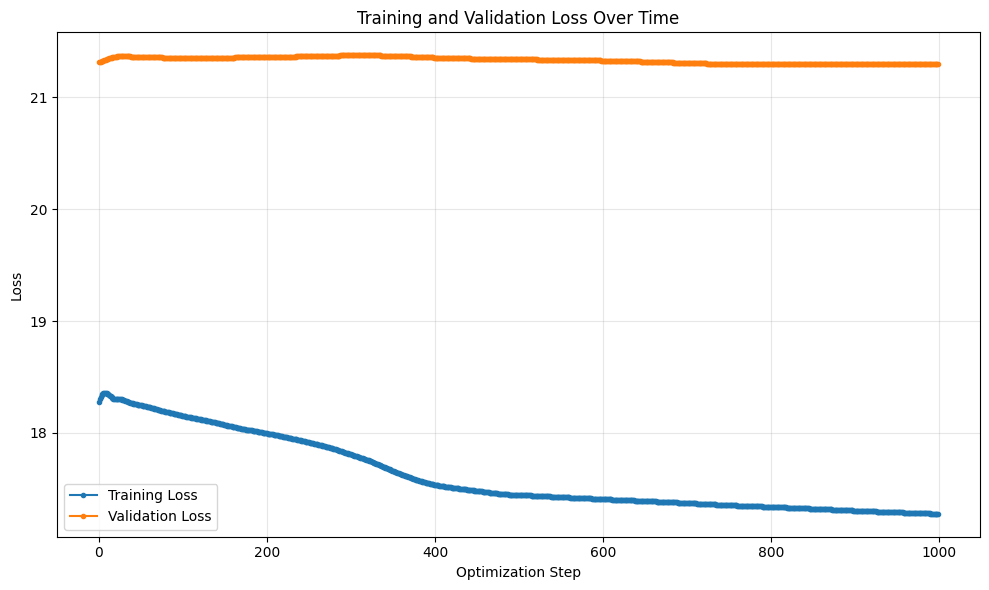

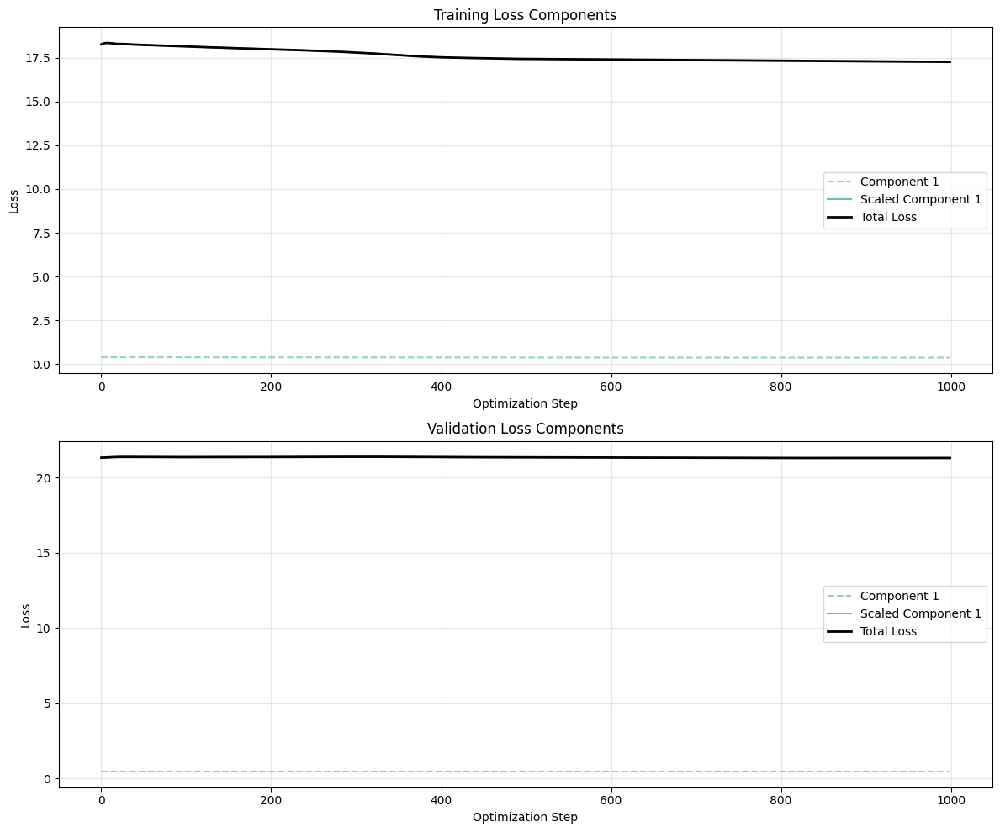

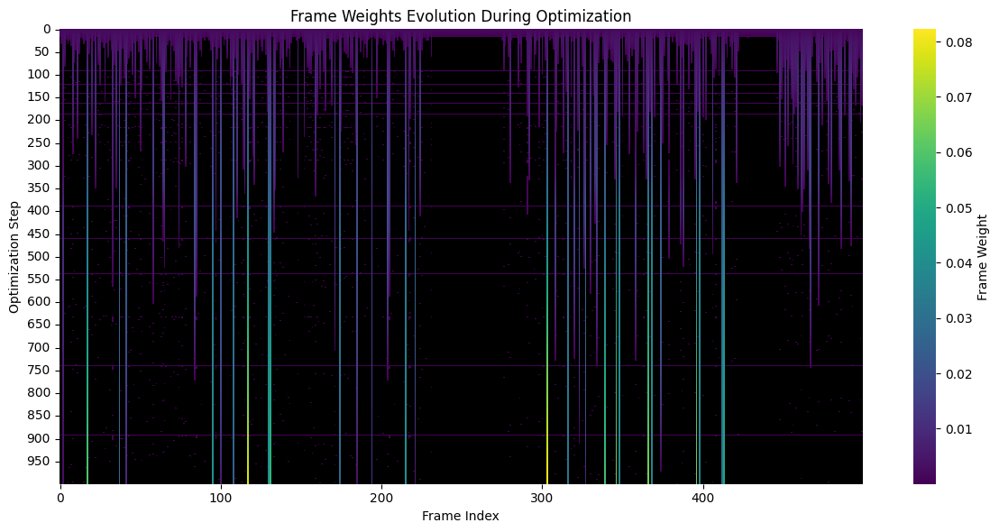

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

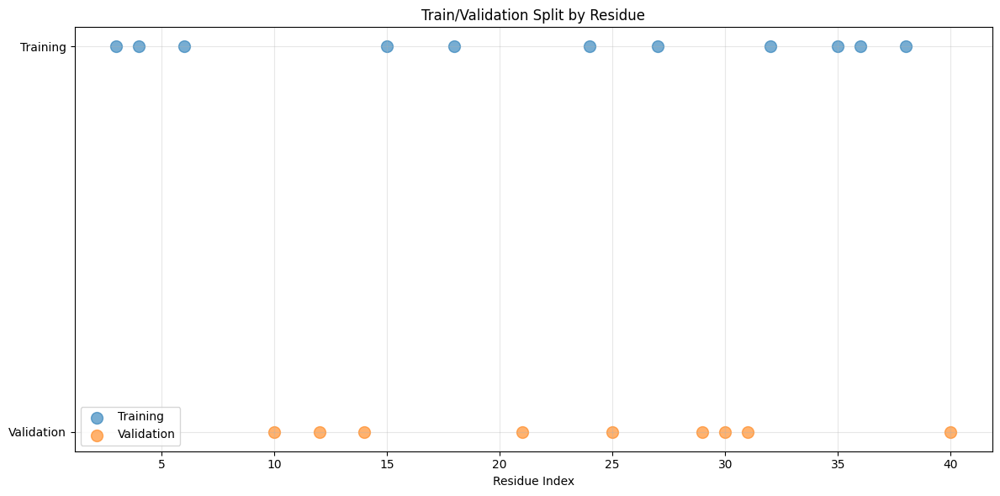

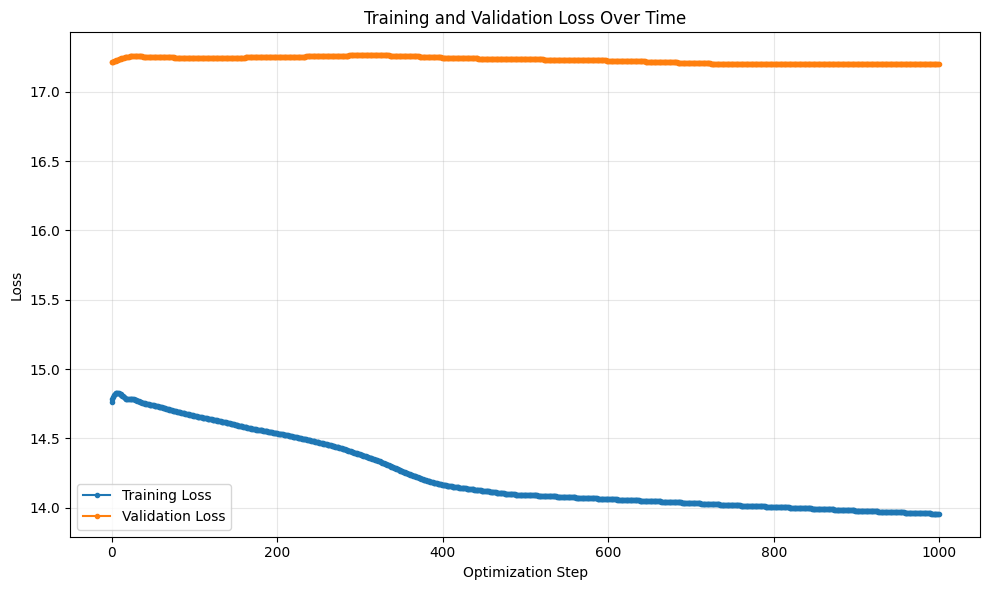

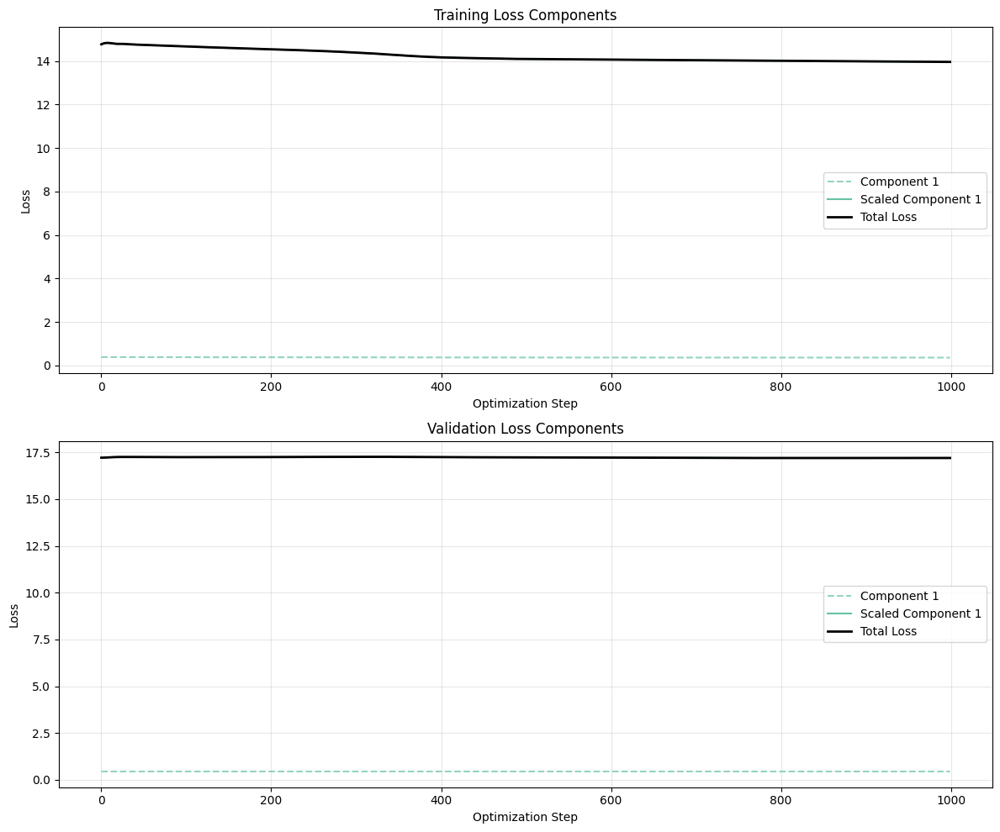

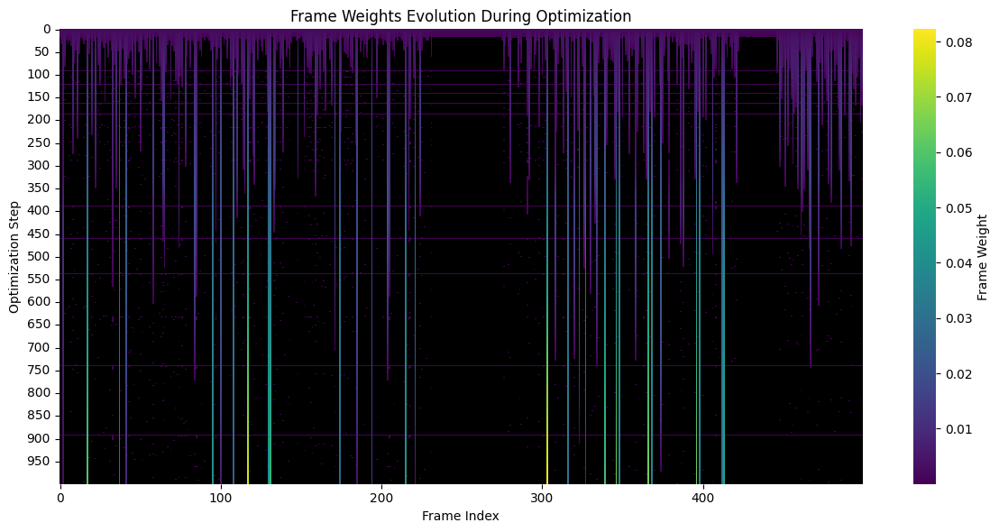

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

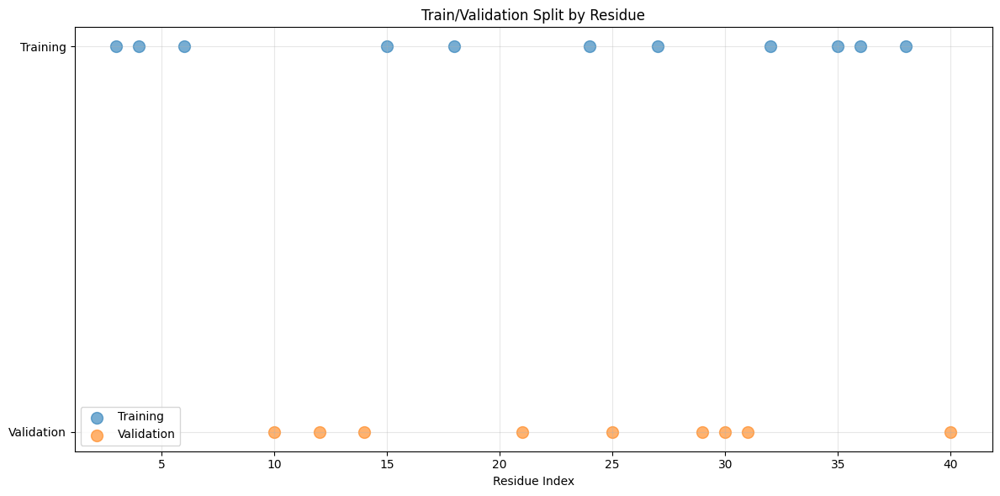

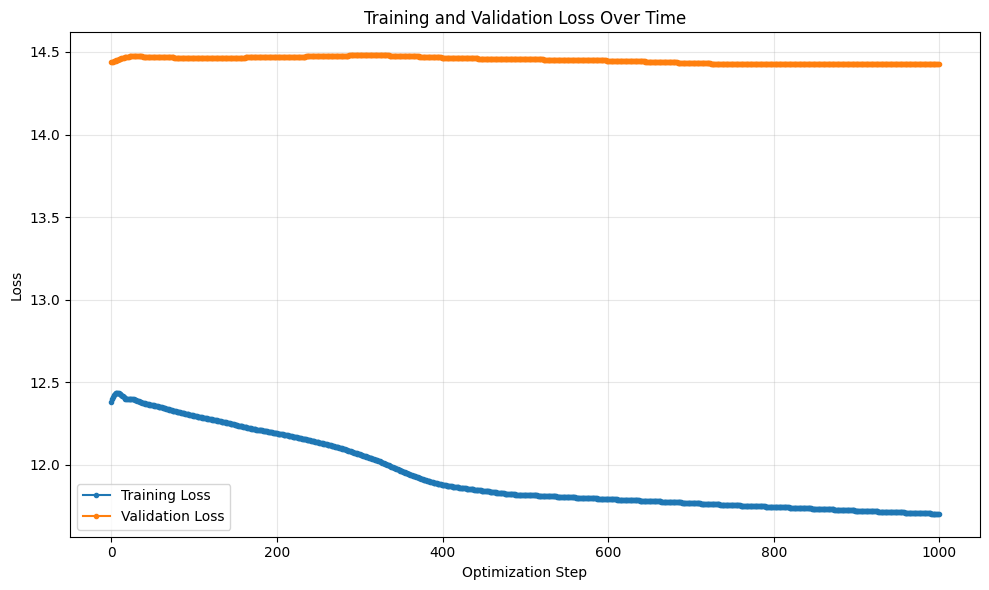

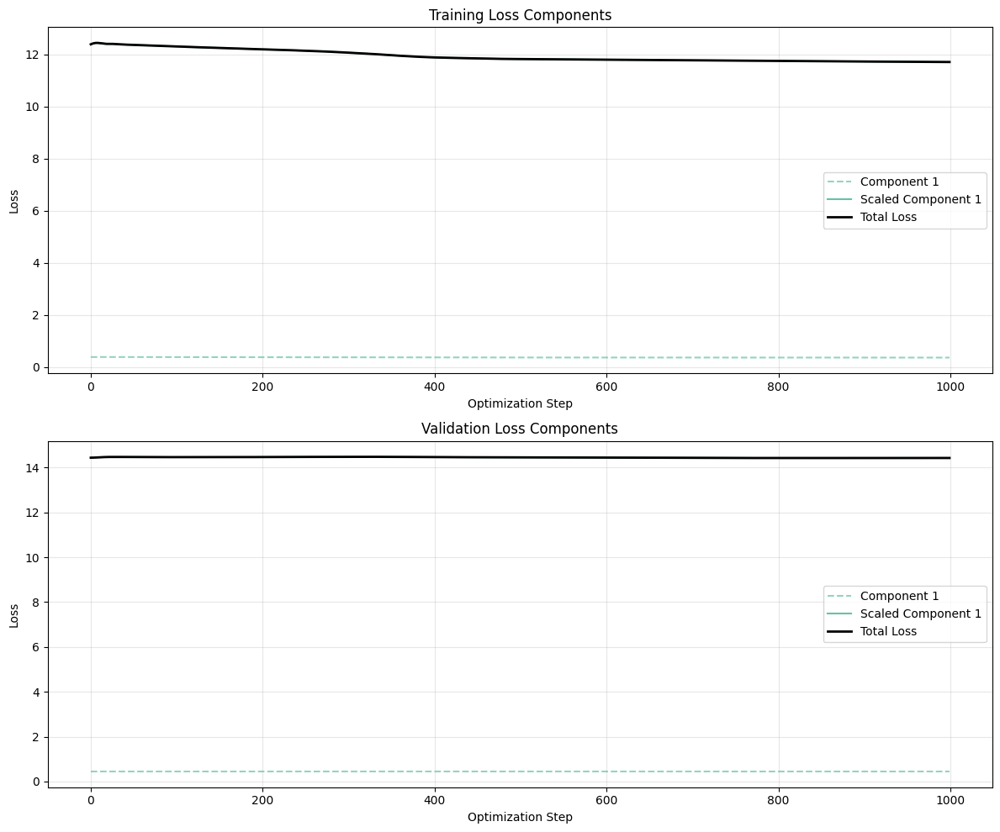

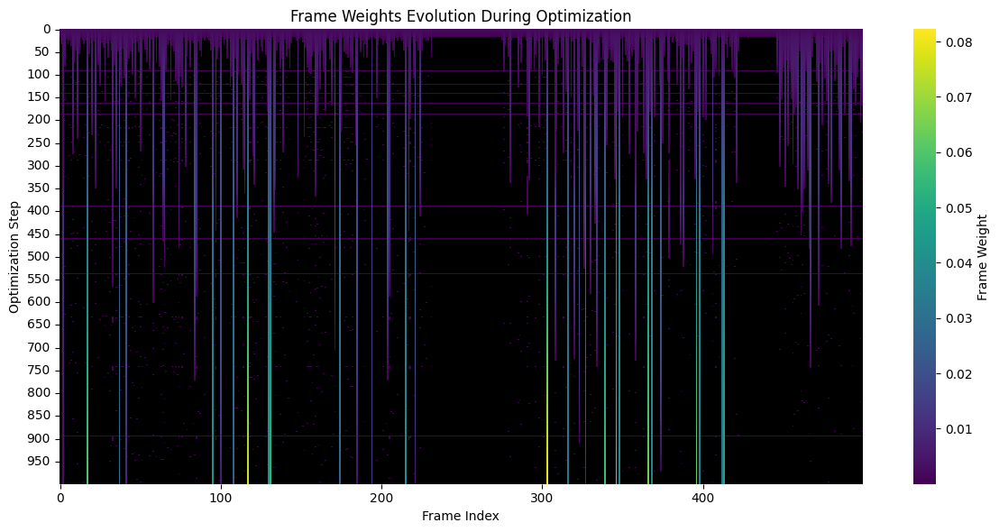

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

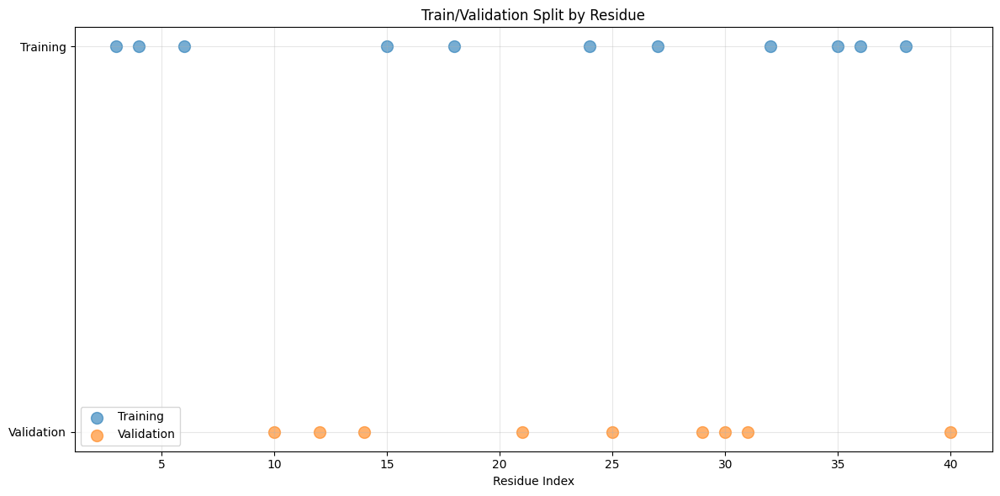

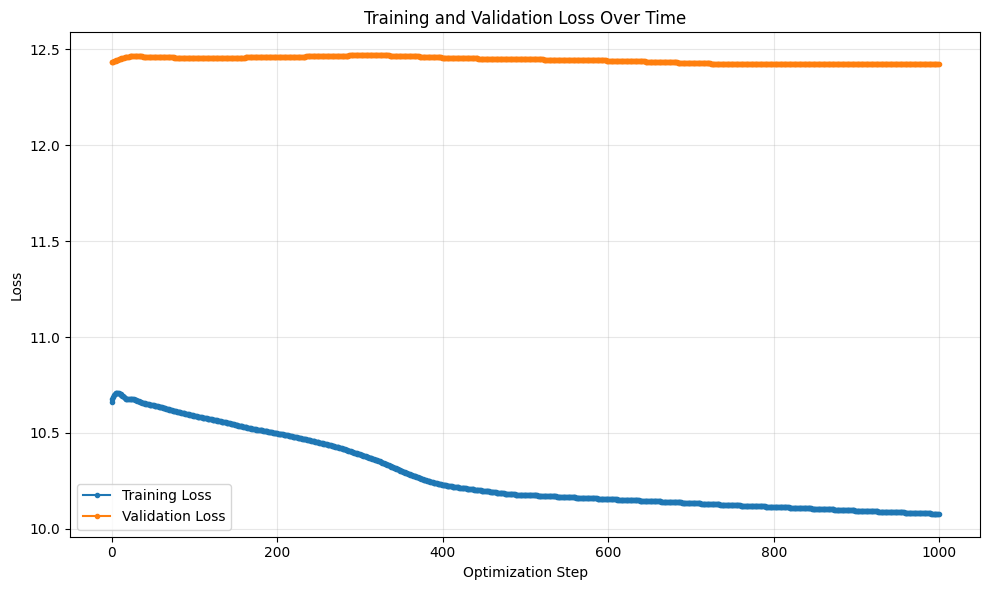

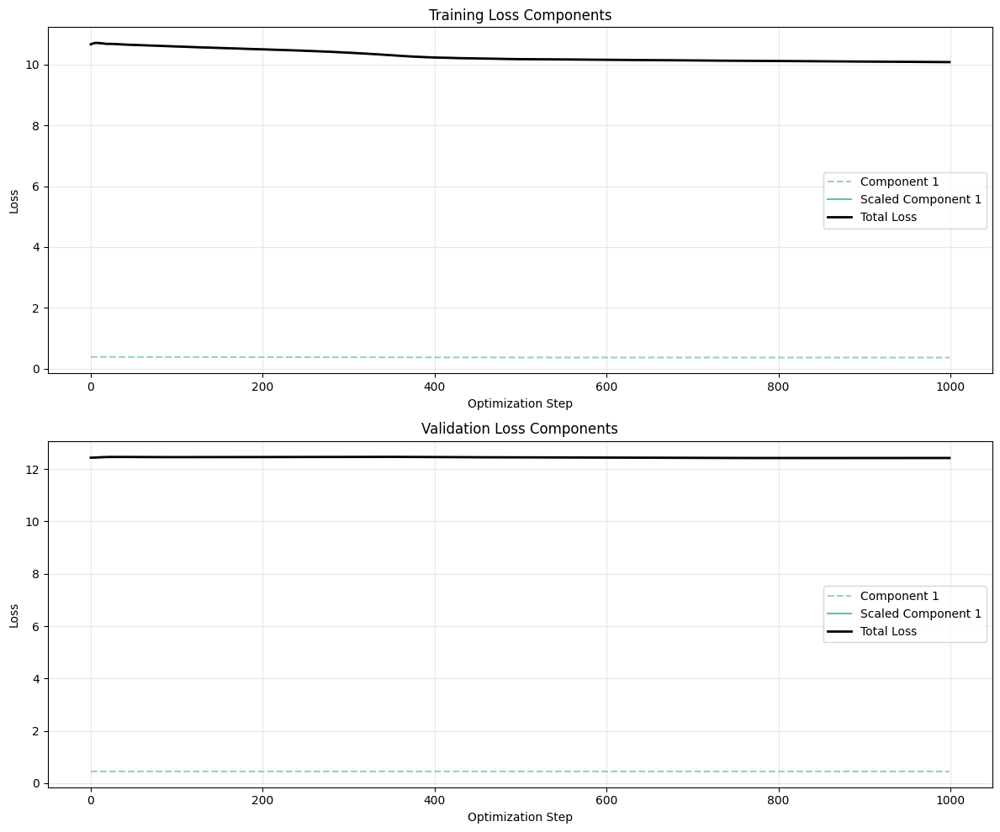

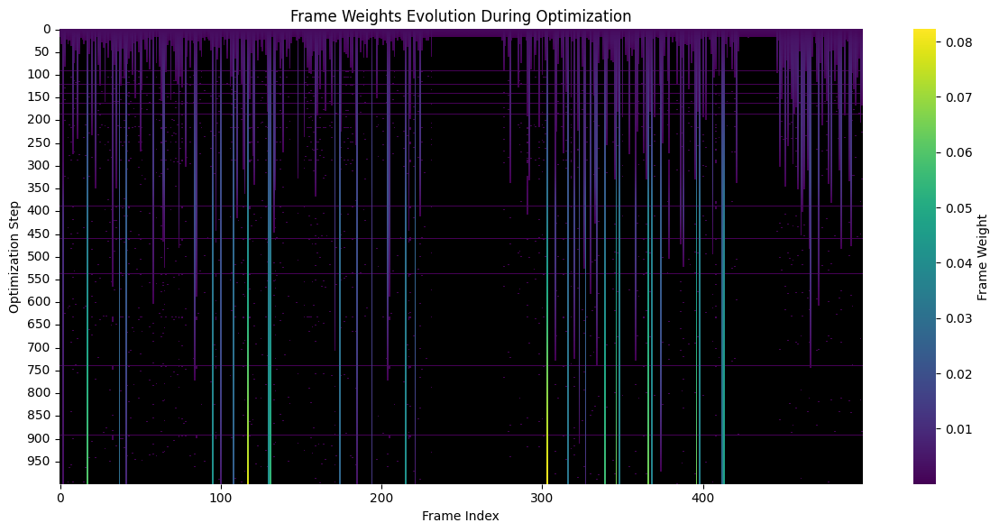

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

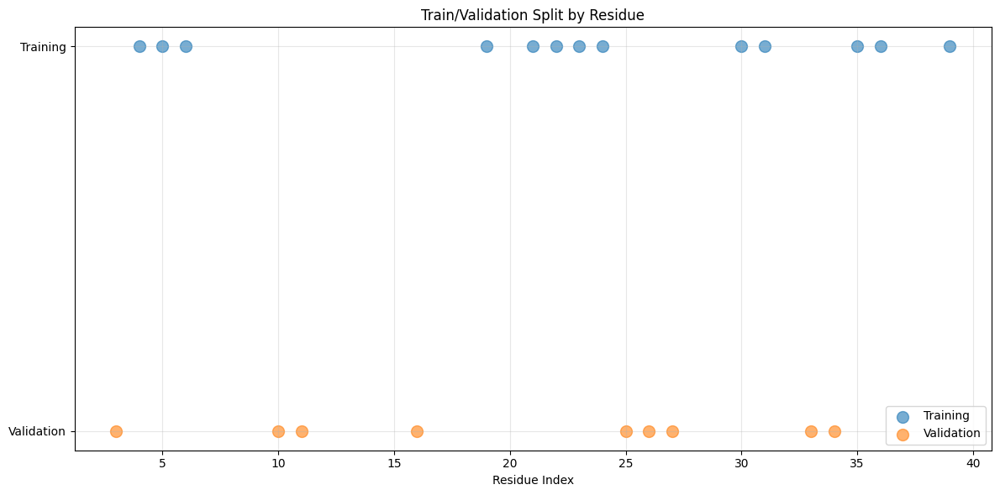

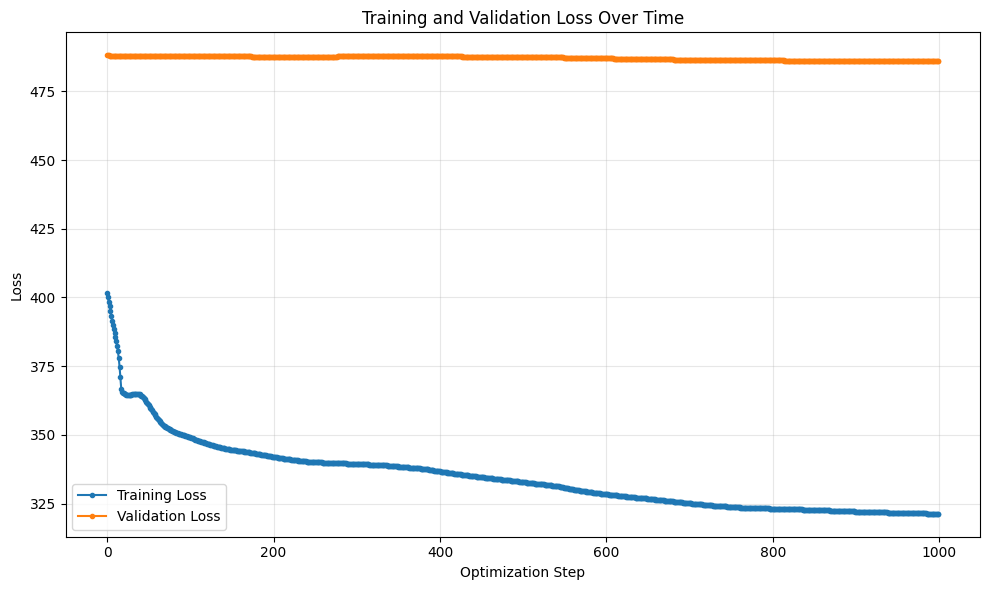

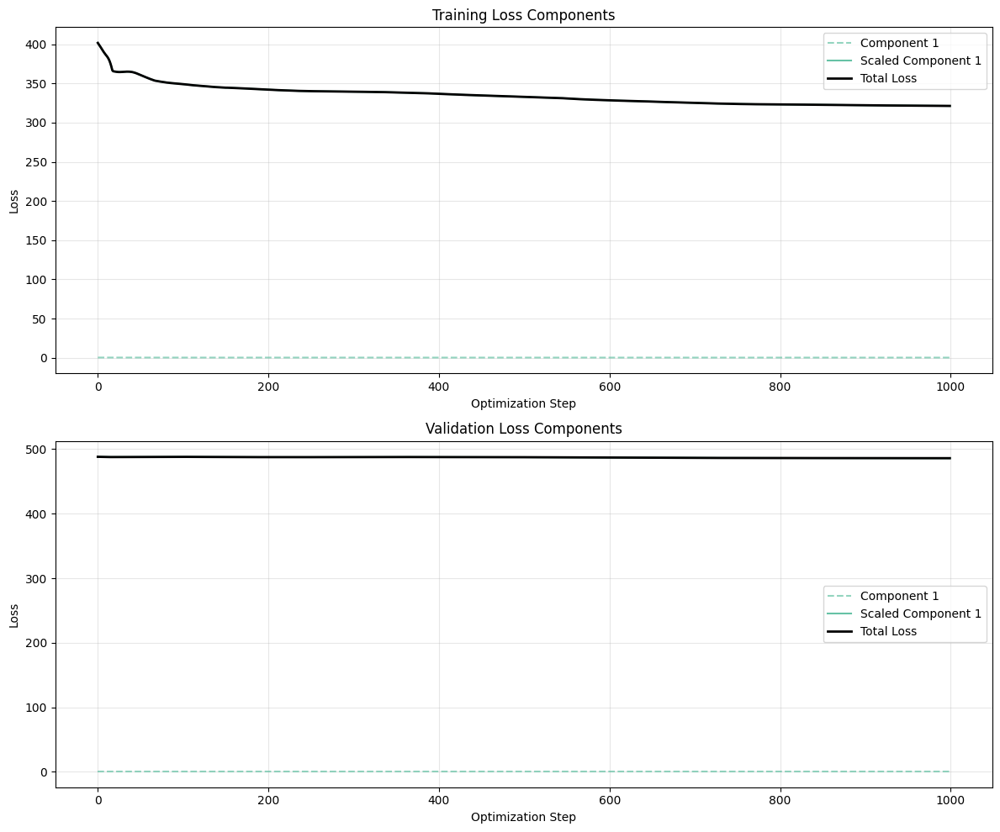

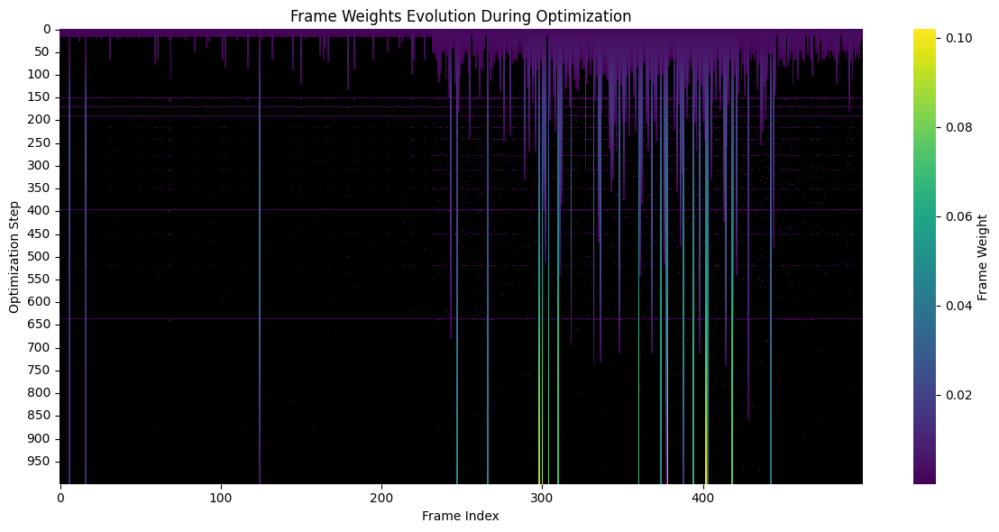

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

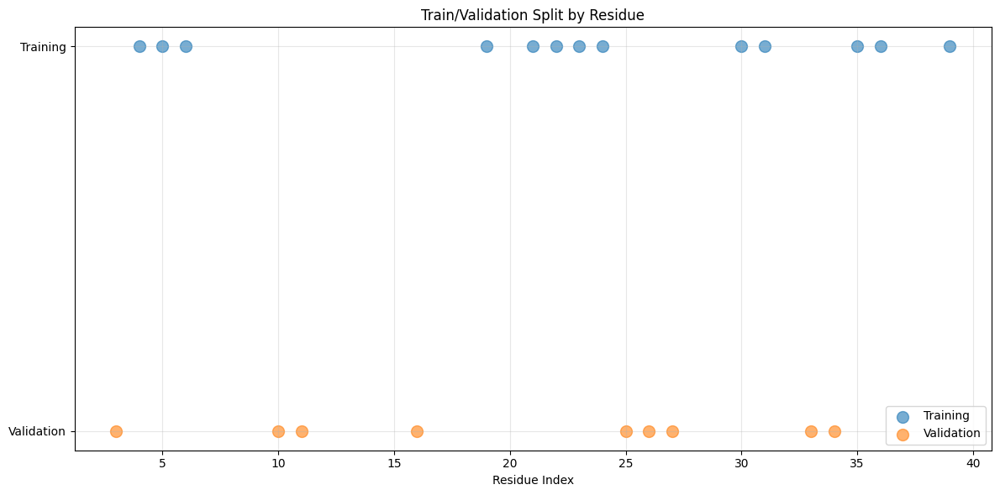

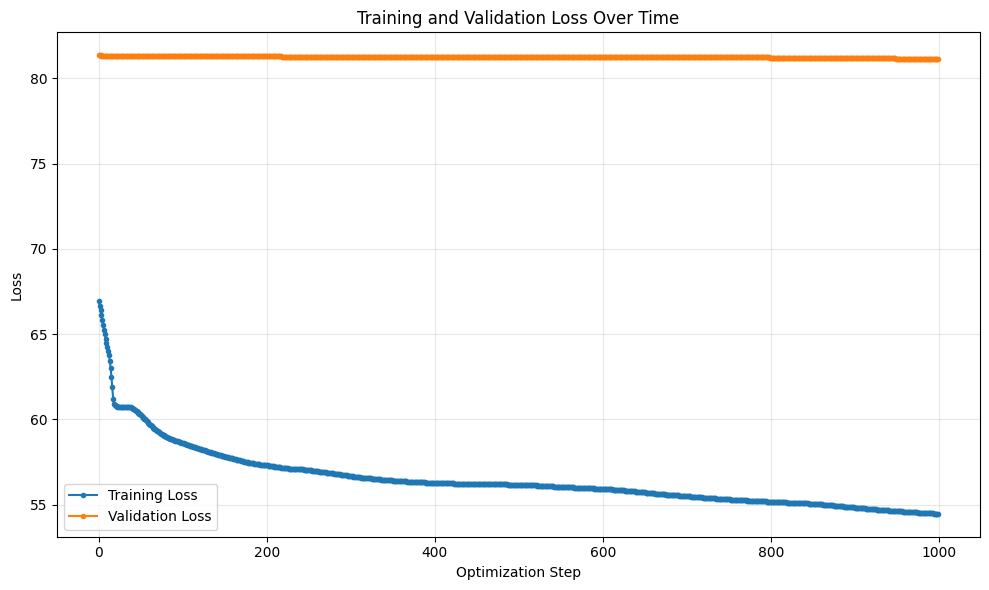

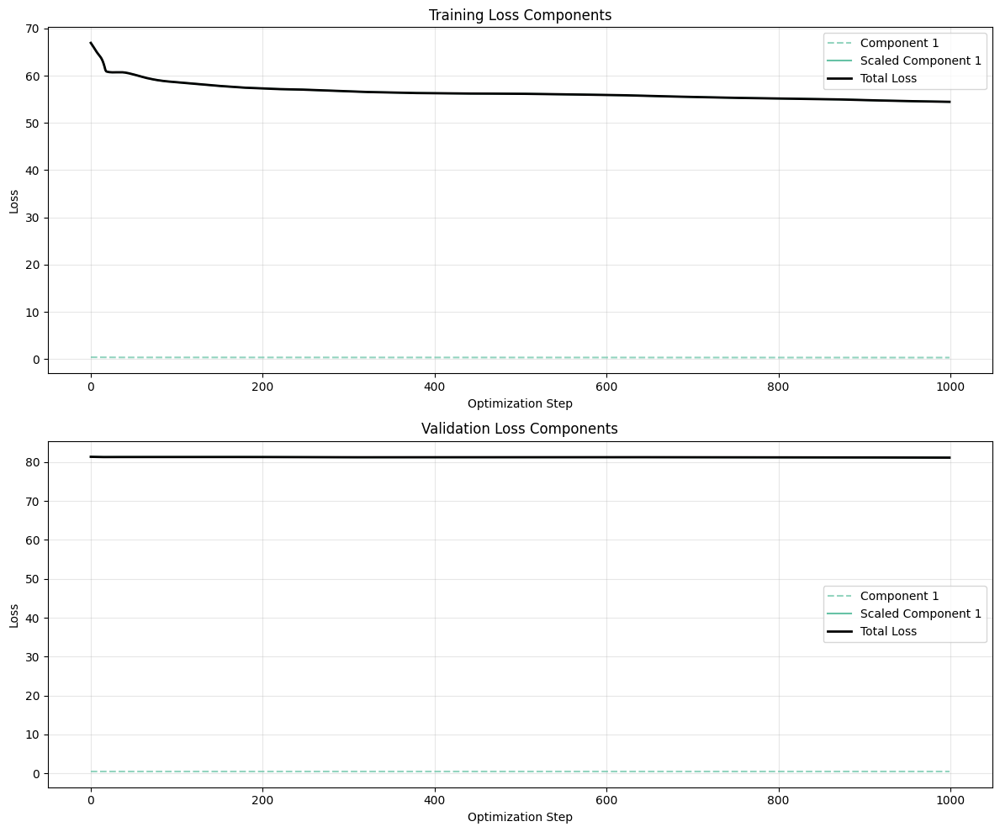

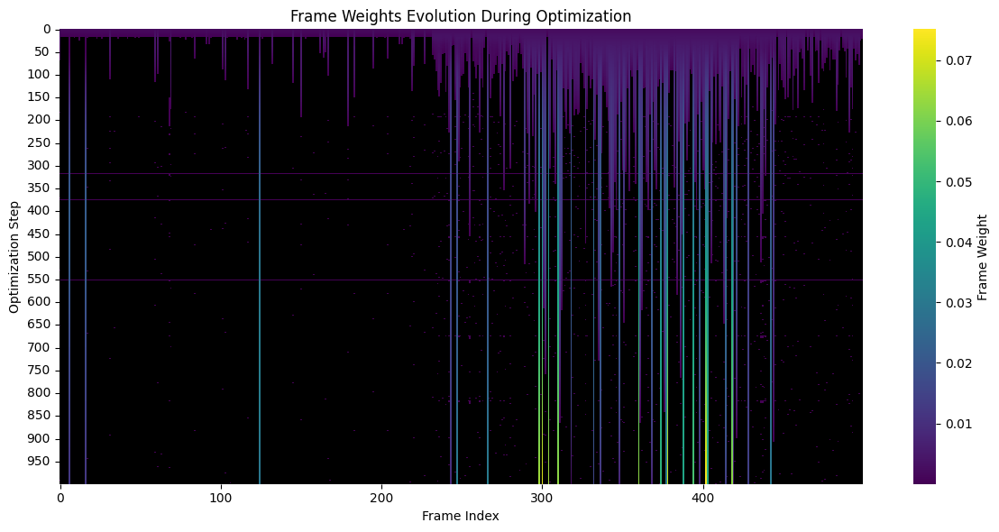

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

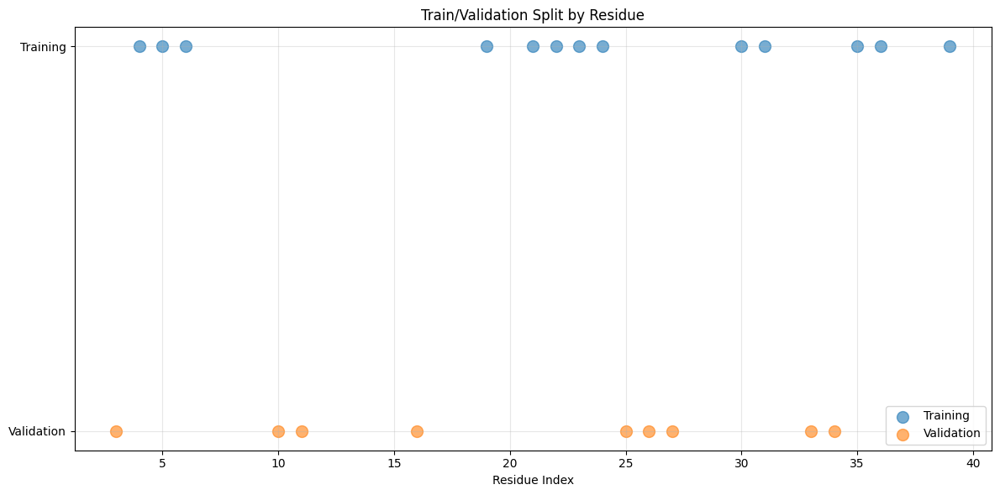

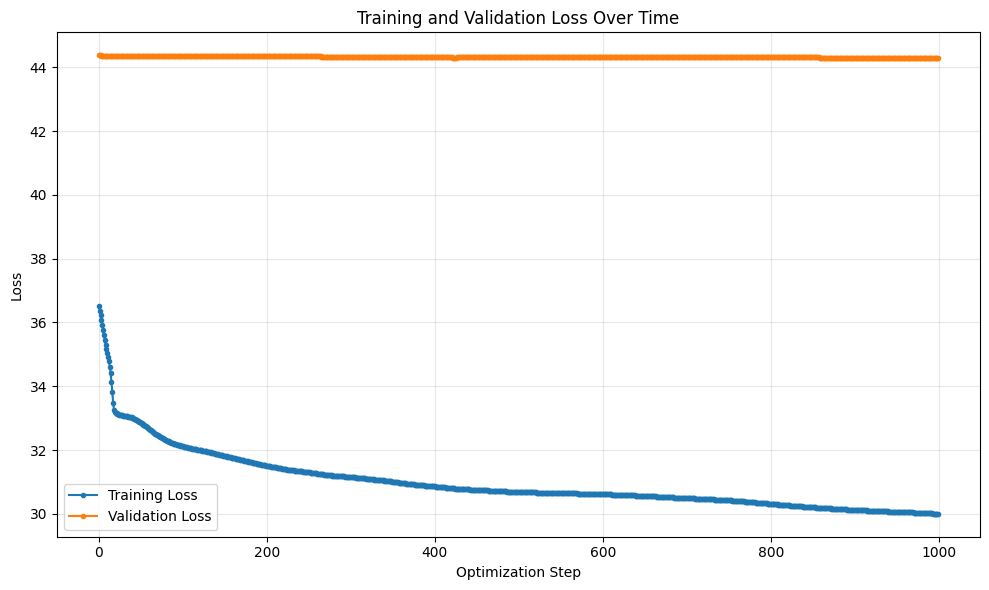

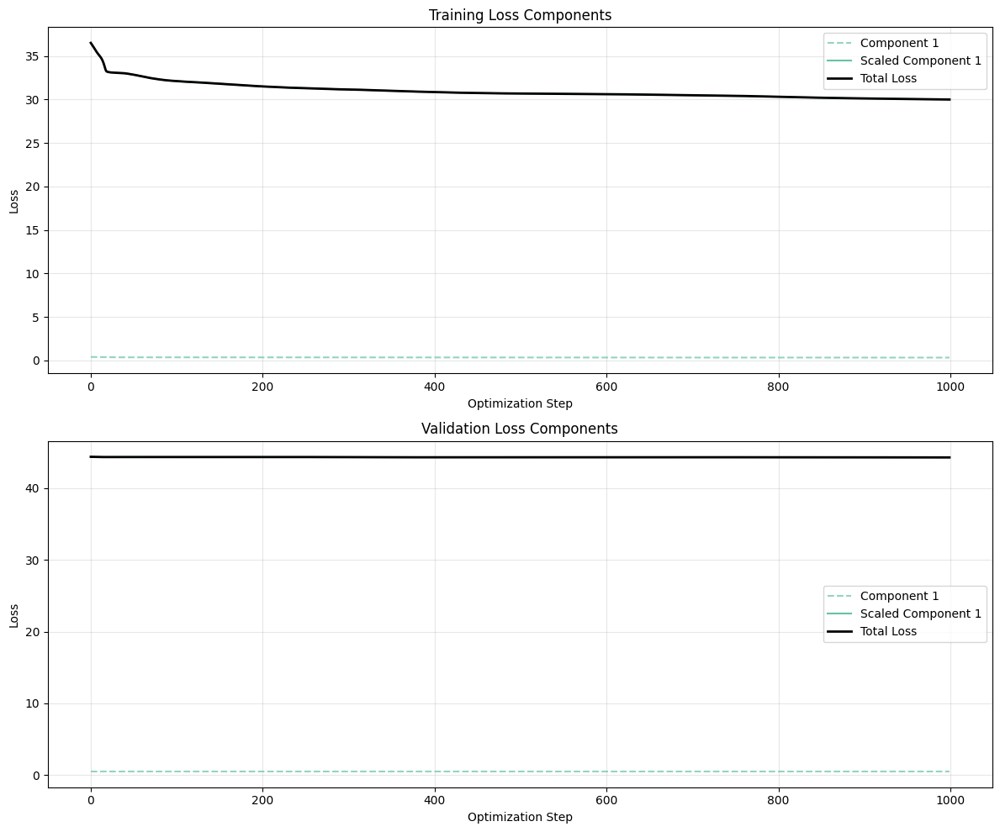

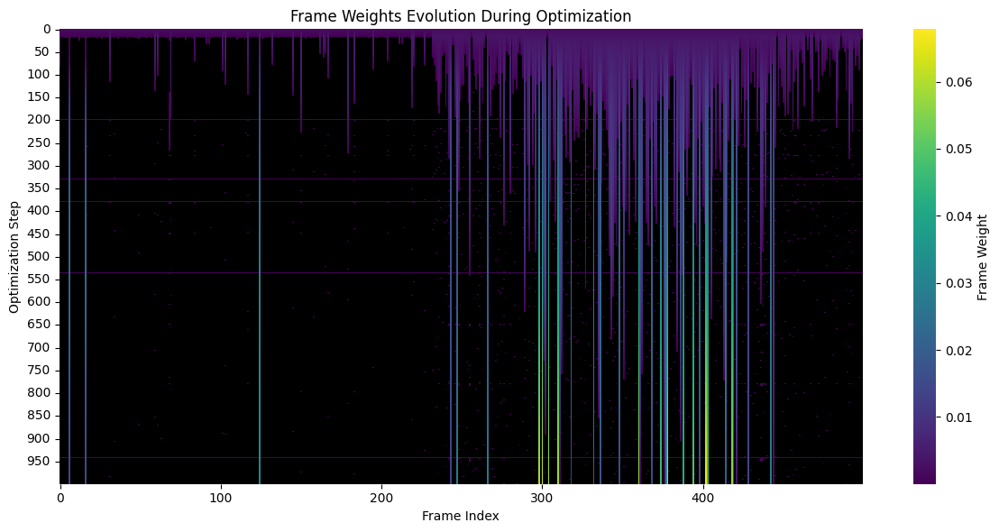

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

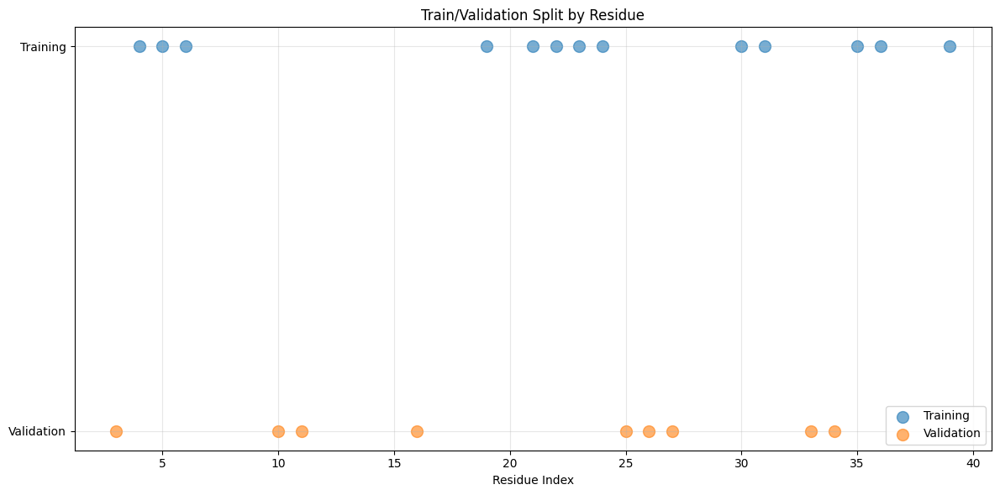

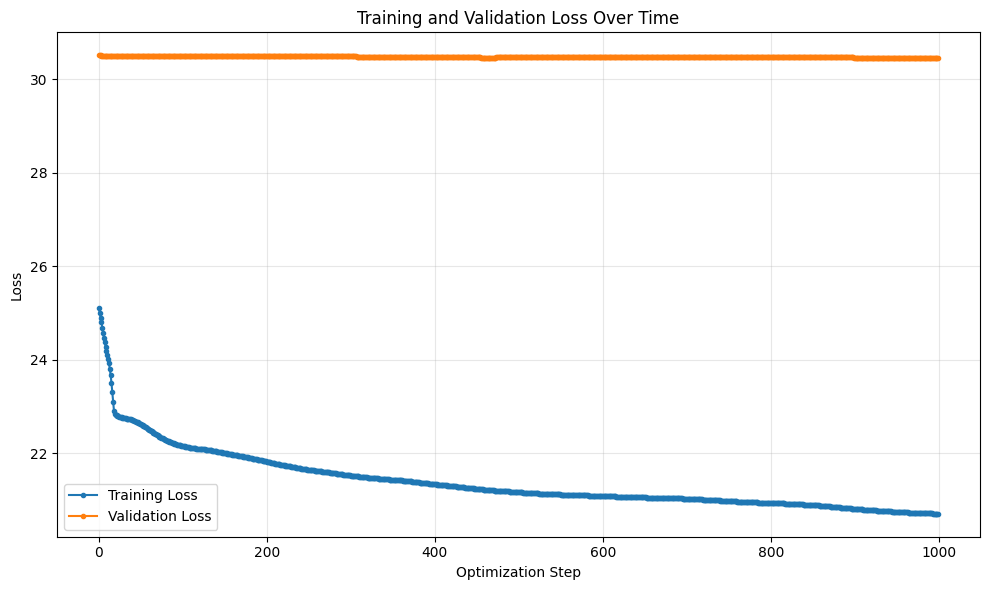

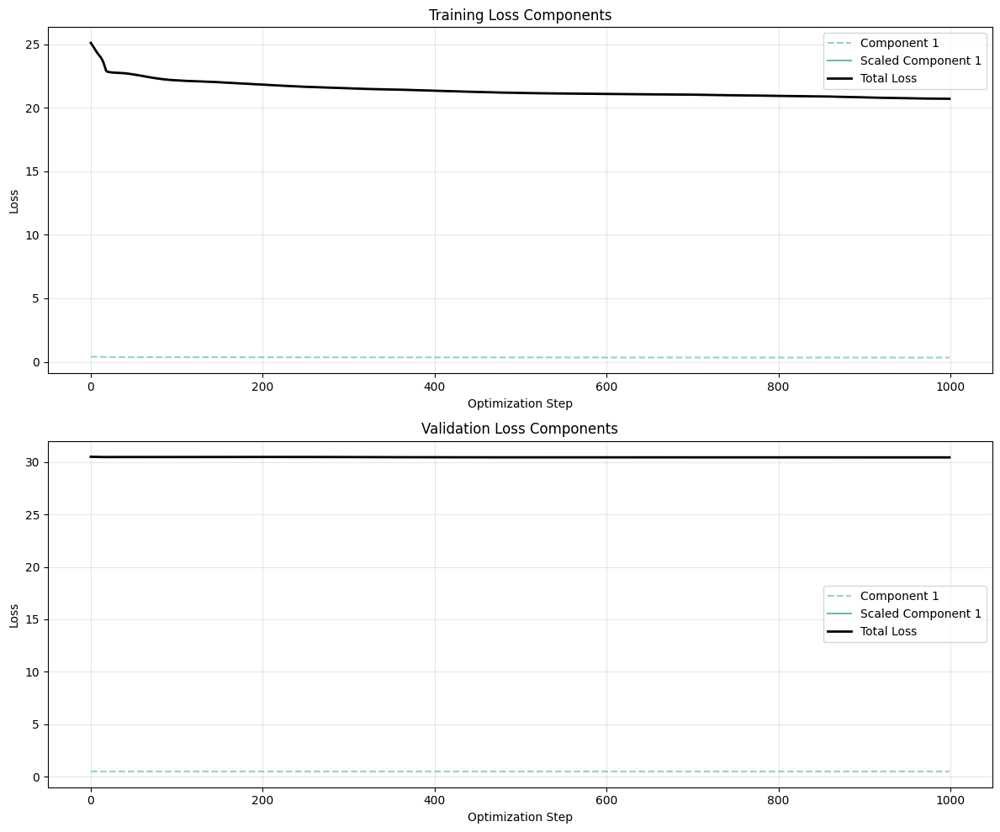

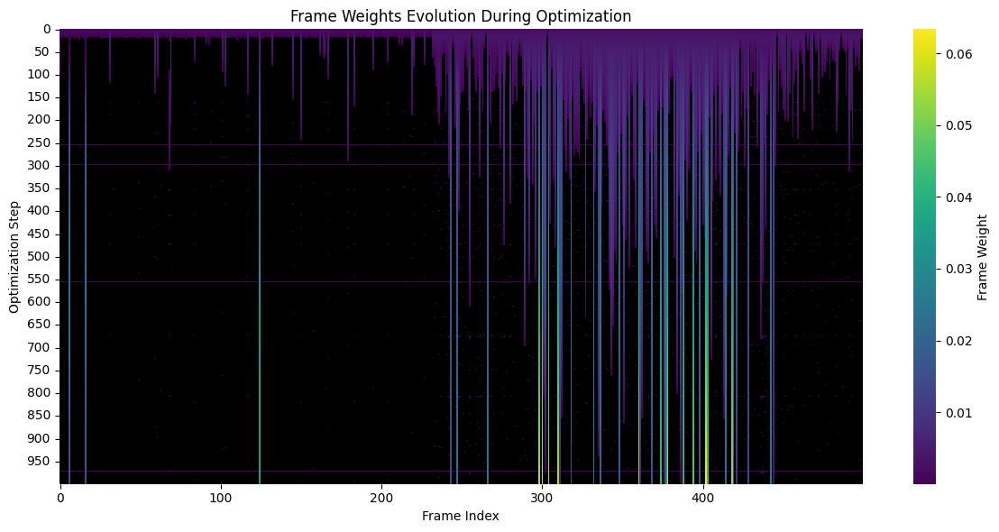

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

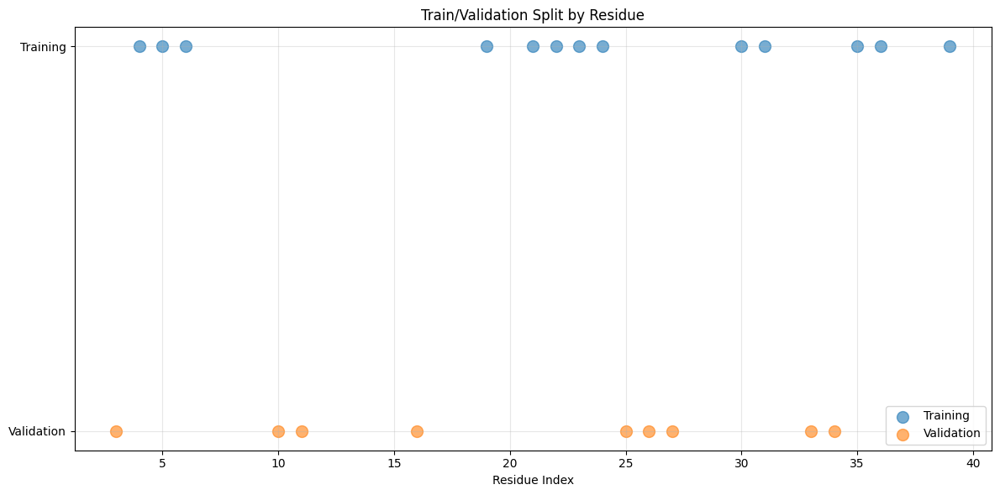

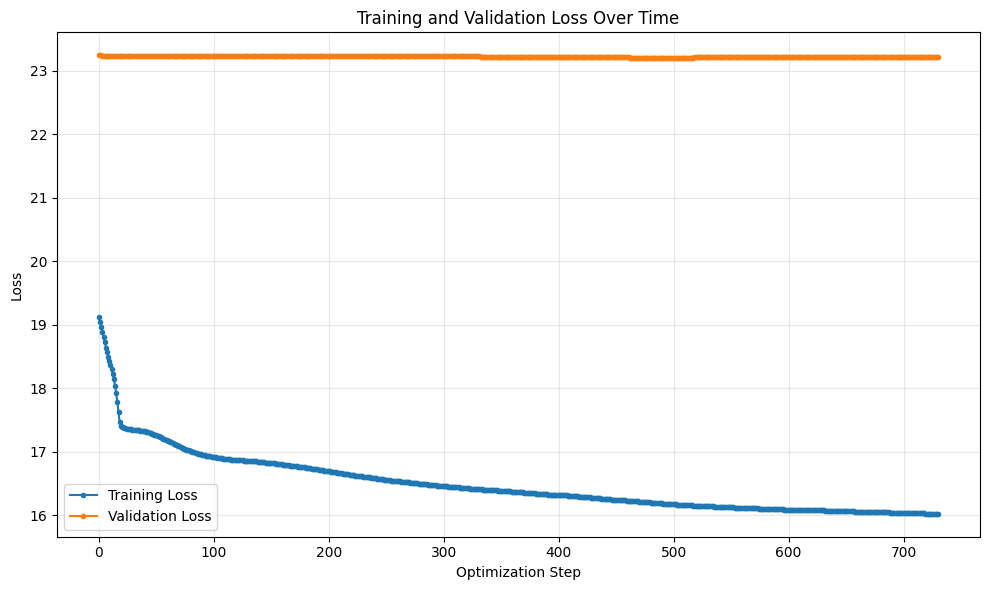

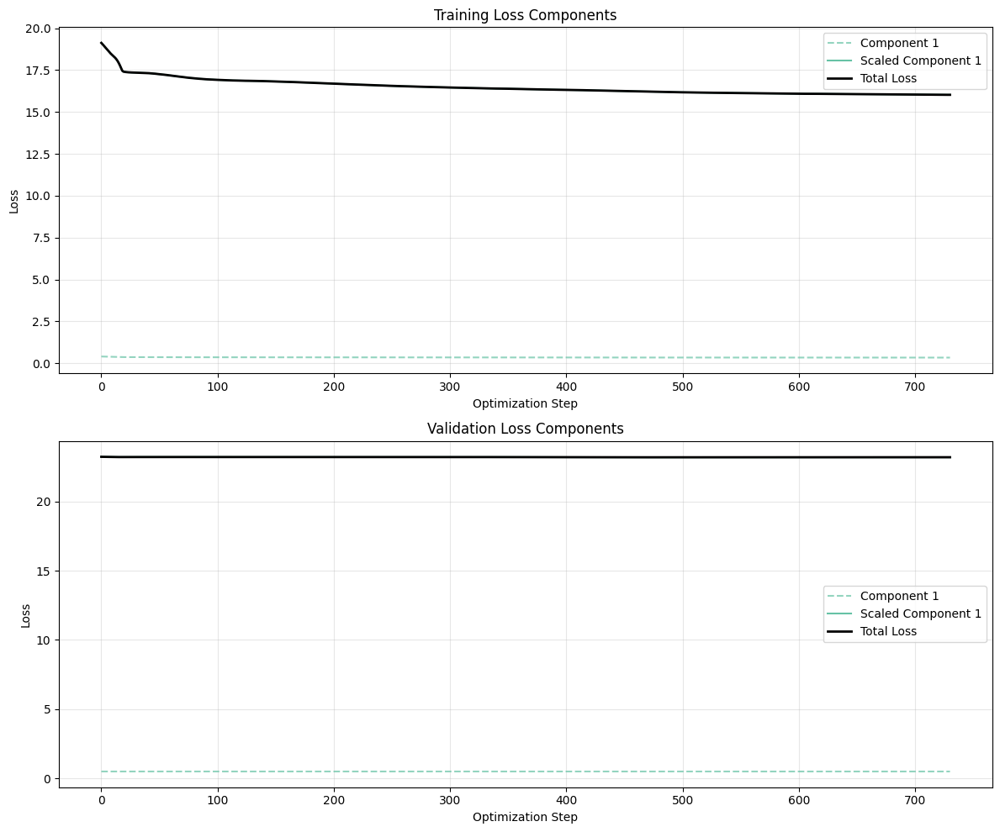

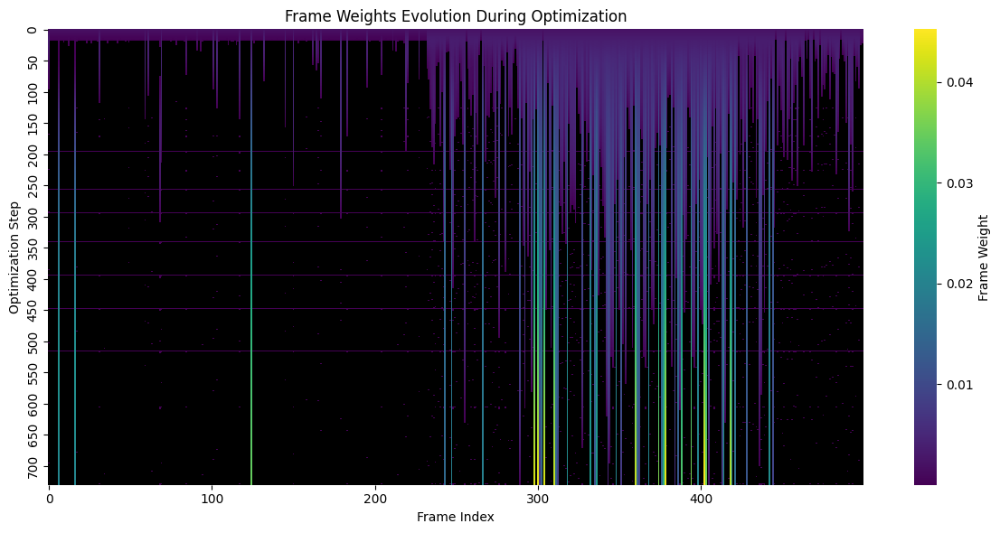

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

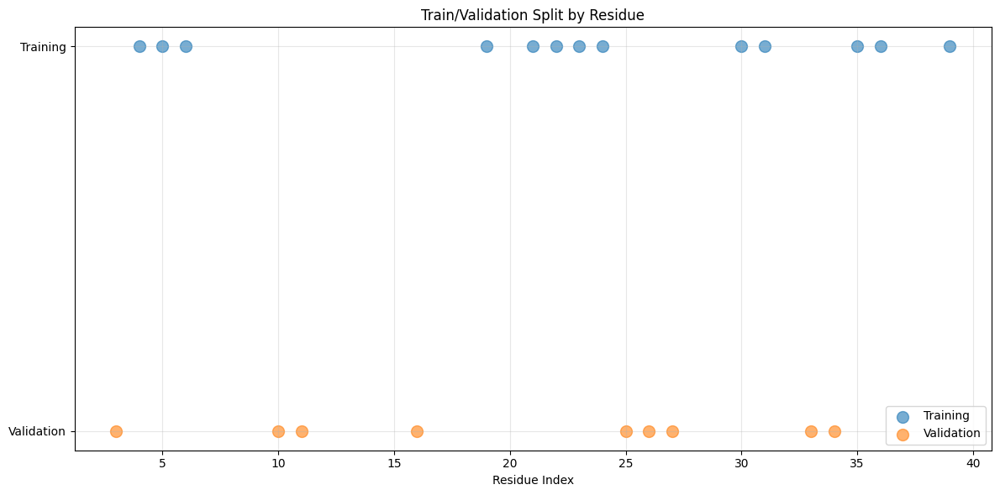

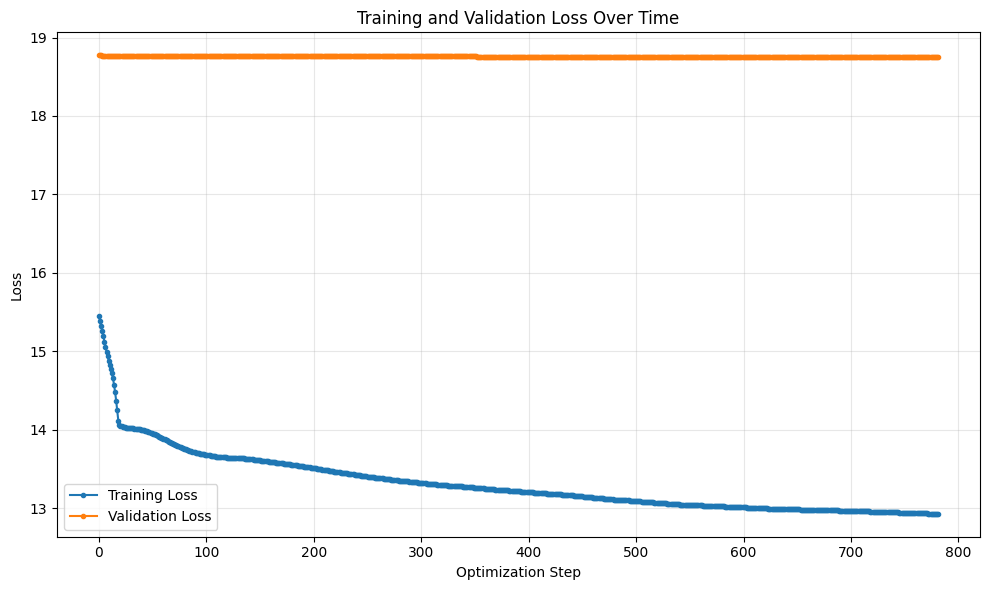

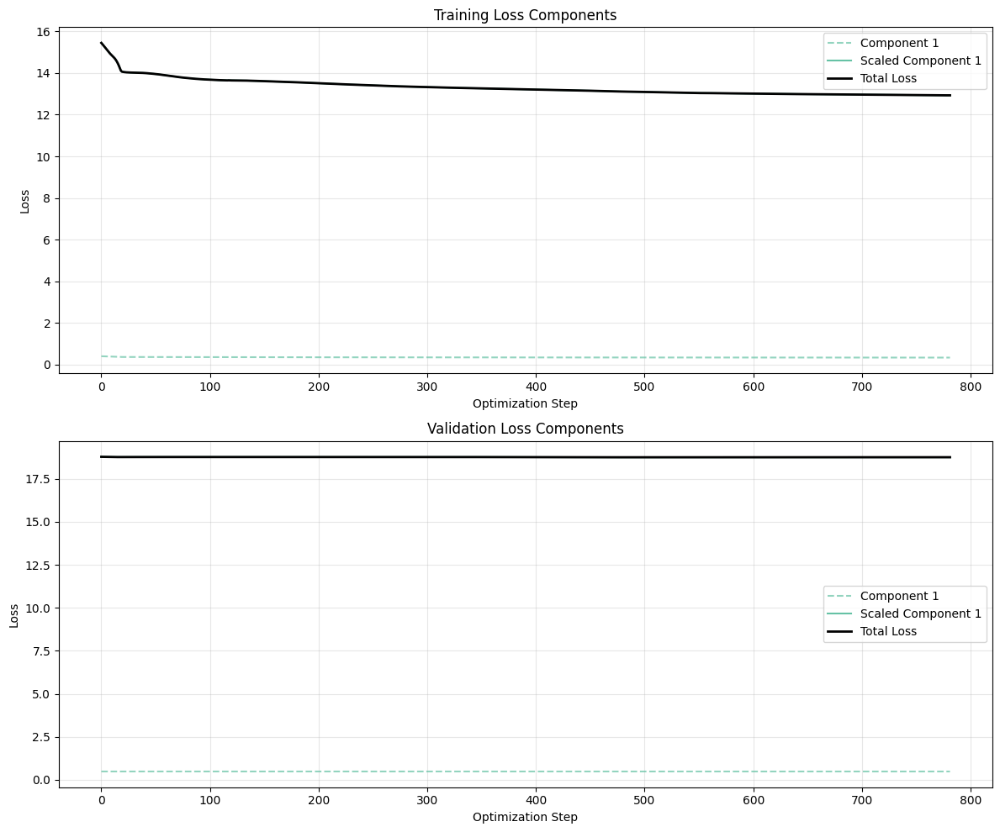

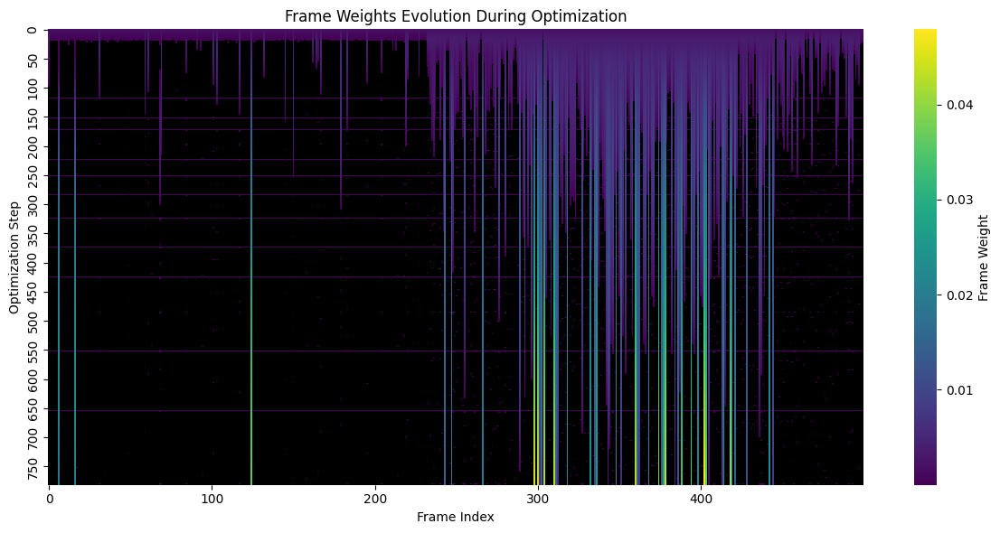

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

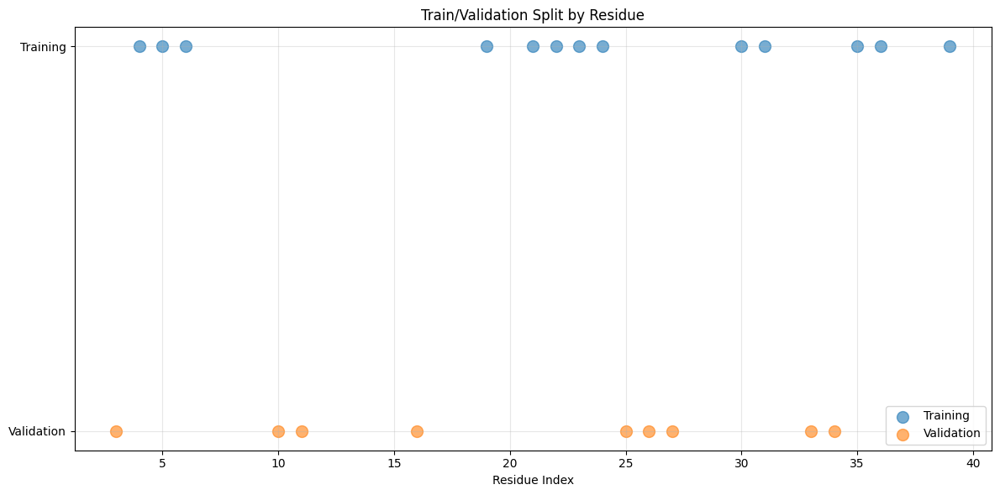

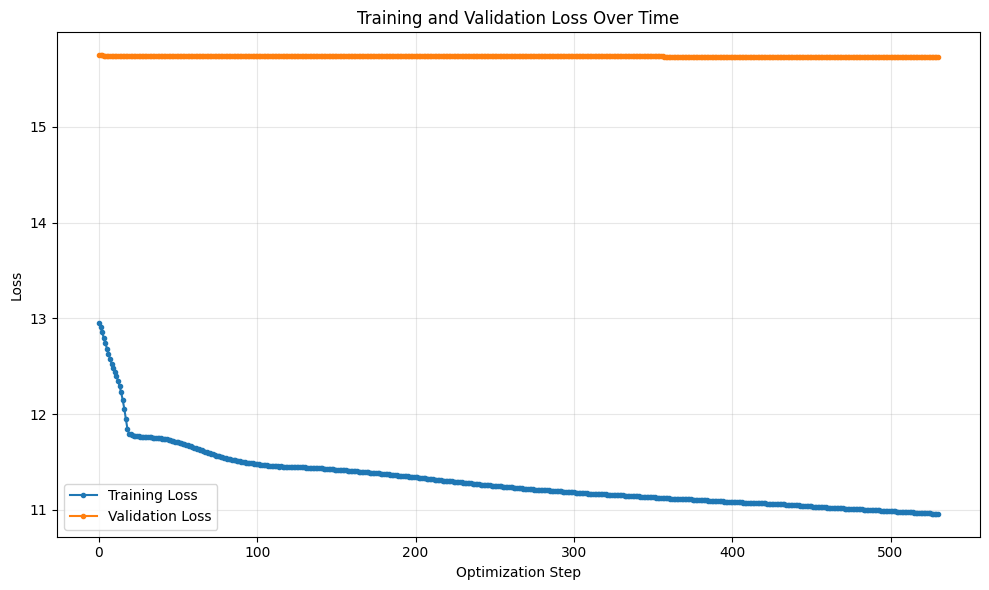

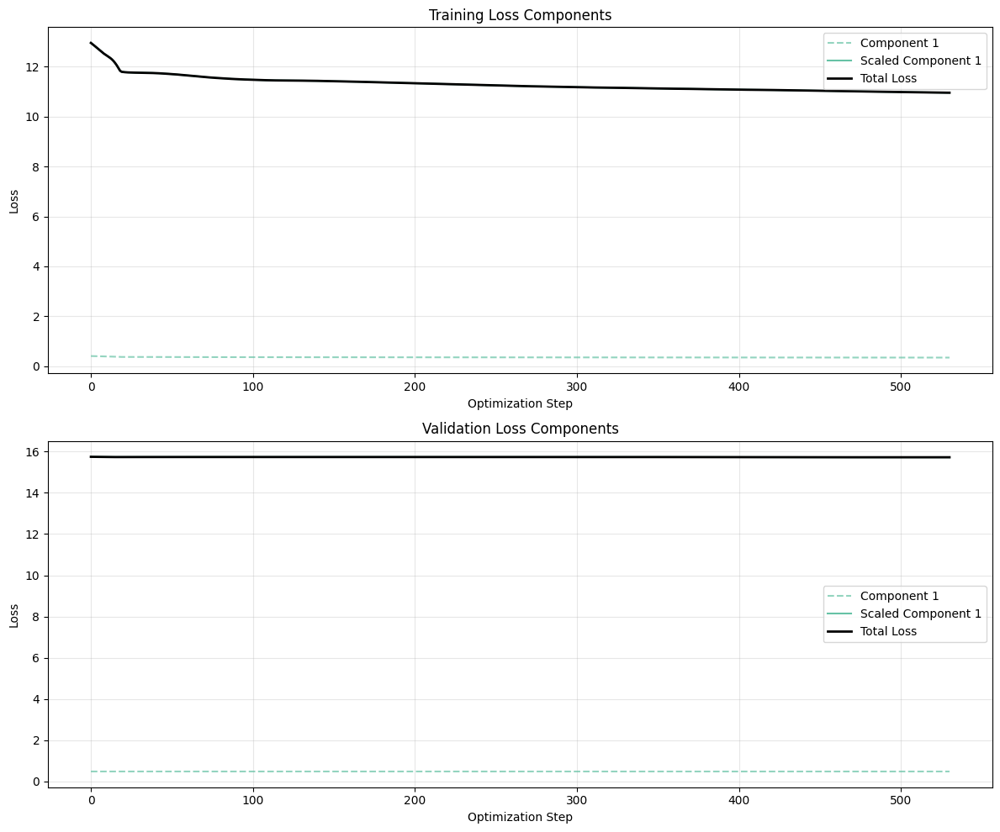

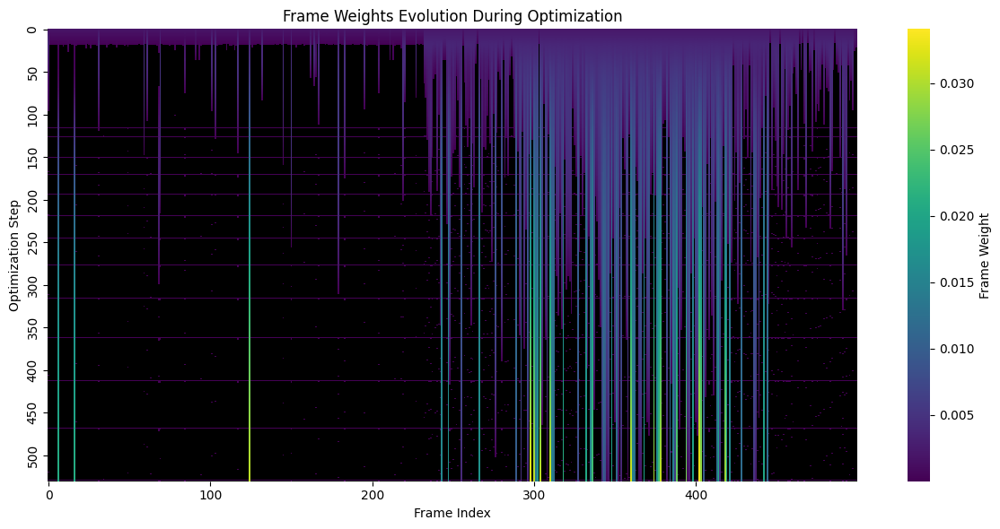

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

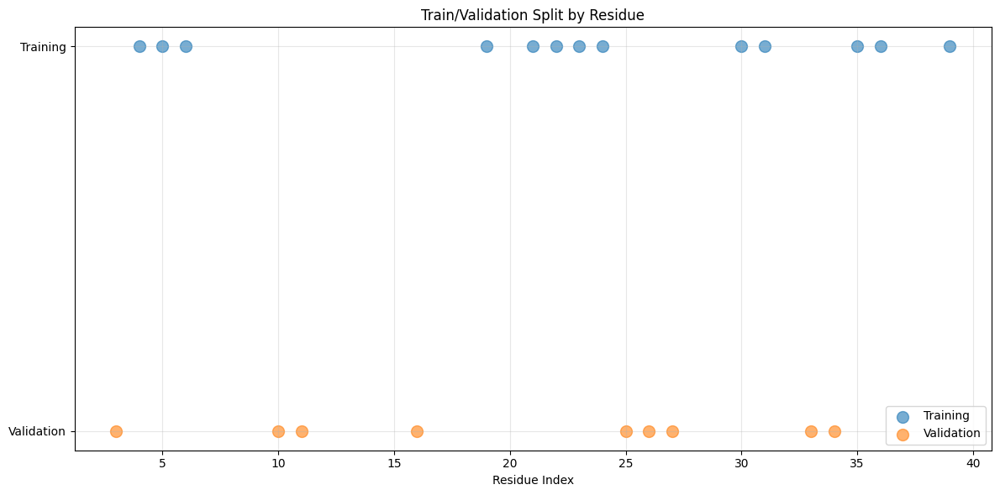

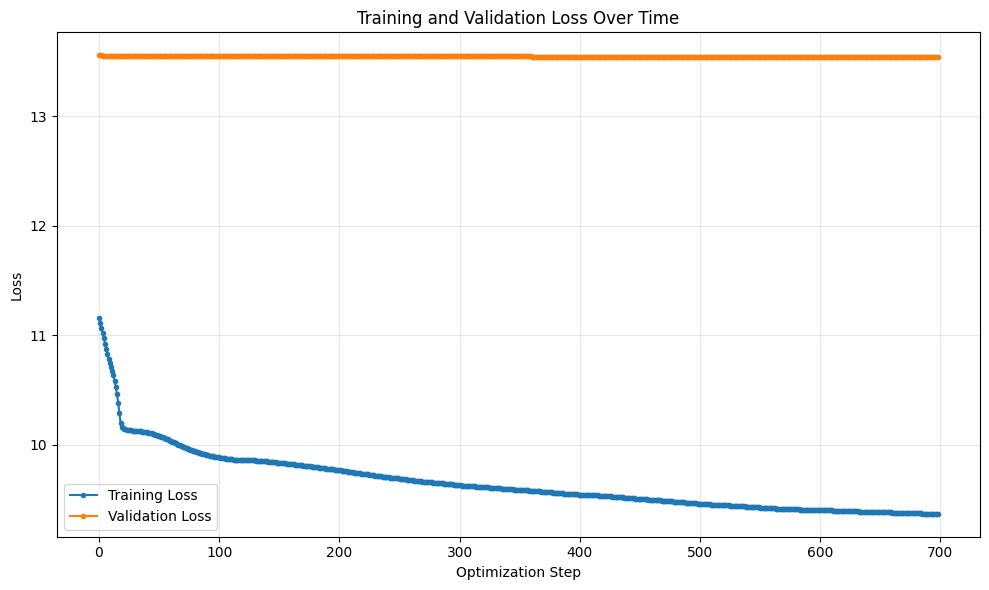

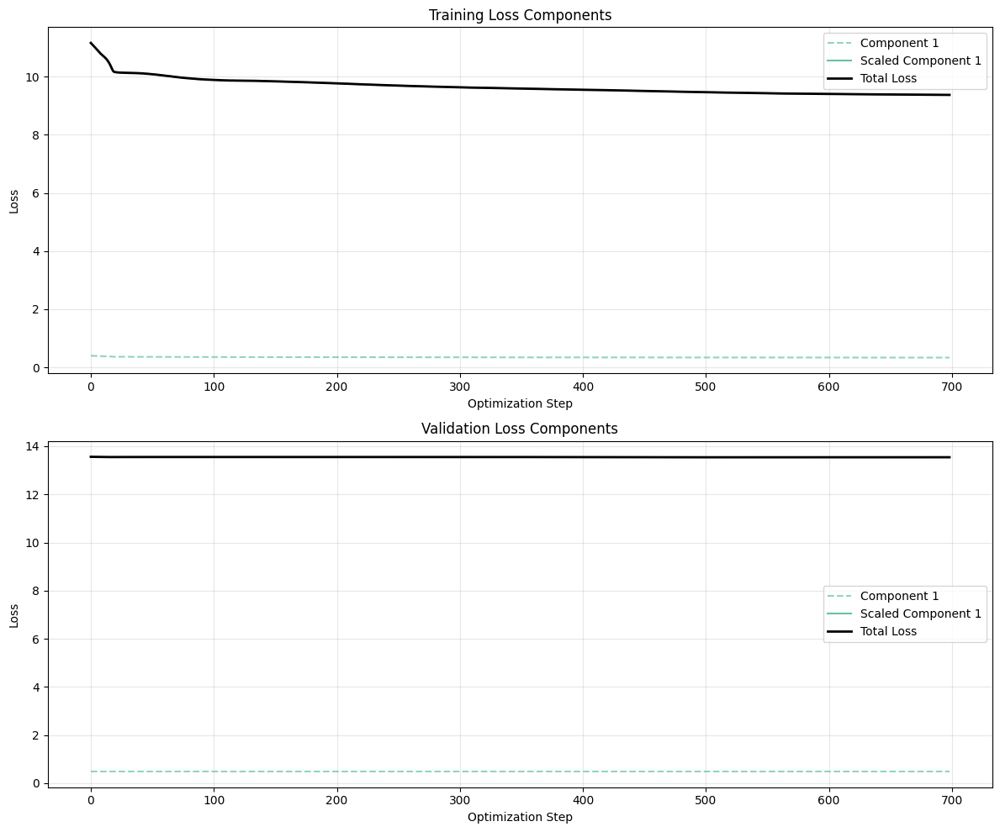

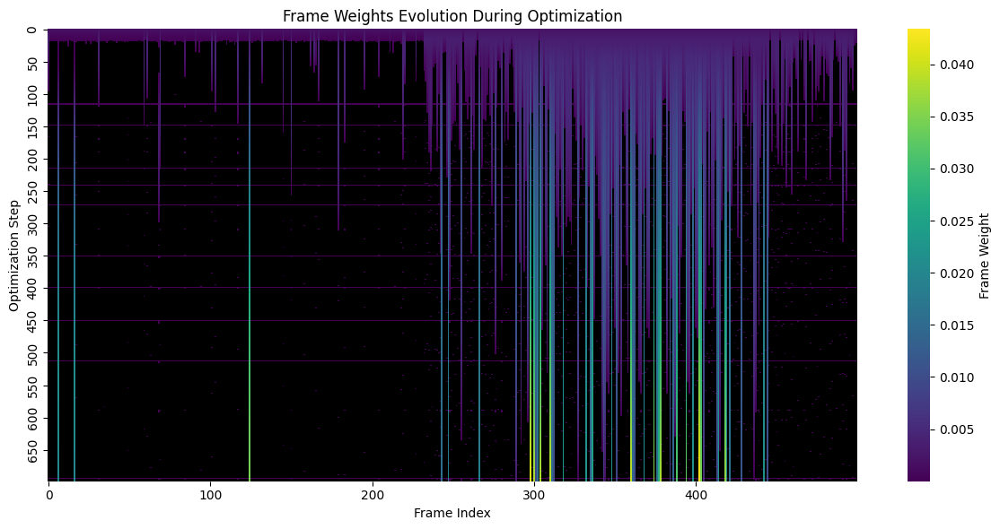

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

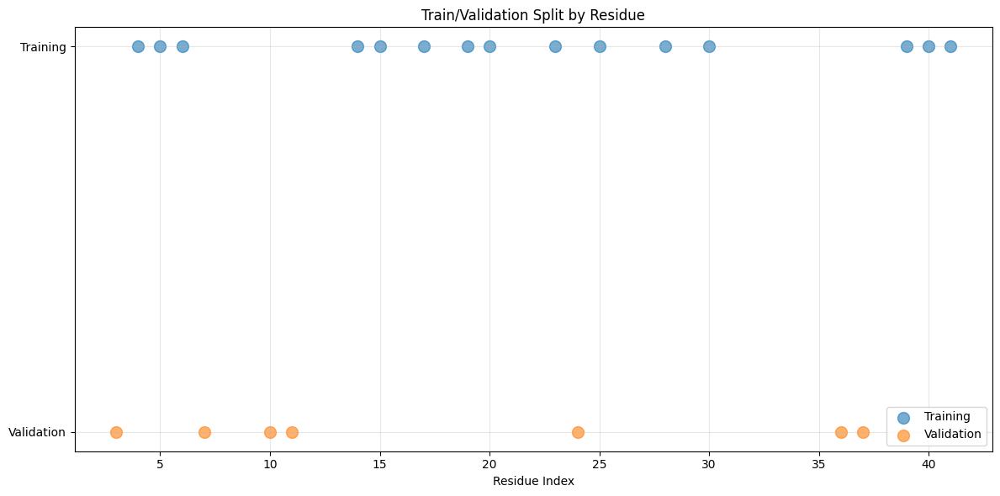

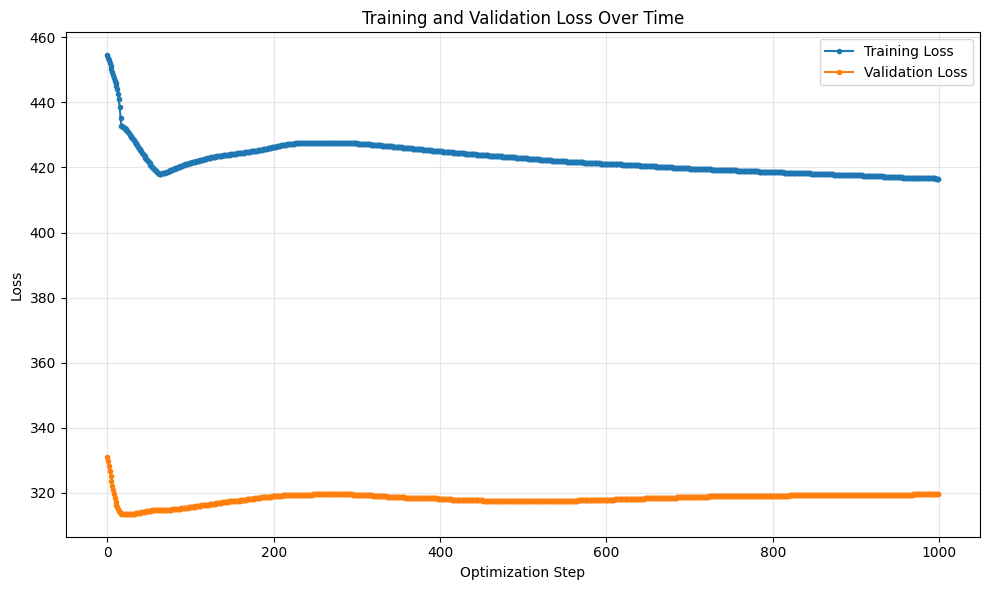

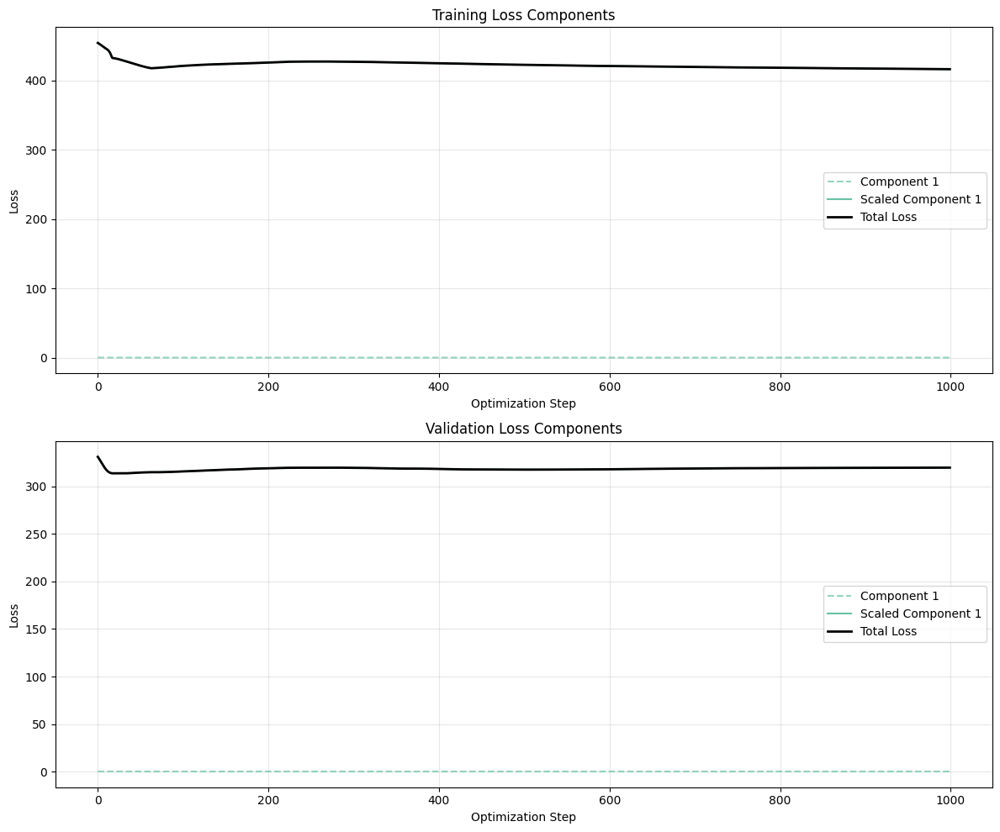

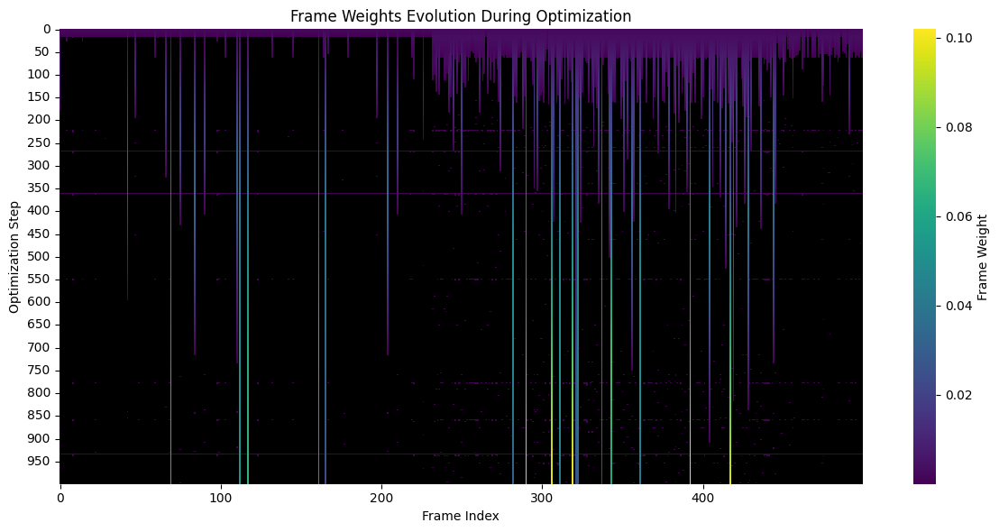

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

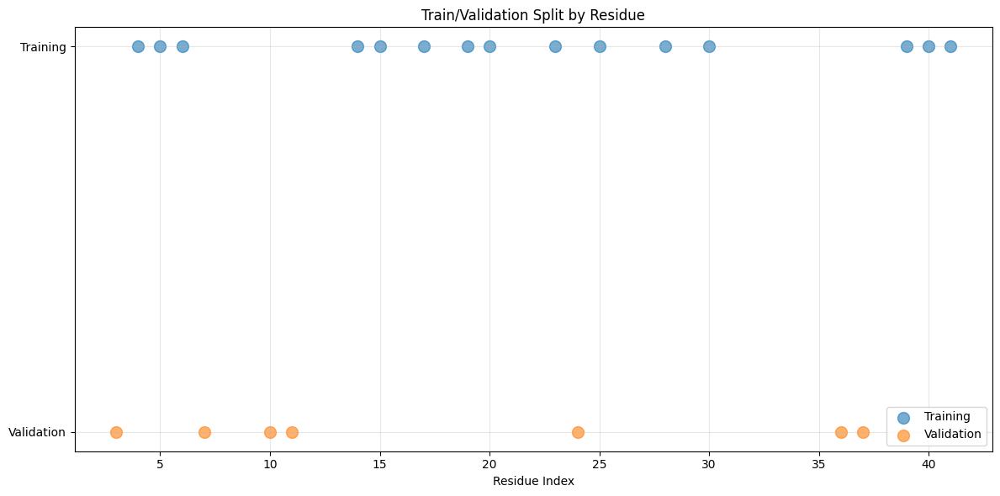

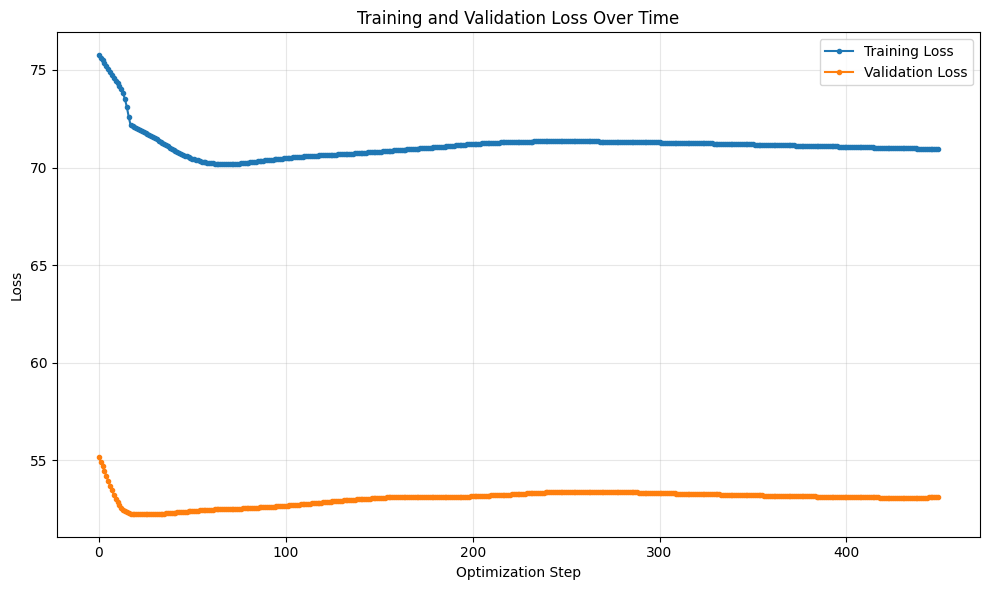

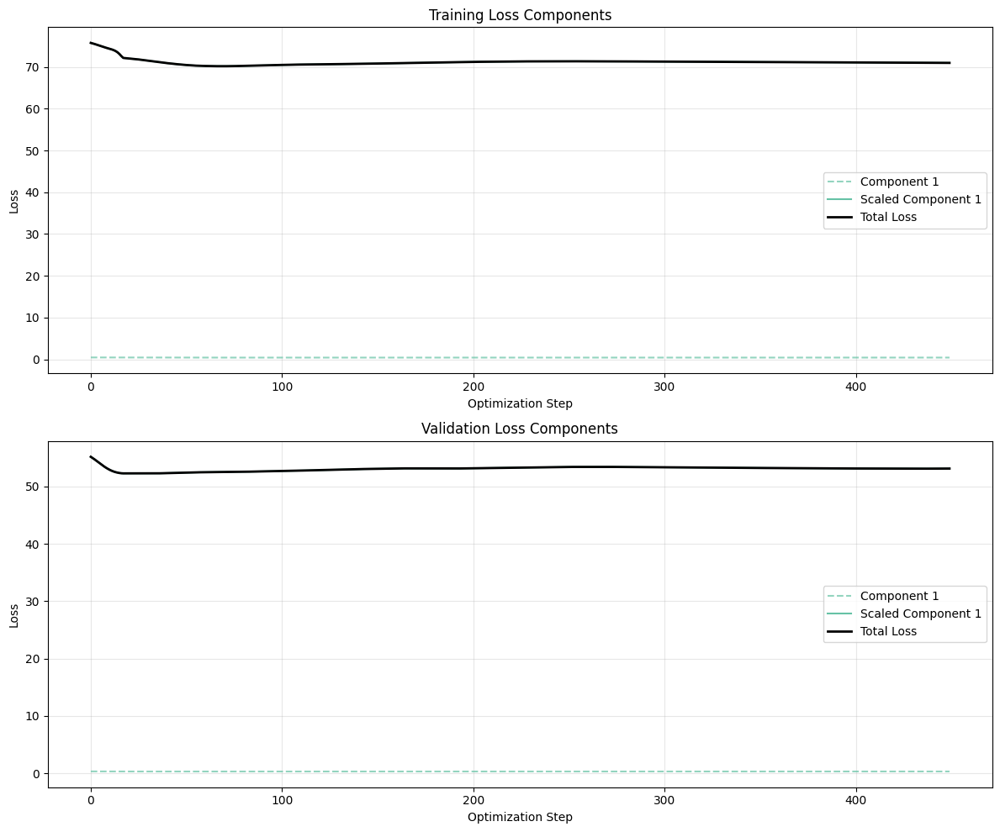

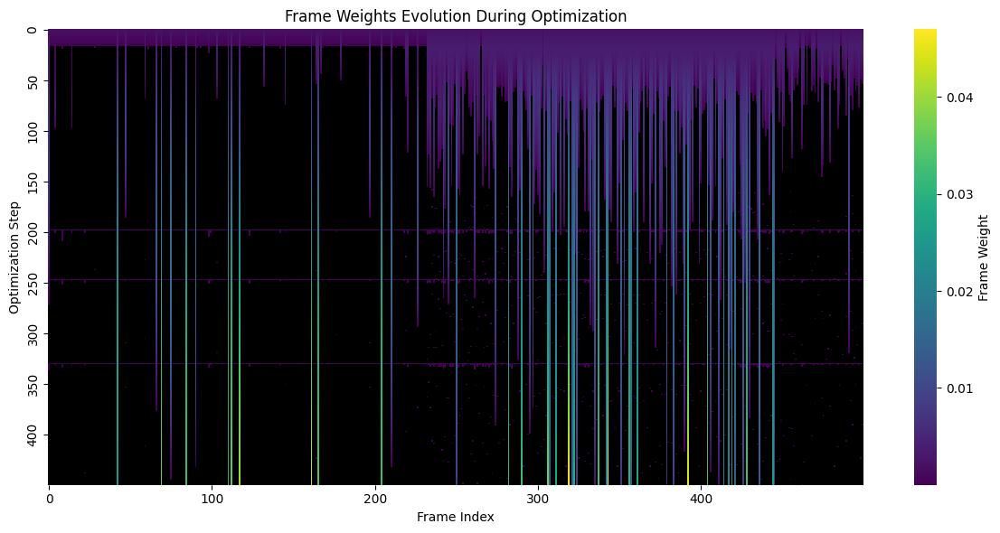

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

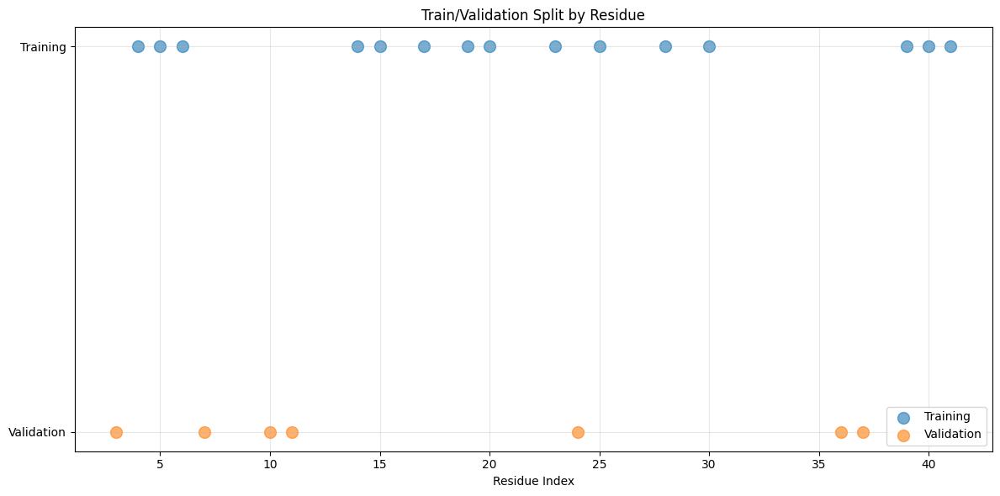

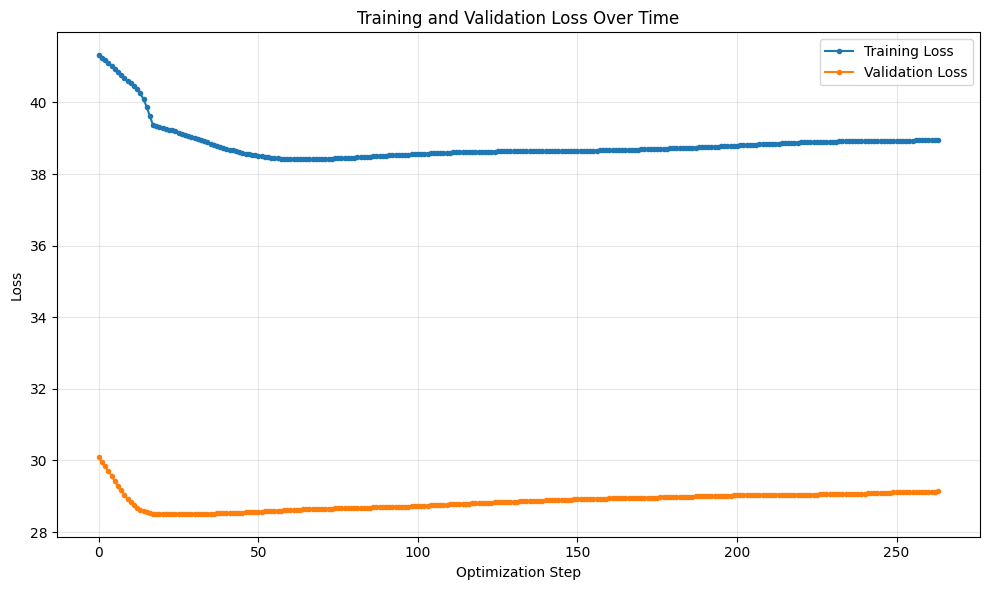

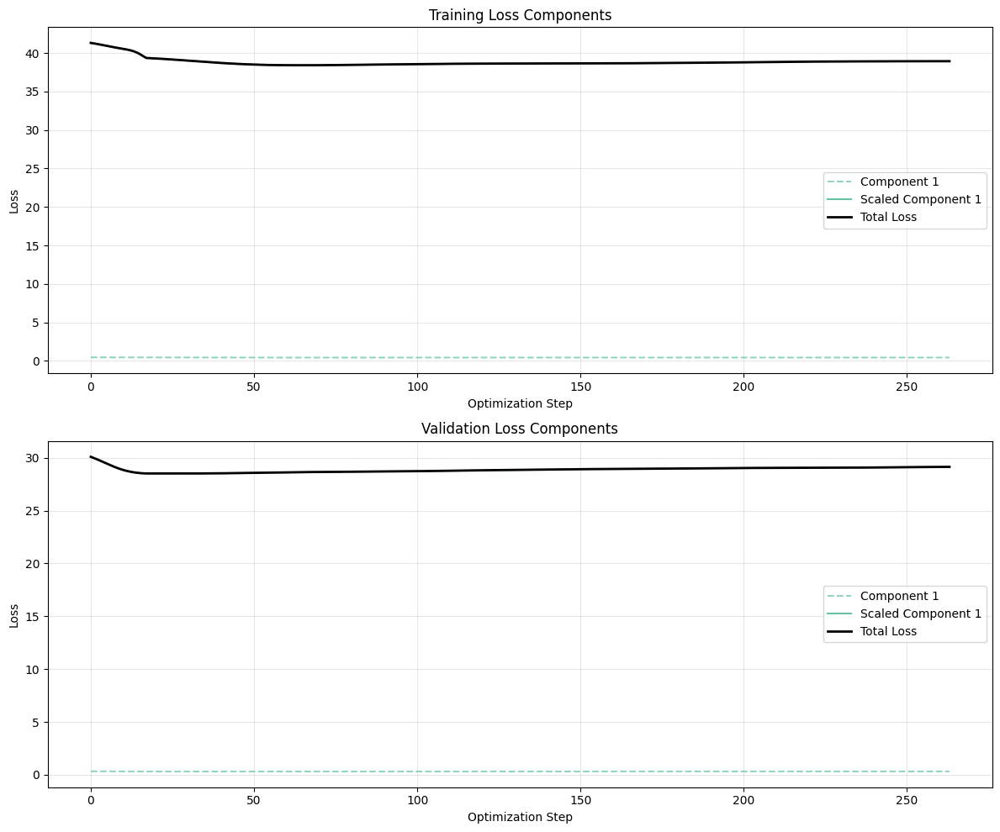

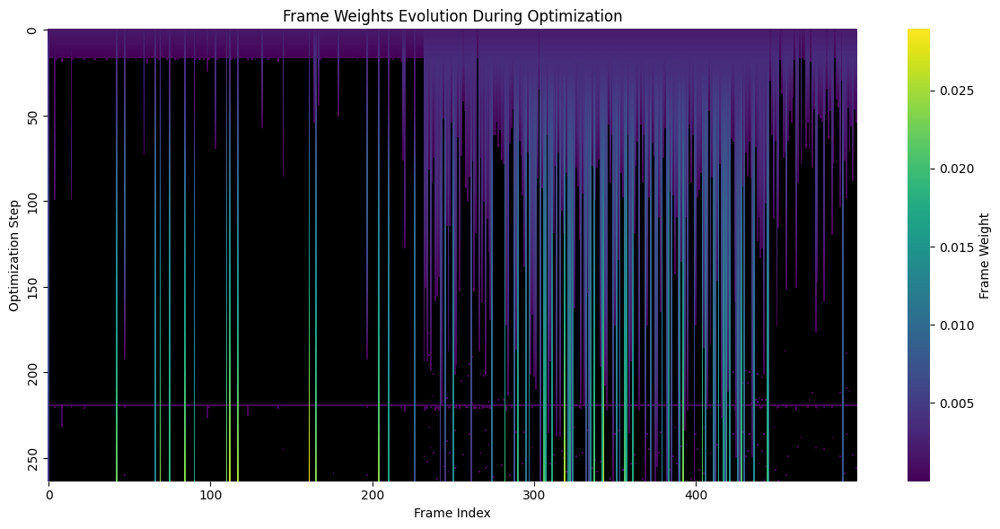

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

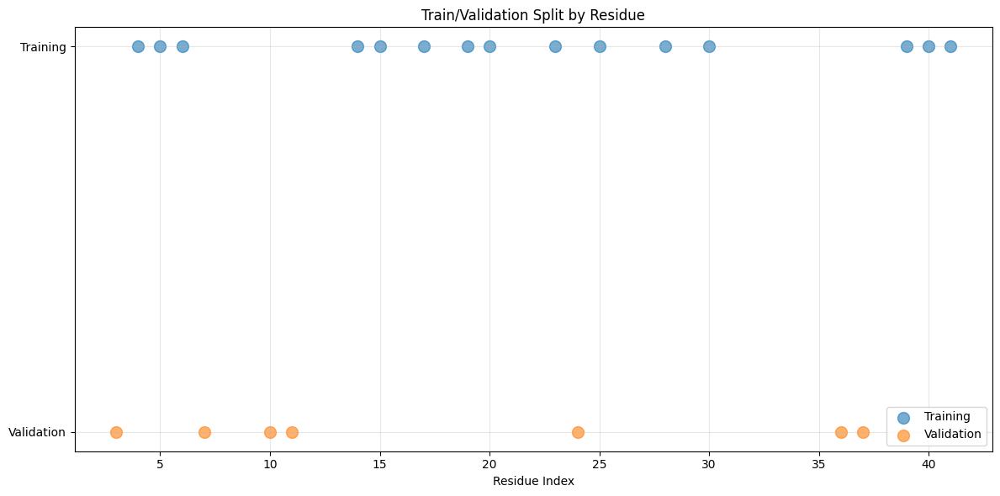

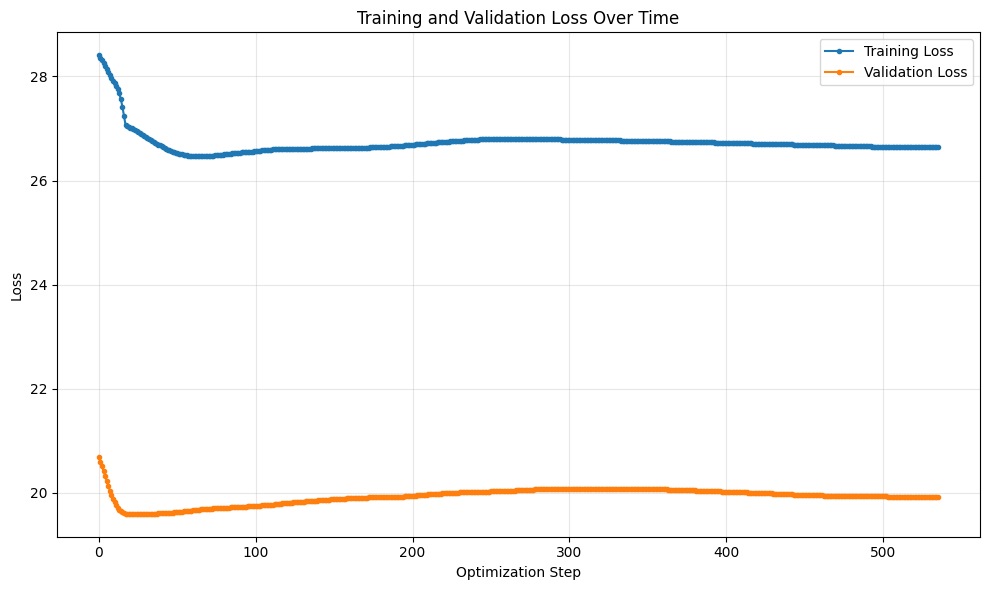

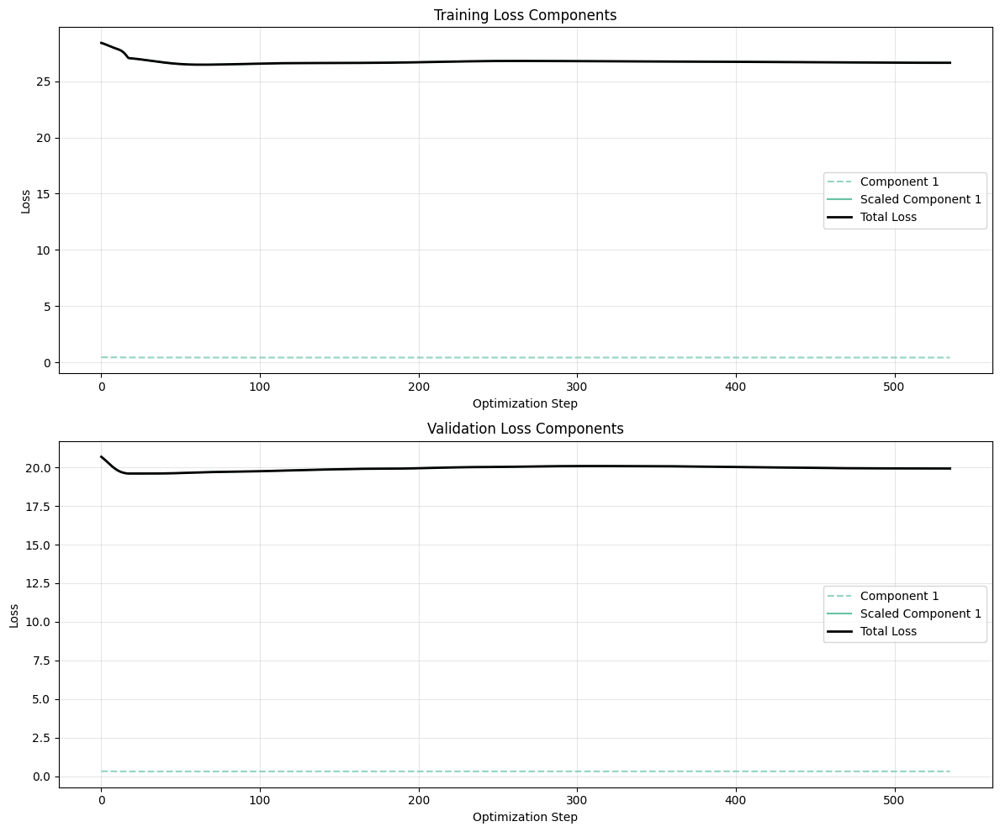

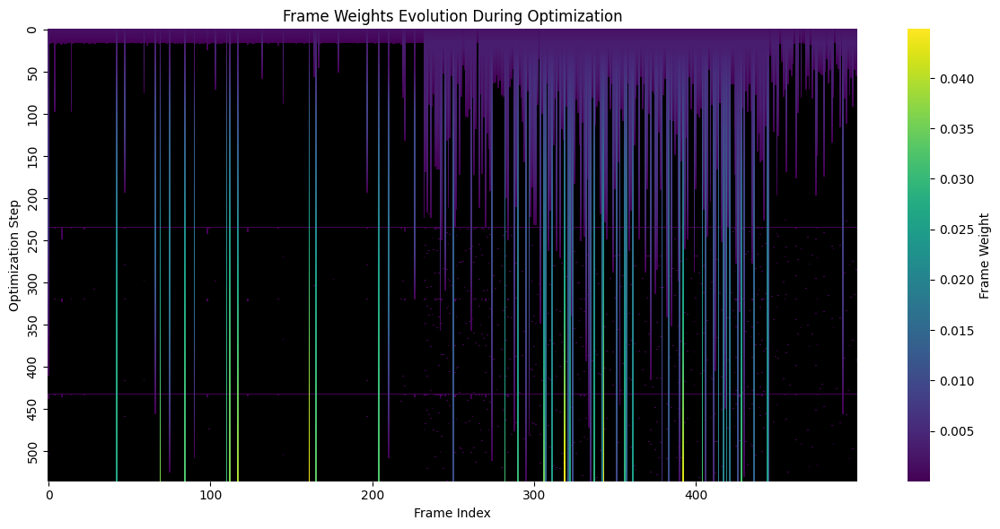

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

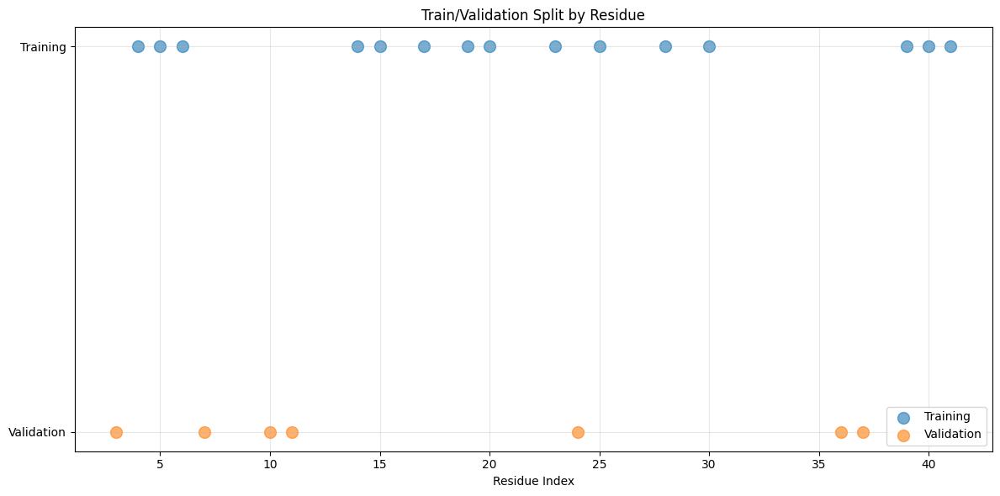

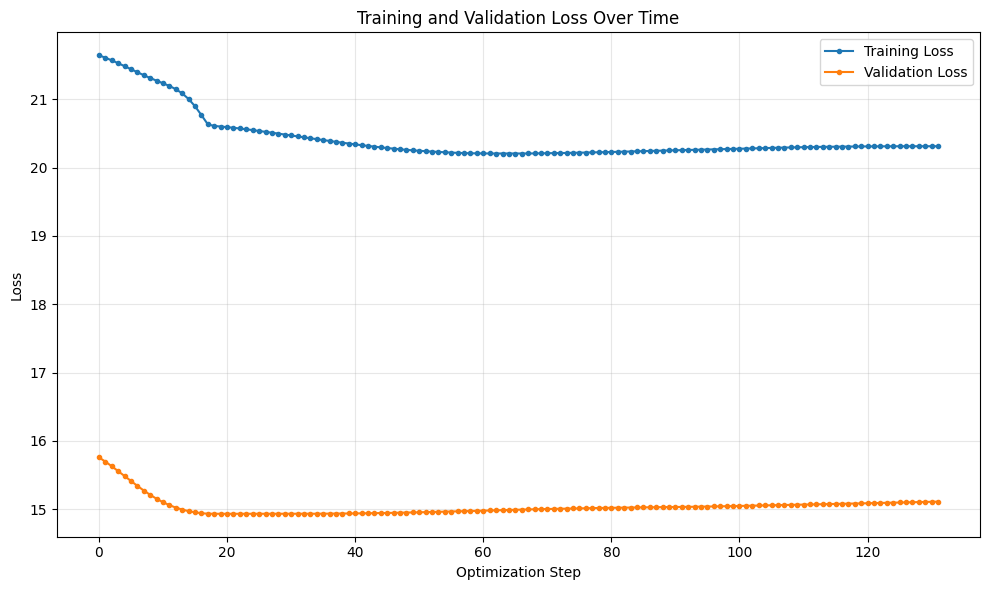

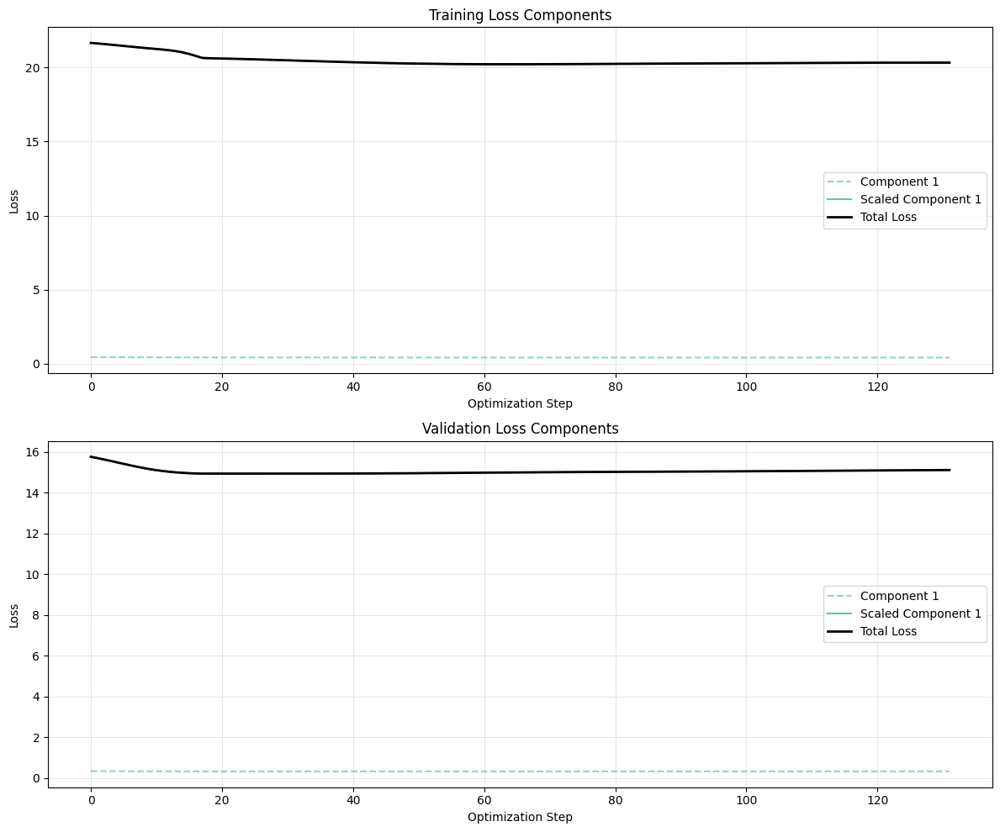

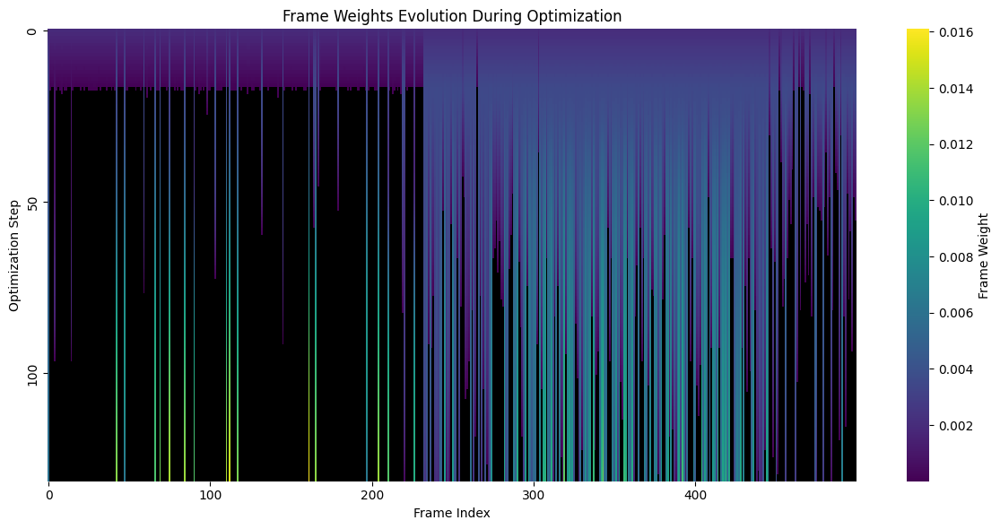

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

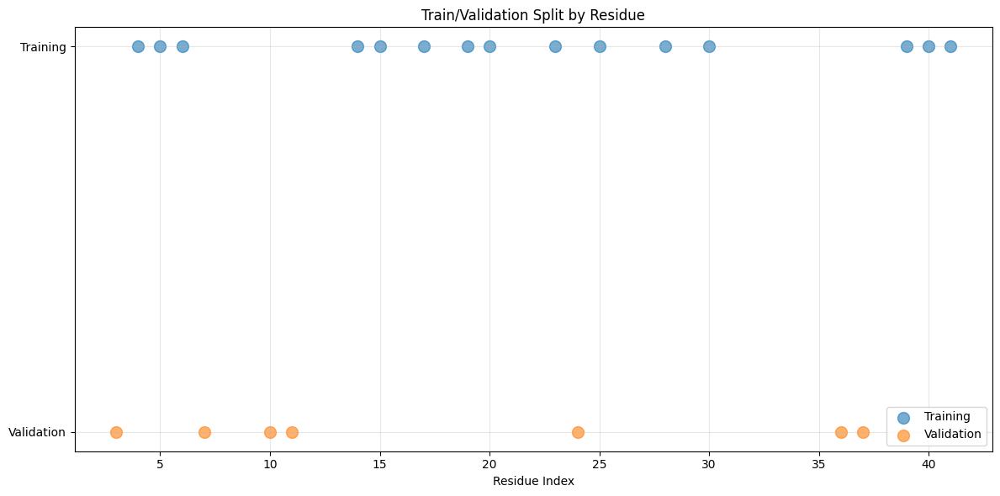

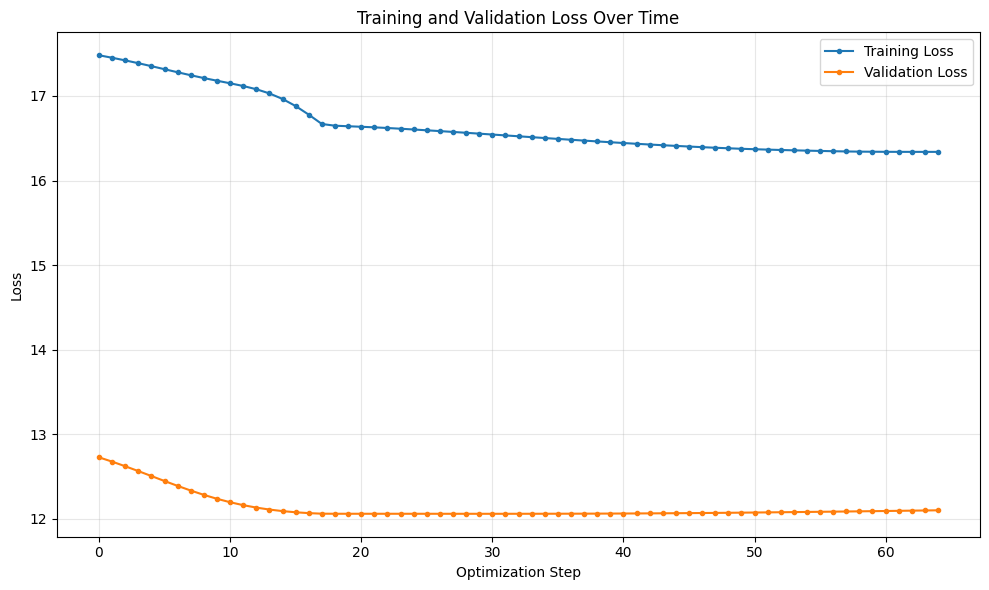

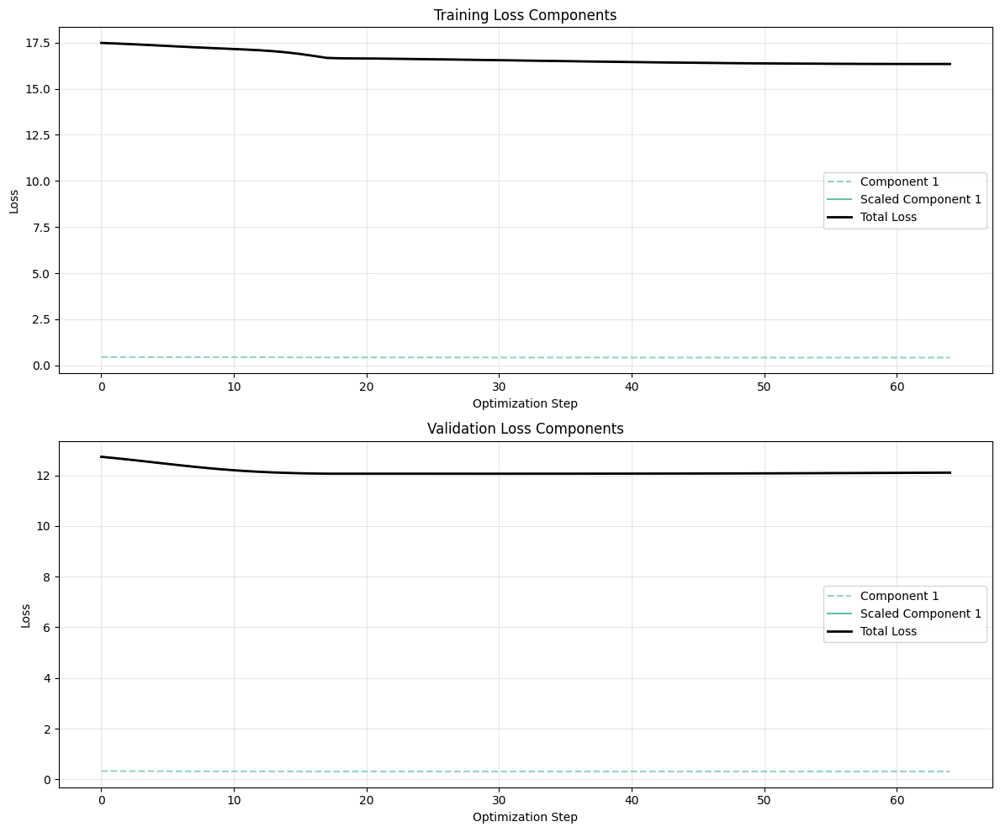

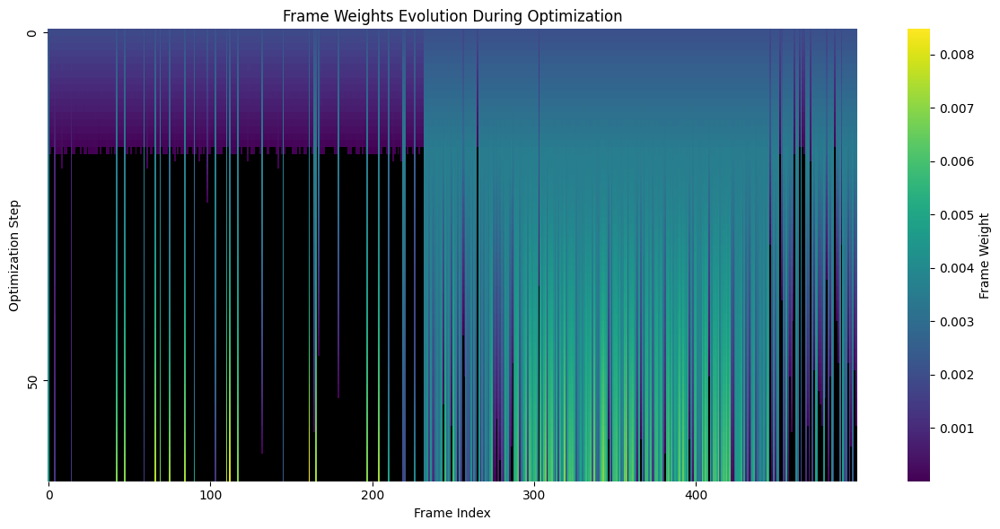

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

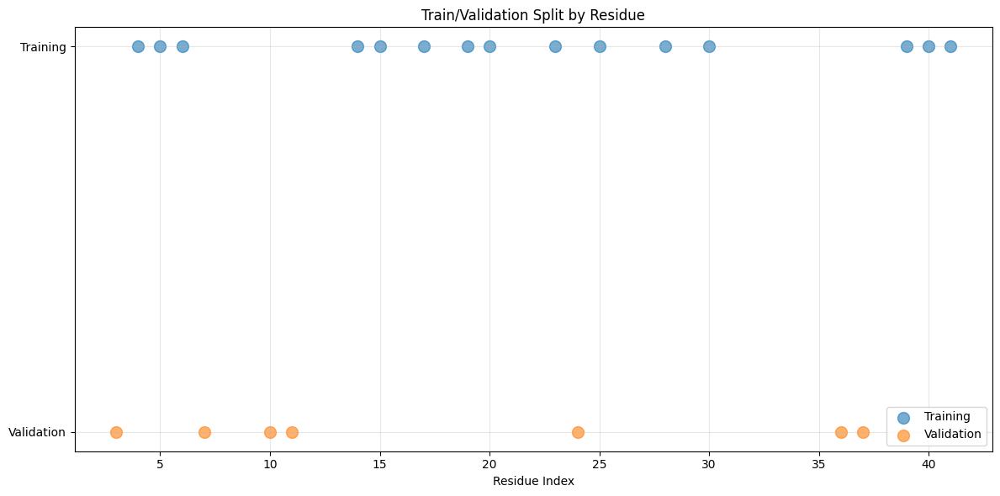

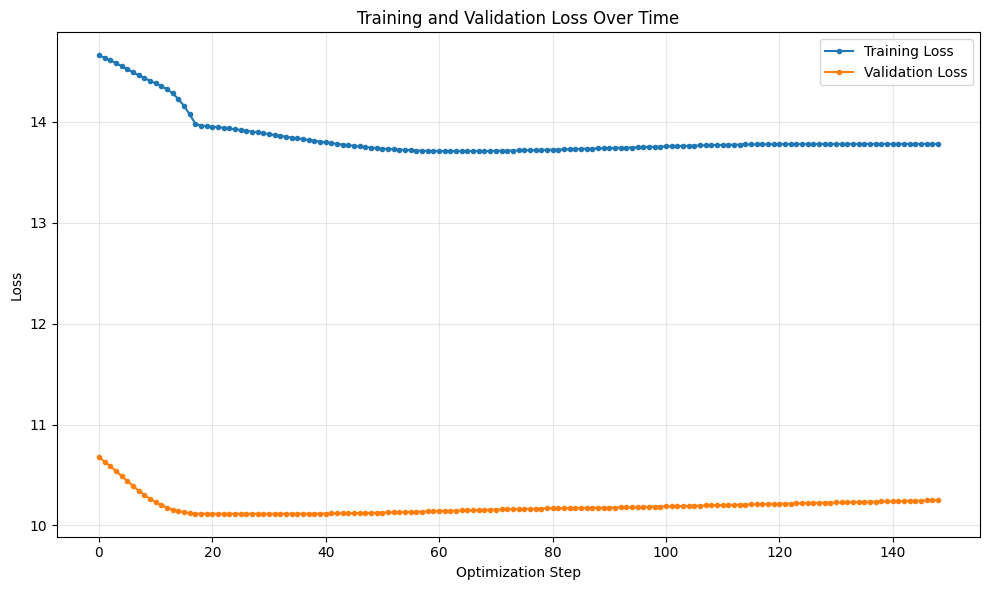

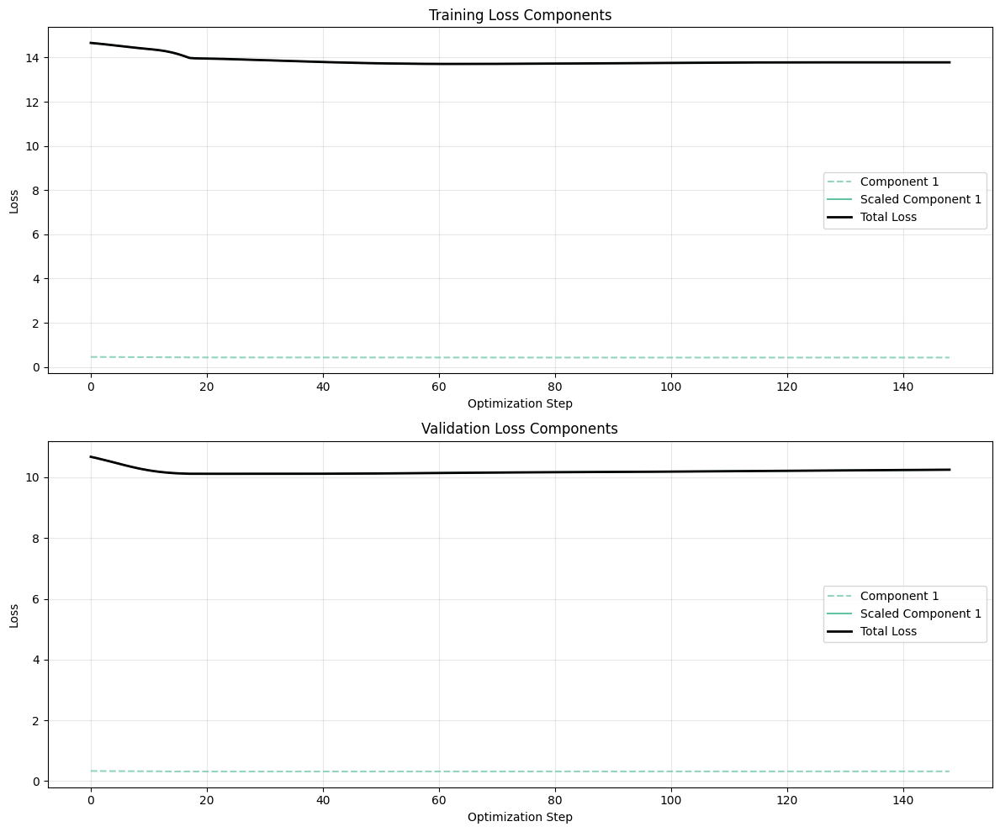

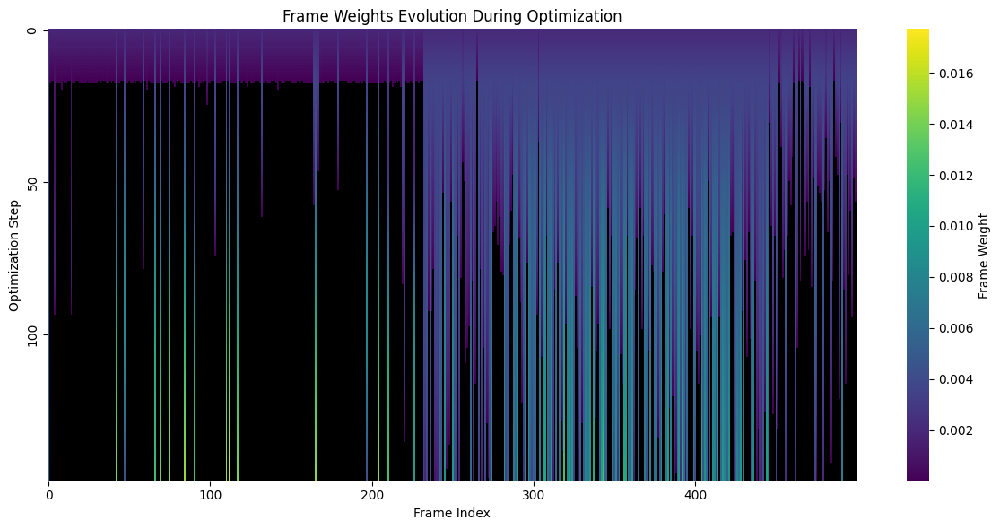

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

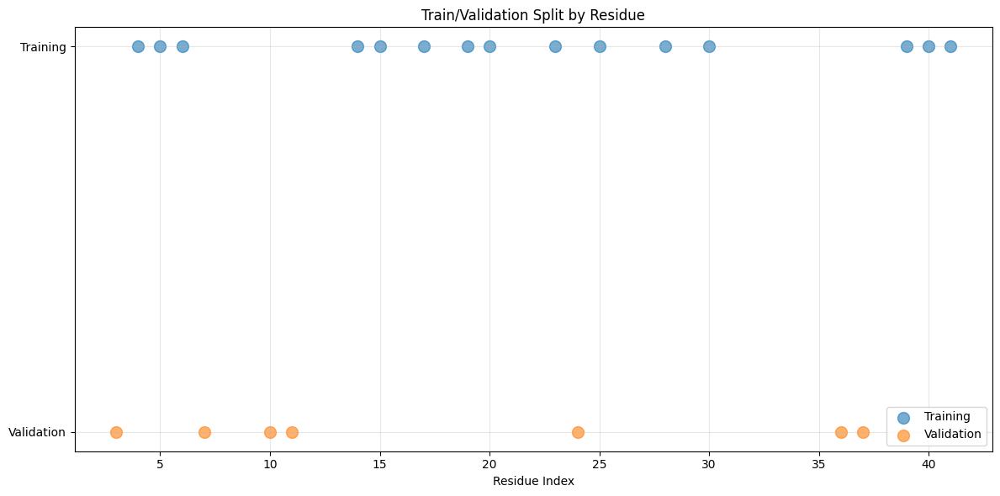

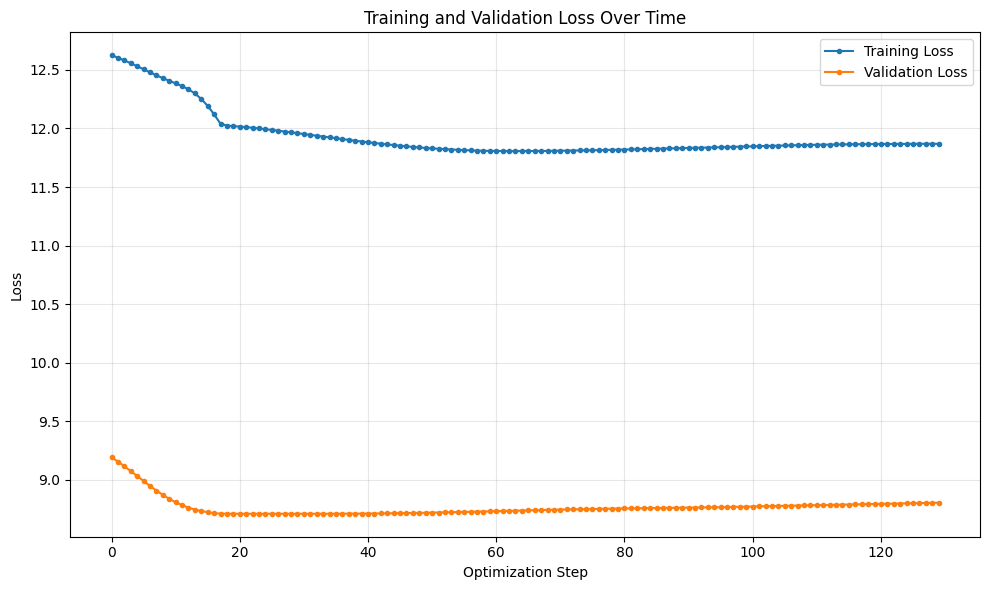

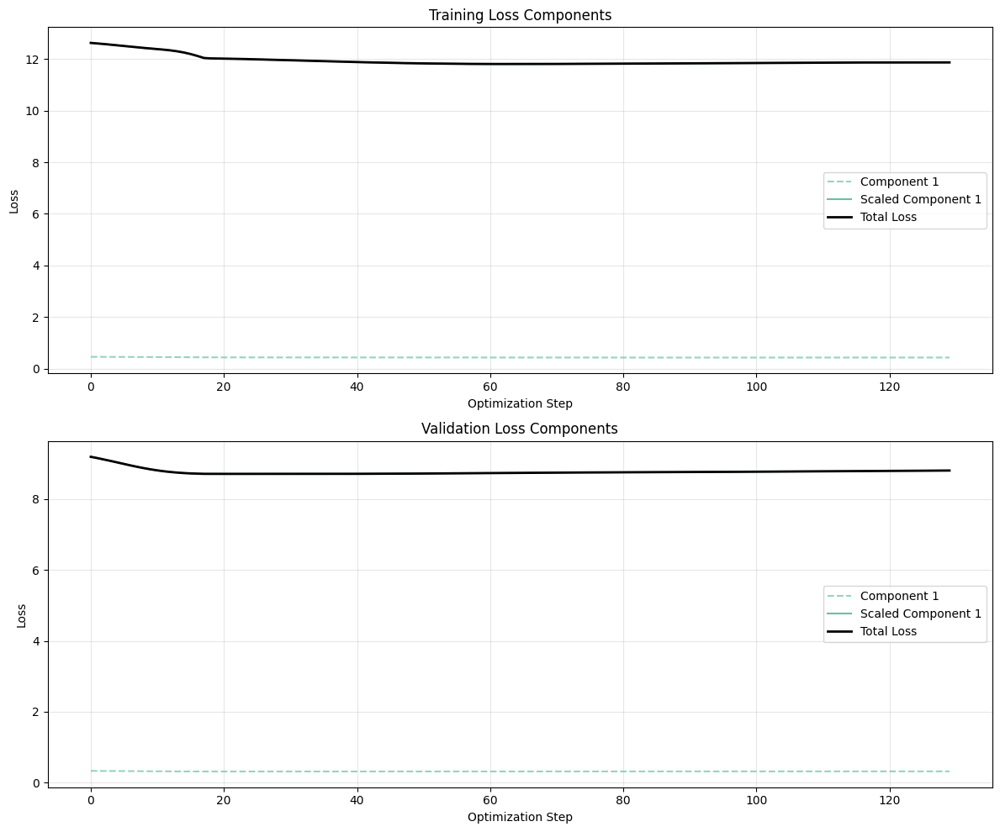

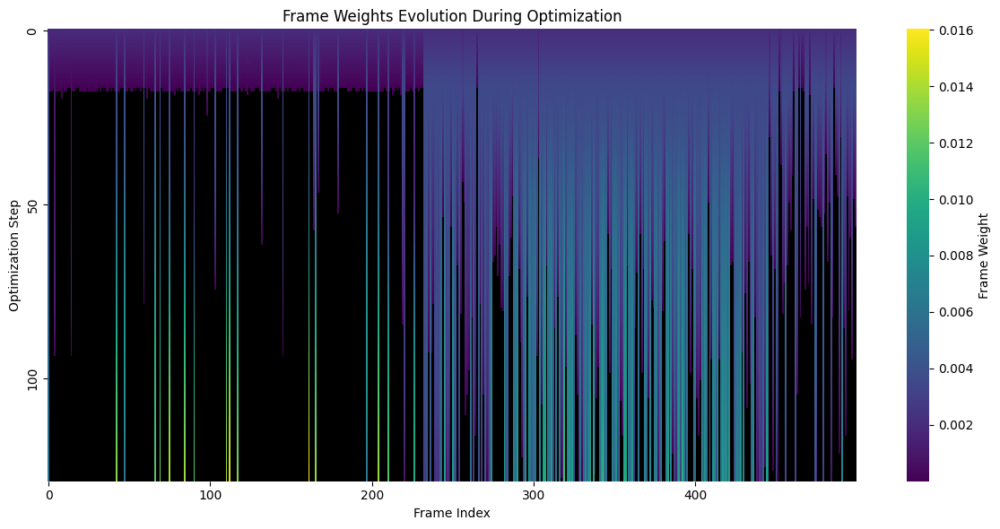

In [23]:

# Run optimization for each dataset and replicate
print("Running optimization experiments...")
# break
optimization_results = run_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates)


In [24]:
test_losses = compute_test_losses(optimization_results, datasets)


Computing test losses for Dataset Seed 1, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 1000/1000 [00:37<00:00, 26.84it/s]


Computing test losses for Dataset Seed 1, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 1000/1000 [00:39<00:00, 25.42it/s]


Computing test losses for Dataset Seed 1, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 1000/1000 [00:39<00:00, 25.45it/s]


Computing test losses for Dataset Seed 1, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 1000/1000 [00:37<00:00, 26.52it/s]


Computing test losses for Dataset Seed 1, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 1000/1000 [00:37<00:00, 26.41it/s]


Computing test losses for Dataset Seed 1, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 1000/1000 [00:38<00:00, 25.98it/s]


Computing test losses for Dataset Seed 1, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 1000/1000 [00:40<00:00, 24.98it/s]


Computing test losses for Dataset Seed 1, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 1000/1000 [00:39<00:00, 25.18it/s]


Computing test losses for Dataset Seed 2, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 1000/1000 [00:42<00:00, 23.35it/s]


Computing test losses for Dataset Seed 2, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 1000/1000 [00:43<00:00, 23.16it/s]


Computing test losses for Dataset Seed 2, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 1000/1000 [00:41<00:00, 24.14it/s]


Computing test losses for Dataset Seed 2, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 1000/1000 [00:40<00:00, 24.49it/s]


Computing test losses for Dataset Seed 2, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 731/731 [00:29<00:00, 25.03it/s]


Computing test losses for Dataset Seed 2, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 782/782 [00:31<00:00, 25.00it/s]


Computing test losses for Dataset Seed 2, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 531/531 [00:21<00:00, 24.49it/s]


Computing test losses for Dataset Seed 2, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 699/699 [00:28<00:00, 24.41it/s]


Computing test losses for Dataset Seed 3, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 1000/1000 [00:40<00:00, 24.84it/s]


Computing test losses for Dataset Seed 3, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 450/450 [00:17<00:00, 25.32it/s]


Computing test losses for Dataset Seed 3, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 264/264 [00:10<00:00, 25.17it/s]


Computing test losses for Dataset Seed 3, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 536/536 [00:21<00:00, 25.09it/s]


Computing test losses for Dataset Seed 3, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 132/132 [00:05<00:00, 24.82it/s]


Computing test losses for Dataset Seed 3, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 65/65 [00:02<00:00, 25.72it/s]


Computing test losses for Dataset Seed 3, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 149/149 [00:05<00:00, 25.57it/s]


Computing test losses for Dataset Seed 3, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 130/130 [00:05<00:00, 24.75it/s]


Generating PCA visualization...


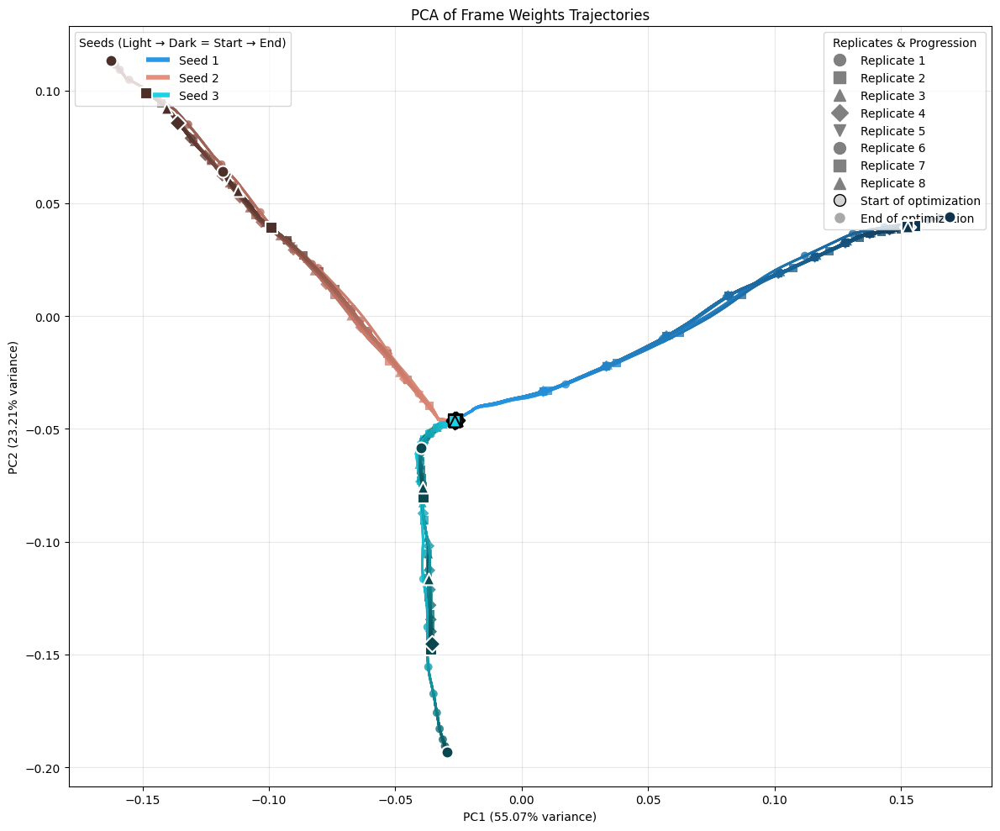

In [25]:

# Visualize PCA trajectories
print("Generating PCA visualization...")
pca_fig = visualize_pca_trajectories(optimization_results, n_seeds, n_replicates)
# save_pca_visualization(pca_fig)
plt.show()

Generating 3D PCA visualization with residue-average test loss...


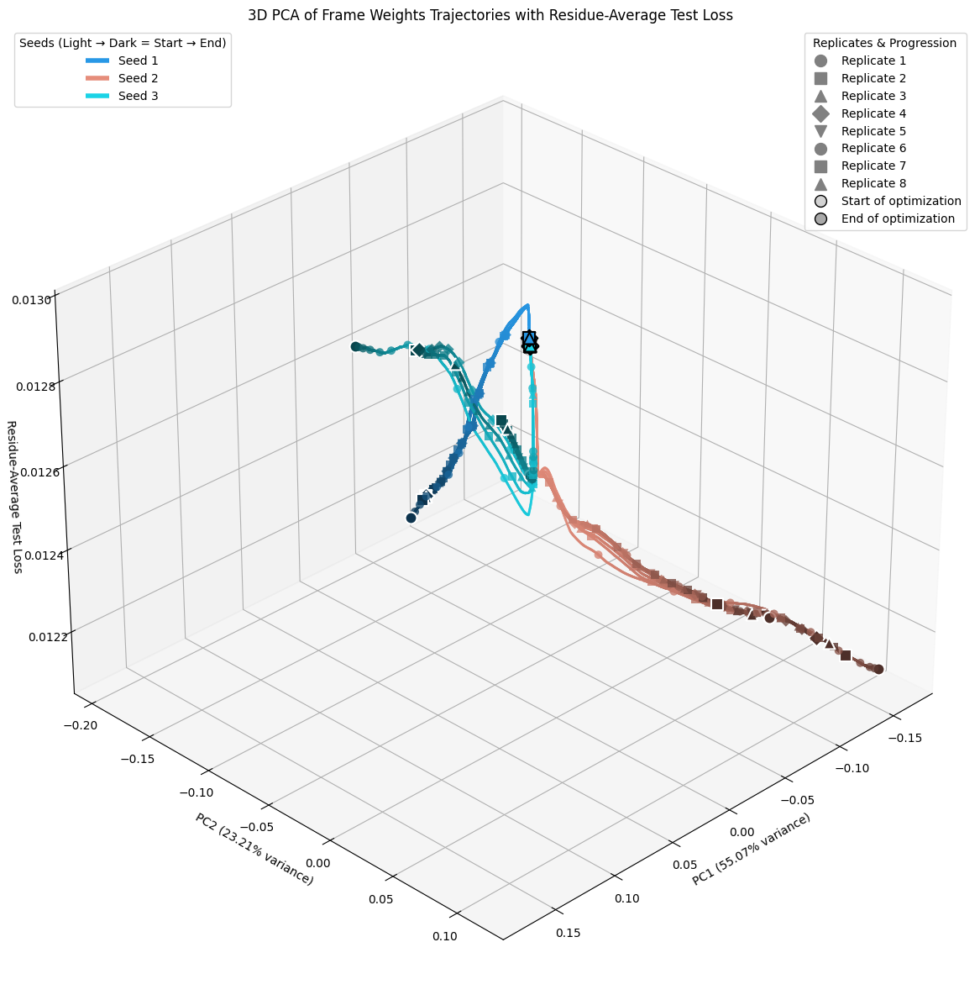

In [26]:
print("Generating 3D PCA visualization with residue-average test loss...")
pca3d_fig = visualize_pca_3d_test_loss(optimization_results, test_losses, n_seeds, n_replicates)
plt.show()

Performing t-SNE with perplexity=30, n_iter=1000...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


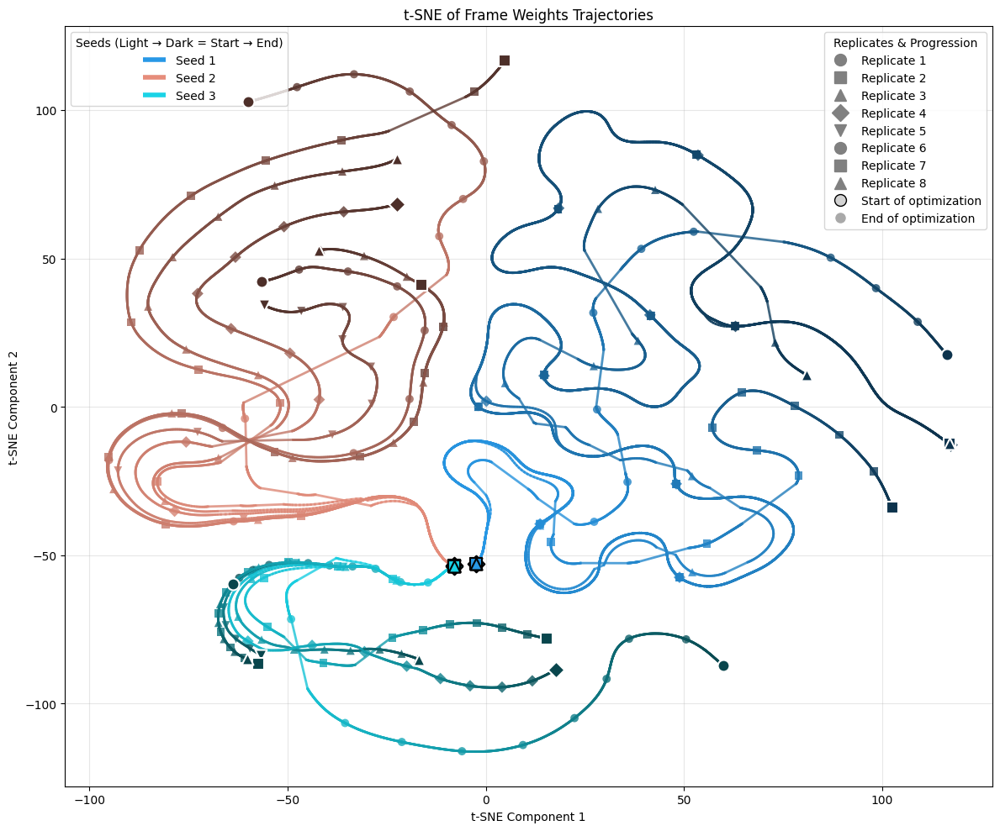

In [27]:
tsne_fig = visualize_tsne_trajectories(optimization_results, n_seeds, n_replicates)


Generating 3D t-SNE visualization with residue-average test loss...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


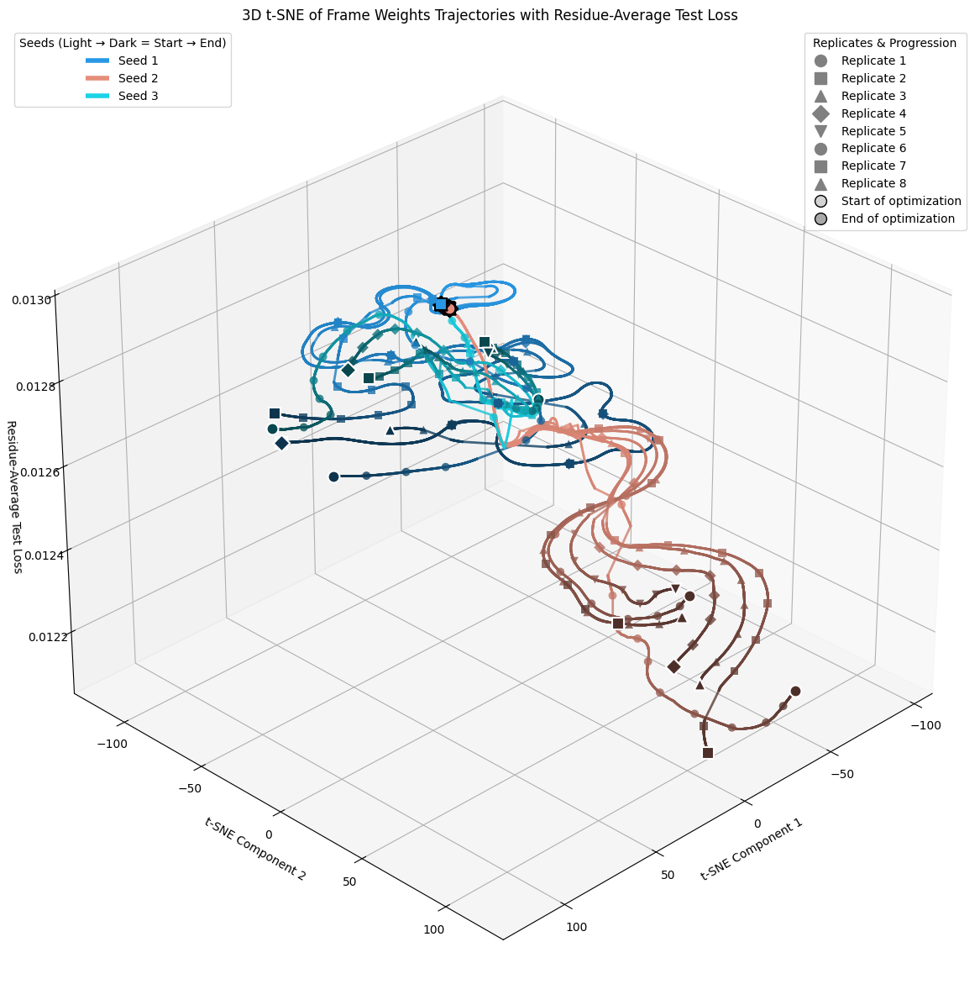

In [28]:

print("Generating 3D t-SNE visualization with residue-average test loss...")
tsne3d_fig = visualize_tsne_3d_loss(optimization_results, test_losses, n_seeds, n_replicates)
plt.show()

Generating validation vs test loss comparison...


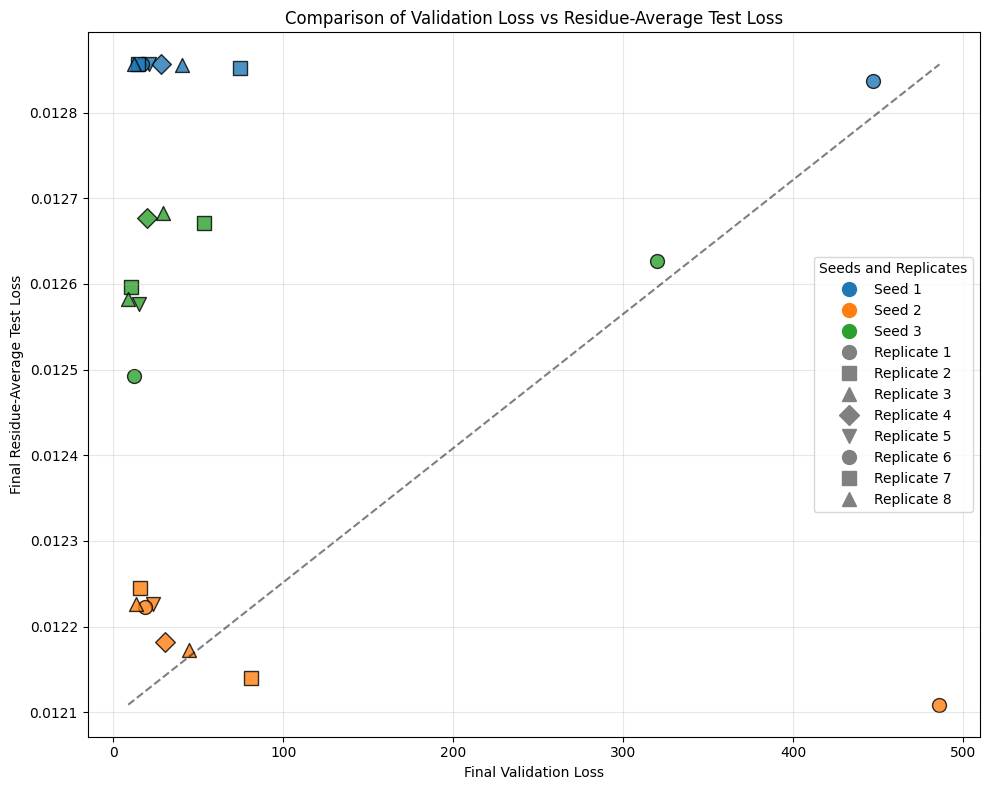

In [29]:
print("Generating validation vs test loss comparison...")
comparison_fig = plot_val_vs_test_loss(optimization_results, test_losses, n_seeds, n_replicates)
plt.show()

In [30]:

# Function to run optimization for each dataset seed and replicate
def run_max_ent_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates):
    """
    Runs optimization for each dataset and replicate with randomized frame weights.
    
    Parameters:
    -----------
    simulation : Simulation
        Simulation object
    datasets : list
        List of dataset objects
    models : list
        List of forward model objects
    opt_settings : OptimiserSettings
        Optimization settings
    n_replicates : int
        Number of replicates per dataset
        
    Returns:
    --------
    results : dict
        Dictionary of optimization results for each dataset and replicate
    """
    results = {}
    rng_key = jax.random.PRNGKey(0)

    prior_params = simulation.params
    
    for i, dataset in enumerate(datasets):
        seed_results = []
        
        for j in range(n_replicates):
            try:
                

                new_params = Simulation_Parameters(
                    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
                    frame_mask=simulation.params.frame_mask,
                    model_parameters=simulation.params.model_parameters,
                    forward_model_weights=jnp.array([1/((1*j)+1), 0.1]),
                    forward_model_scaling=jnp.ones(2),
                    normalise_loss_functions=jnp.zeros(2),
                )

                new_simulation = Simulation(
                    forward_models=simulation.forward_models,
                    input_features=simulation.input_features,
                    params=new_params
                )
                new_simulation.initialise()


                optimiser = OptaxOptimizer(parameter_masks={Optimisable_Parameters.frame_weights})
                # Run optimization
                print(f"Running optimization for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                opt_result = run_optimise(
                    new_simulation,
                    optimizer=optimiser,
                    data_to_fit=(dataset,prior_params),
                    config=opt_settings,
                    forward_models=models,
                    indexes=[0, 0],
                    loss_functions=[hdx_uptake_l2_loss, max_entropy_loss],
                )
                
                # Store the result
                seed_results.append(opt_result)
                
                # Visualize this optimization run
                print(f"Visualizing results for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                visualize_optimization_results(
                    dataset.train.data, 
                    dataset.val.data, 
                    dataset.test.data, 
                    opt_result
                )
            except Exception as e:
                print(f"Error in Dataset Seed {i+1}, Replicate {j+1}: {e}")
                # Add a placeholder for failed runs to maintain indexing
                seed_results.append(None)
        
        results[f"seed_{i}"] = seed_results
    jax.clear_caches()

    return results

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

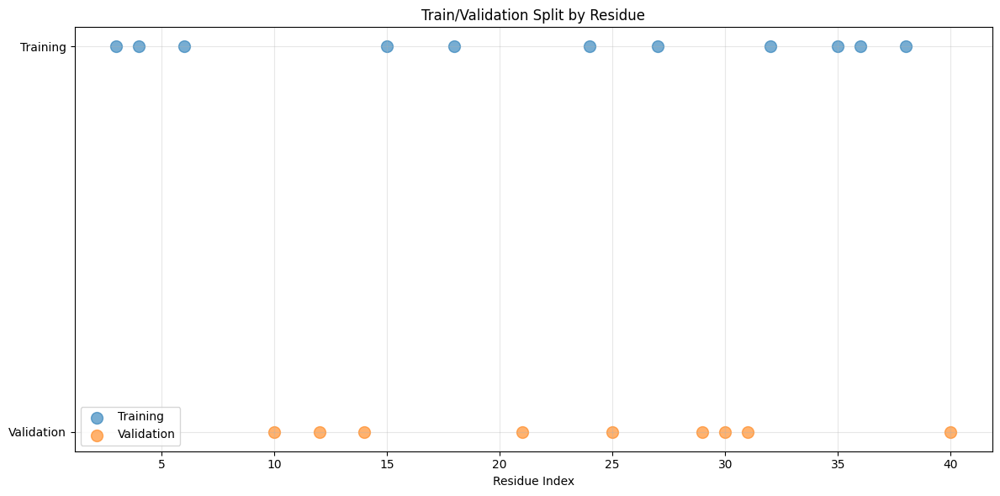

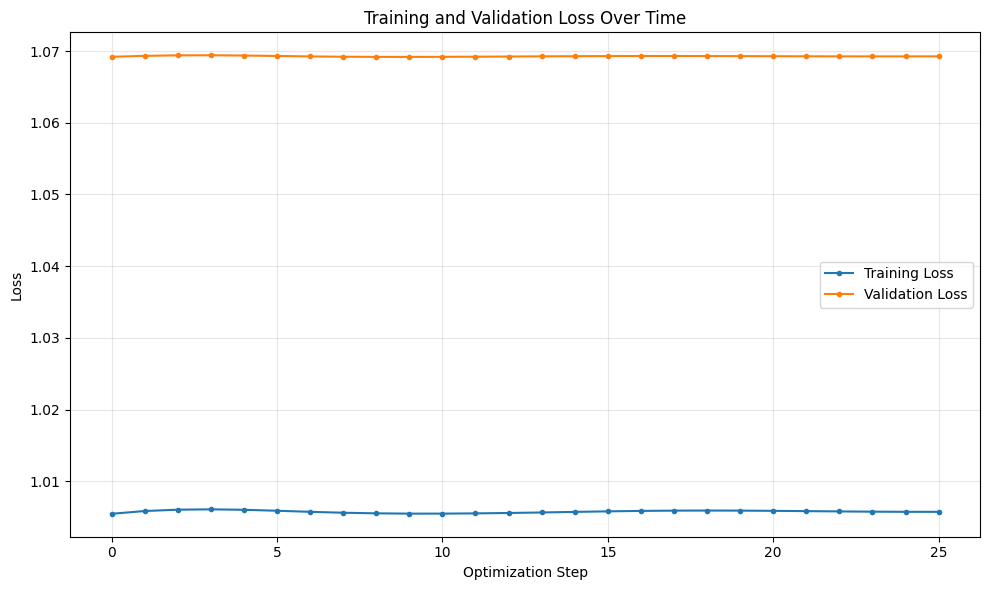

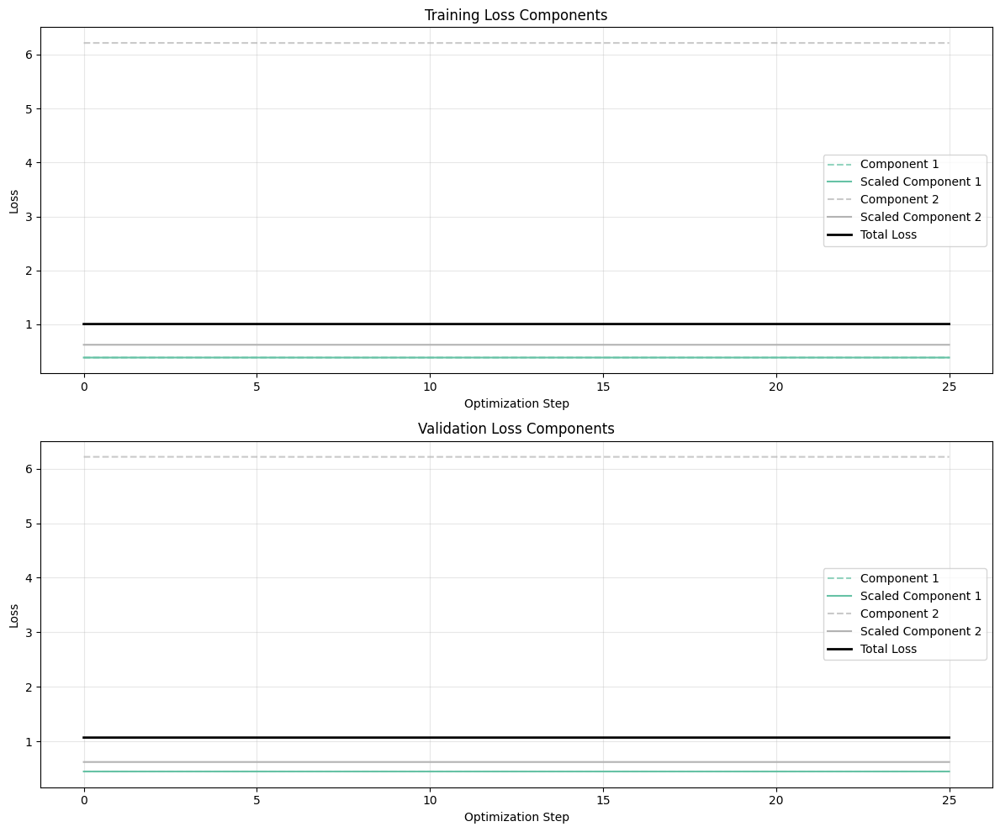

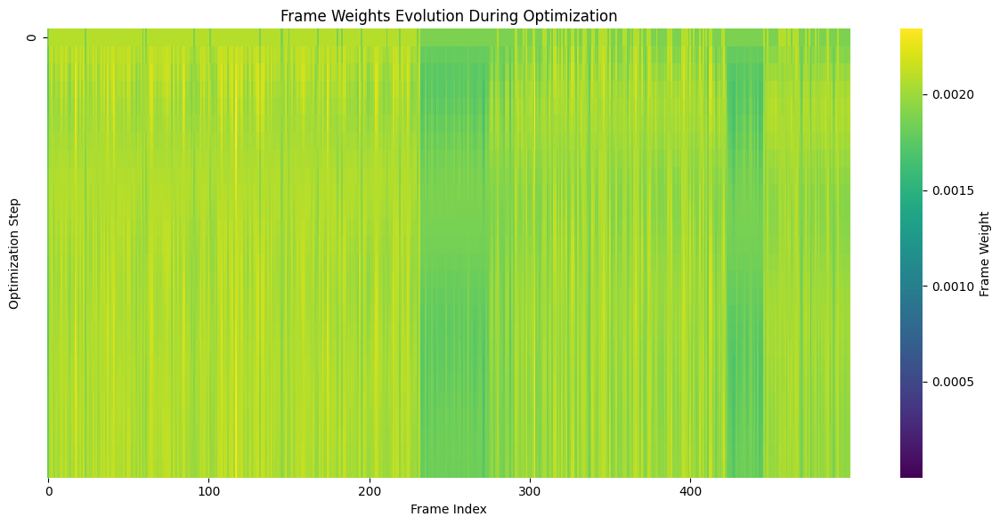

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

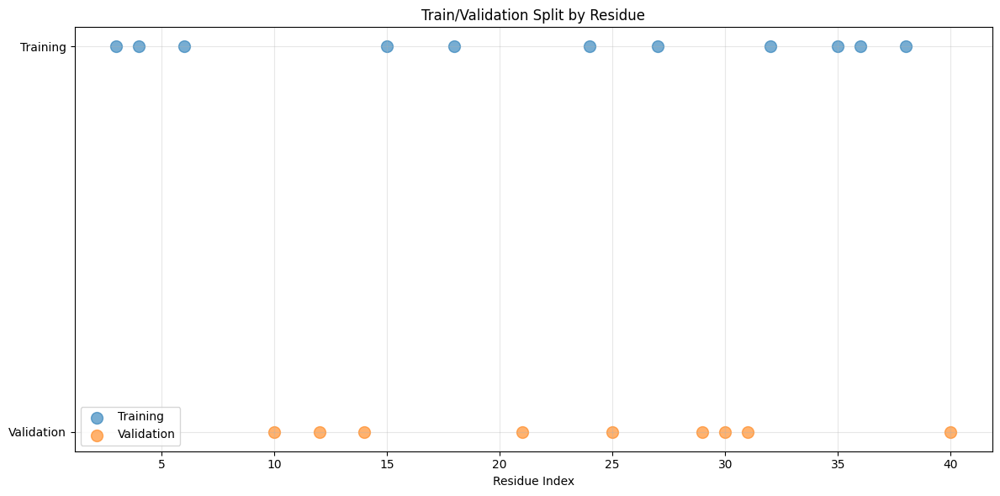

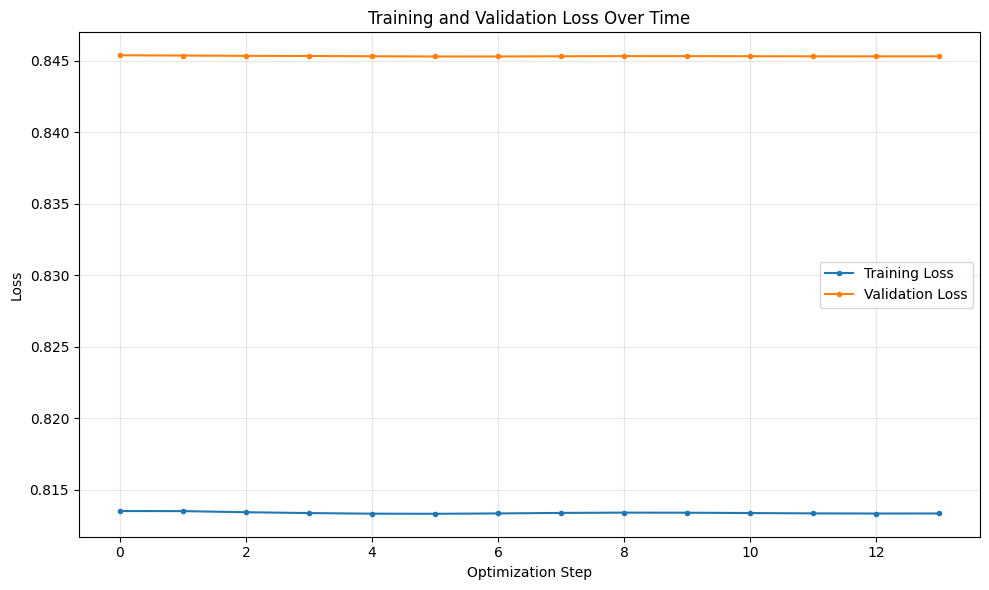

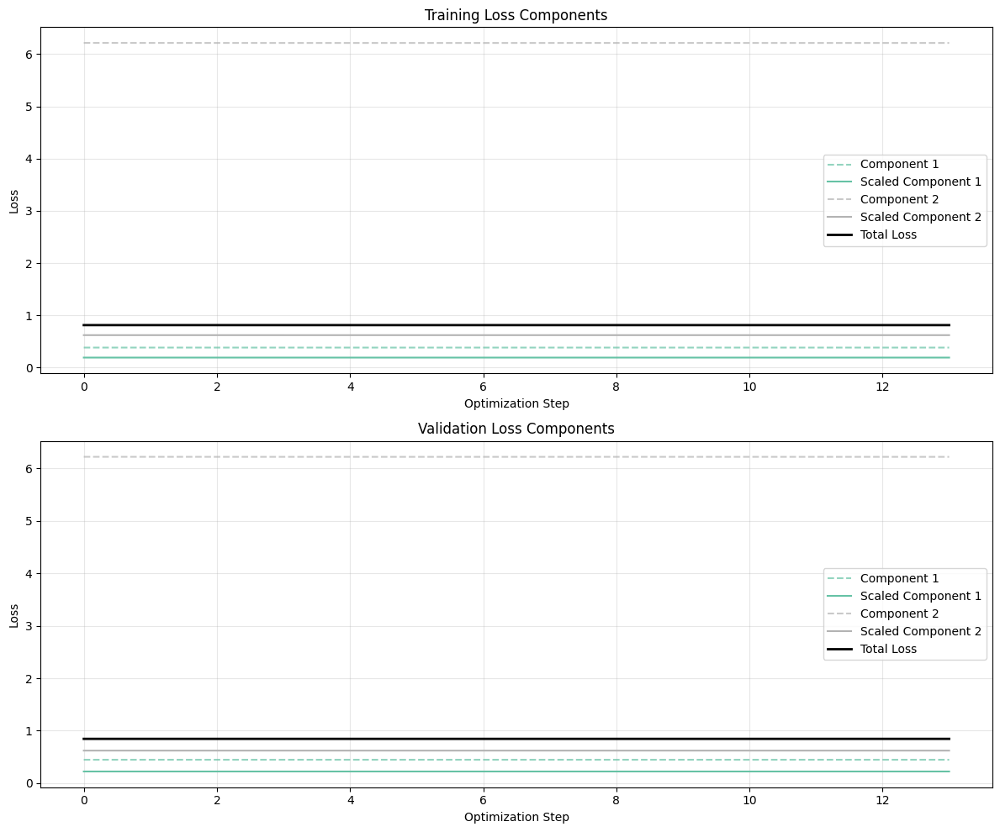

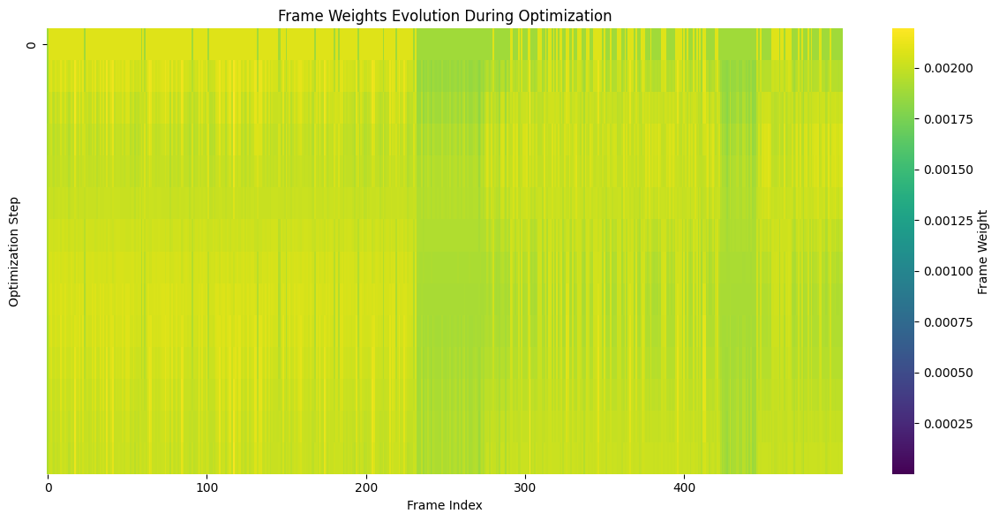

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

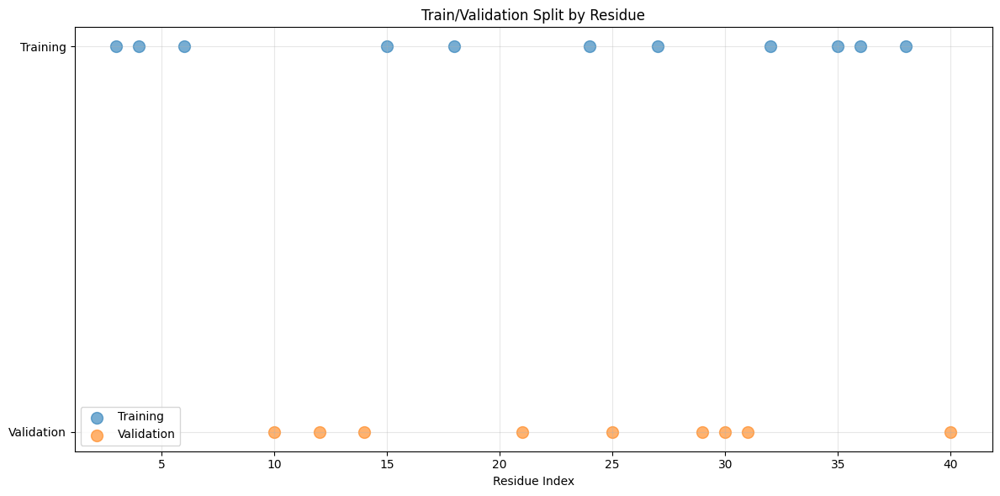

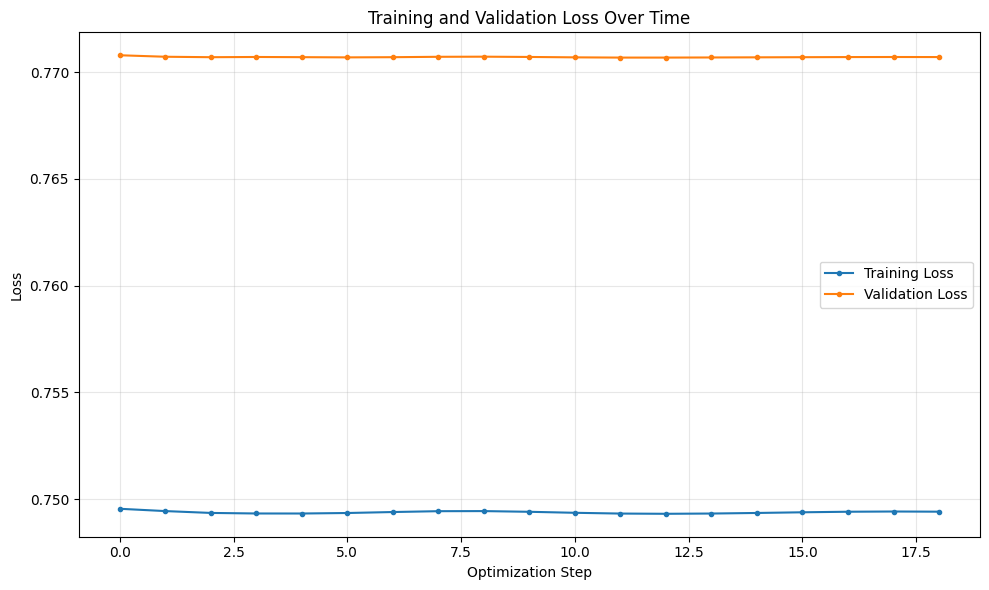

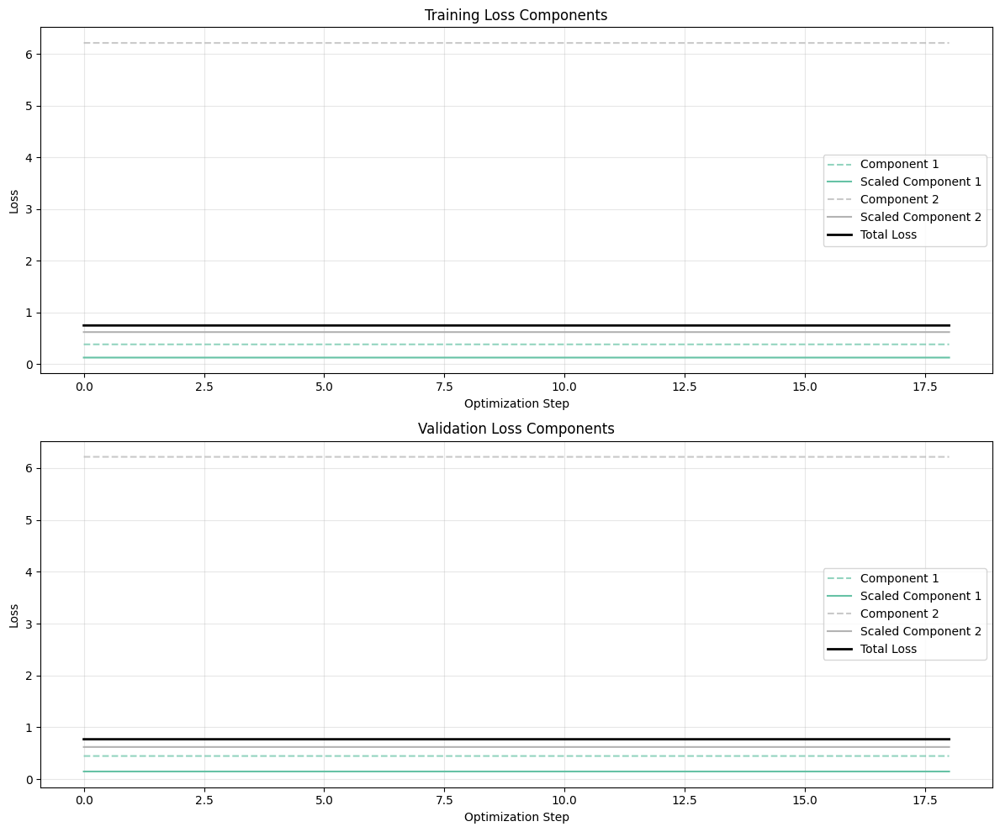

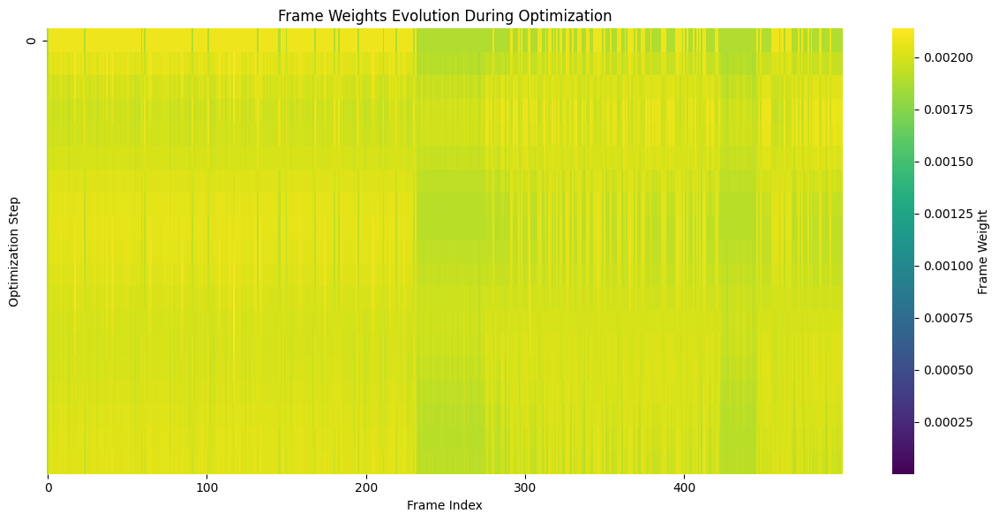

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

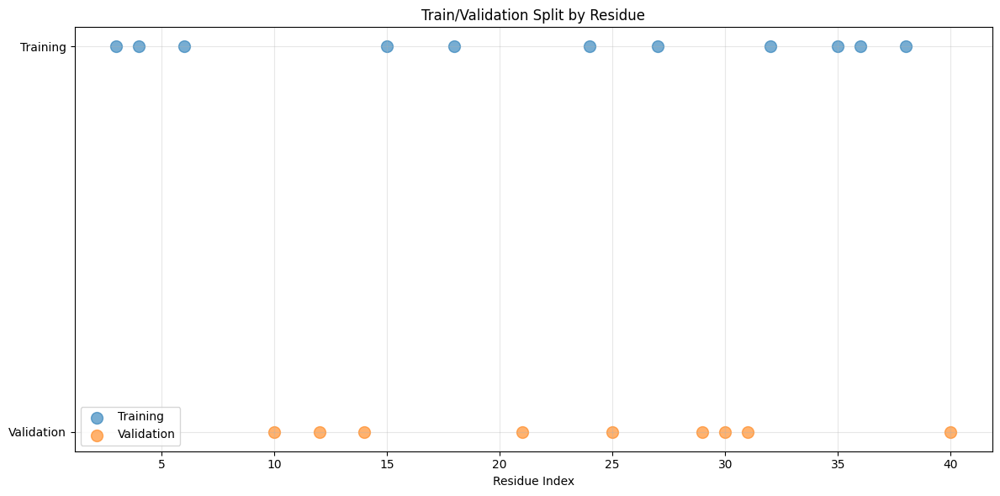

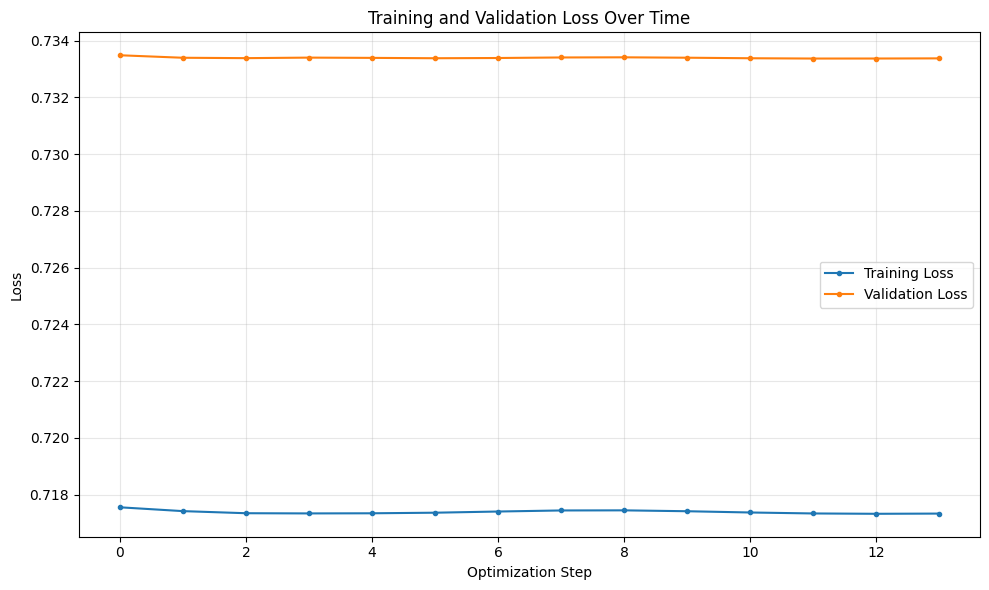

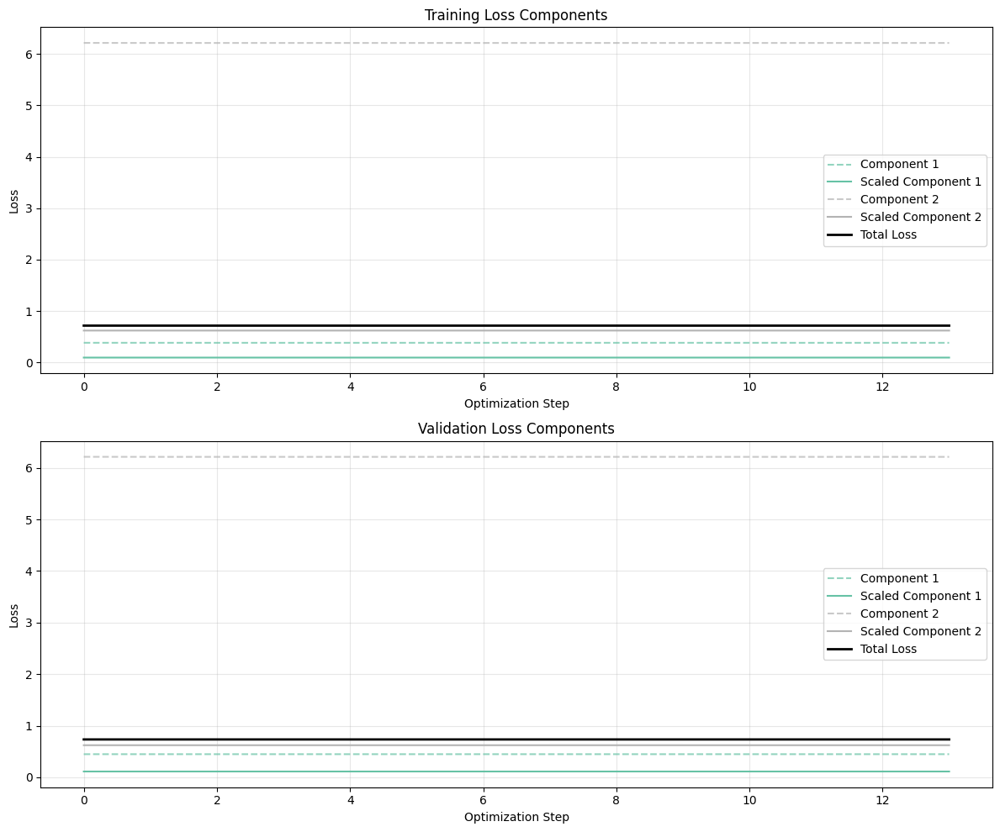

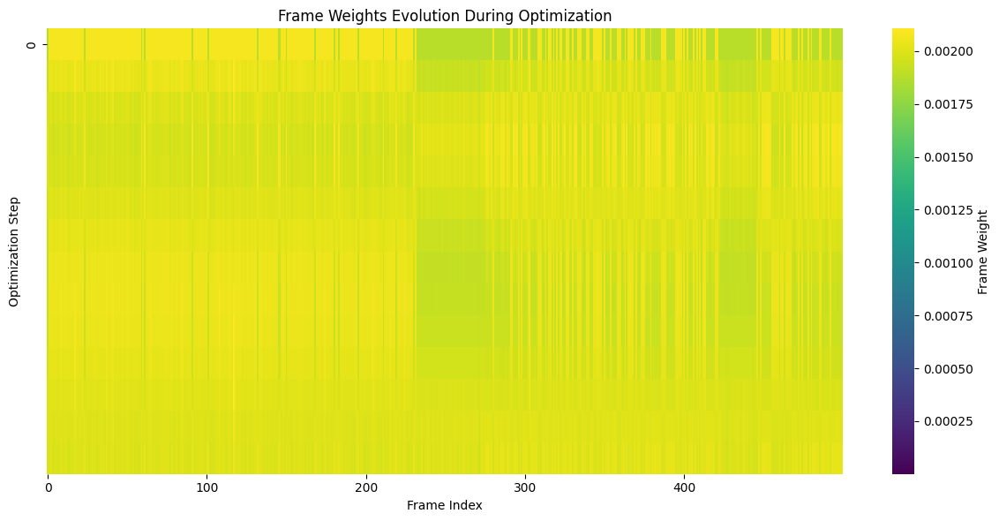

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

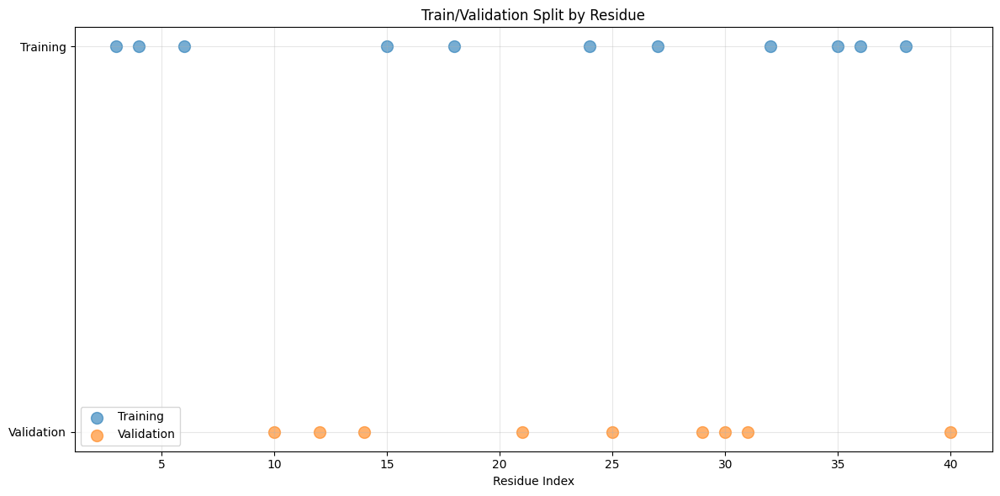

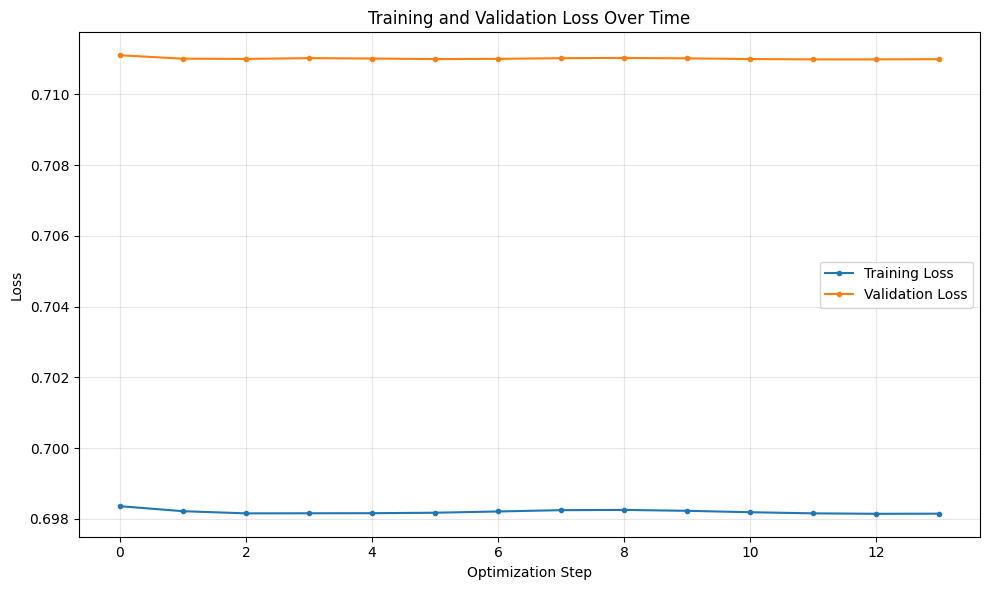

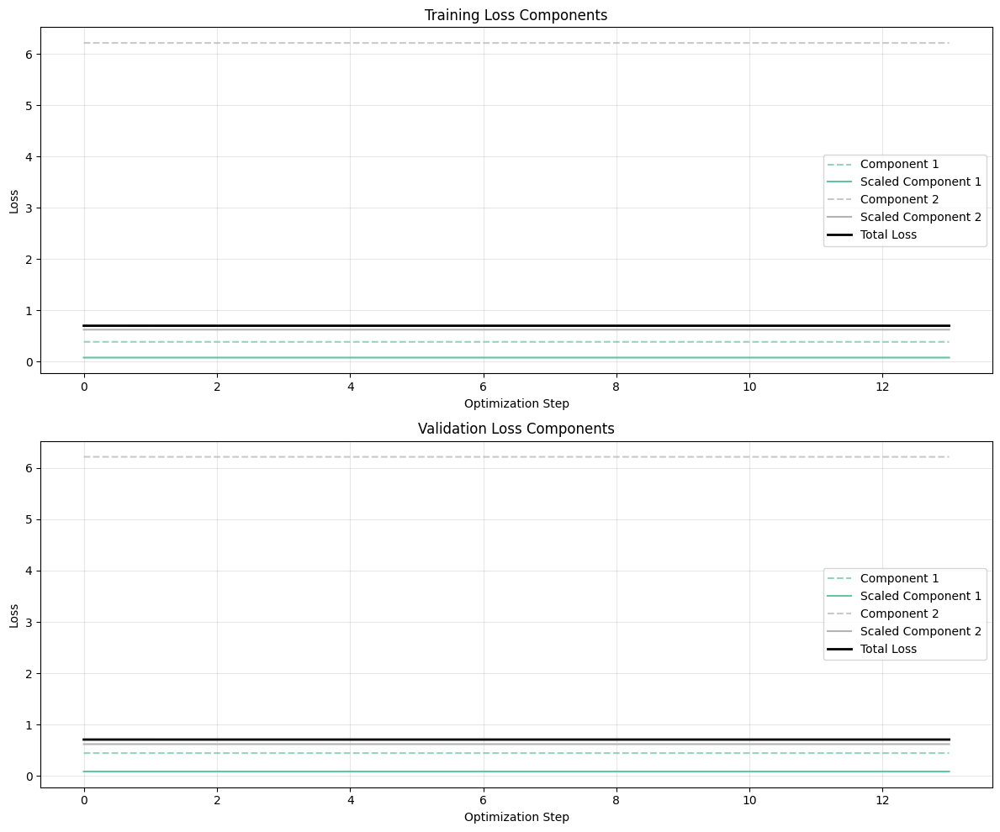

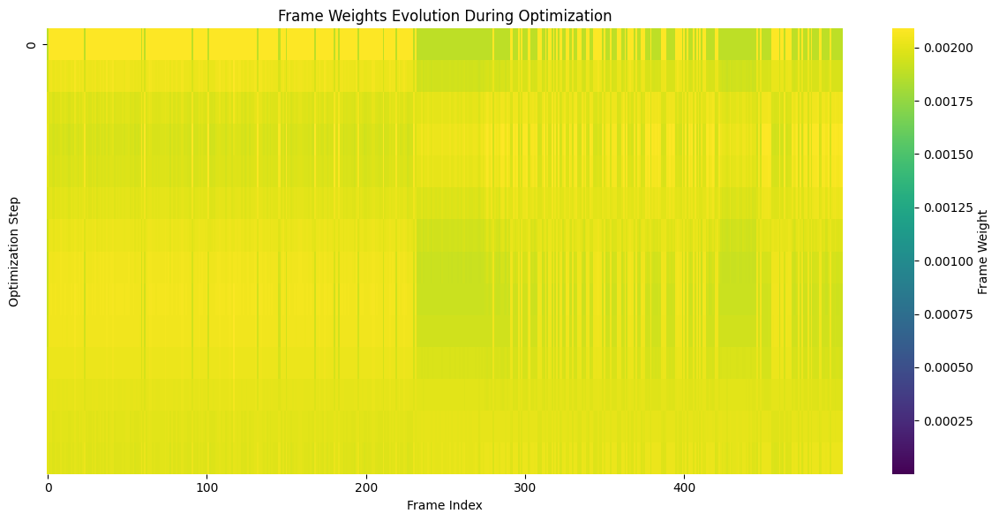

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

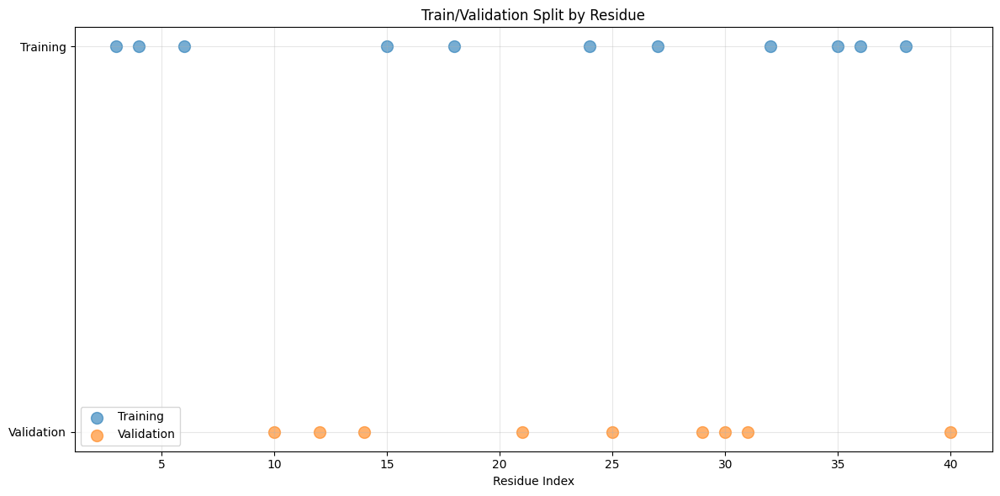

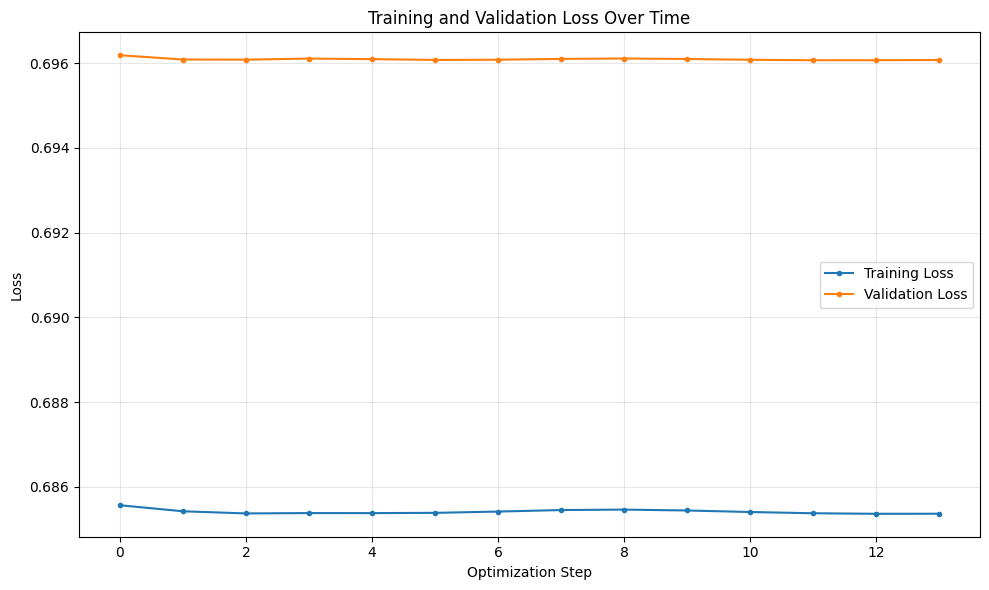

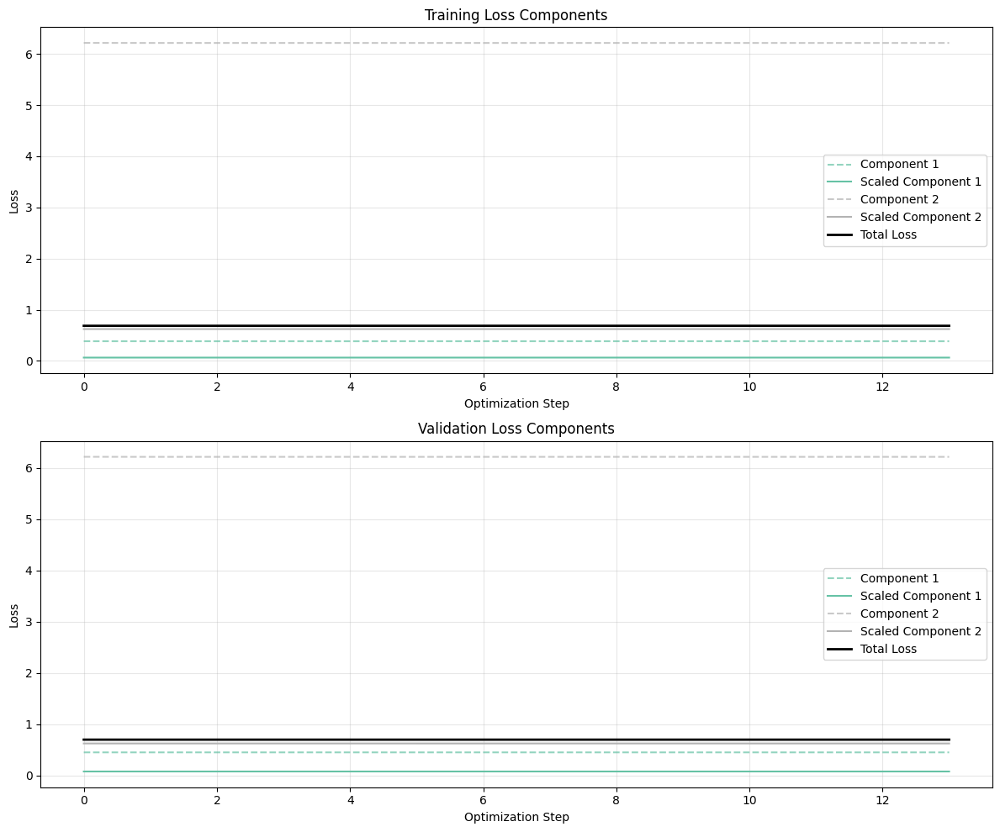

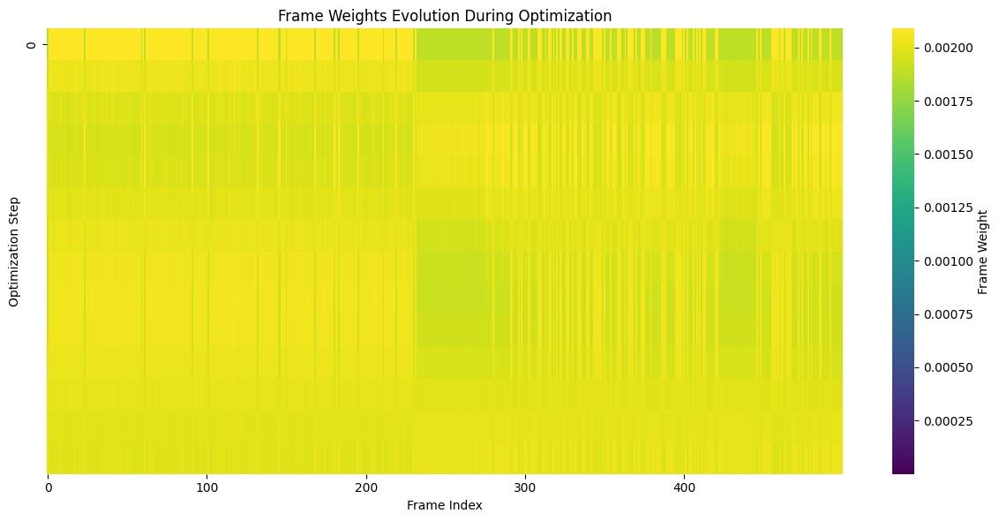

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

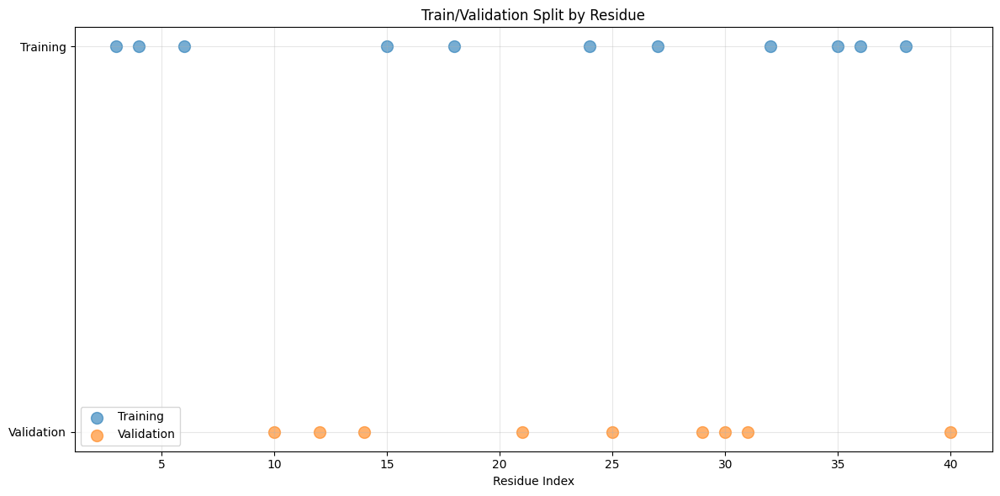

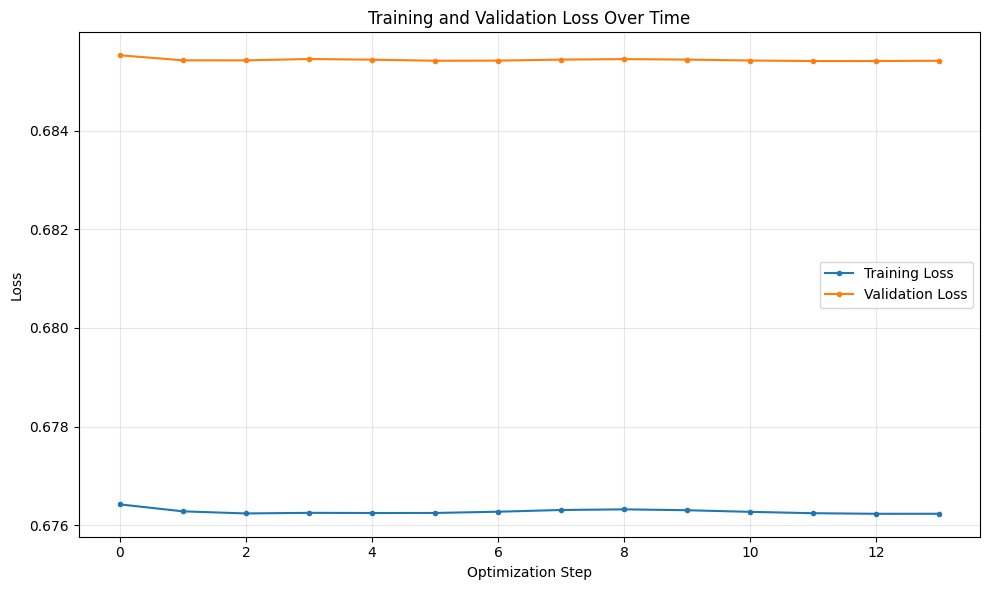

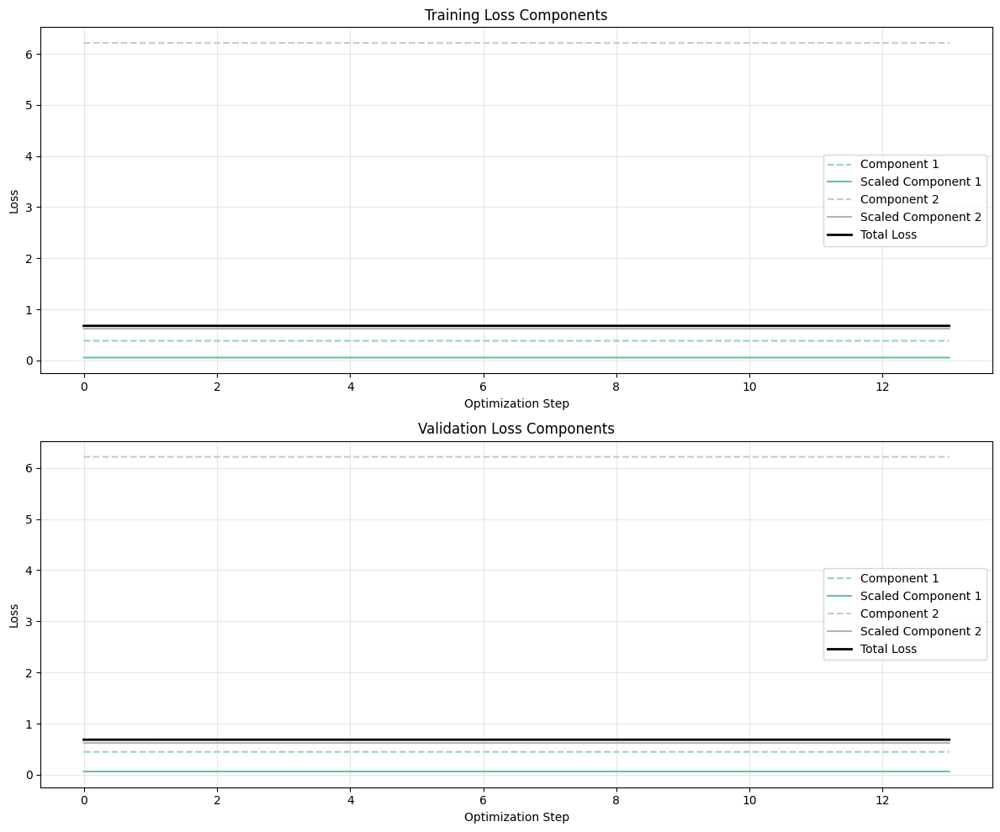

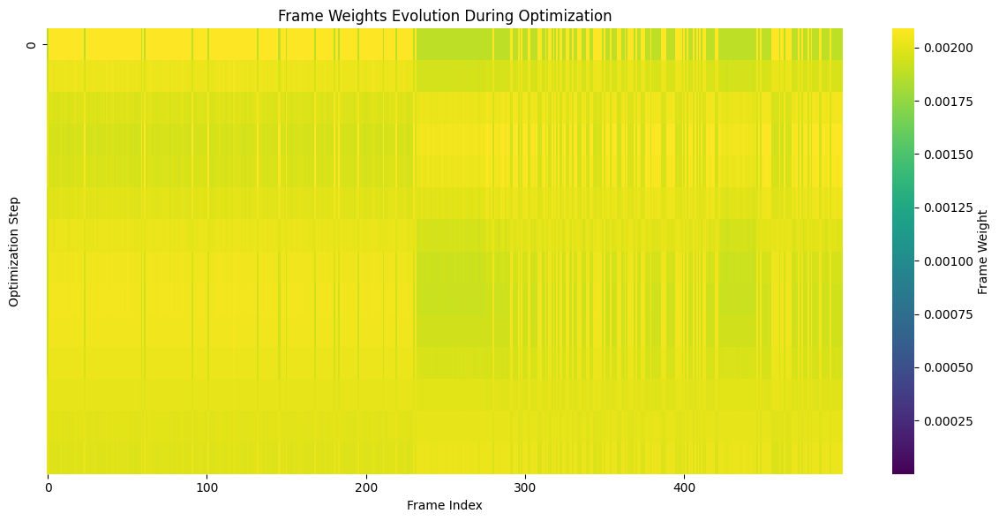

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

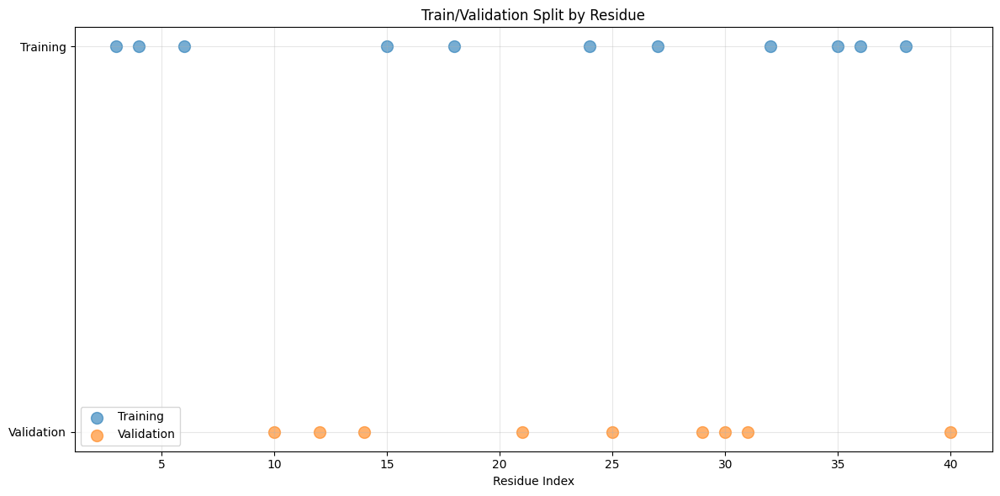

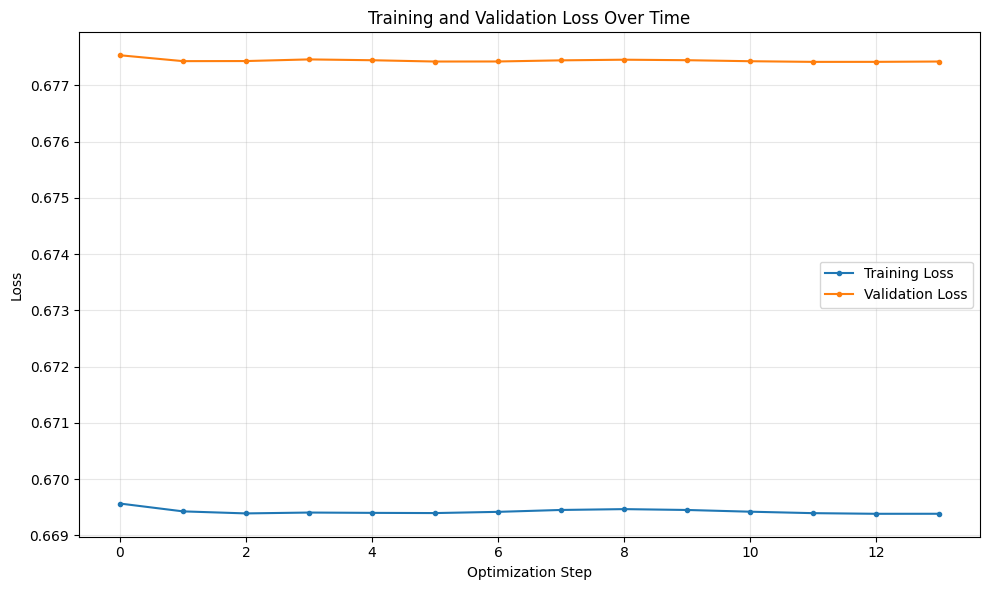

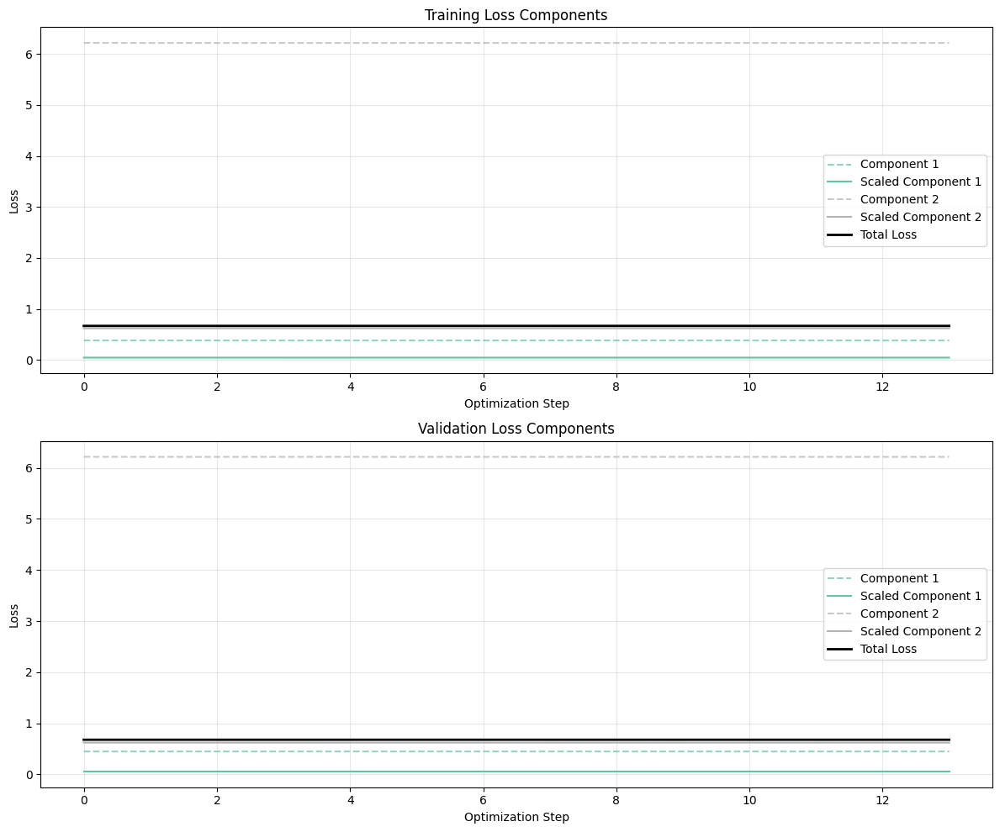

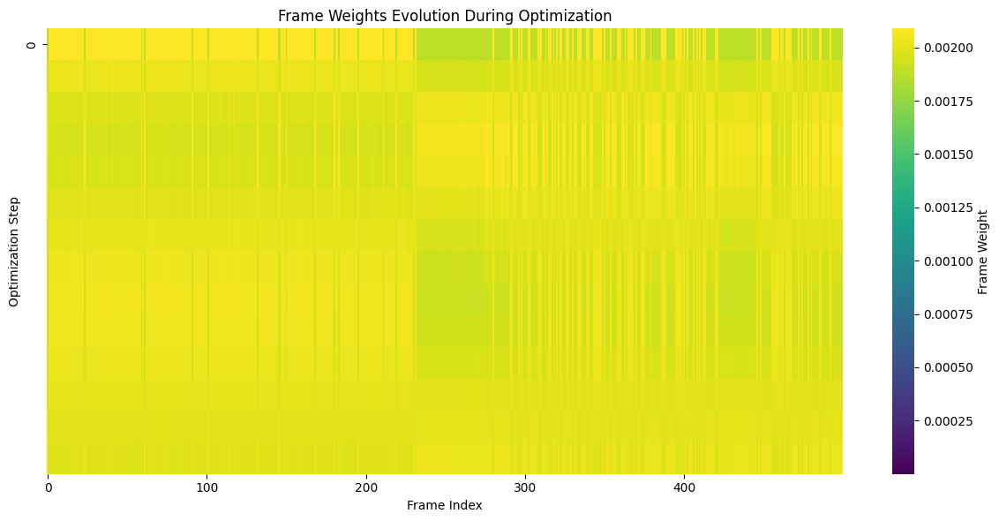

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

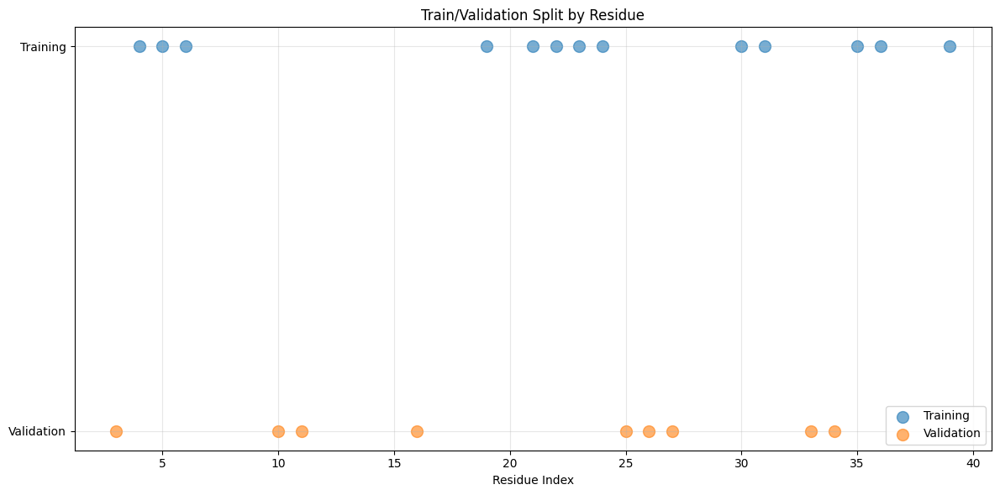

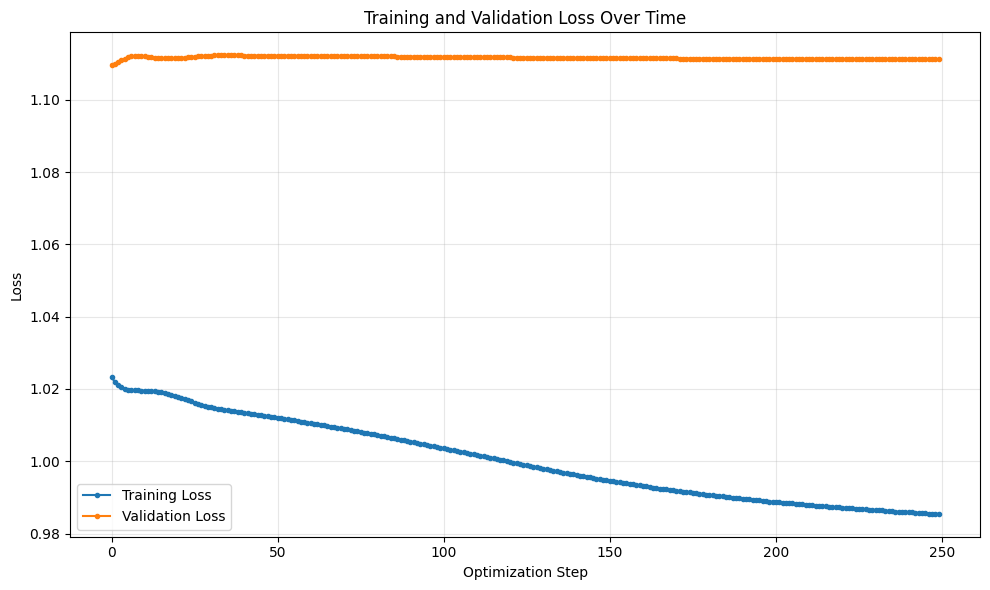

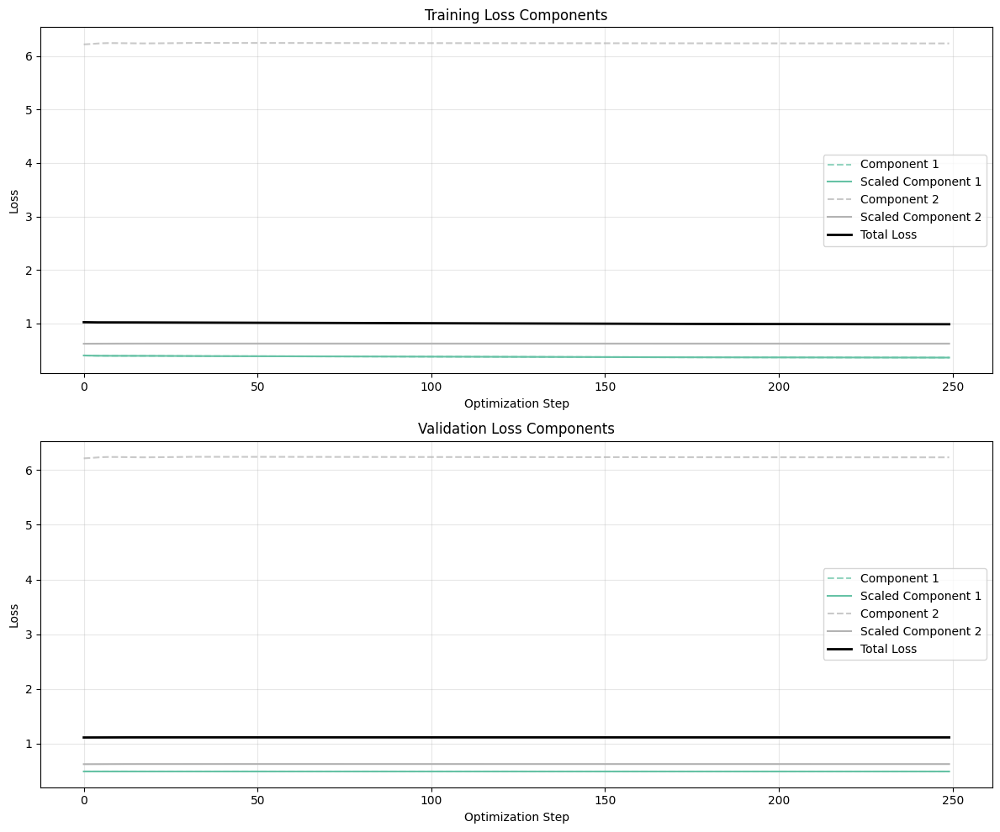

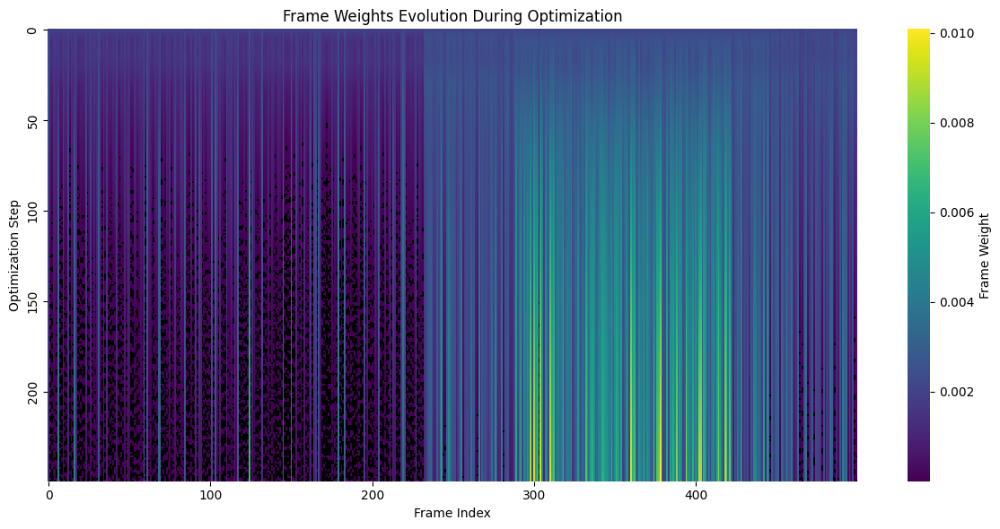

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

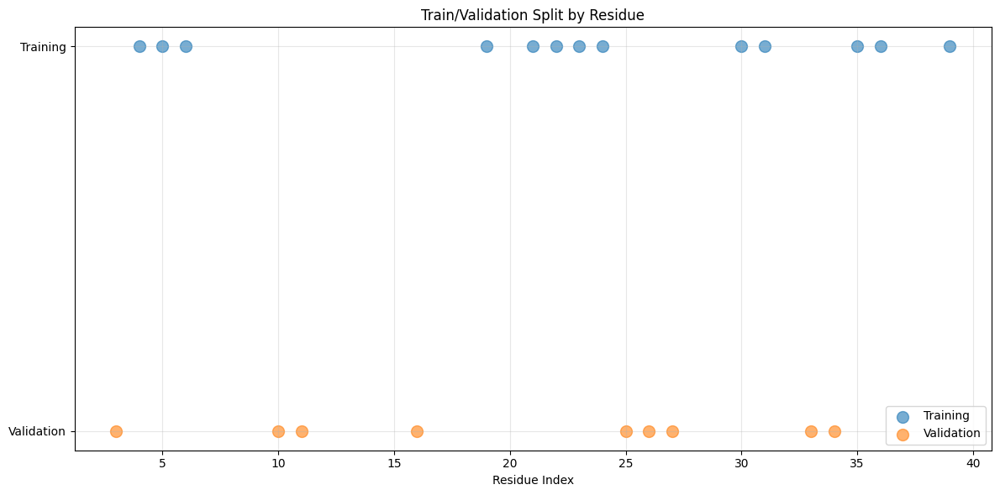

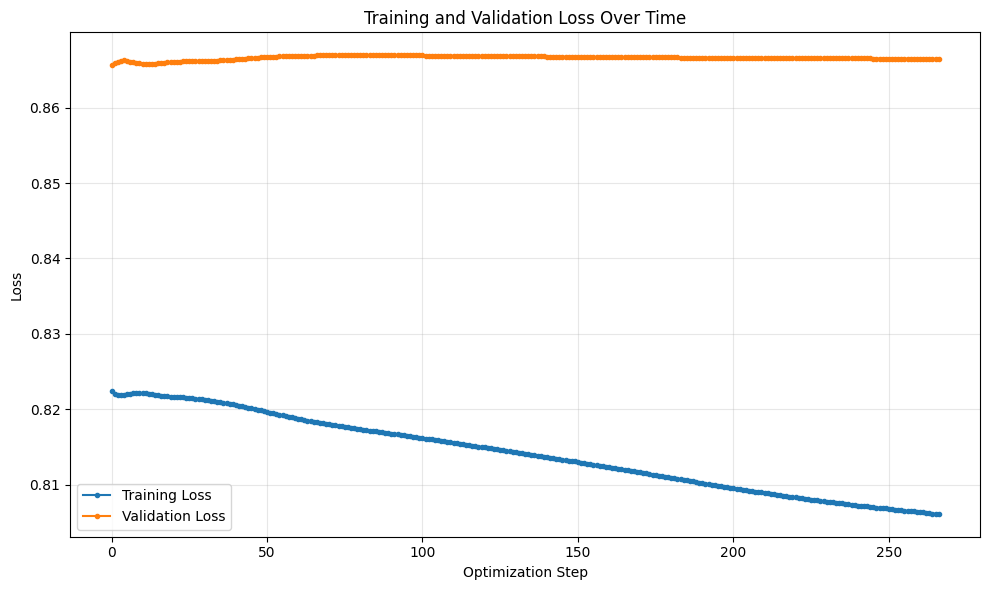

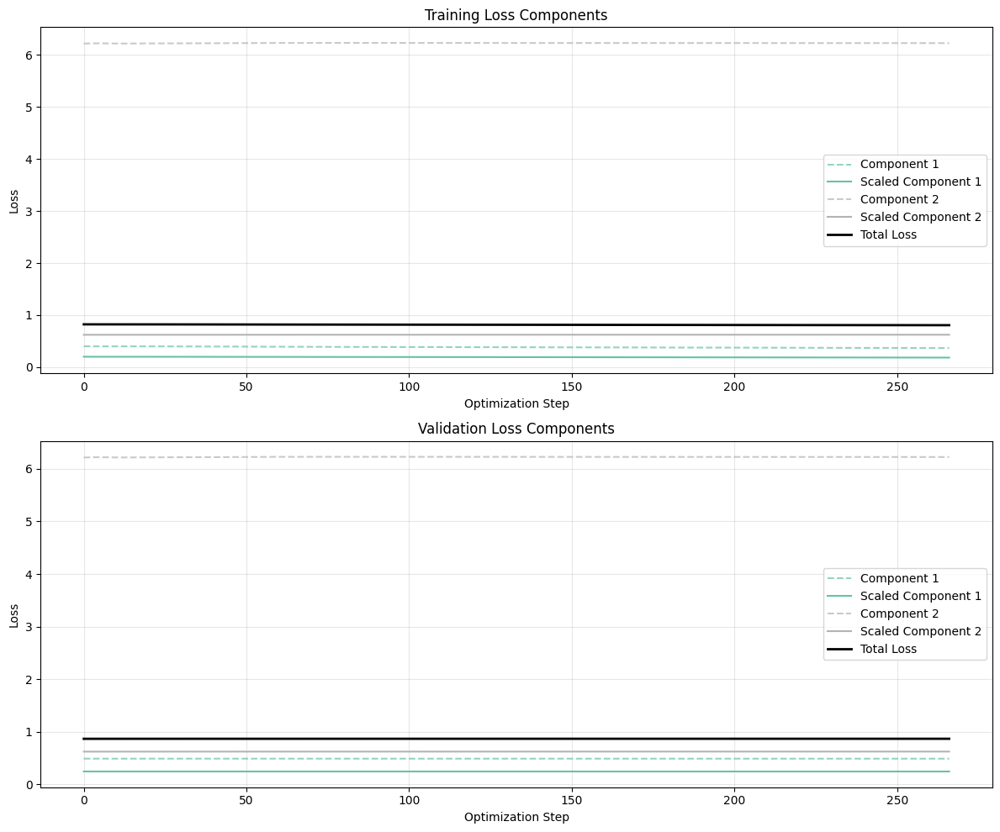

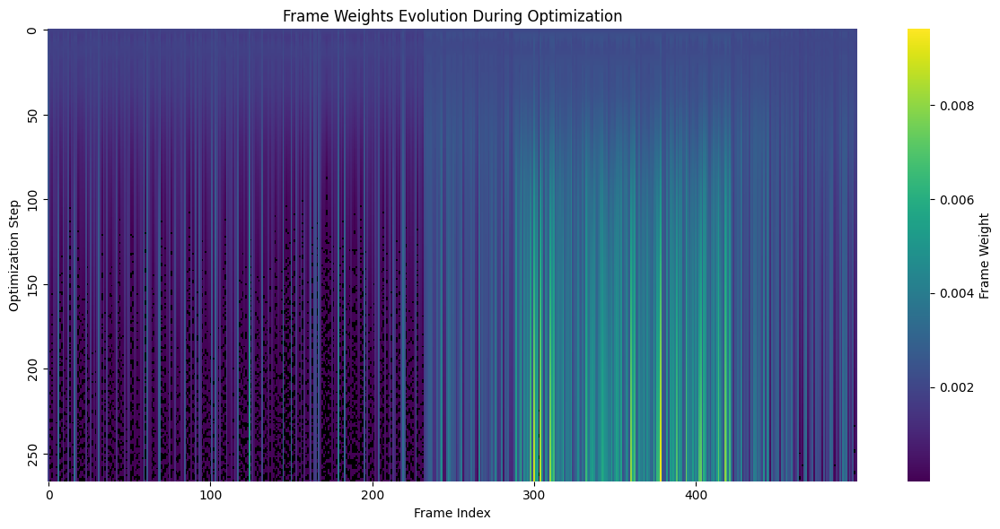

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

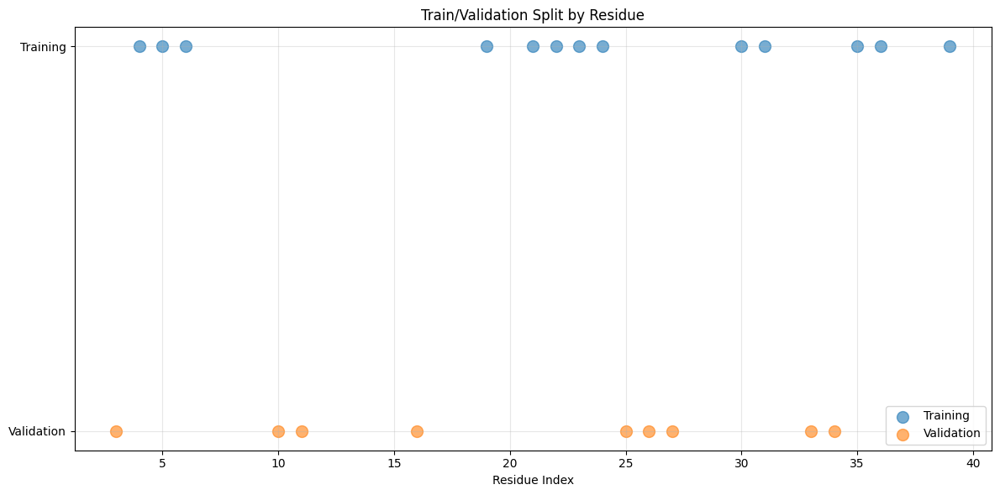

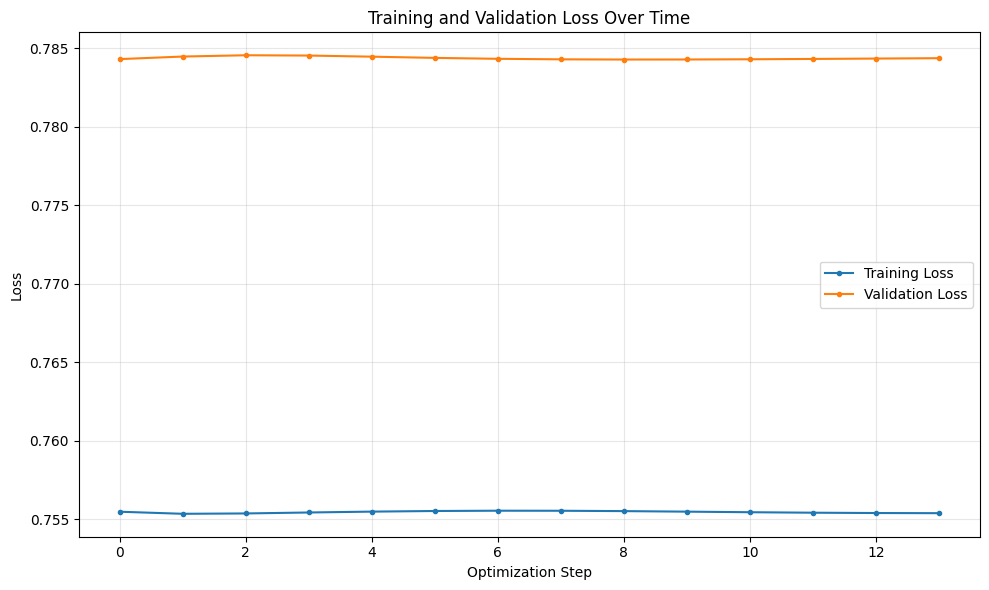

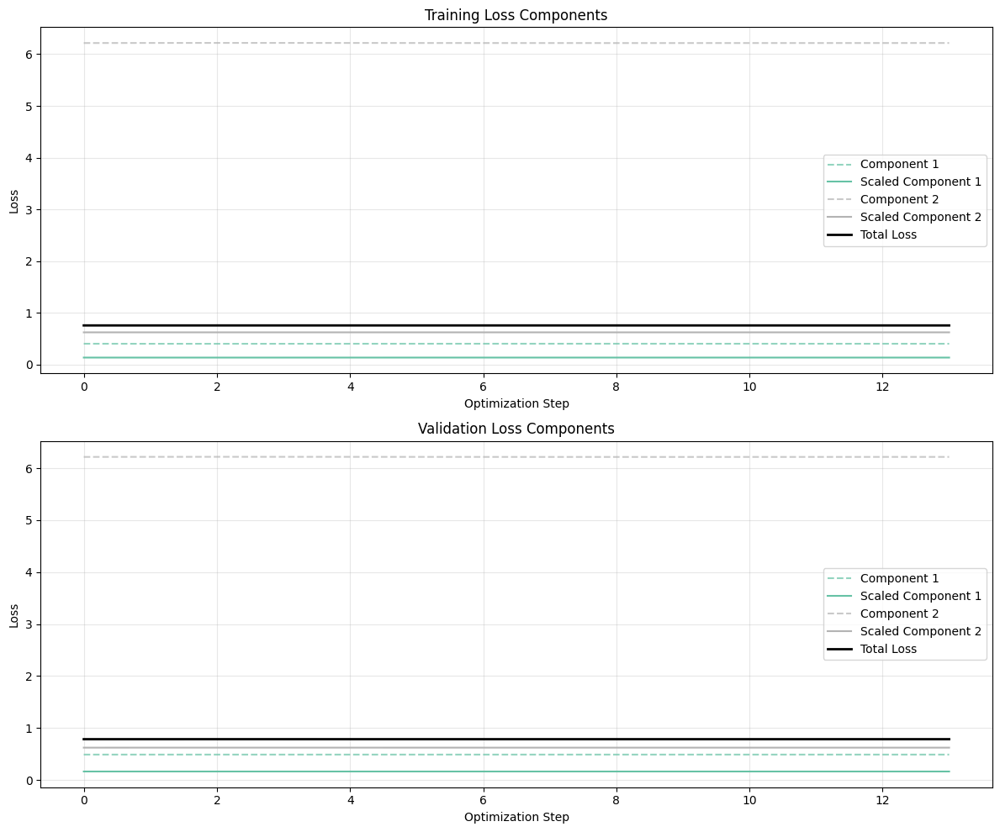

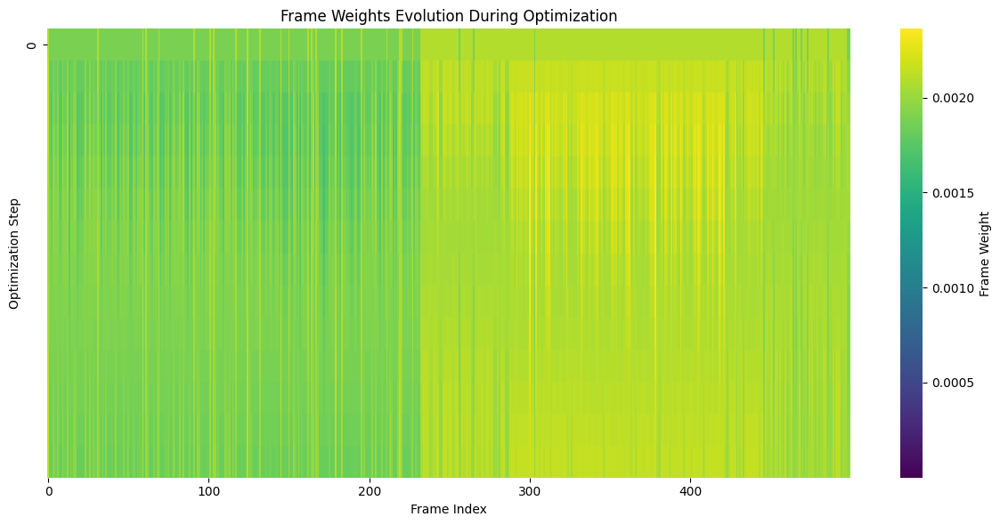

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

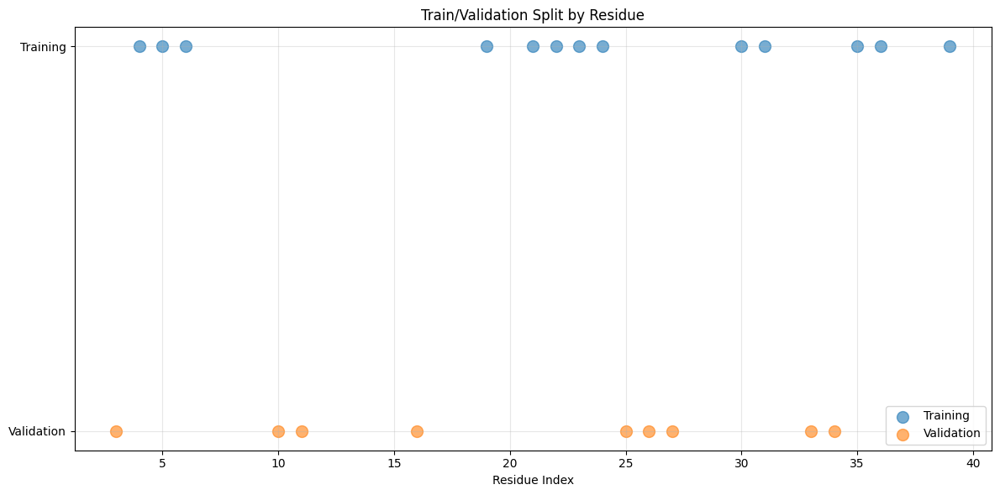

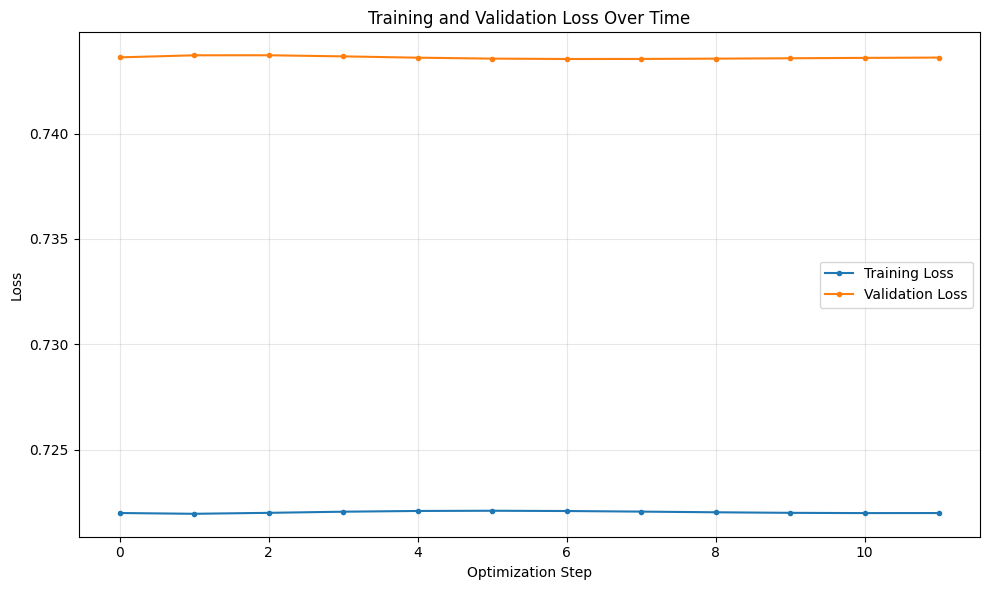

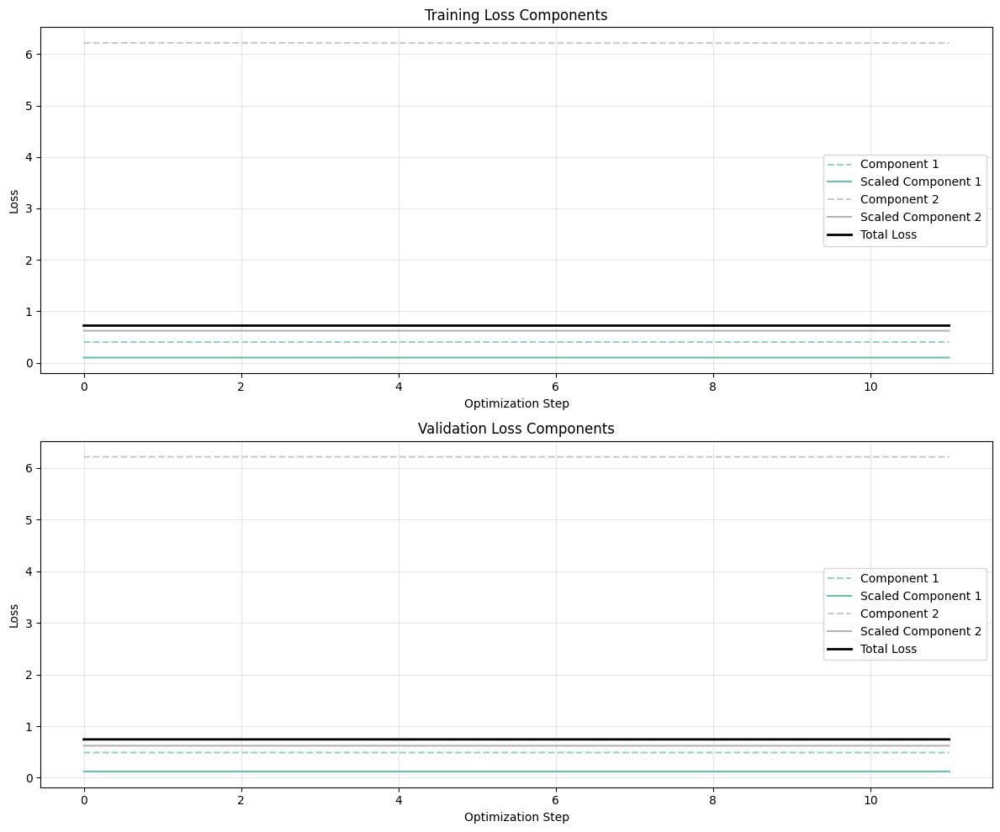

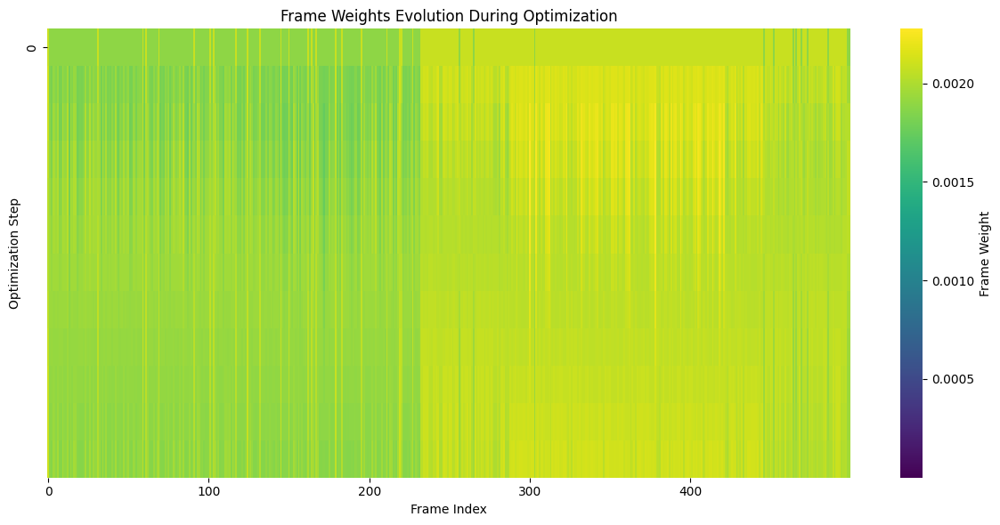

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

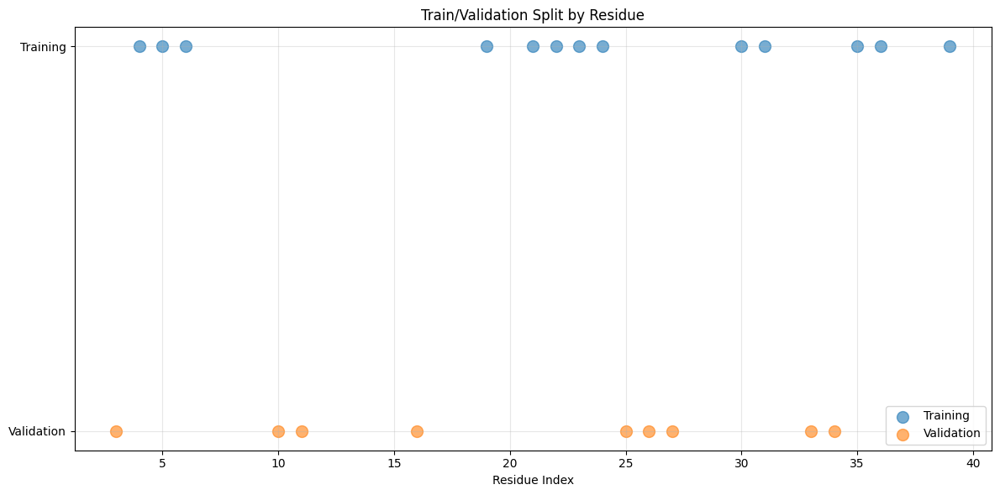

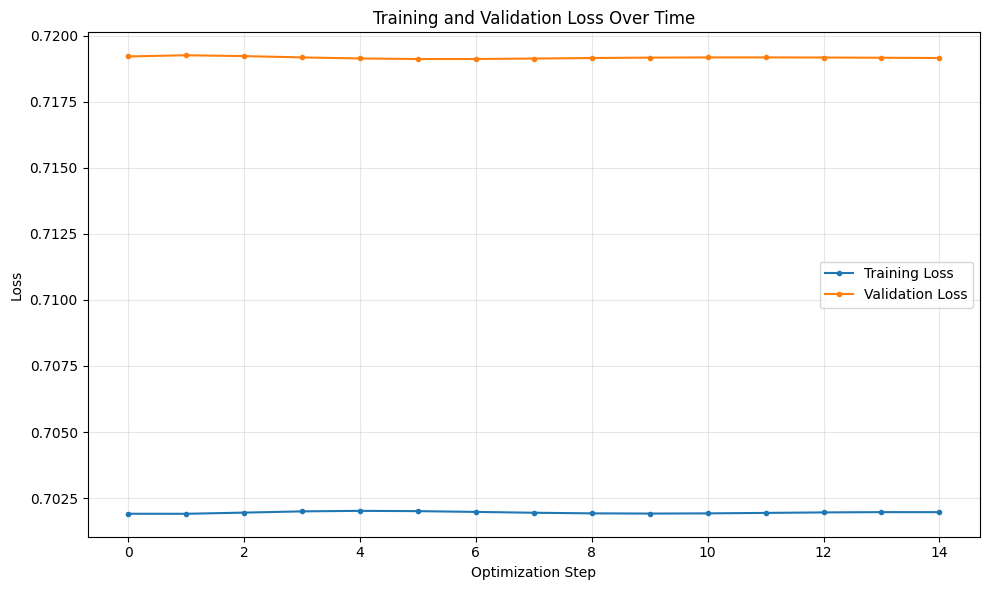

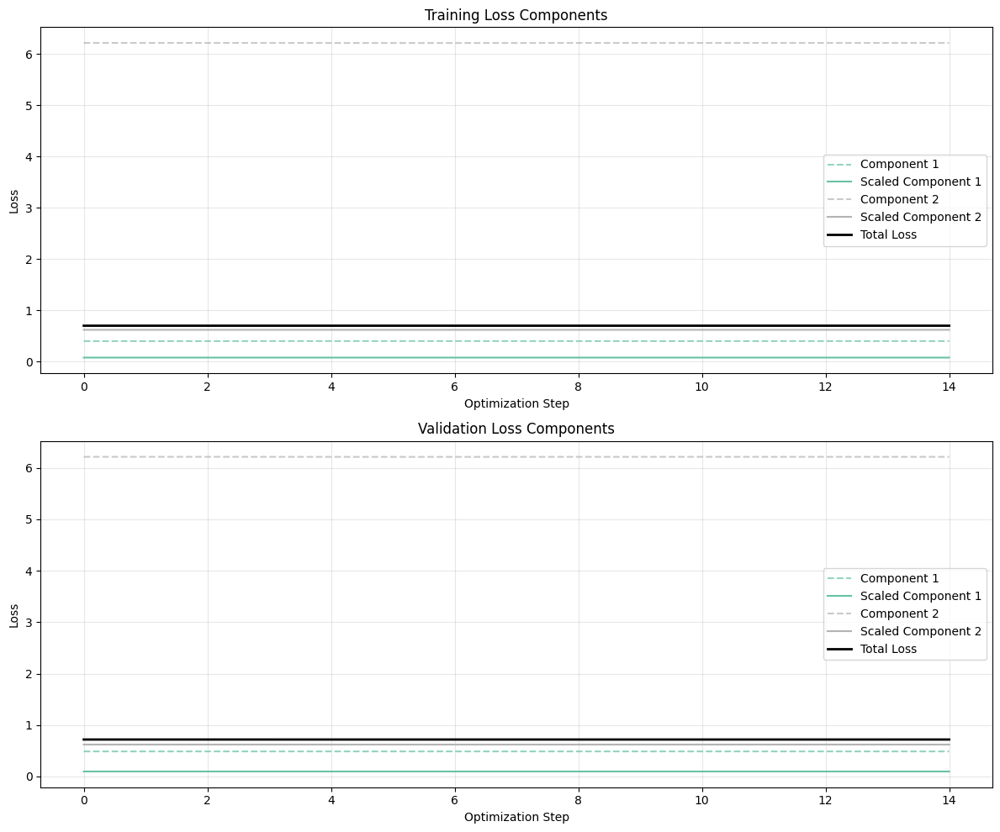

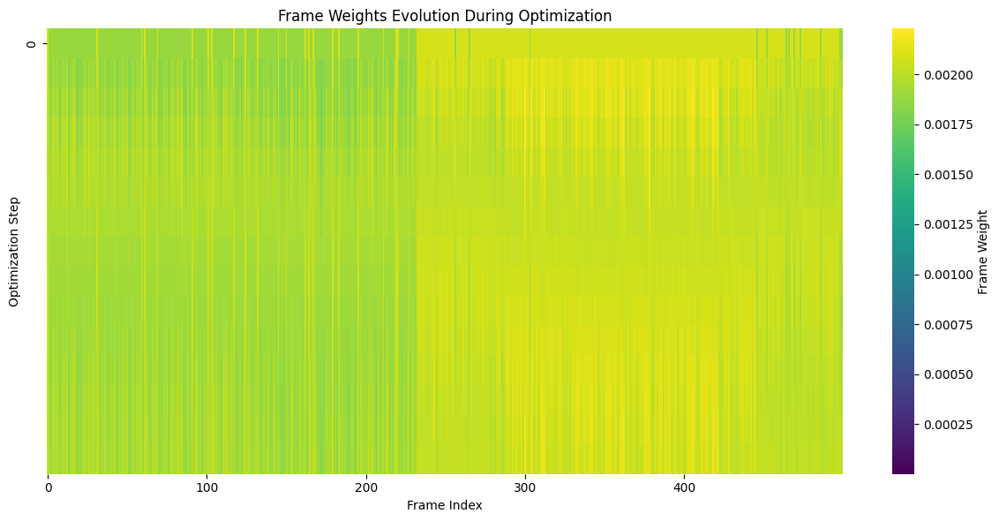

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

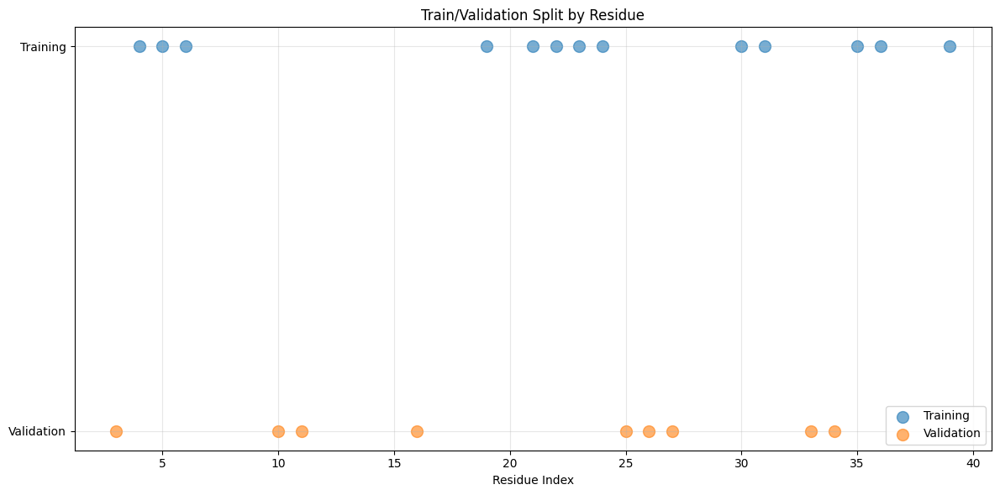

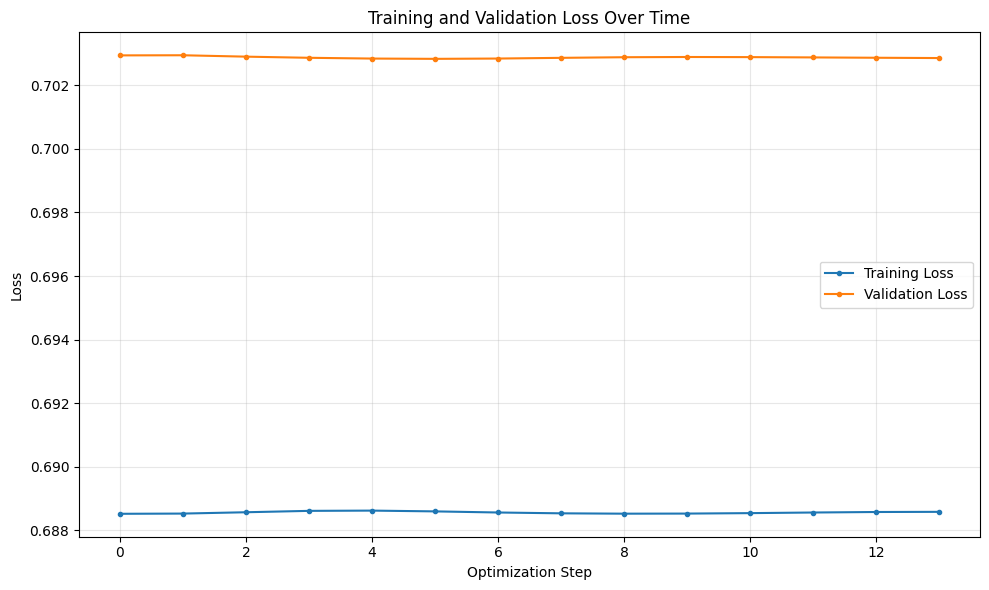

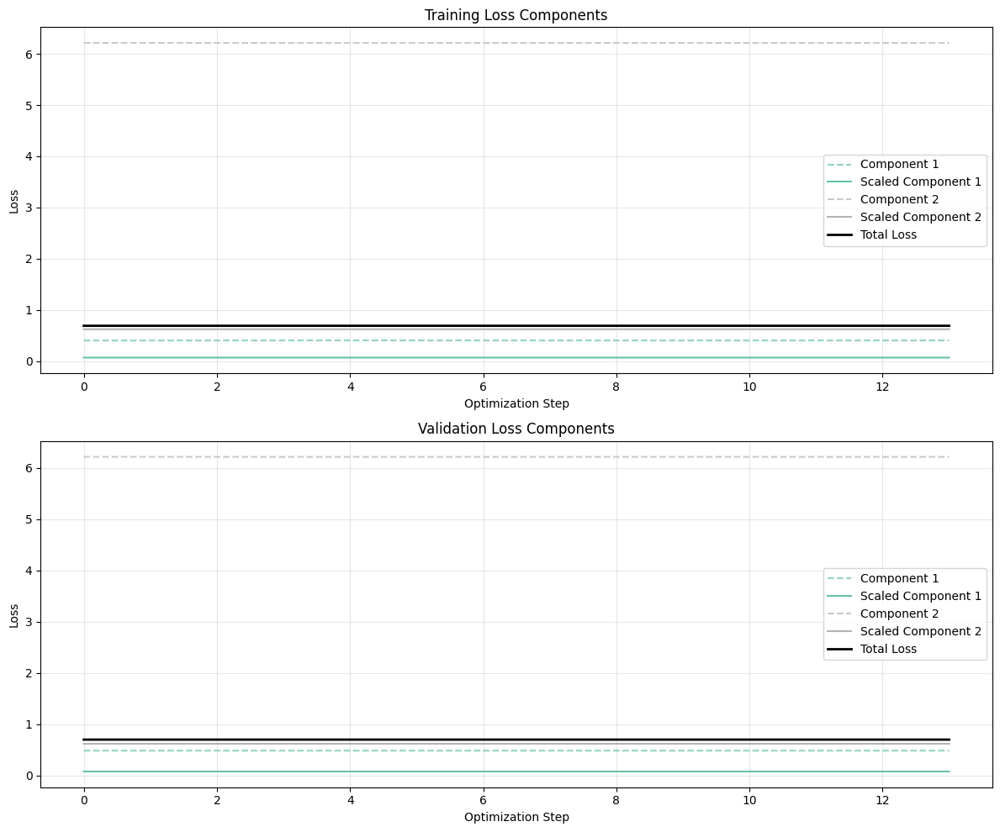

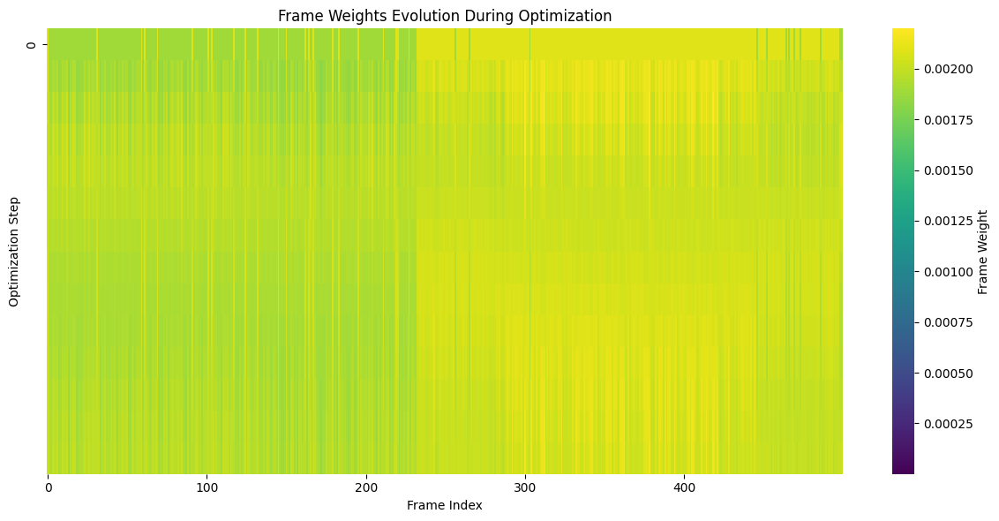

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

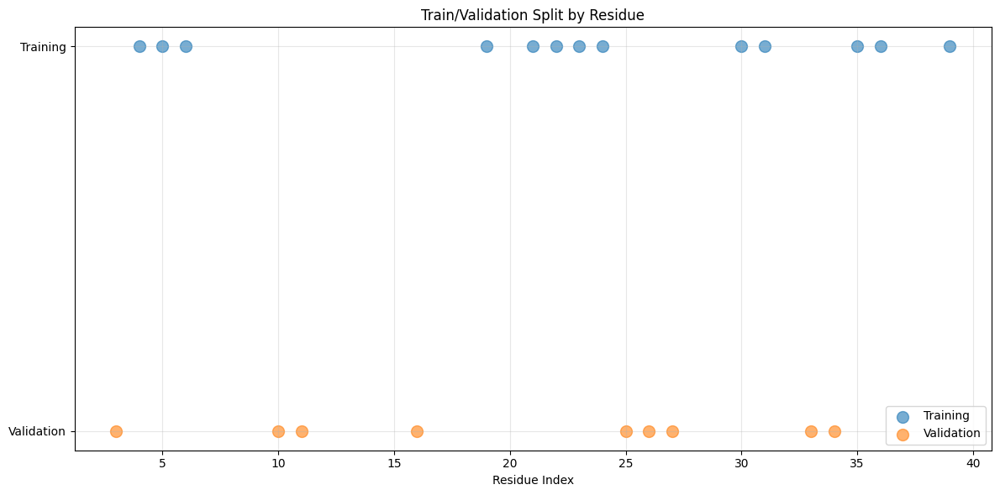

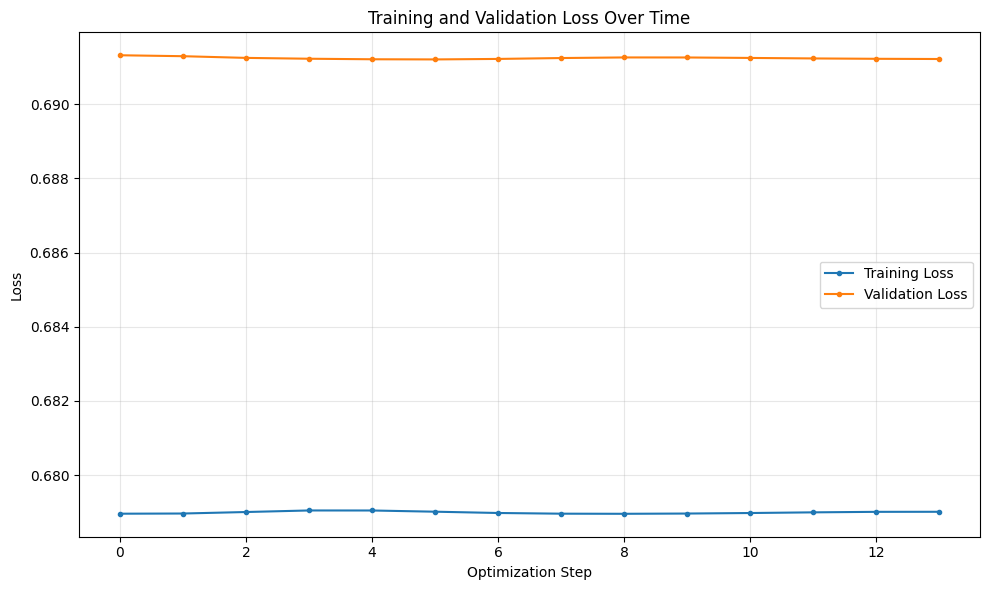

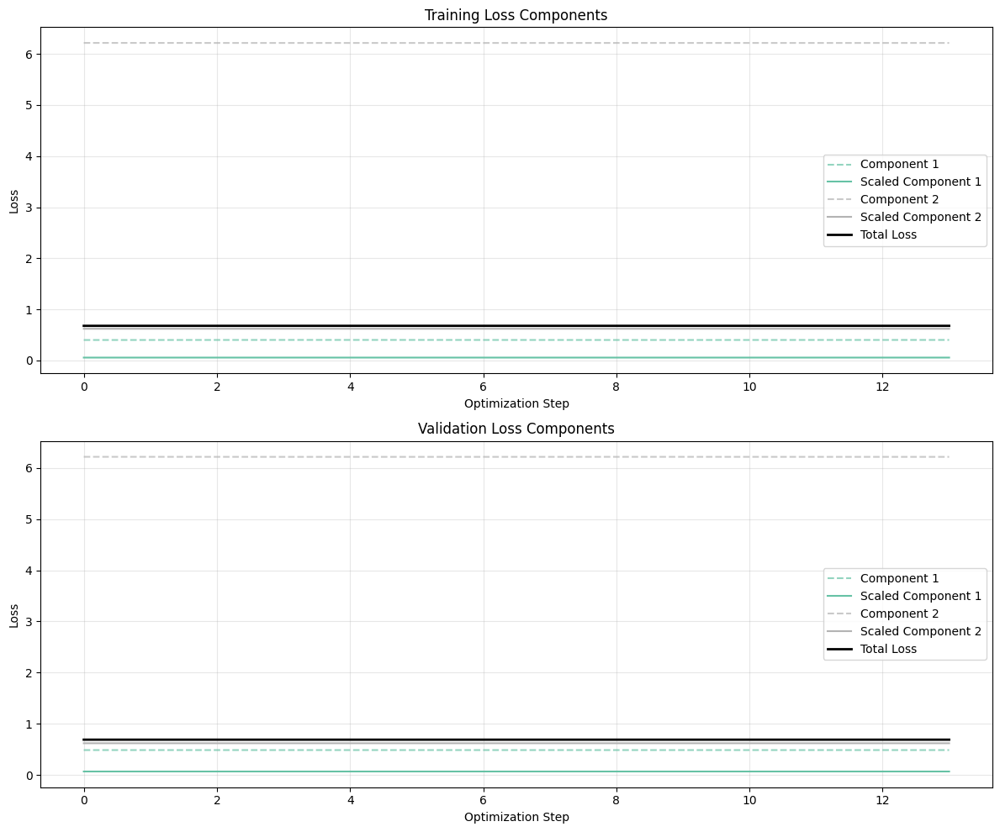

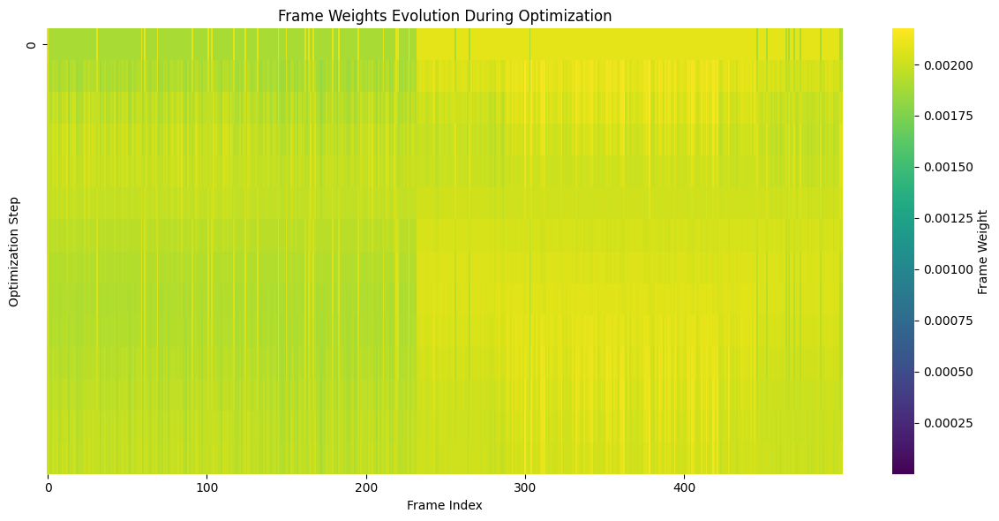

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

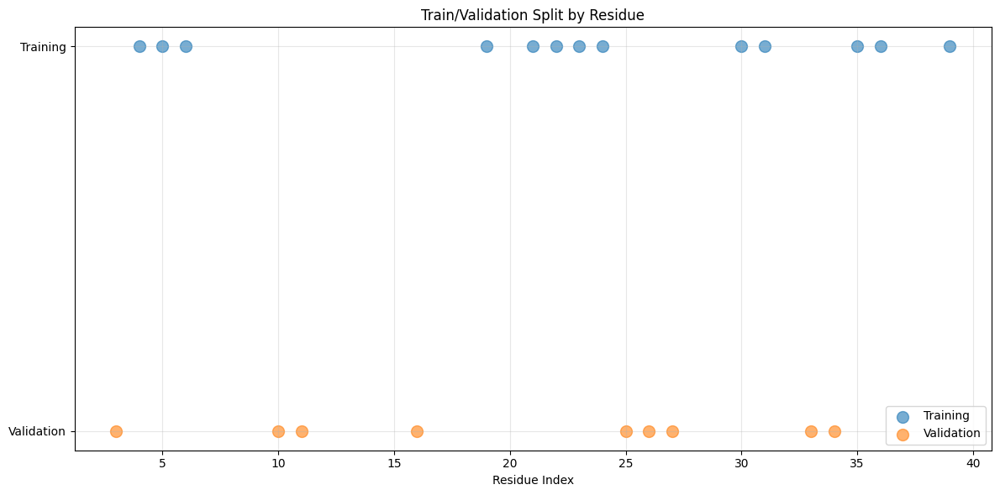

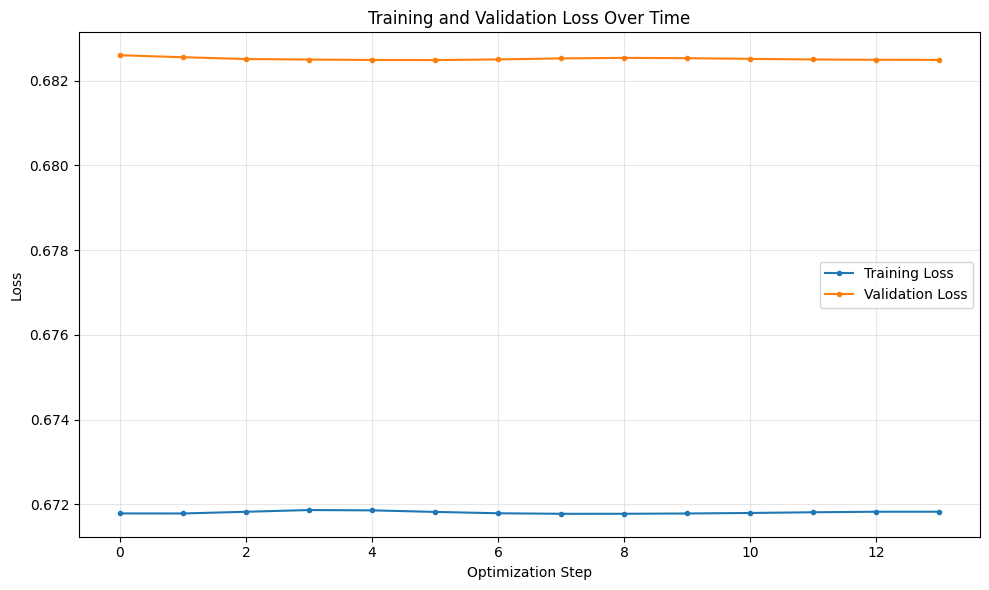

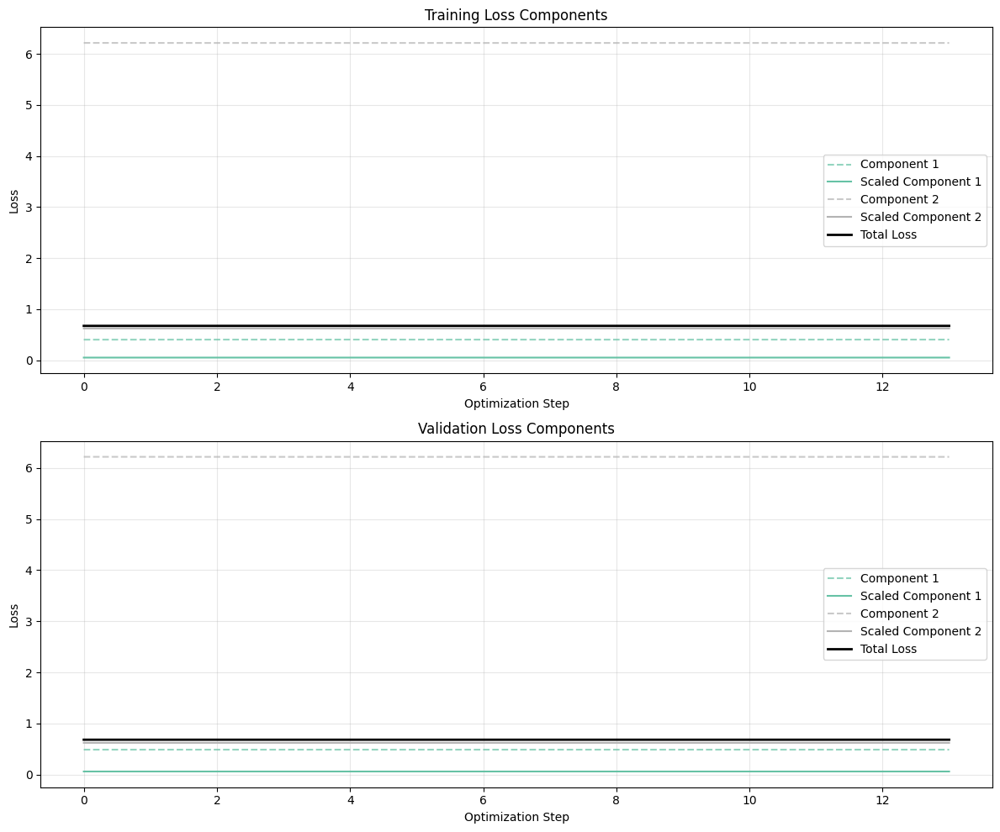

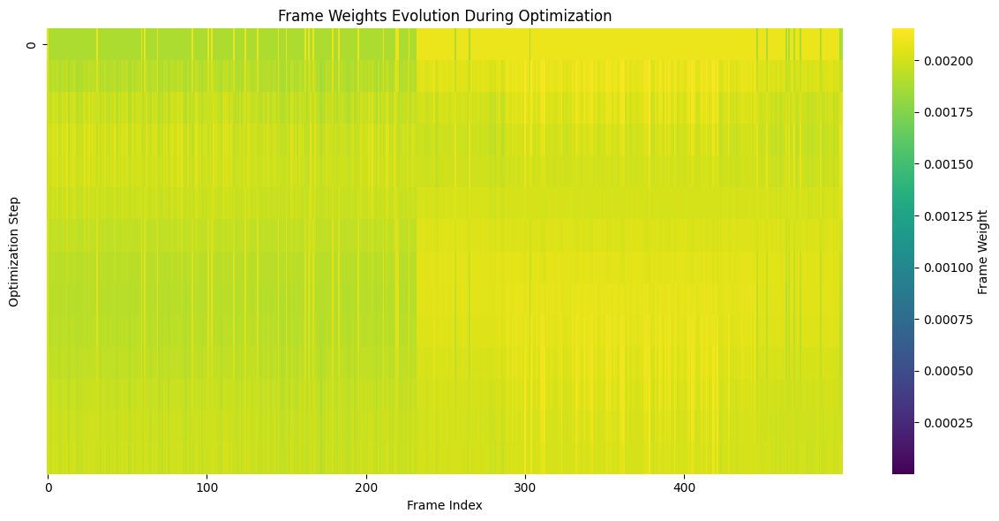

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

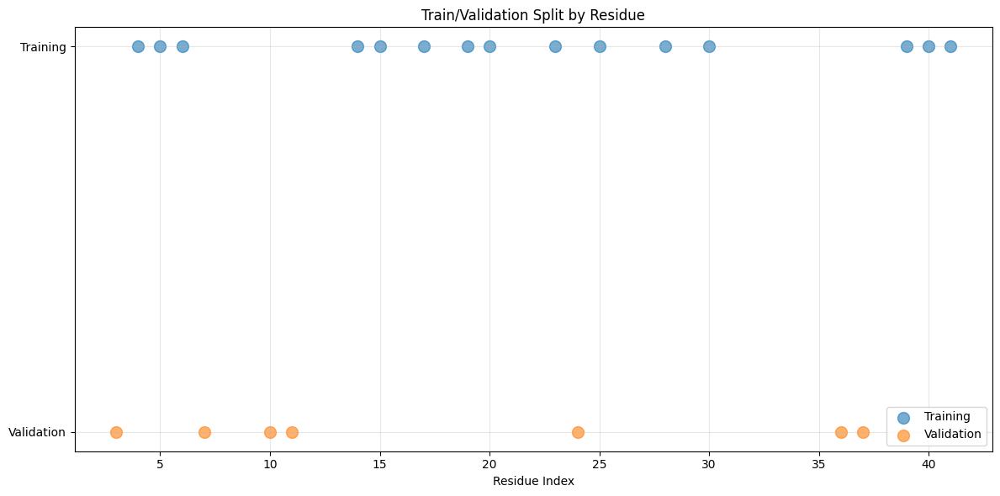

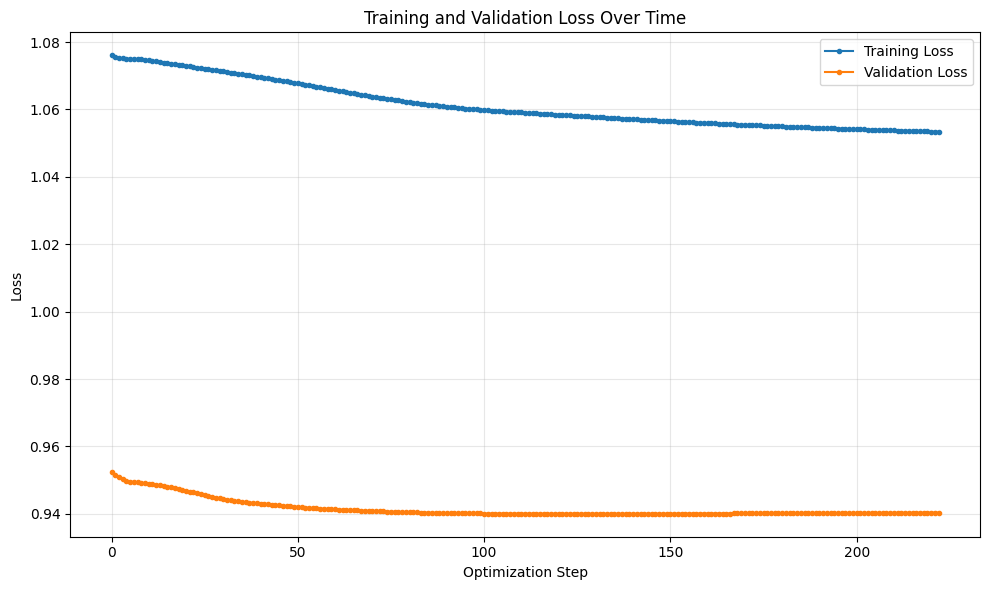

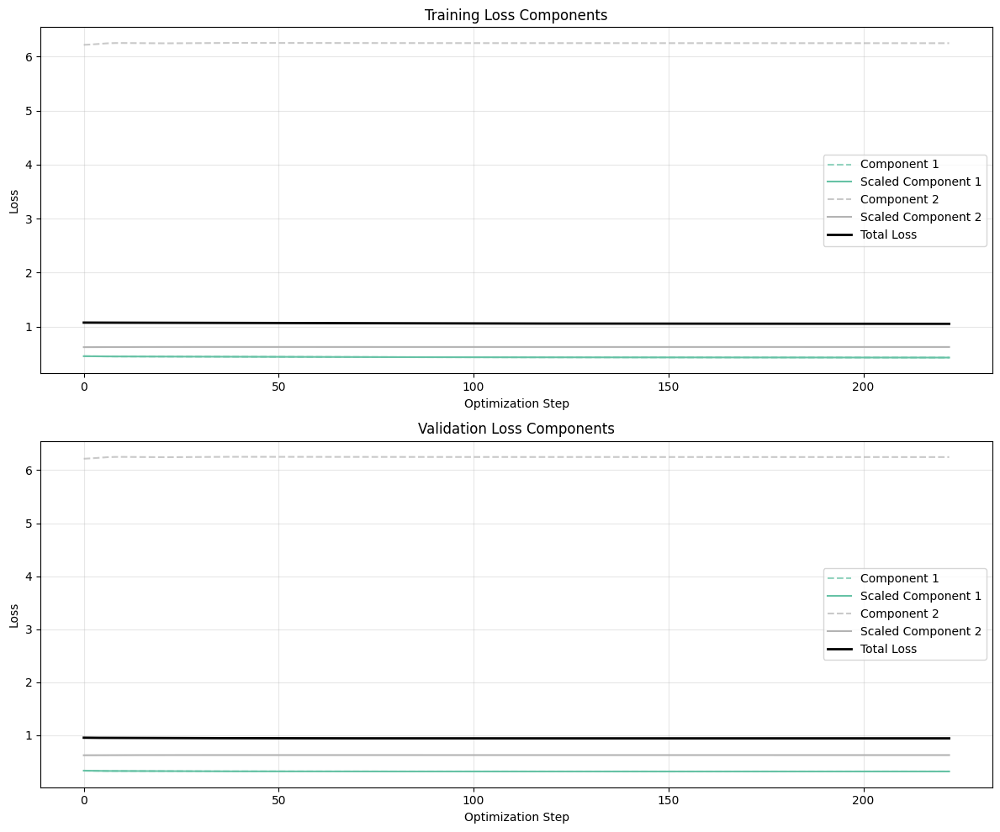

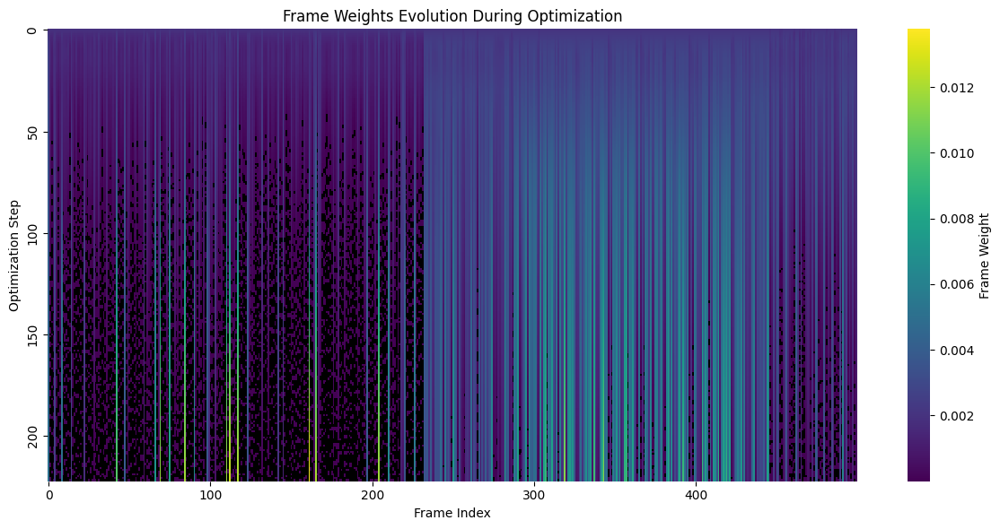

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

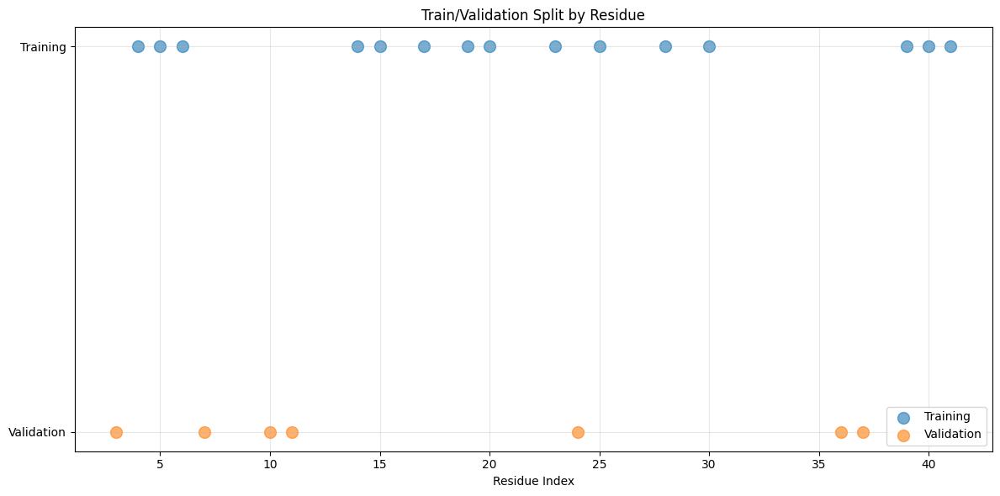

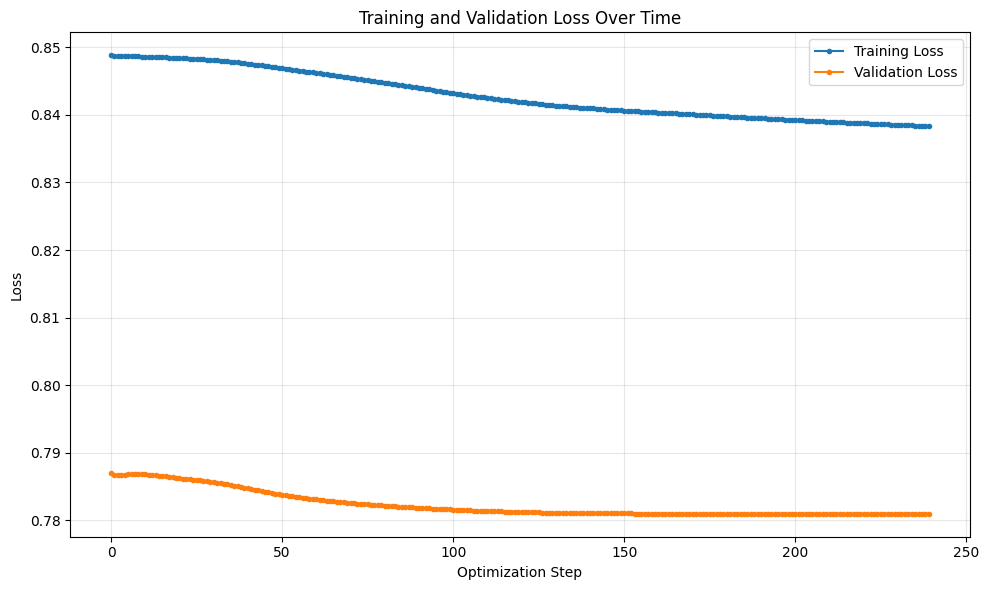

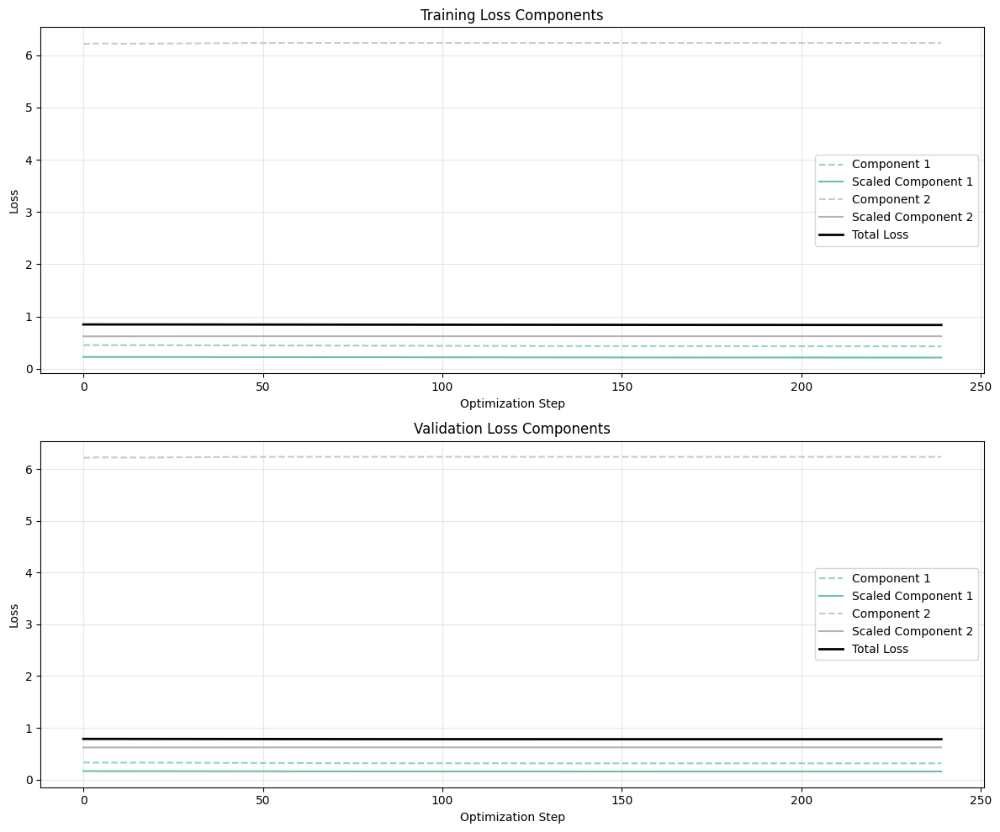

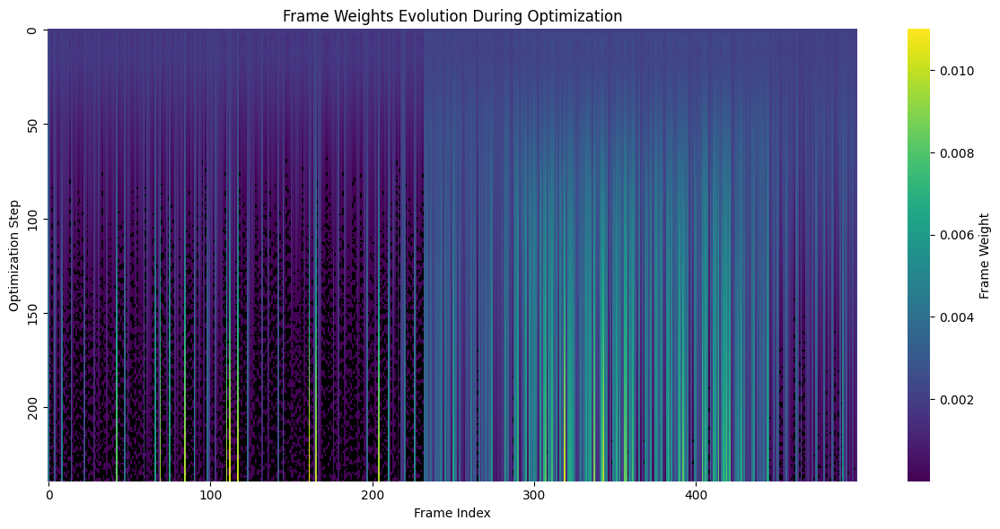

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

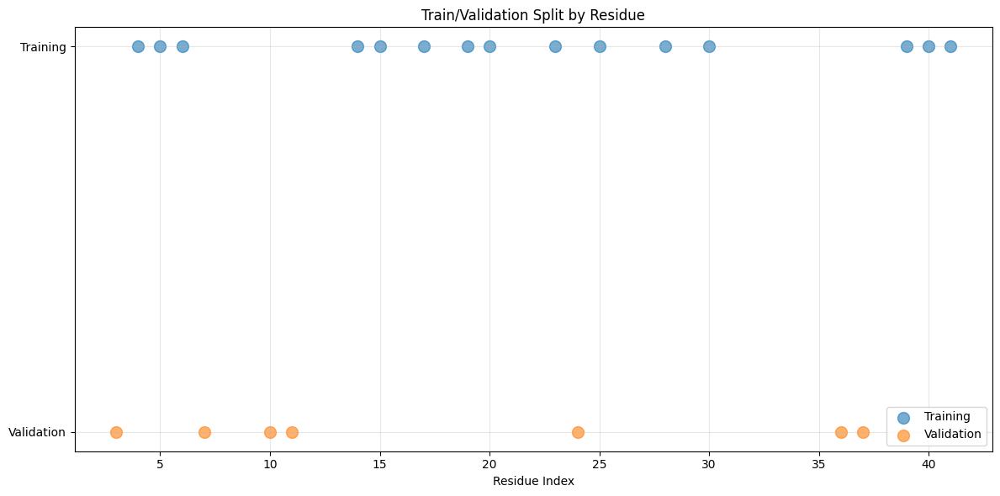

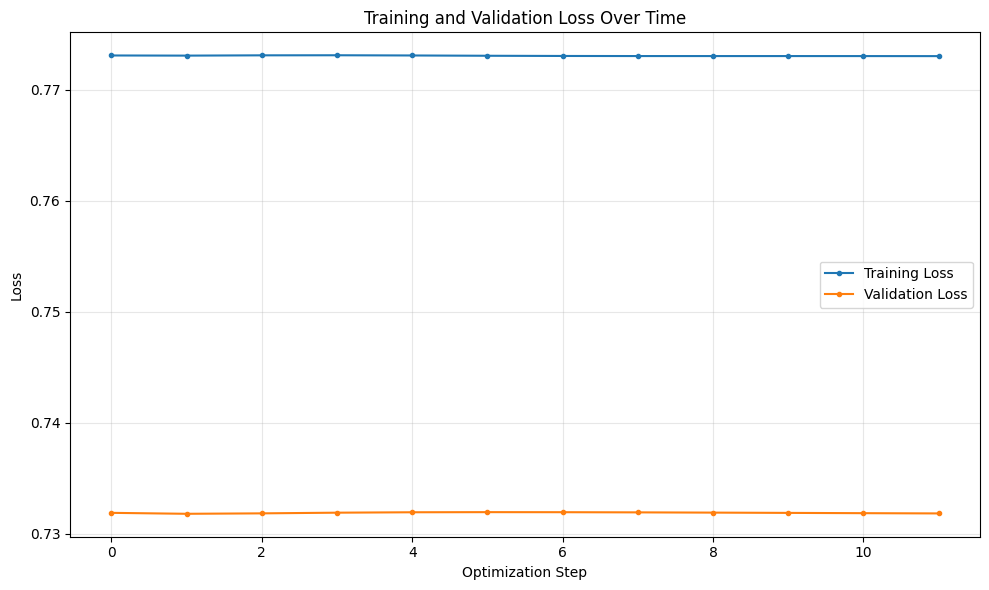

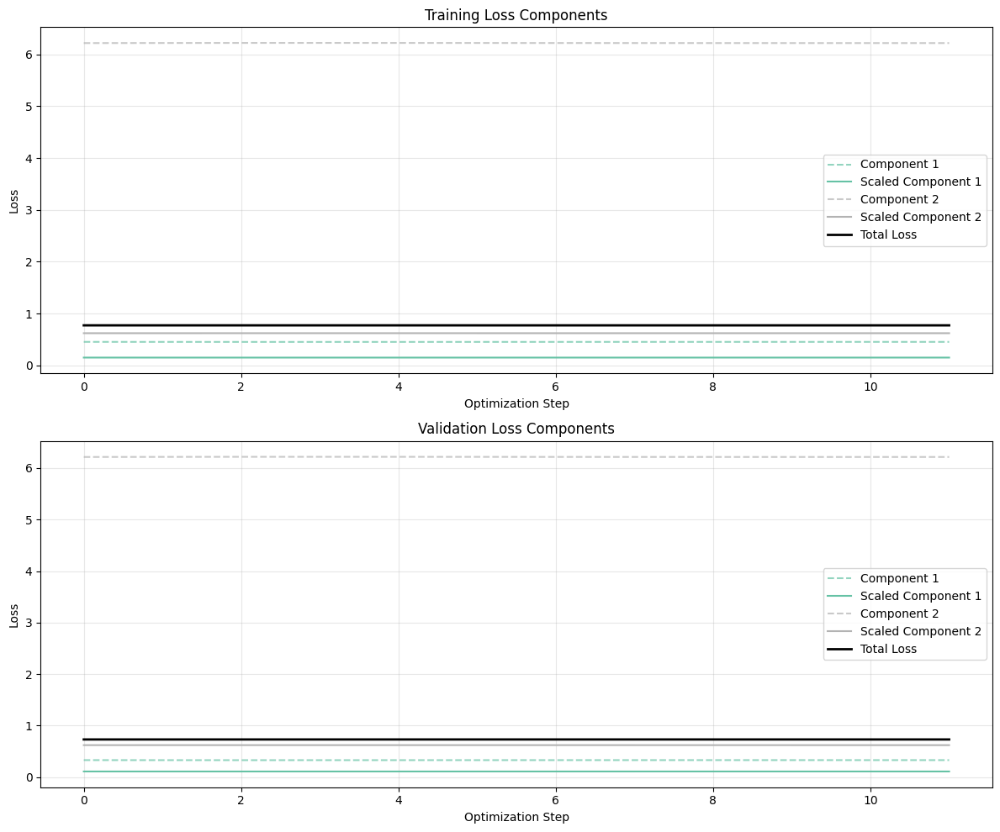

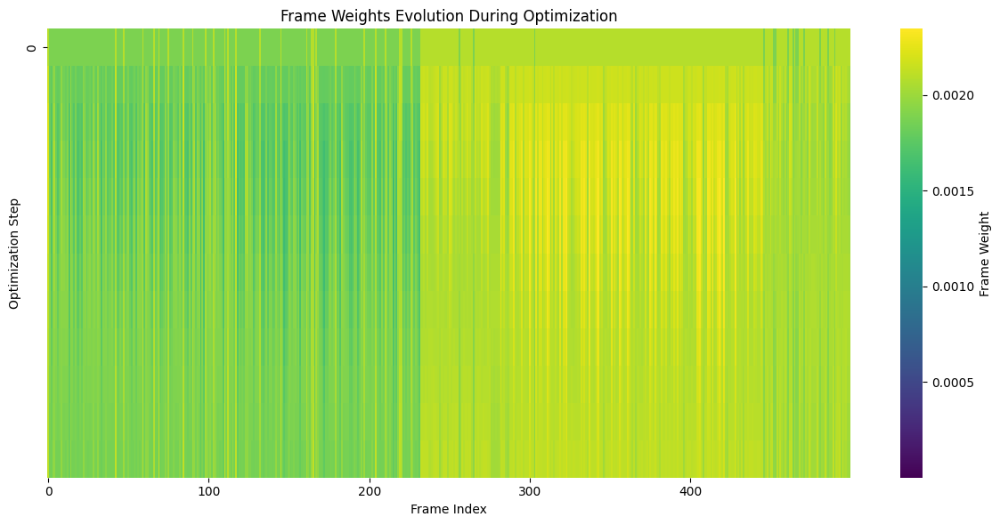

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

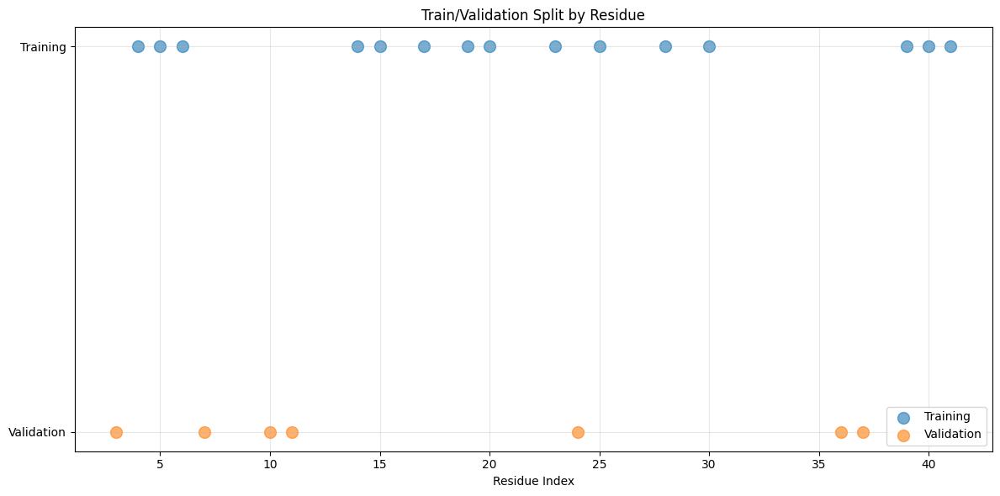

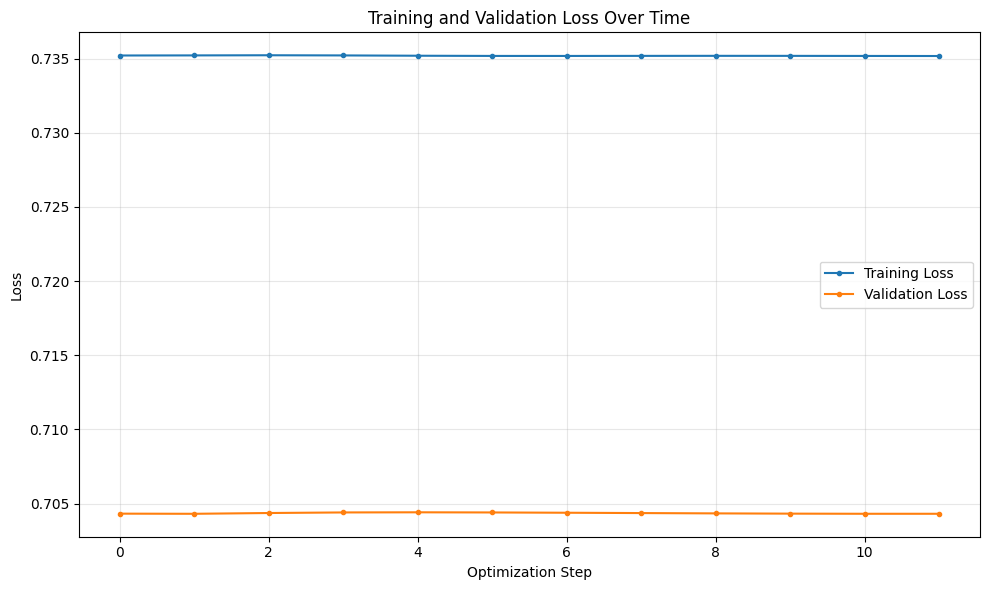

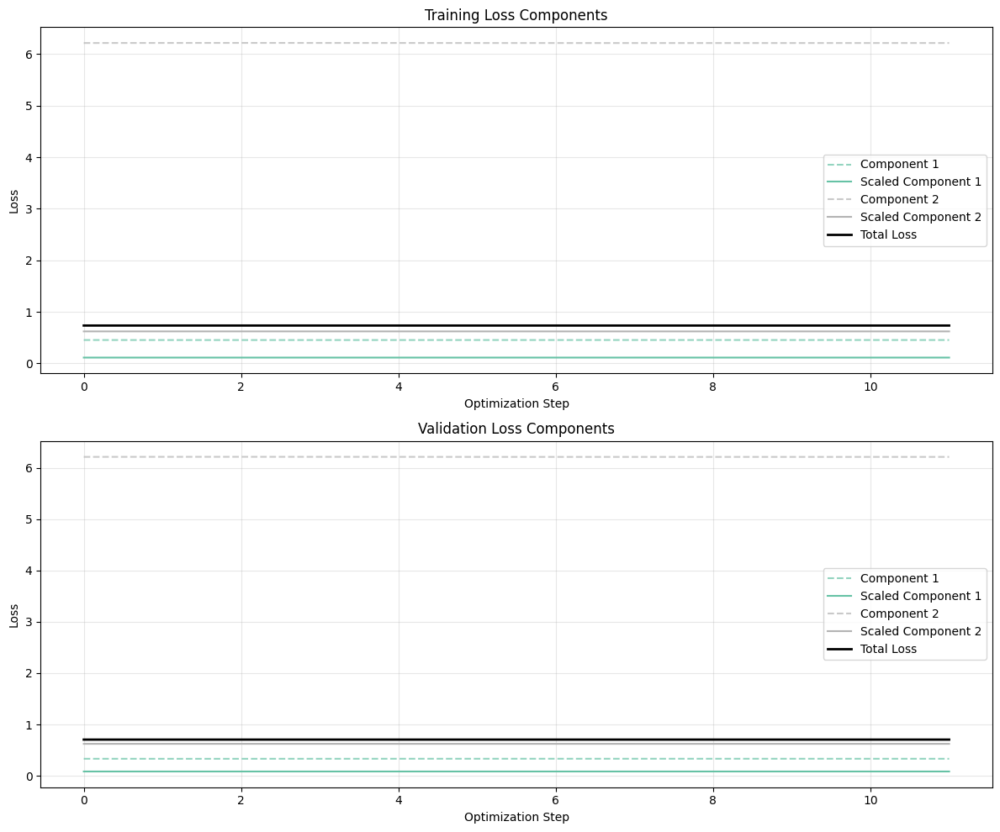

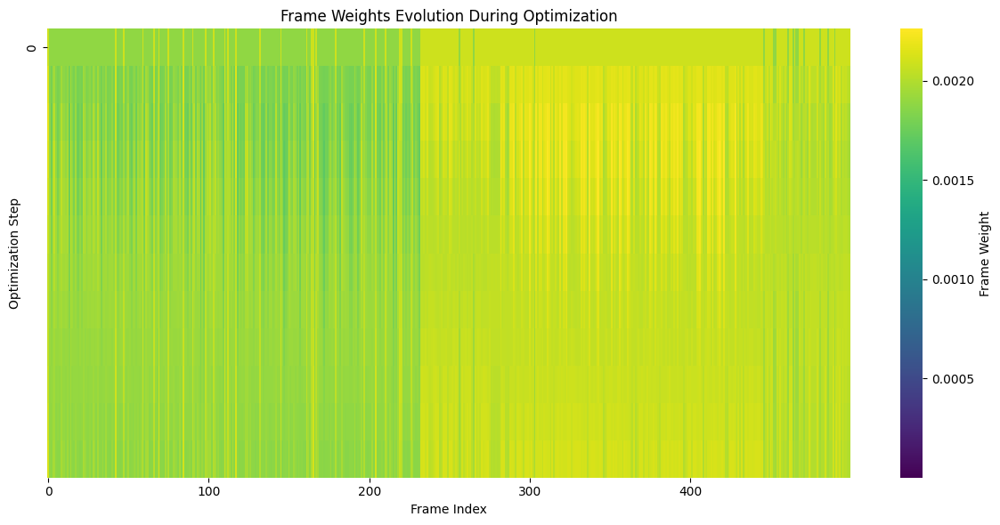

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

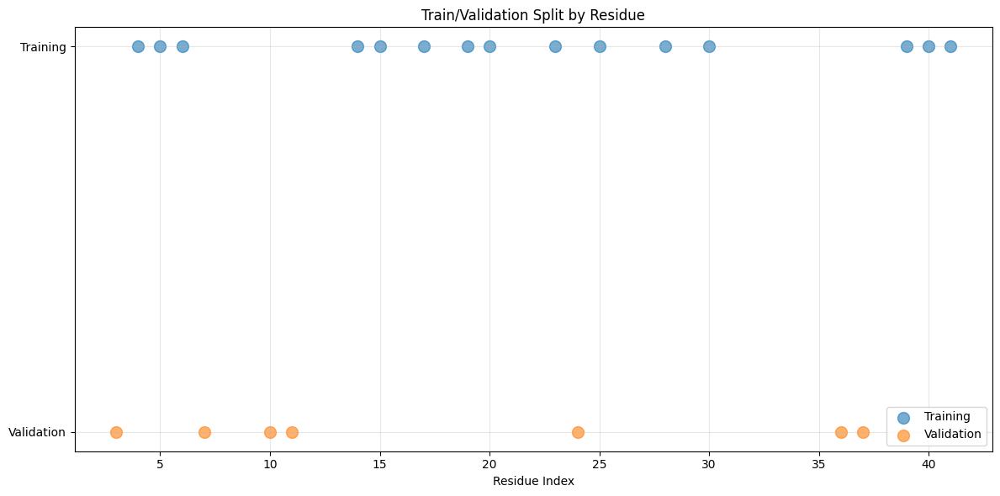

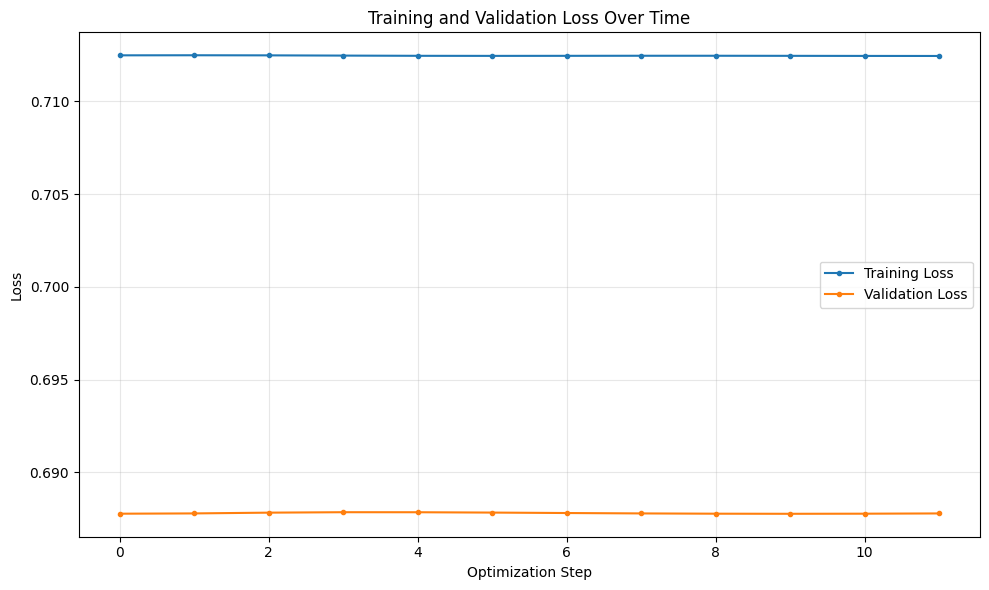

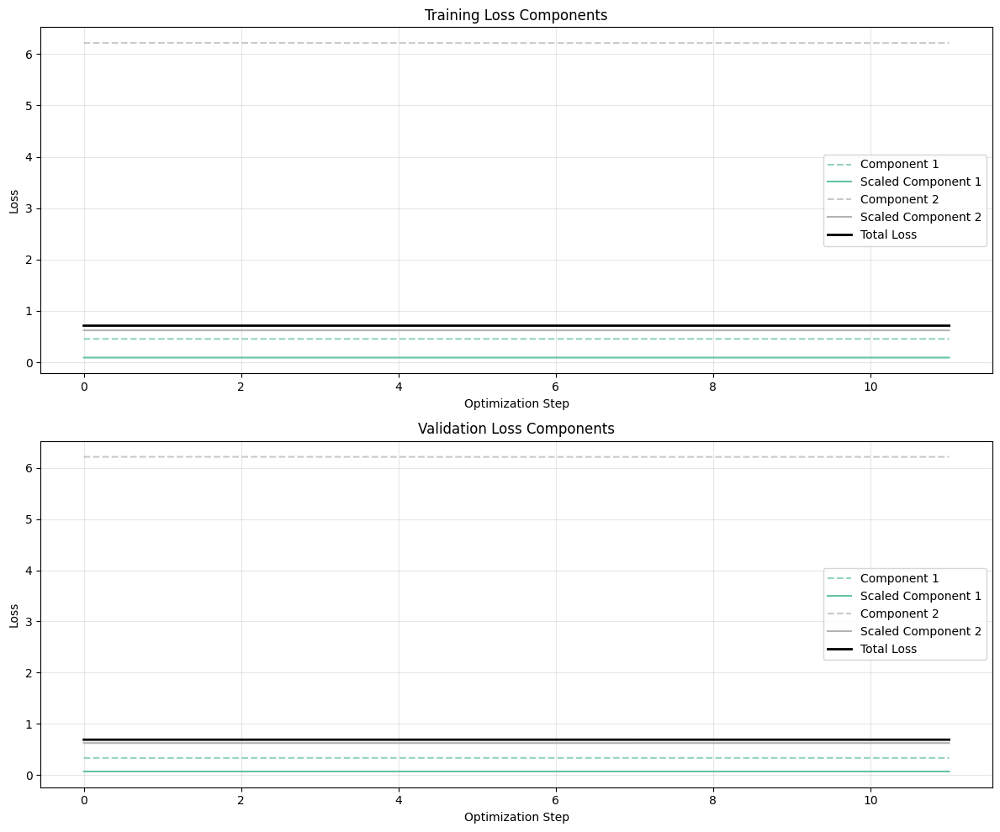

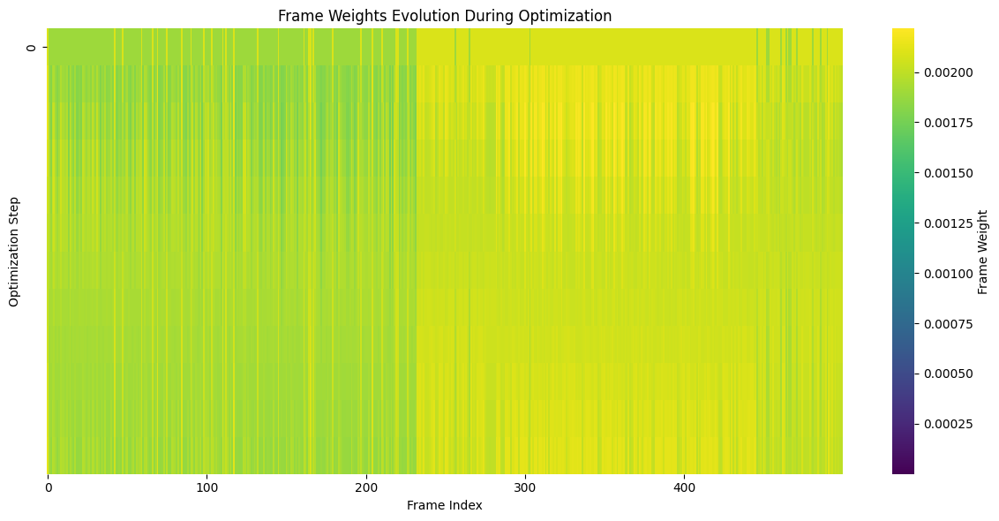

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

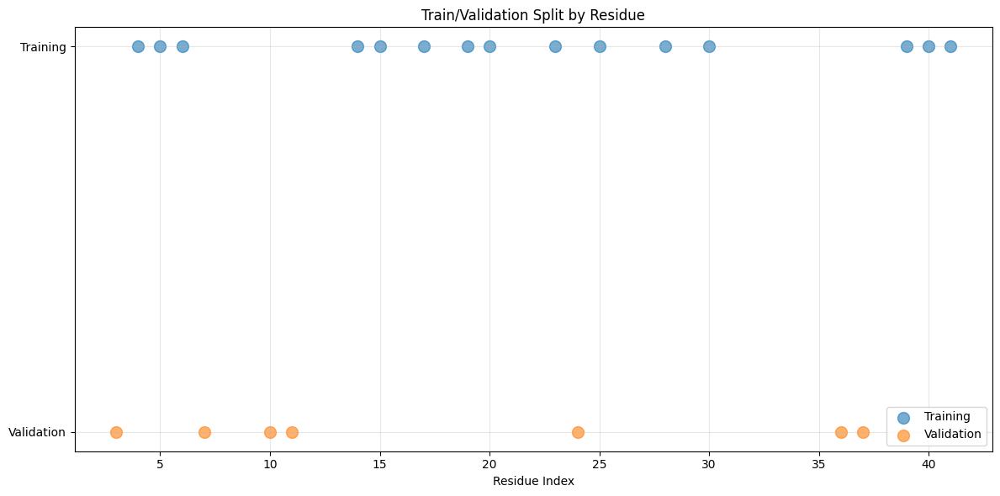

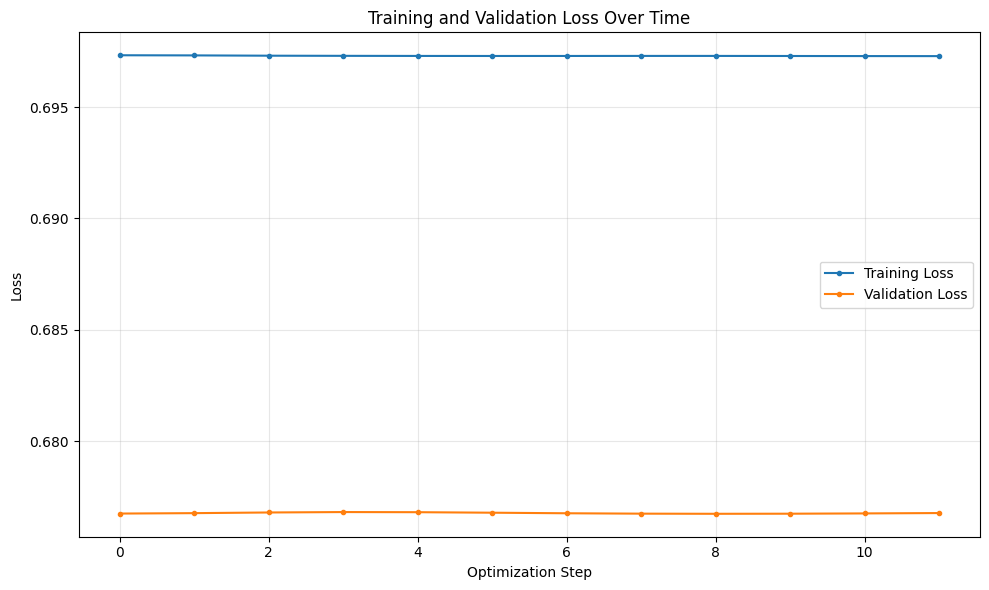

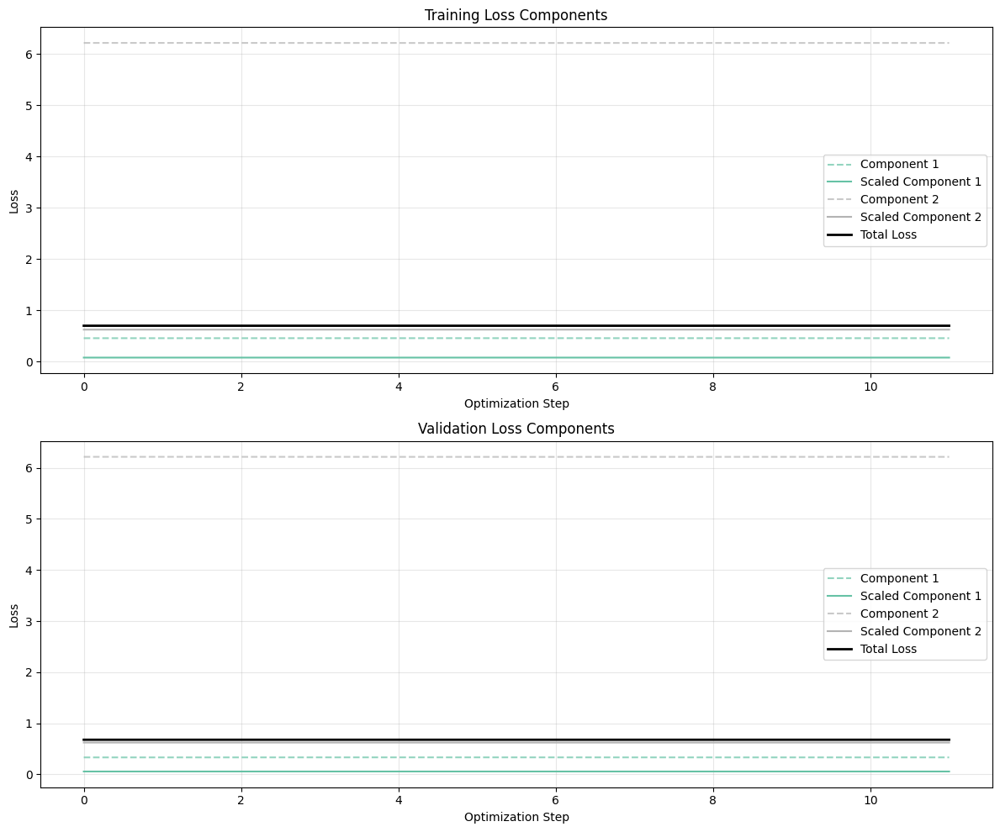

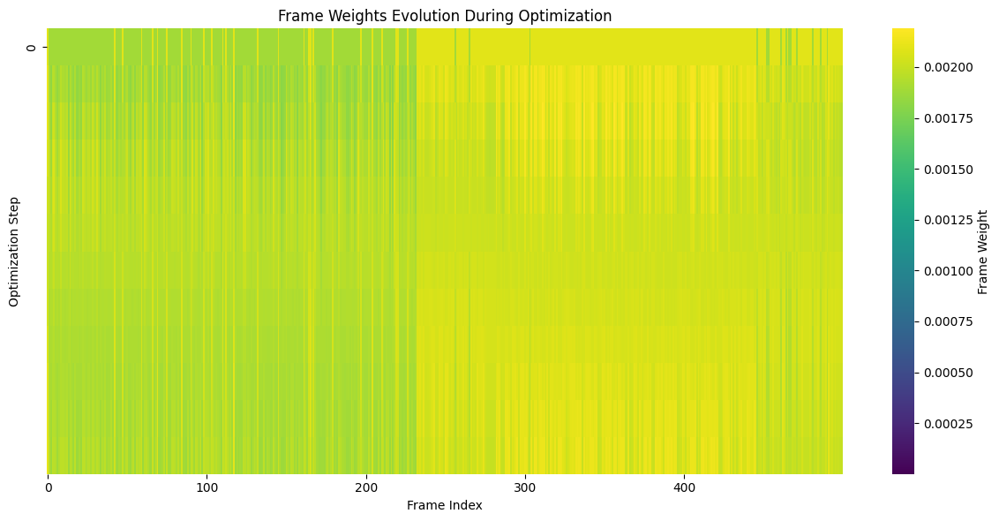

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

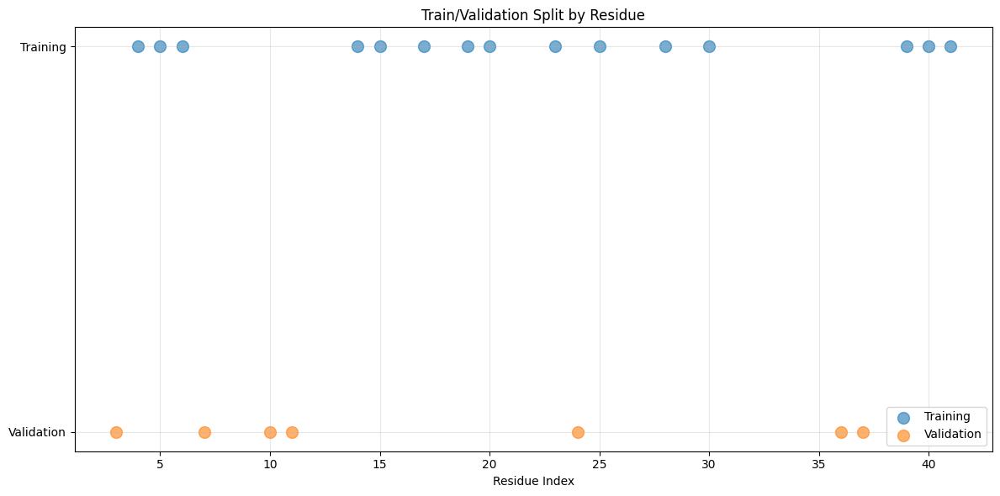

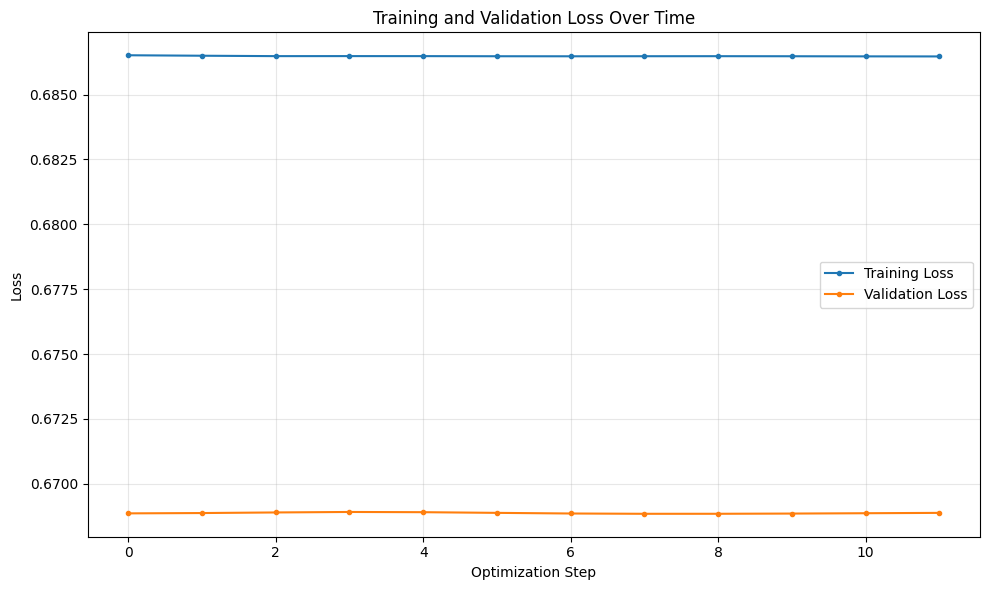

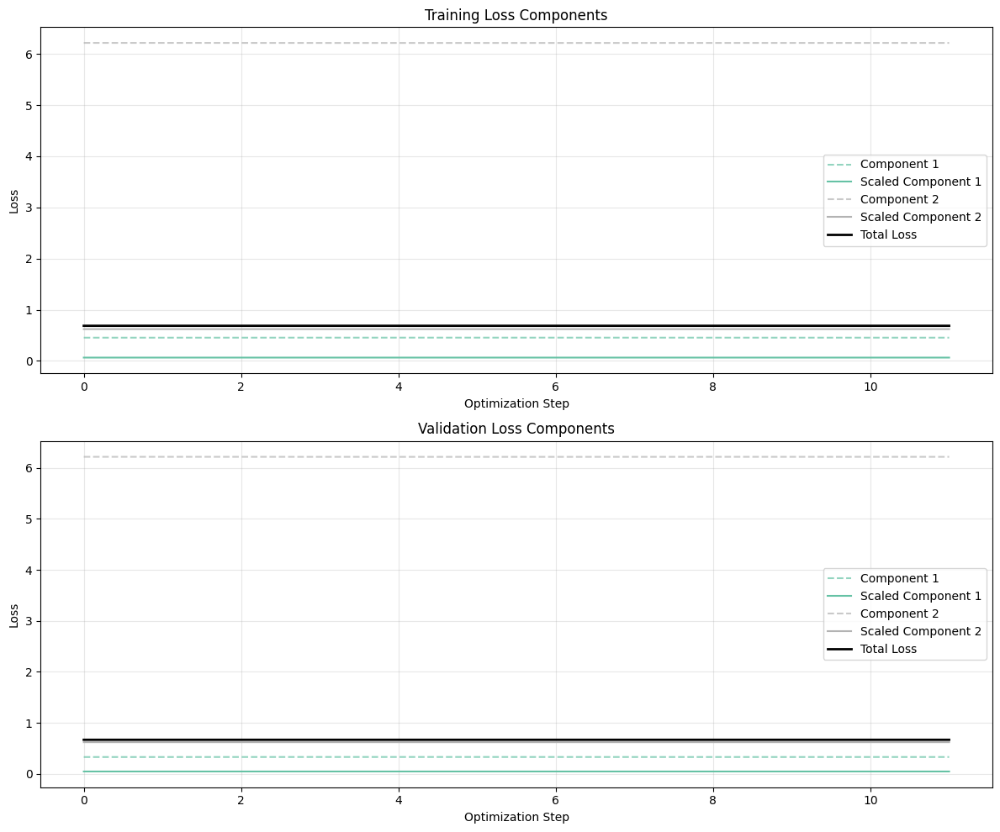

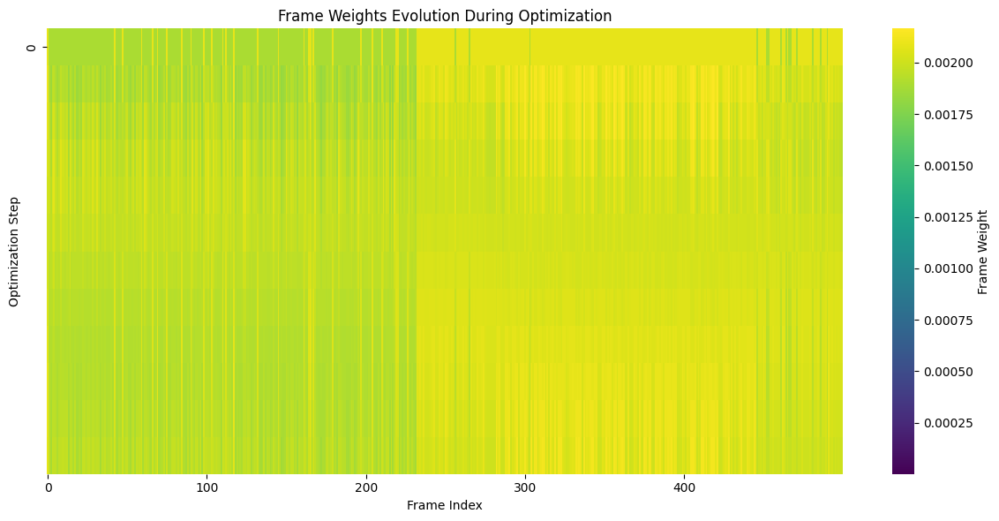

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

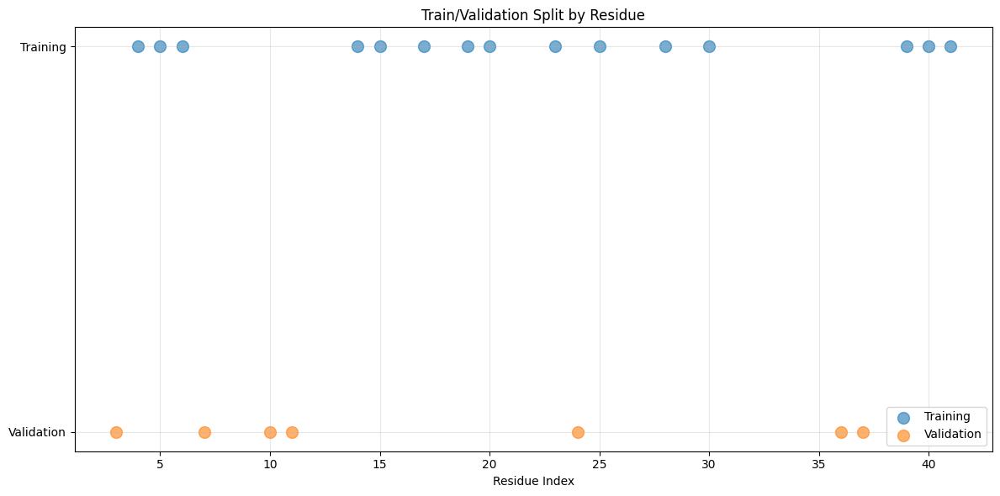

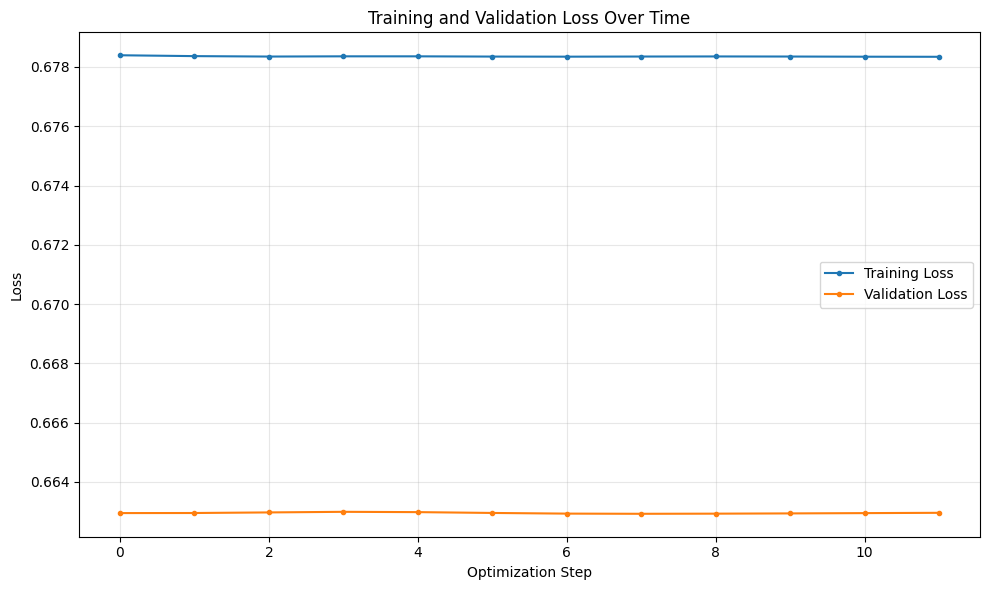

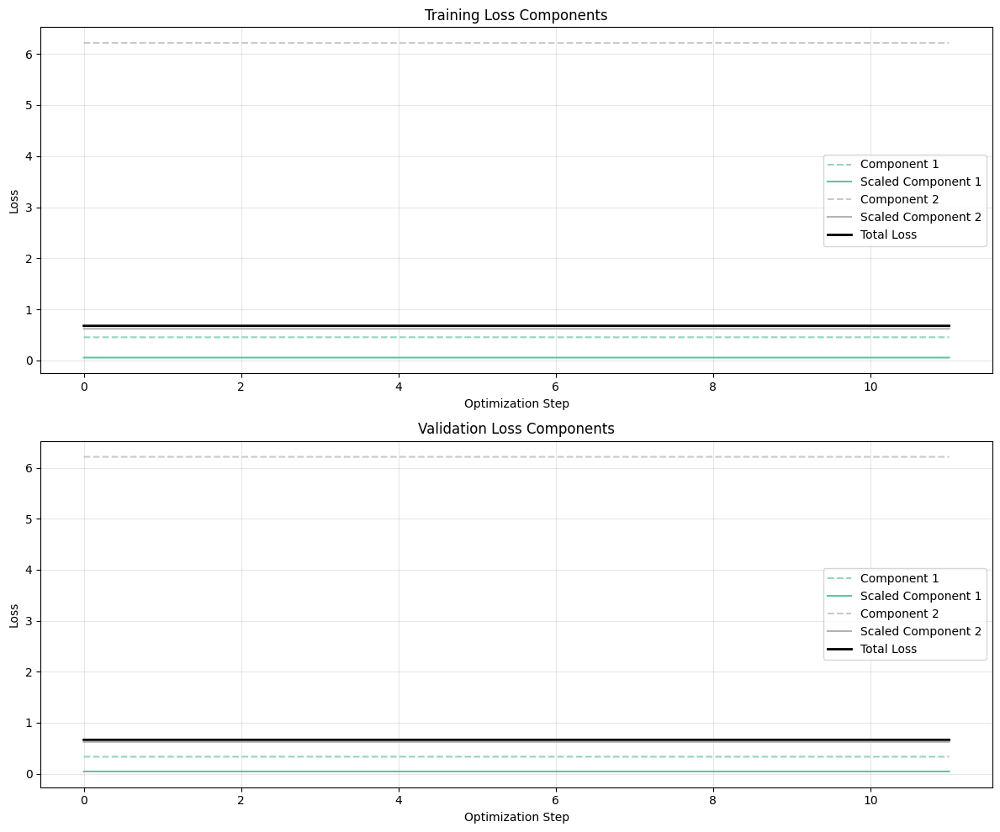

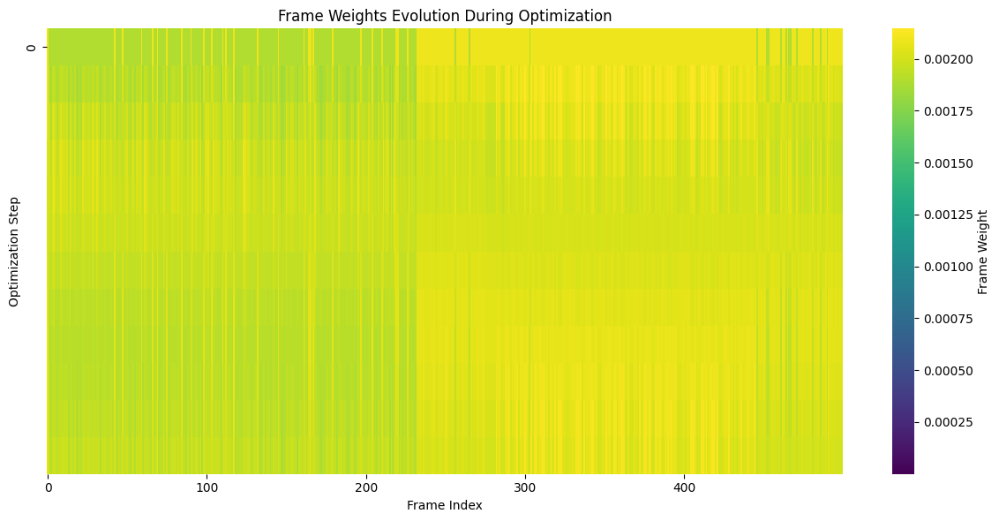

In [31]:
n_seeds = 3
seeds = [42+i for i in range(n_seeds)]
n_replicates = 8
rng_key = jax.random.PRNGKey(0)


                # Generate a new random key for each replicate
rng_key, subkey = jax.random.split(rng_key)

# Get the trajectory length from simulation
trajectory_length = simulation.input_features[0].features_shape[2]

# Randomize frame weights
random_weights = jax.random.uniform(subkey, shape=(trajectory_length,))
random_weights = simulation.params.frame_weights + random_weights
random_weights = random_weights / jnp.sum(random_weights)  # Normalize

# Create new parameters with random weights, preserving all other values
new_params = Simulation_Parameters(
    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
    frame_mask=simulation.params.frame_mask,
    model_parameters=simulation.params.model_parameters,
    forward_model_weights=jnp.array([1/(1*1+1), 0.1]),
    forward_model_scaling=jnp.ones(2),
    normalise_loss_functions=jnp.zeros(2),
)

# Create a new simulation with the updated parameters
new_simulation = Simulation(
    forward_models=simulation.forward_models,
    input_features=simulation.input_features,
    params=new_params
)
new_simulation.initialise()



me_optimization_results = run_max_ent_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates)


In [32]:

me_test_losses = compute_test_losses(me_optimization_results, datasets)


Computing test losses for Dataset Seed 1, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 26/26 [00:01<00:00, 16.63it/s]


Computing test losses for Dataset Seed 1, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 14/14 [00:00<00:00, 22.74it/s]


Computing test losses for Dataset Seed 1, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 19/19 [00:00<00:00, 22.84it/s]


Computing test losses for Dataset Seed 1, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 14/14 [00:00<00:00, 21.89it/s]


Computing test losses for Dataset Seed 1, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 14/14 [00:00<00:00, 22.30it/s]


Computing test losses for Dataset Seed 1, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 14/14 [00:00<00:00, 23.52it/s]


Computing test losses for Dataset Seed 1, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 14/14 [00:00<00:00, 22.19it/s]


Computing test losses for Dataset Seed 1, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 14/14 [00:00<00:00, 23.79it/s]


Computing test losses for Dataset Seed 2, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 250/250 [00:10<00:00, 24.08it/s]


Computing test losses for Dataset Seed 2, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 267/267 [00:11<00:00, 23.59it/s]


Computing test losses for Dataset Seed 2, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 14/14 [00:00<00:00, 23.54it/s]


Computing test losses for Dataset Seed 2, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 12/12 [00:00<00:00, 23.28it/s]


Computing test losses for Dataset Seed 2, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 15/15 [00:00<00:00, 22.40it/s]


Computing test losses for Dataset Seed 2, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 14/14 [00:00<00:00, 24.15it/s]


Computing test losses for Dataset Seed 2, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 14/14 [00:00<00:00, 22.75it/s]


Computing test losses for Dataset Seed 2, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 14/14 [00:00<00:00, 24.26it/s]


Computing test losses for Dataset Seed 3, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 223/223 [00:09<00:00, 23.24it/s]


Computing test losses for Dataset Seed 3, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 240/240 [00:10<00:00, 23.25it/s]


Computing test losses for Dataset Seed 3, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 12/12 [00:00<00:00, 26.96it/s]


Computing test losses for Dataset Seed 3, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 12/12 [00:00<00:00, 27.92it/s]


Computing test losses for Dataset Seed 3, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 12/12 [00:00<00:00, 26.69it/s]


Computing test losses for Dataset Seed 3, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 12/12 [00:00<00:00, 27.98it/s]


Computing test losses for Dataset Seed 3, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 12/12 [00:00<00:00, 26.03it/s]


Computing test losses for Dataset Seed 3, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 12/12 [00:00<00:00, 27.36it/s]


Generating PCA visualization...


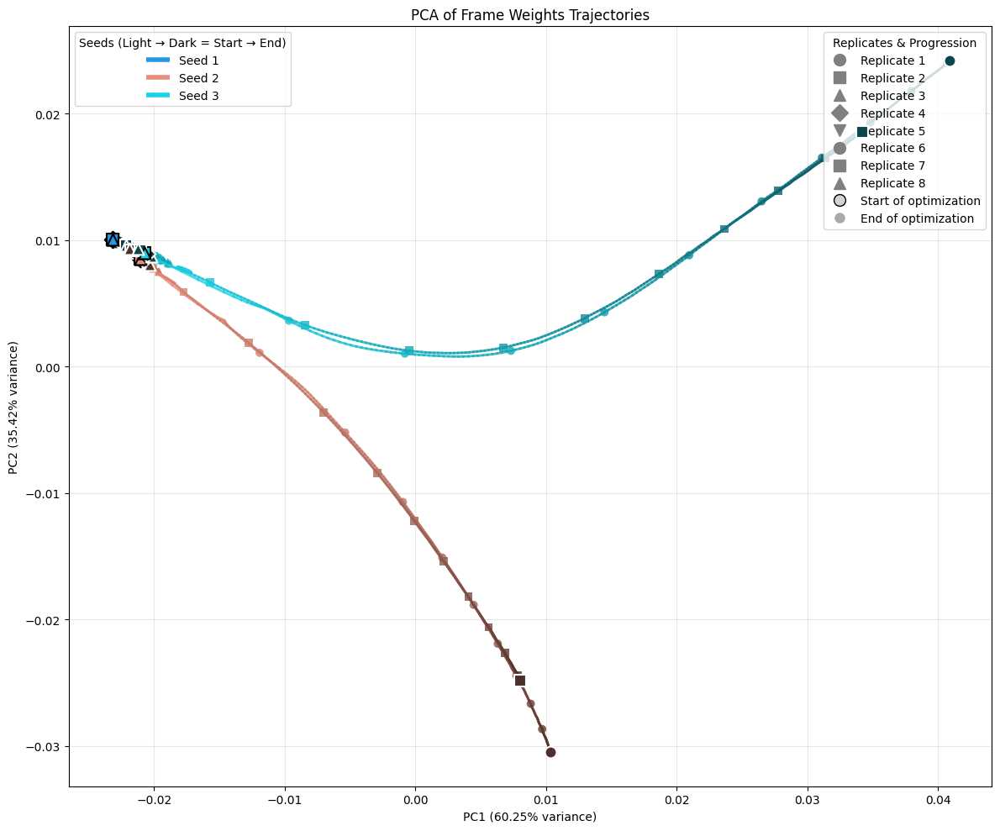

In [33]:

# Visualize PCA trajectories
print("Generating PCA visualization...")
pca_fig = visualize_pca_trajectories(me_optimization_results, n_seeds, n_replicates)
# save_pca_visualization(pca_fig)
plt.show()

Performing t-SNE with perplexity=30, n_iter=1000...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


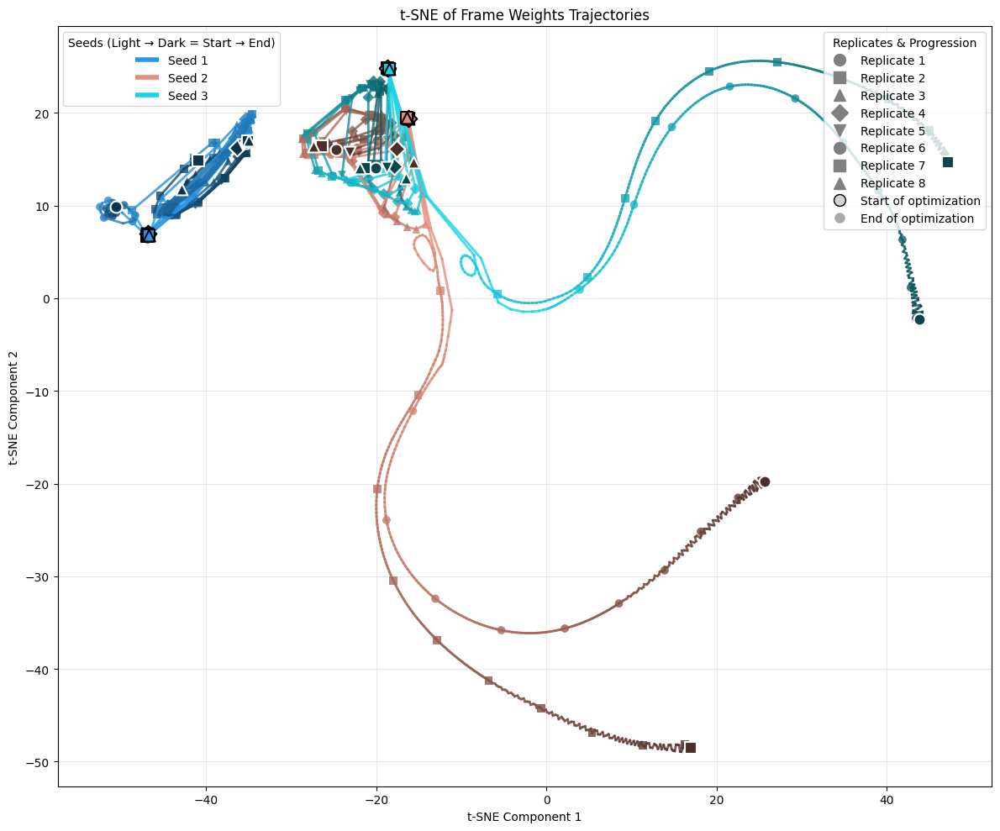

In [34]:
tsne_fig = visualize_tsne_trajectories(me_optimization_results, n_seeds, n_replicates)
plt.show()

Generating 3D t-SNE visualization with residue-average test loss...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


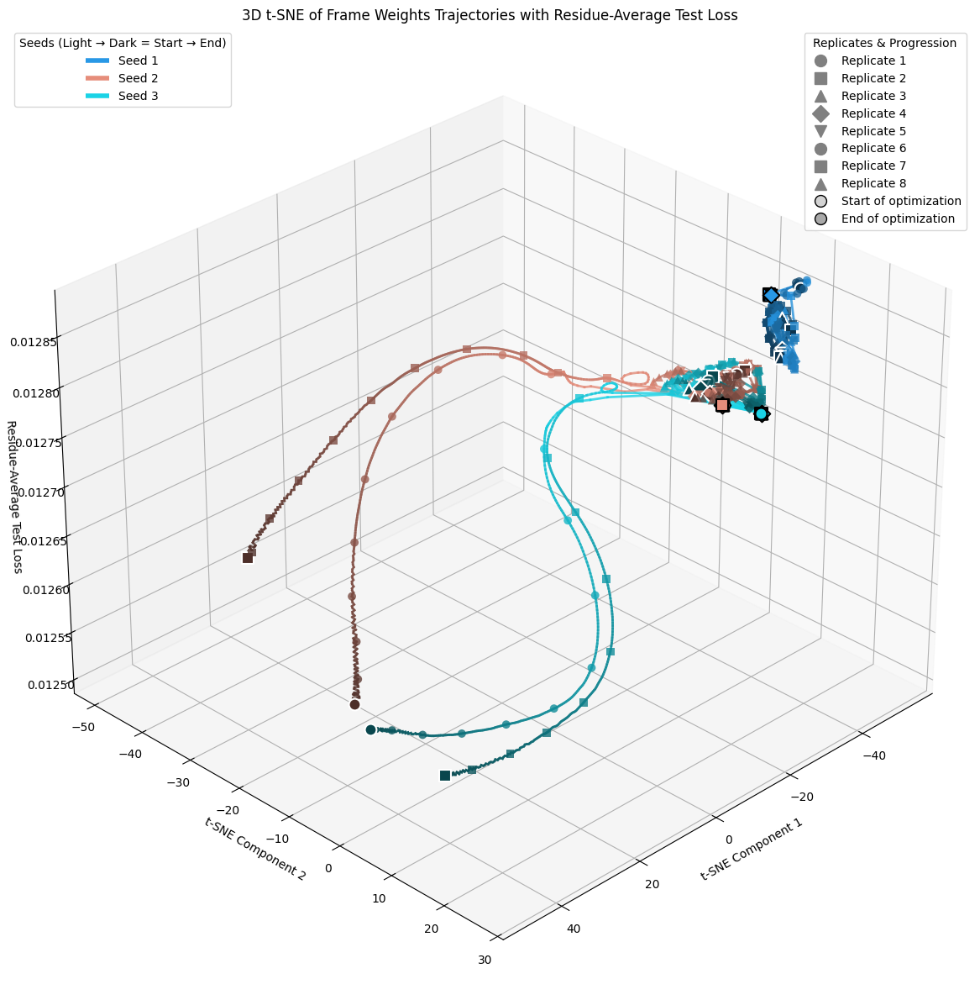

In [35]:

print("Generating 3D t-SNE visualization with residue-average test loss...")
tsne3d_fig = visualize_tsne_3d_loss(me_optimization_results, me_test_losses, n_seeds, n_replicates)
plt.show()


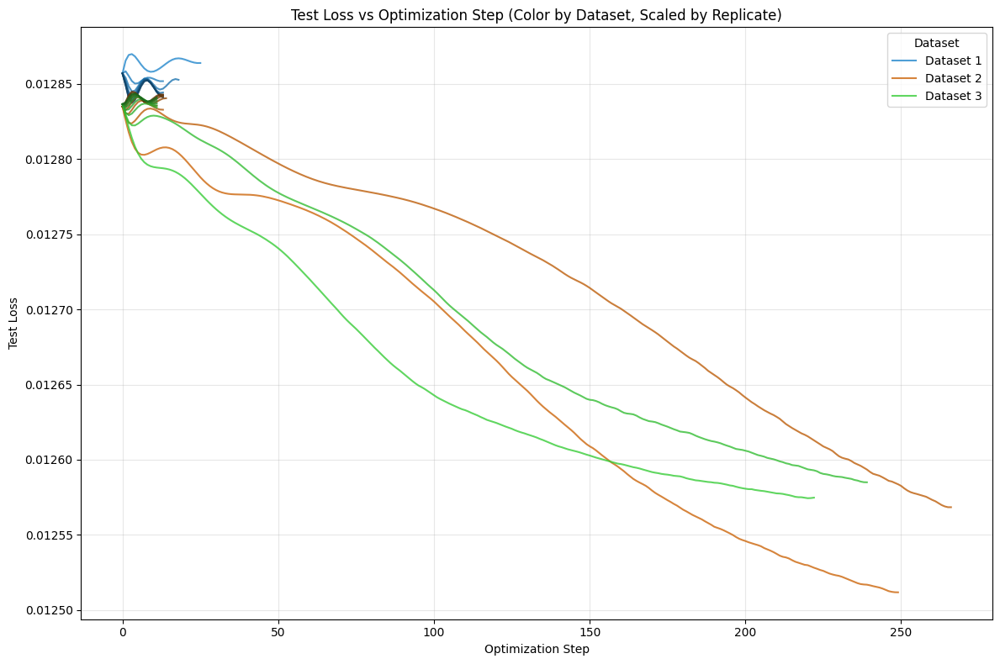

In [36]:
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

plt.figure(figsize=(12, 8))

# Loop over each dataset (seed)
for seed_idx in range(n_seeds):
    seed_key = f'seed_{seed_idx}'
    base_color = plt.cm.tab10(seed_idx)  # base color for the dataset
    # Loop over replicates for this dataset
    for rep_idx in range(n_replicates):
        replicate_losses = me_test_losses[seed_key][rep_idx]
        steps = np.arange(len(replicate_losses))
        
        # Adjust the brightness of the base color according to the replicate
        hsv = mcolors.rgb_to_hsv(base_color[:3])
        # Scale brightness from 0.8 (replicate 0) to 0.4 (last replicate)
        brightness = 0.8 - (rep_idx / (n_replicates - 1)) * (0.8 - 0.4)
        hsv[2] = brightness
        color = mcolors.hsv_to_rgb(hsv)
        
        # Use label only for the first replicate per dataset
        label = f"Dataset {seed_idx+1}" if rep_idx == 0 else None
        
        plt.plot(steps, replicate_losses, color=color, label=label, alpha=0.8)

plt.xlabel("Optimization Step")
plt.ylabel("Test Loss")
plt.title("Test Loss vs Optimization Step (Color by Dataset, Scaled by Replicate)")
plt.legend(title="Dataset")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

Generating validation vs test loss comparison...


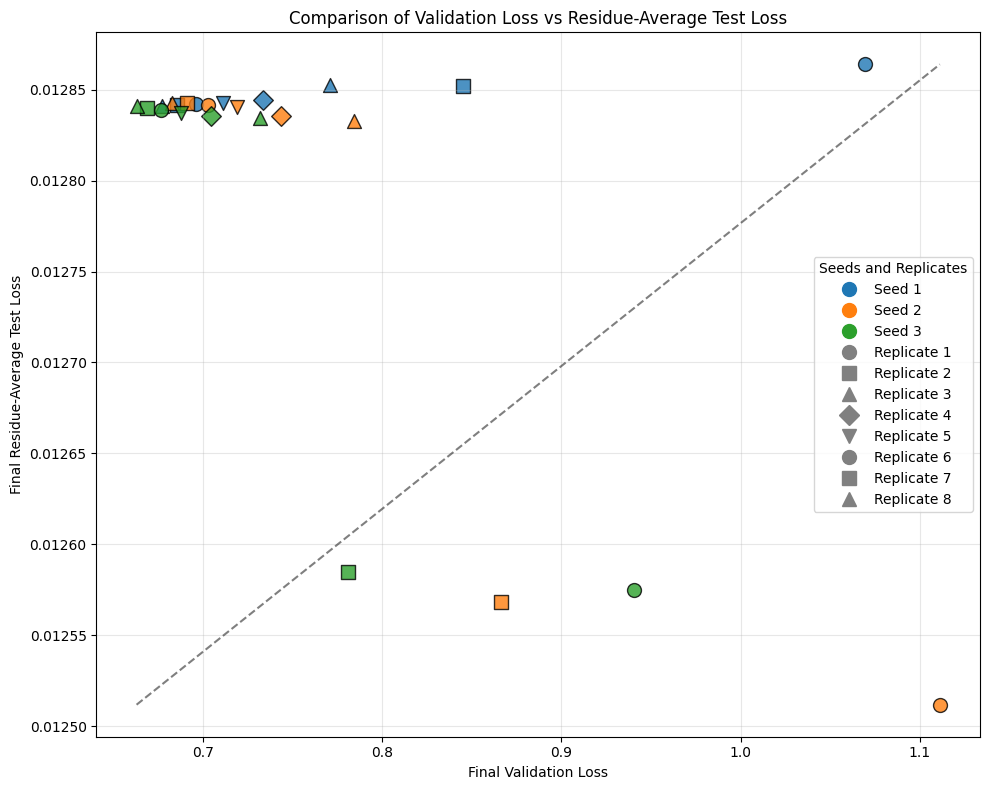

In [37]:
print("Generating validation vs test loss comparison...")
comparison_fig = plot_val_vs_test_loss(me_optimization_results, me_test_losses, n_seeds, n_replicates)
plt.show()

In [38]:
rng_key = jax.random.PRNGKey(0)

rng_key, subkey = jax.random.split(rng_key)

# Get the trajectory length from simulation
trajectory_length = simulation.input_features[0].features_shape[2]

# Randomize frame weights
random_weights = jax.random.uniform(subkey, shape=(trajectory_length,))
random_weights = simulation.params.frame_weights + random_weights
random_weights = random_weights / jnp.sum(random_weights)  # Normalize

# Create new parameters with random weights, preserving all other values
new_params = Simulation_Parameters(
frame_weights=jnp.ones(trajectory_length) / trajectory_length,
frame_mask=simulation.params.frame_mask,
model_parameters=simulation.params.model_parameters,
forward_model_weights=jnp.array([1/(1*1+1),1.0,0.1],dtype=jnp.float32),
forward_model_scaling=jnp.array([1.0,0.1,1.0],dtype=jnp.float32),
normalise_loss_functions=jnp.array([0.0,0.0,0.0],dtype=jnp.float32),
)

new_simulation = Simulation(
forward_models=simulation.forward_models,
input_features=simulation.input_features,
params=new_params
)
new_simulation.initialise()
# Create a new simulation with the updated parameters

new_simulation.forward(new_params)

prior_pfs = test_prediction[0].uptake.T

# need to reshape to a list of length 53 and Arrays of shape 3
prior_data = [
HDX_peptide(dfrac=_prior_df, top=top) for _prior_df, top in zip(prior_pfs, exp_topology)
]

pf_prior_data = ExpD_Dataloader(data=prior_data)

prior_splitter = DataSplitter(pf_prior_data, 
                        random_seed=42, 
                        ensemble=universes, 
                        common_residues=set(feature_topology[0]), 
                        peptide=False,)
prior_train_data, prior_val_data = prior_splitter.random_split()

prior_train_sparse_map = create_sparse_map(features[0], feature_topology[0], prior_train_data)

prior_val_sparse_map = create_sparse_map(features[0], feature_topology[0], prior_val_data)

prior_test_sparse_map = create_sparse_map(features[0], feature_topology[0], pf_prior_data.data)

pf_prior_data.train = Dataset(
data=prior_train_data,
y_true=jnp.array([data.extract_features() for data in prior_train_data]),
residue_feature_ouput_mapping=prior_train_sparse_map,
)

pf_prior_data.val = Dataset(
data=prior_val_data,
y_true=jnp.array([data.extract_features() for data in prior_val_data]),
residue_feature_ouput_mapping=prior_val_sparse_map,
)

pf_prior_data.test = Dataset(
data=pf_prior_data.data,
y_true=jnp.array([data.extract_features() for data in pf_prior_data.data]),
residue_feature_ouput_mapping=prior_test_sparse_map,
)




# Function to run optimization for each dataset seed and replicate


def run_MAE_max_ent_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates):
    """
    Runs optimization for each dataset and replicate with randomized frame weights.
    
    Parameters:
    -----------
    simulation : Simulation
        Simulation object
    datasets : list
        List of dataset objects
    models : list
        List of forward model objects
    opt_settings : OptimiserSettings
        Optimization settings
    n_replicates : int
        Number of replicates per dataset
        
    Returns:
    --------
    results : dict
        Dictionary of optimization results for each dataset and replicate
    """
    results = {}
    rng_key = jax.random.PRNGKey(0)

    prior_params = simulation.params
    
    for i, dataset in enumerate(datasets):
        seed_results = []
        
        for j in range(n_replicates):
            try:
                # Generate a new random key for each replicate


                new_params = Simulation_Parameters(
                    frame_weights=jnp.ones(trajectory_length) / trajectory_length,
                    frame_mask=simulation.params.frame_mask,
                    model_parameters=simulation.params.model_parameters,
                    forward_model_weights=jnp.array([1/(j*1+1),0.1,1.0],dtype=jnp.float32),
                    forward_model_scaling=jnp.array([1.0,0.1,1.0],dtype=jnp.float32),
                    normalise_loss_functions=jnp.array([0.0,0.0,0.0],dtype=jnp.float32),
                    )

                new_simulation.initialise()
                # Create a new simulation with the updated parameters

                new_simulation.forward(new_params)


                optimiser = OptaxOptimizer(parameter_masks={Optimisable_Parameters.frame_weights}, learning_rate=1e-4)
                # Run optimization
                print(f"Running optimization for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                opt_result = run_optimise(
                    new_simulation,
                    optimizer=optimiser,
                    data_to_fit=(dataset,prior_params,pf_prior_data),
                    config=opt_settings,
                    forward_models=models,
                    indexes=[0, 0, 0],
                    loss_functions=[hdx_uptake_l2_loss, max_entropy_loss, hdx_uptake_l1_loss],
                )
                
                # Store the result
                seed_results.append(opt_result)
                
                # Visualize this optimization run
                print(f"Visualizing results for Dataset Seed {i+1}/{len(datasets)}, Replicate {j+1}/{n_replicates}")
                visualize_optimization_results(
                    dataset.train.data, 
                    dataset.val.data, 
                    dataset.test.data, 
                    opt_result
                )
            except Exception as e:
                print(f"Error in Dataset Seed {i+1}, Replicate {j+1}: {e}")
                # Add a placeholder for failed runs to maintain indexing
                seed_results.append(None)
        
        results[f"seed_{i}"] = seed_results
    jax.clear_caches()
    return results

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Data Length: 36
First Partial Topology: Partial_Topology(chain='SYST', fragment_sequence='CYS', residue_start=np.int64(5), residue_end=np.int64(5), peptide_trim=2, fragment_index=2, length=np.int64(1))
Common residues: 53
Dataset size: 36
Input shapes:
Input features shape: (53, 53, 500)
Number of feature topology fragments: 53
Number of output features: 16

Sample feature topology:
Fragment 0: chain=SYST, start=3, end=3
Fragment 1: chain=SYST, start=4, end=4
Fragment 2: chain=SYST, start=5, end=5

Sample output features:
Fragment 0: chain=SYST, start=10, end=10
Fragment 1: chain=SYST, start=34, end=34
Fragment 2: chain=SYST, start=5, end=5
[Partial_Topology(chain='SYST', fragment_sequence='ASP', residue_start=np.int64(3), residue_end=np.int64(3), peptide_trim=2, fragment_index=0, length=np.int64(1)), Pa

In [39]:

# opt_settings = OptimiserSettings(name="test", n_steps=500, learning_rate=1e-3)

# featuriser_settings = FeaturiserSettings(name="BV", batch_size=None)

# topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/HOIP/train_HOIP_max_plddt_1/HOIP_apo697_1_af_sample_127_10000_protonated_max_plddt_1969.pdb"
# topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
# # trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
# topology_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_overall_combined_stripped.pdb"
# trajectory_path = "/home/alexi/Documents/JAX-ENT/jaxent/tests/inst/clean/BPTI/BPTI_sampled_500.xtc"
# test_universe = Universe(topology_path, trajectory_path)

# universes = [test_universe]

# models = [BV_model(bv_config)]

# ensemble = Experiment_Ensemble(universes, models)

# features, feature_topology = run_featurise(ensemble, featuriser_settings)
# top_segments = find_common_residues(
#     universes, ignore_mda_selection="(resname PRO or resid 1) "
# )[0]

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

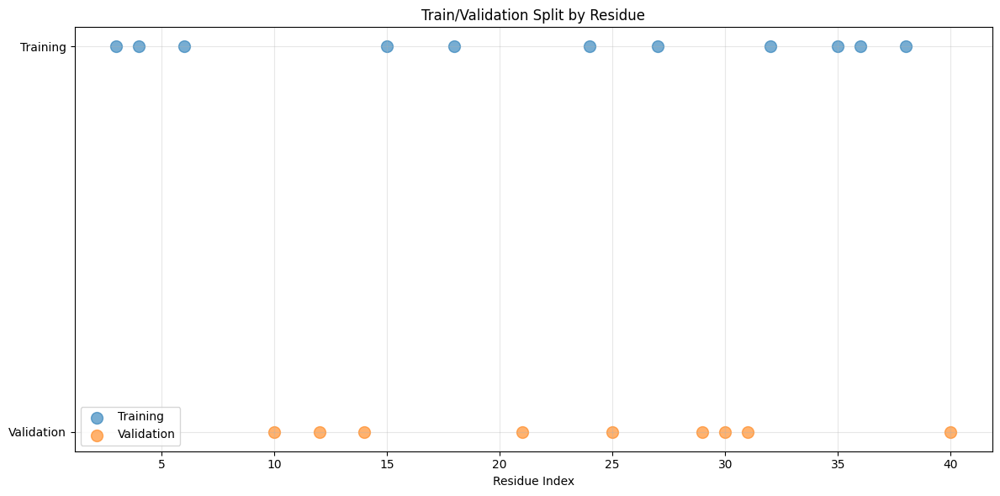

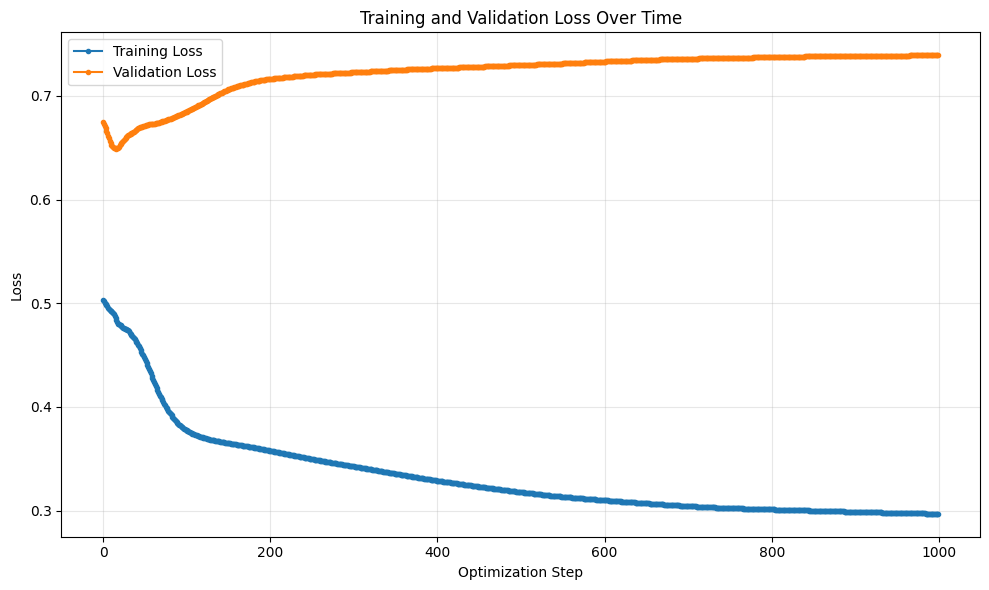

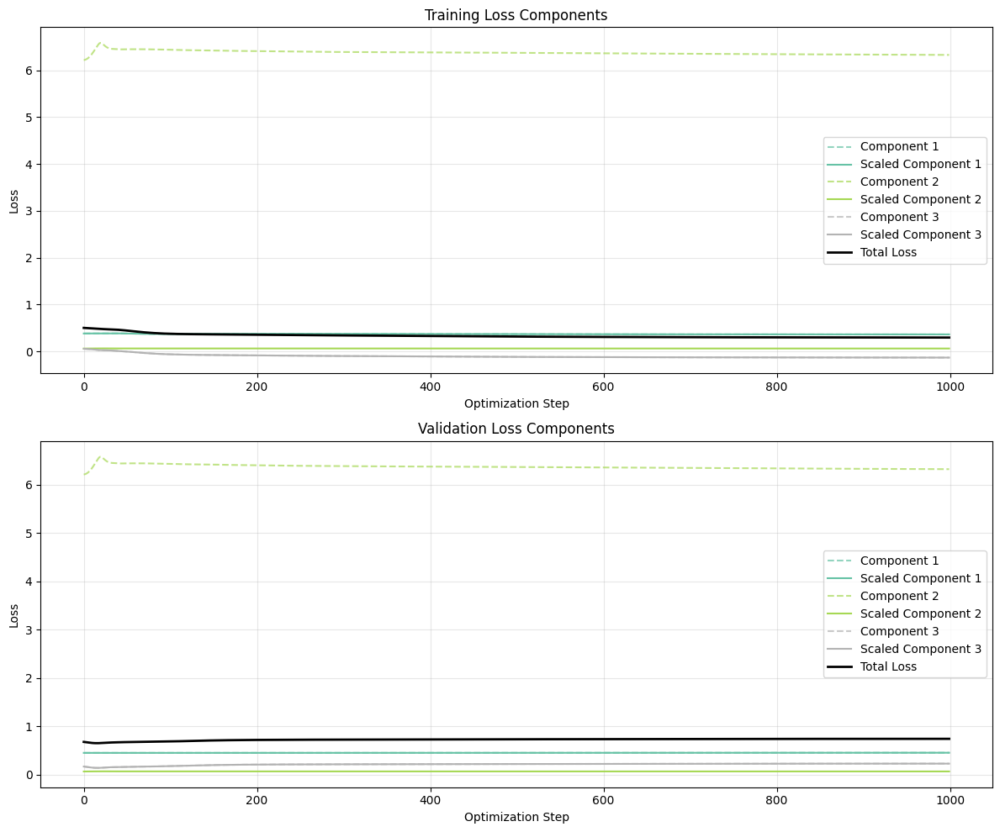

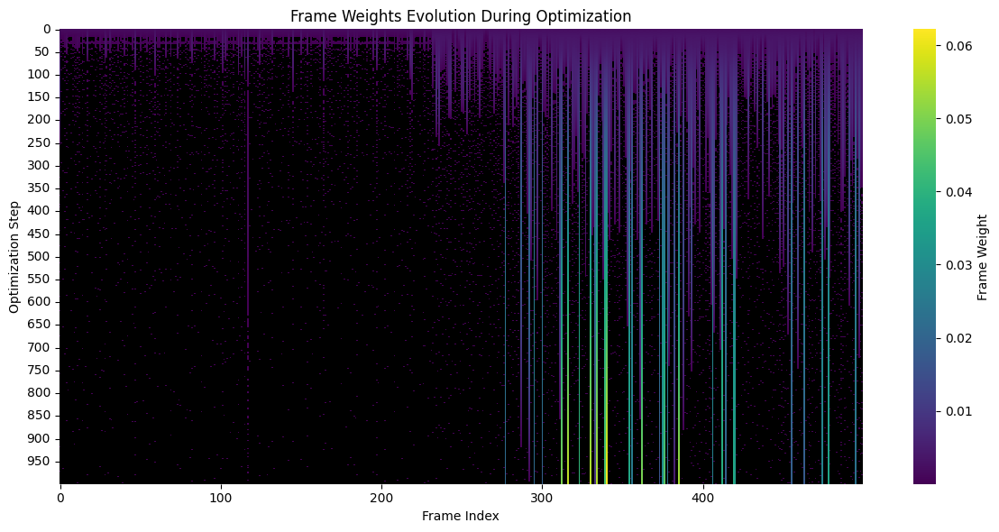

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

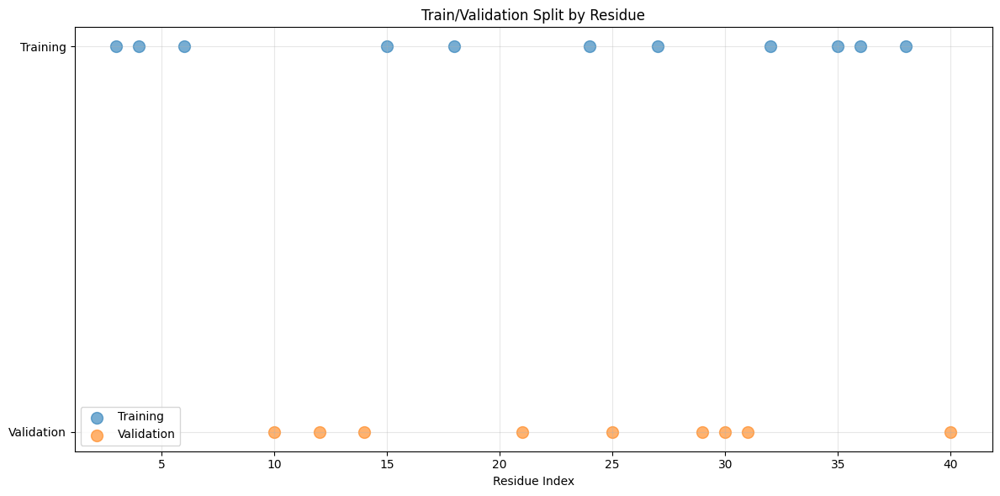

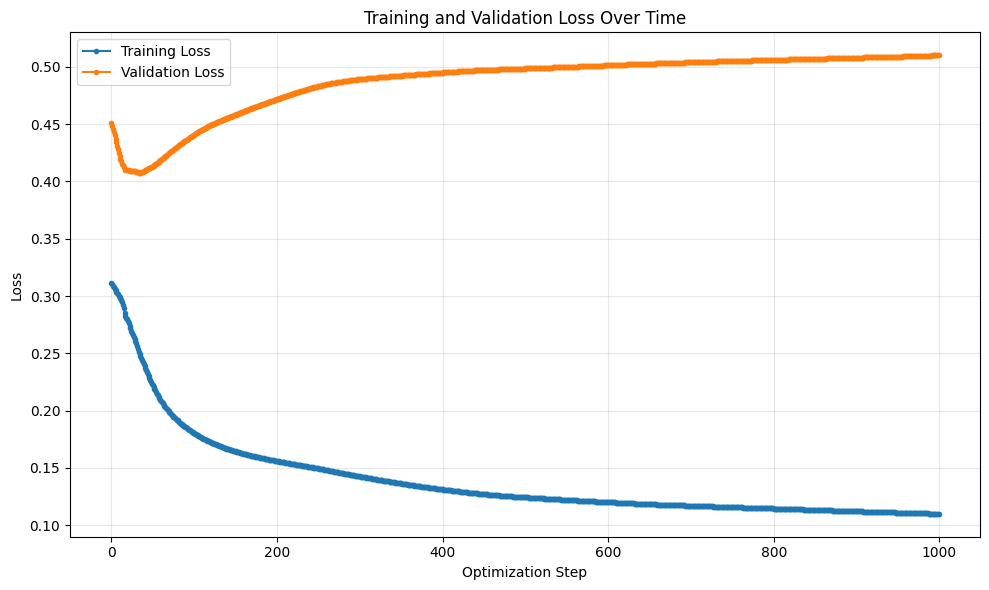

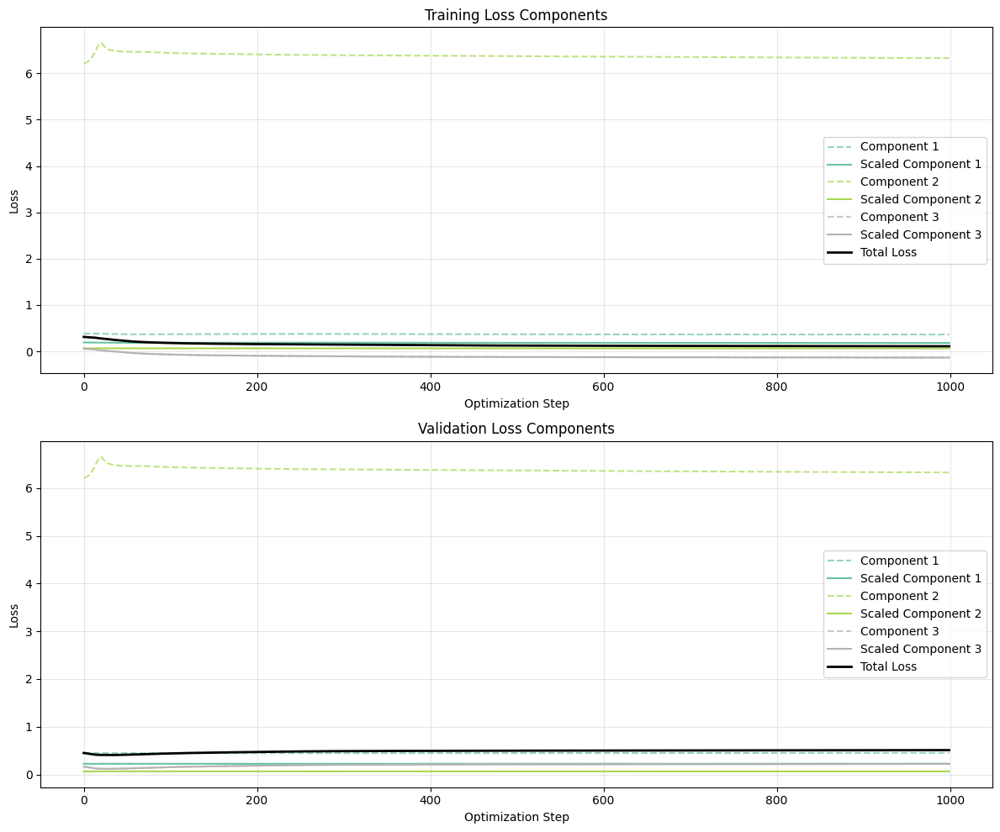

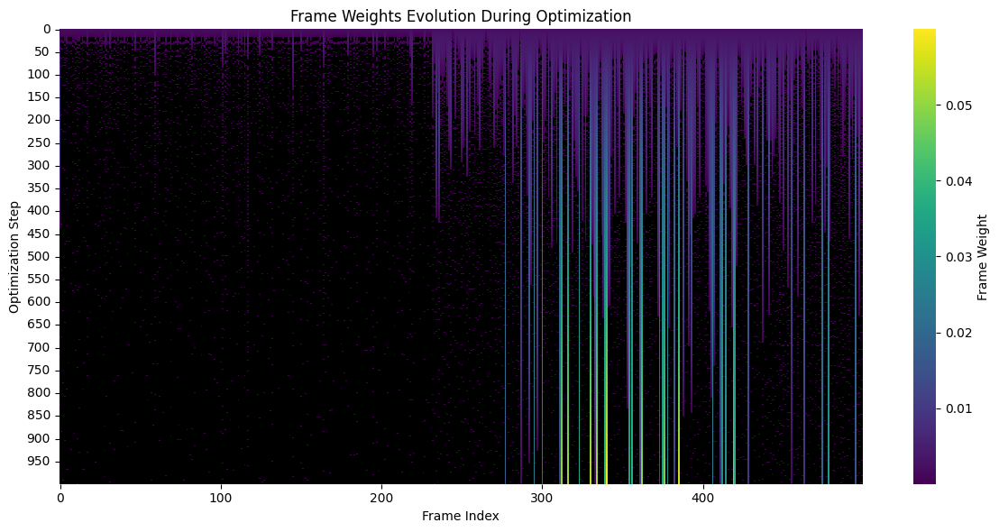

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

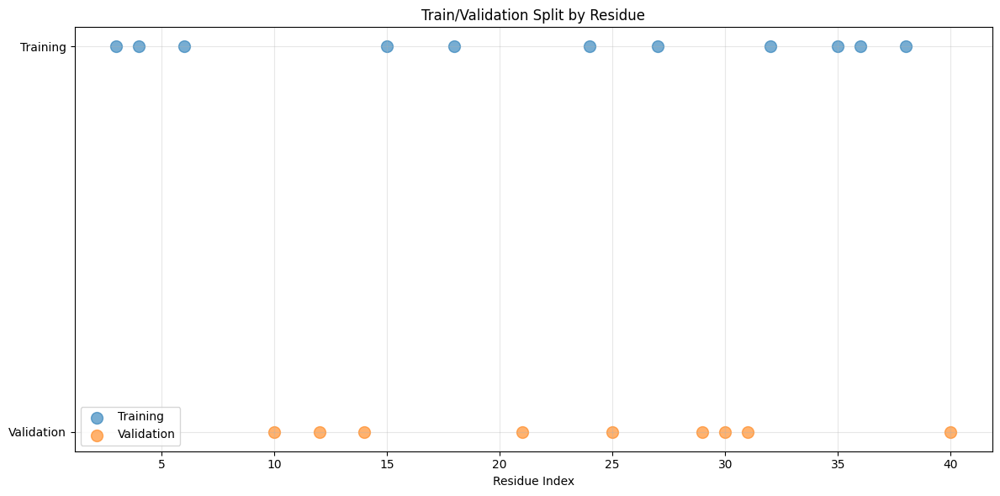

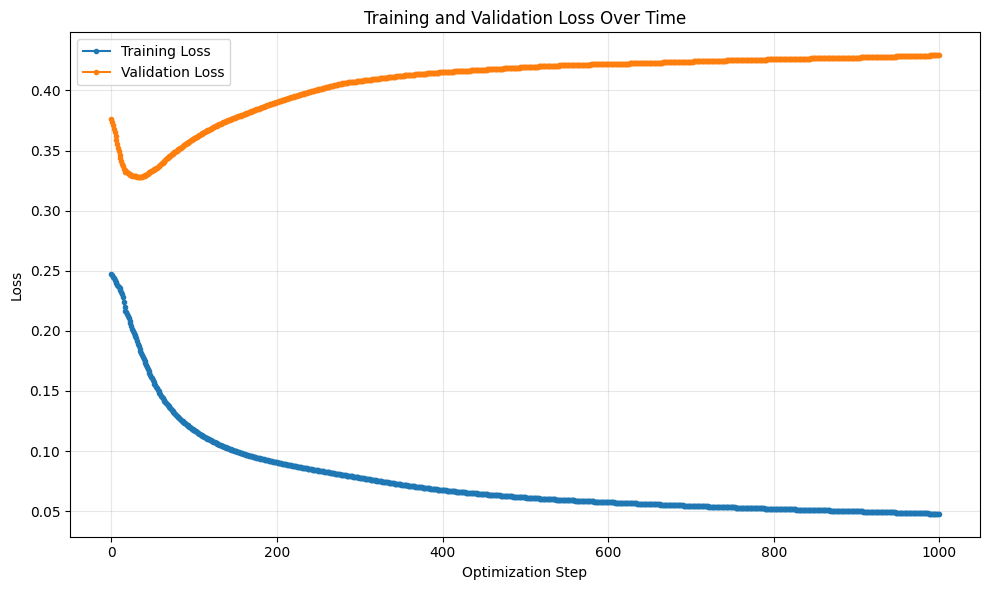

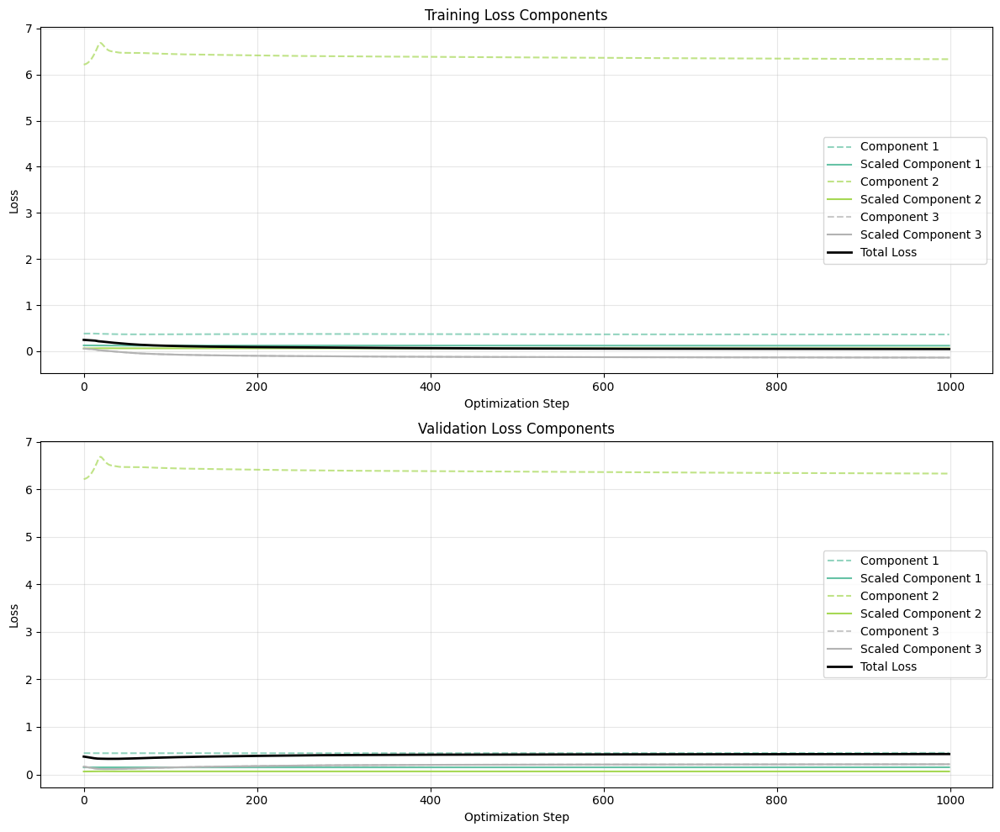

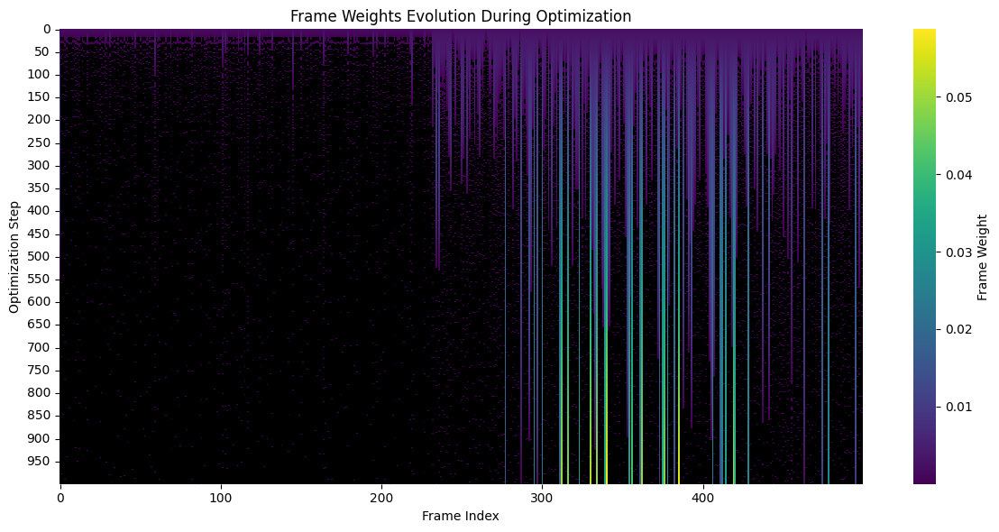

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

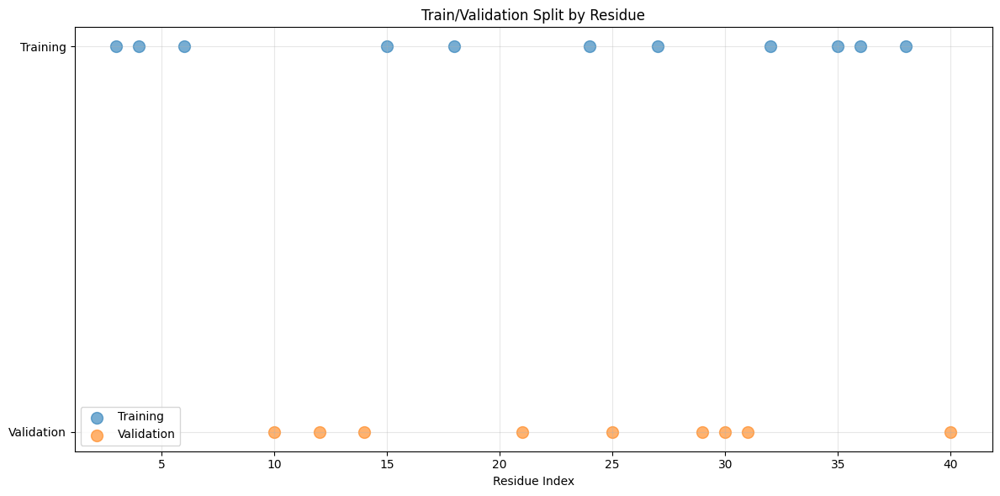

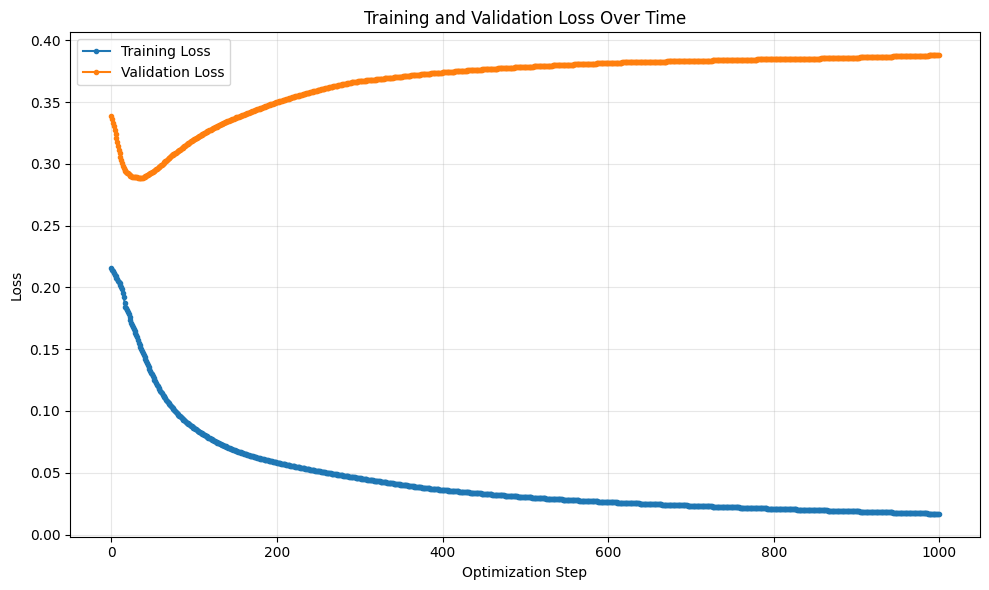

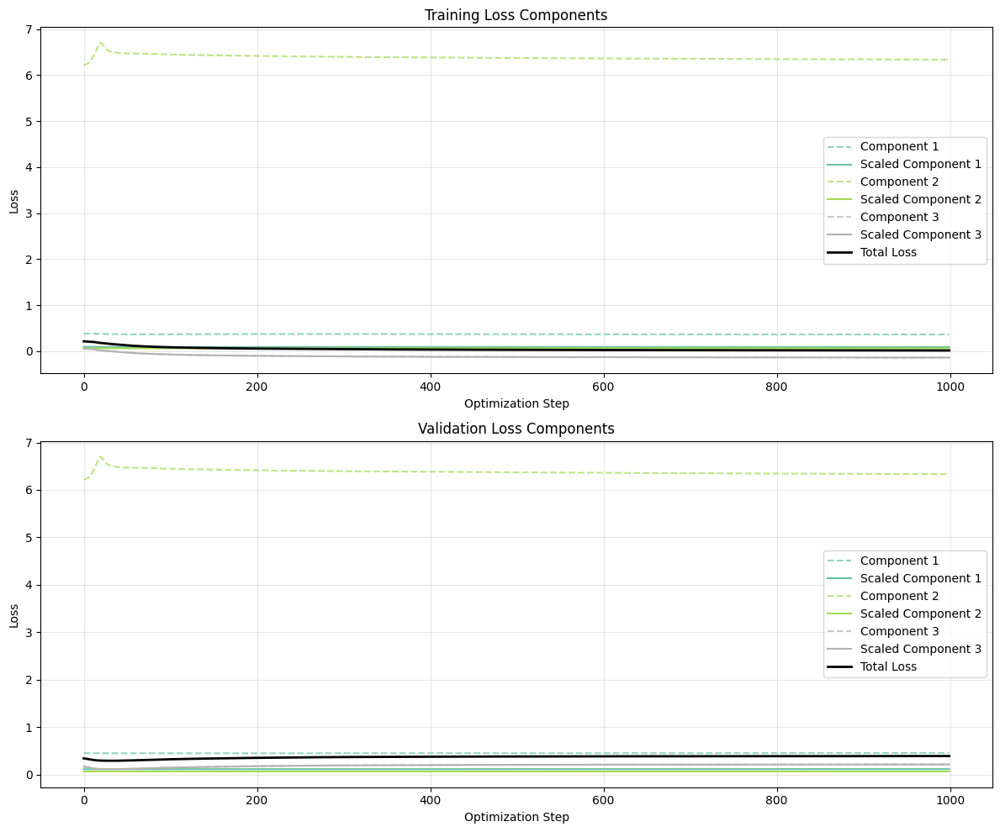

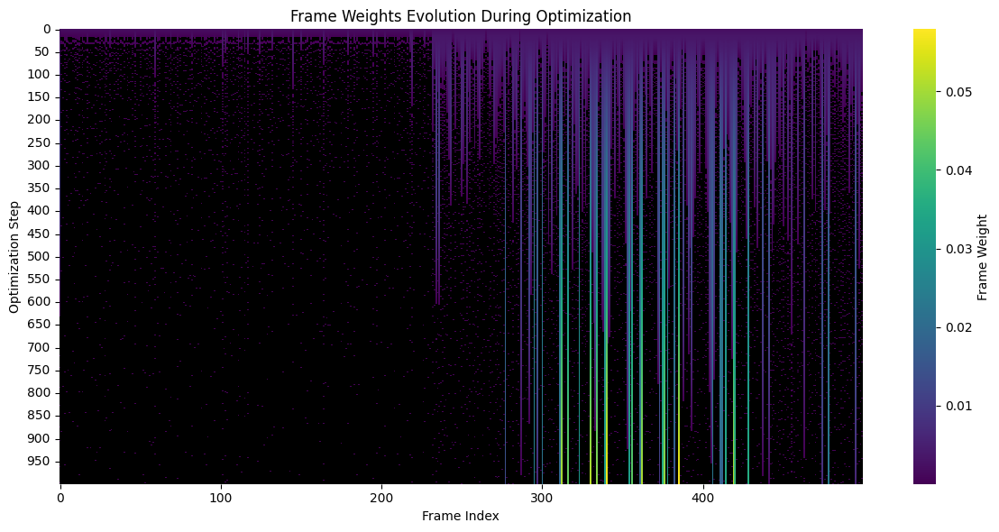

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

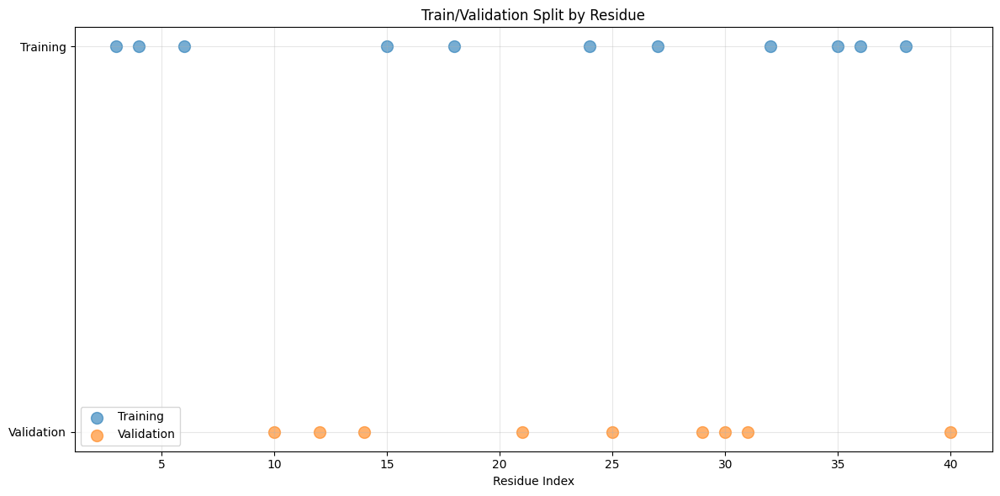

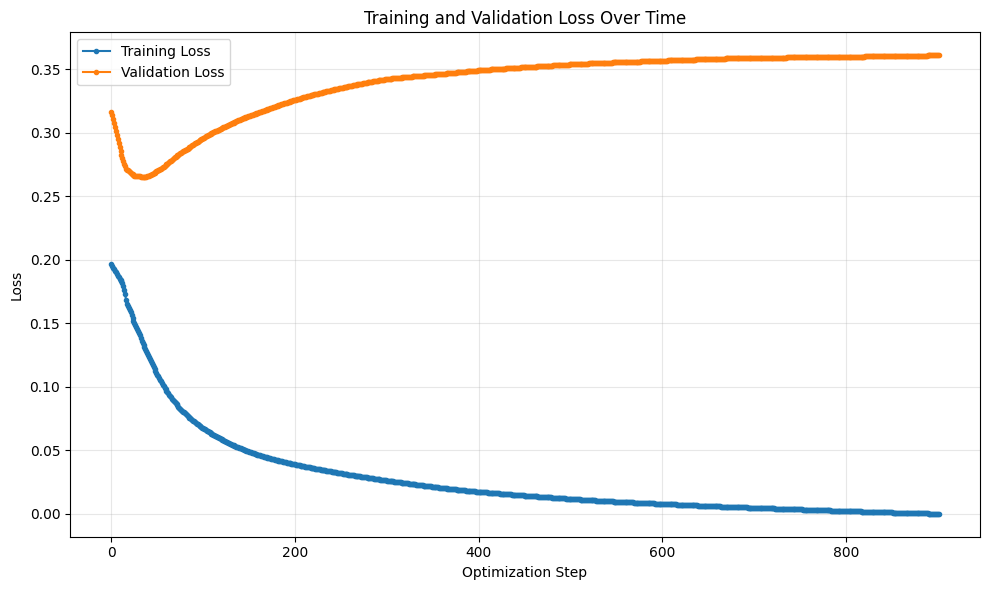

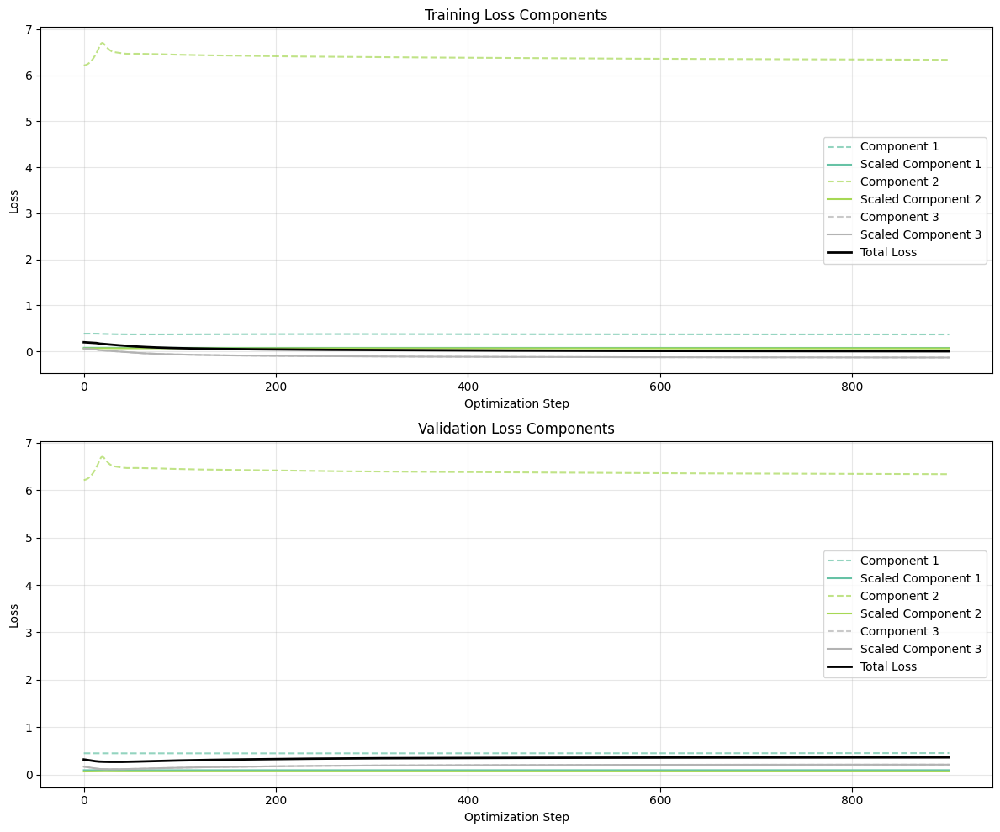

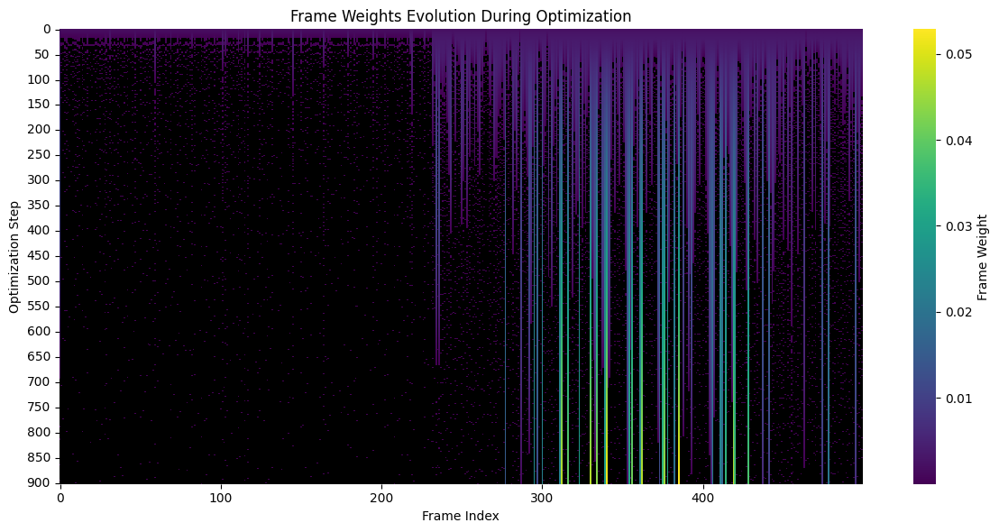

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

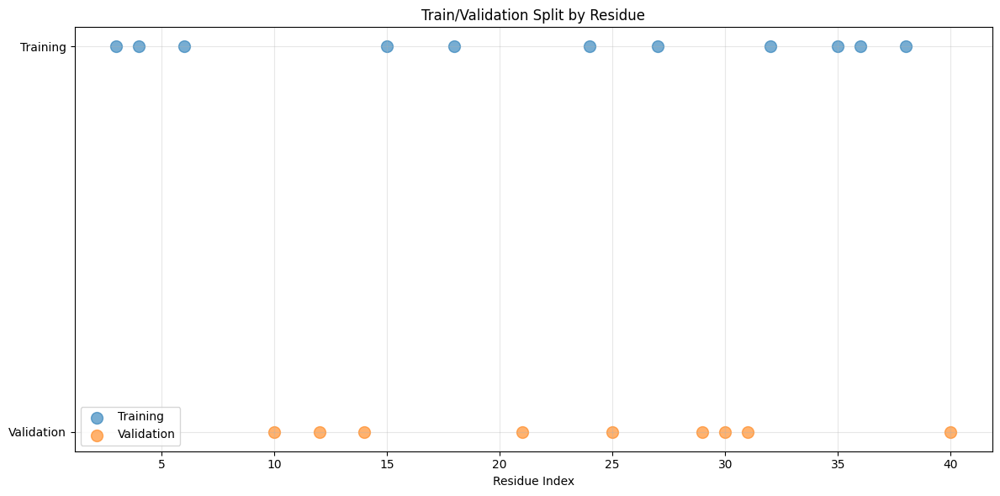

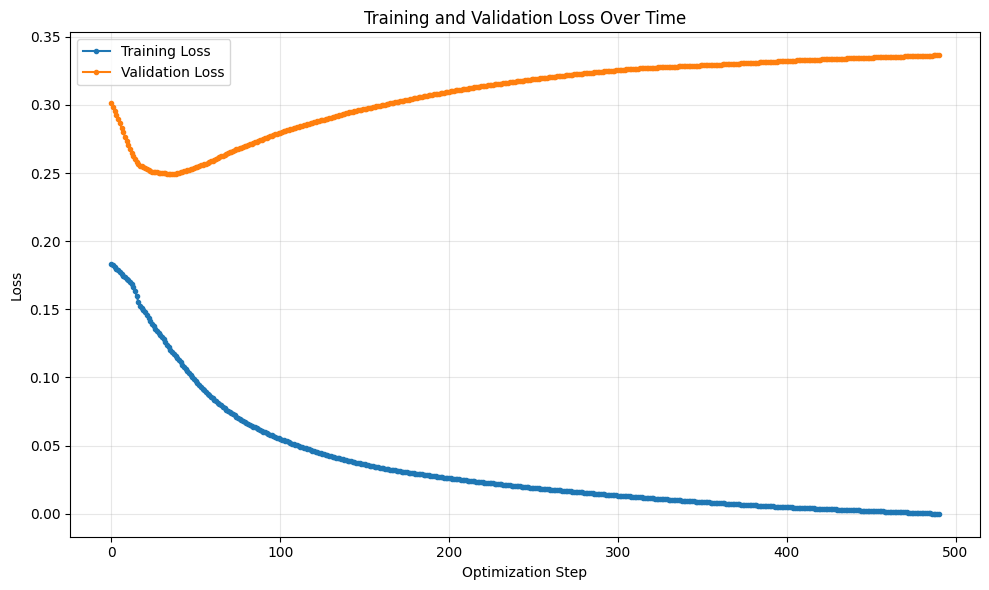

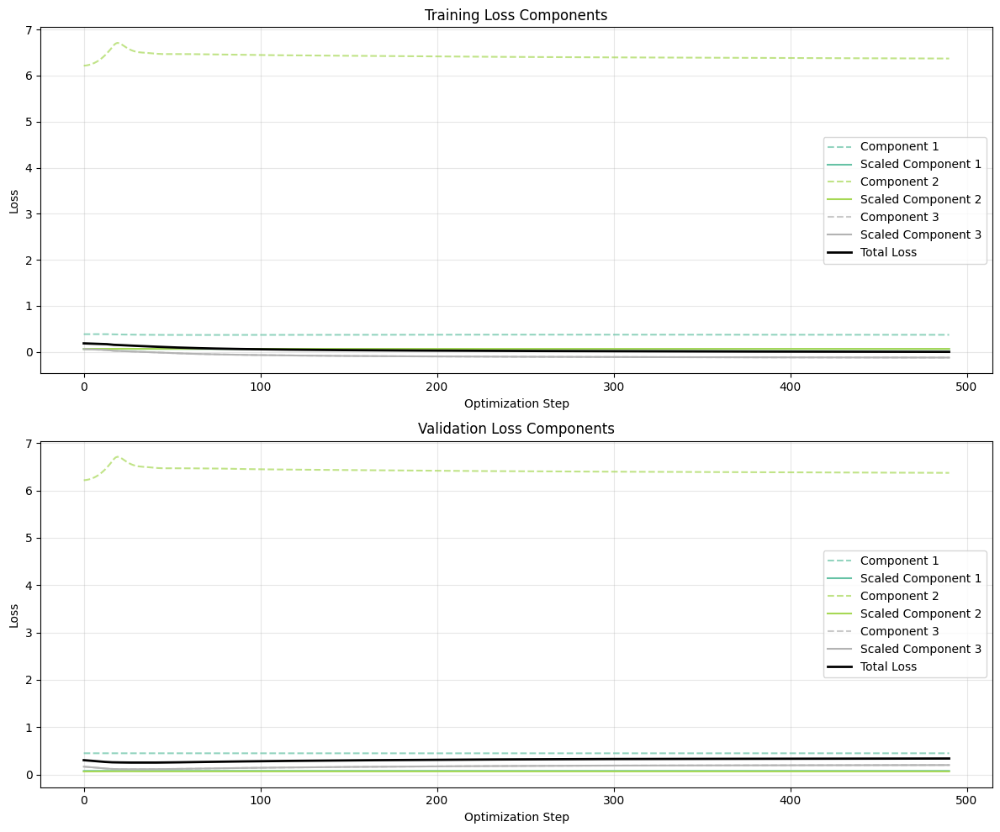

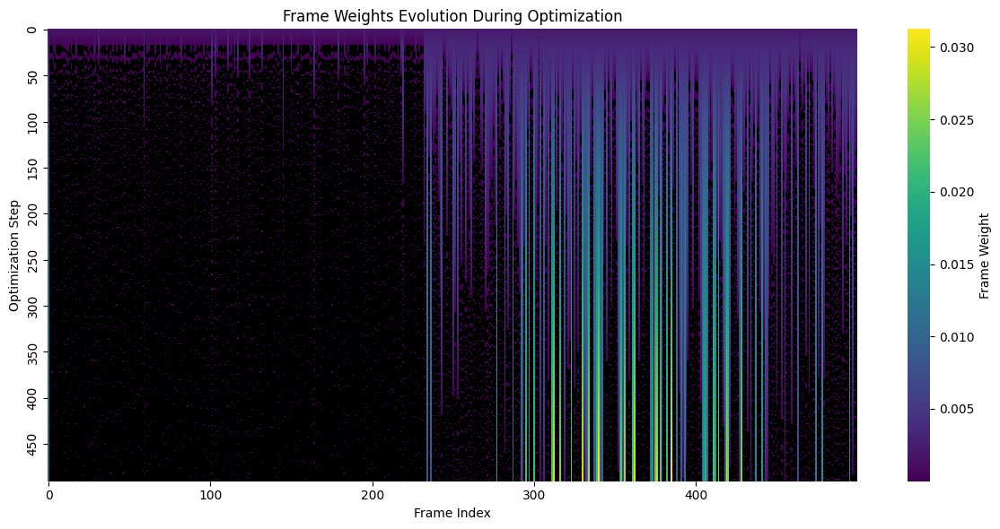

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

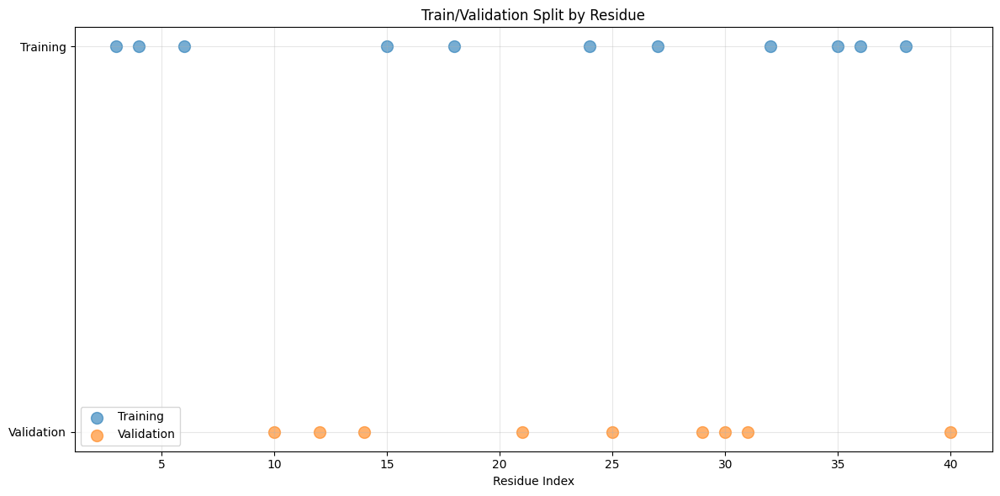

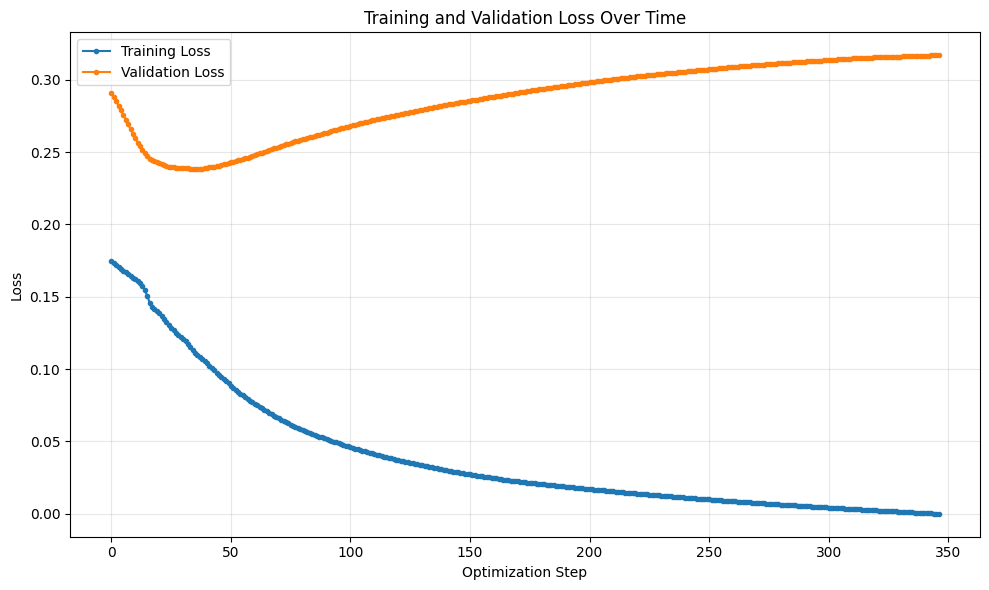

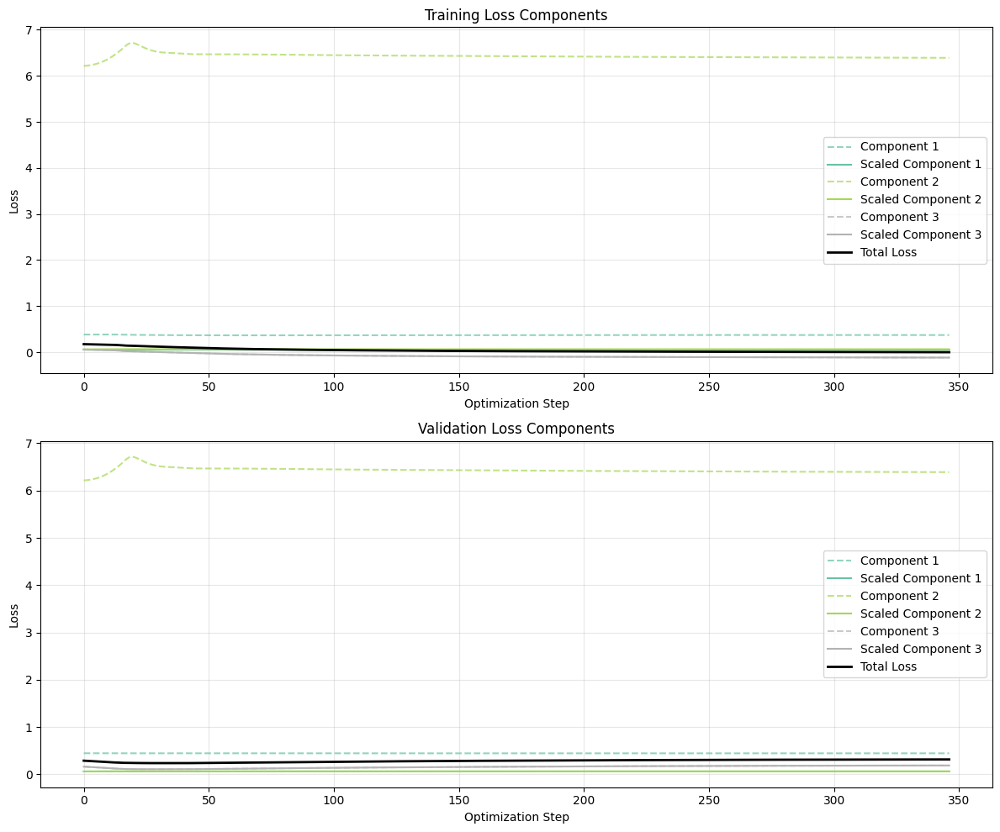

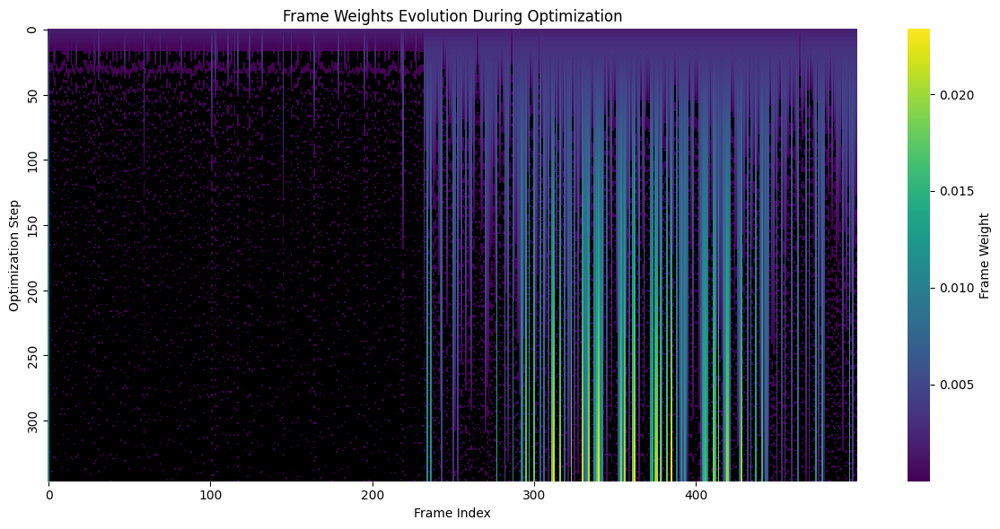

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 1/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

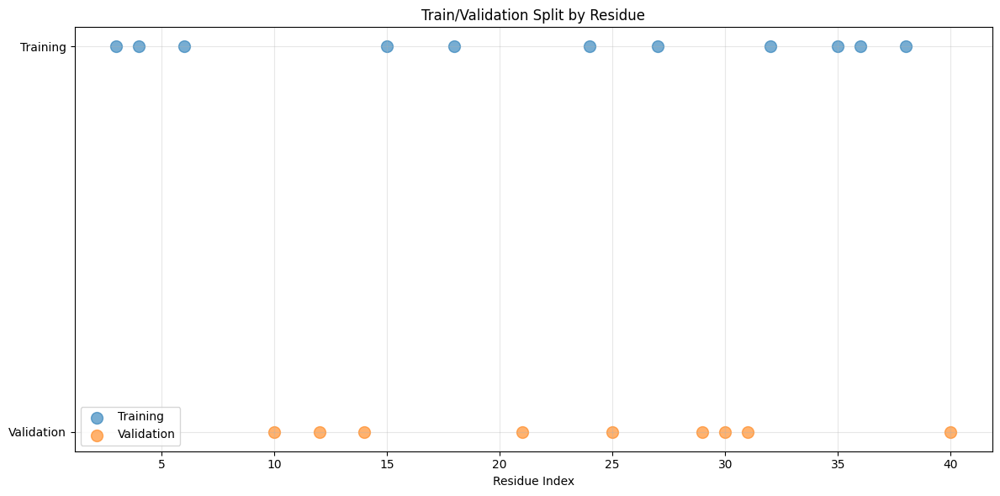

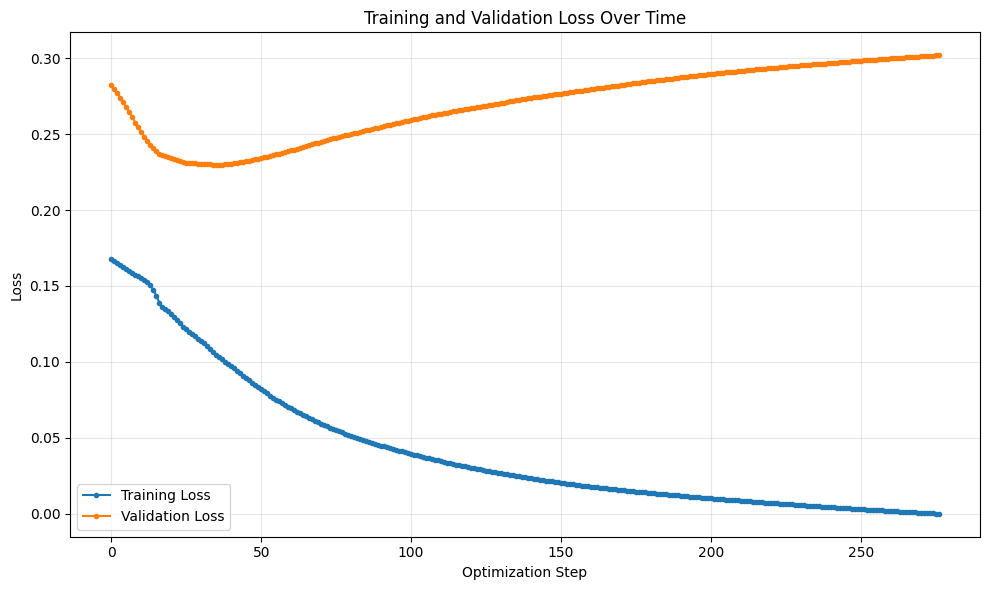

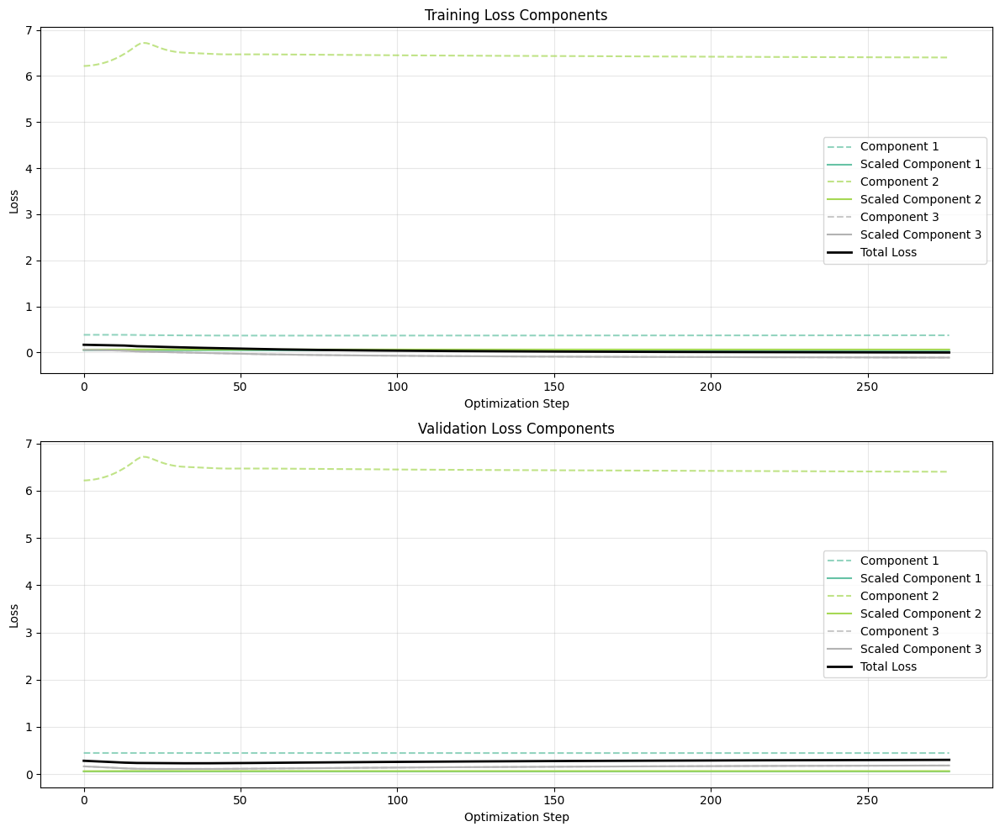

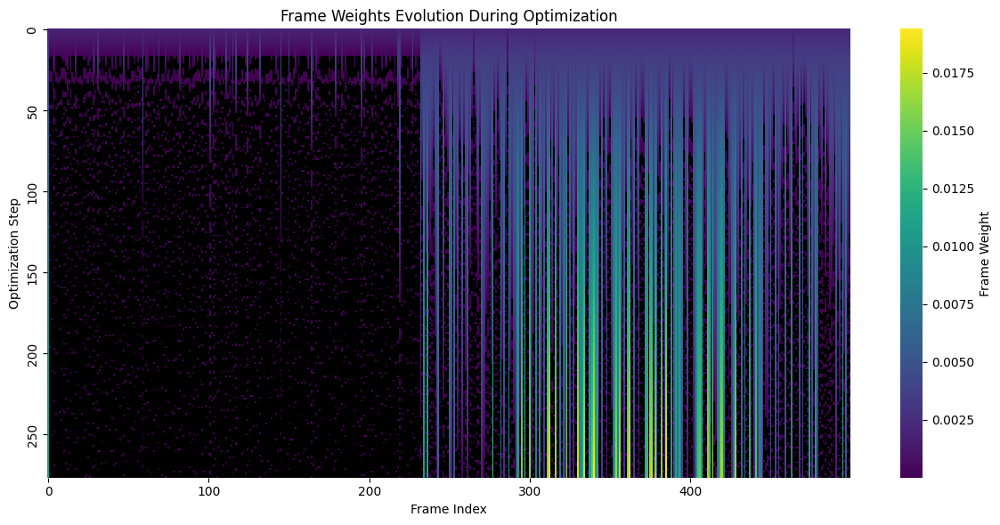

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

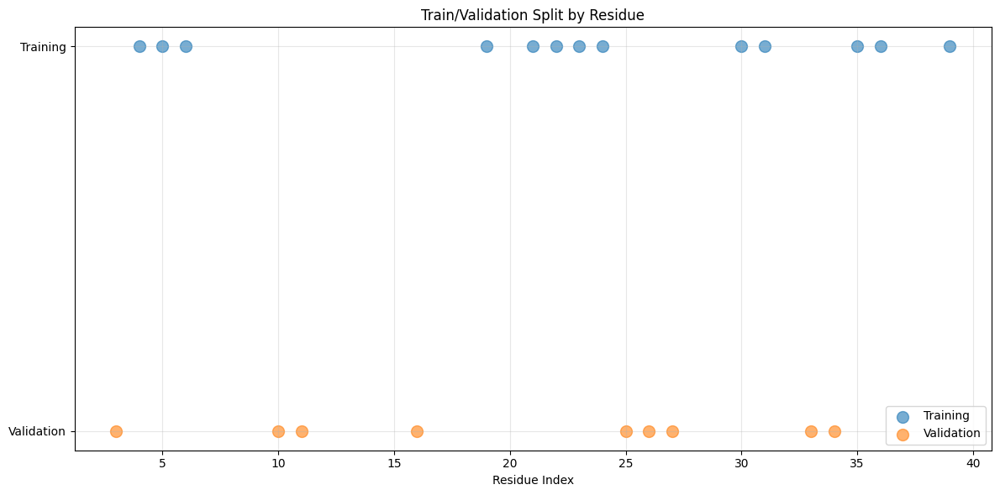

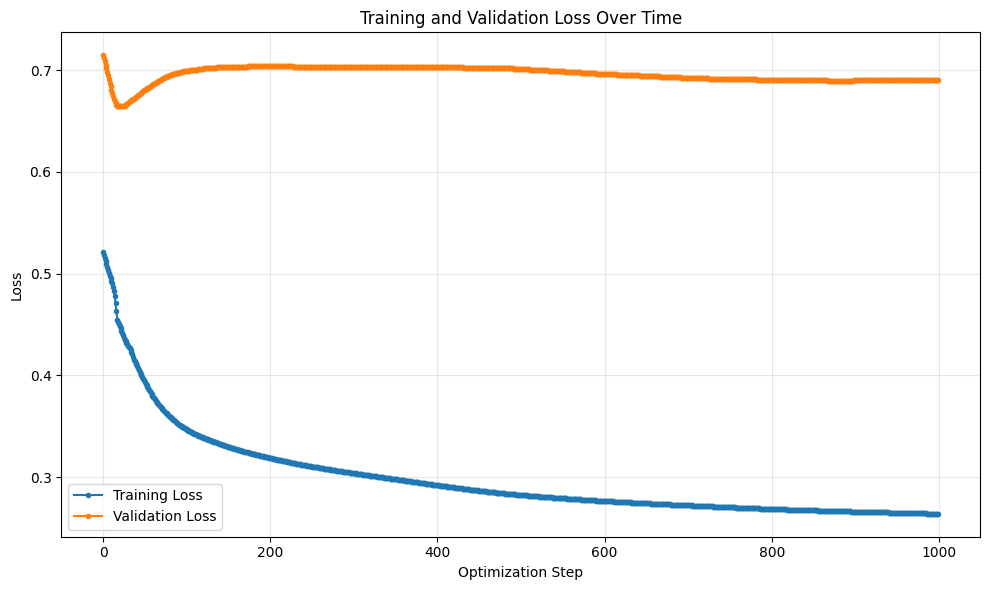

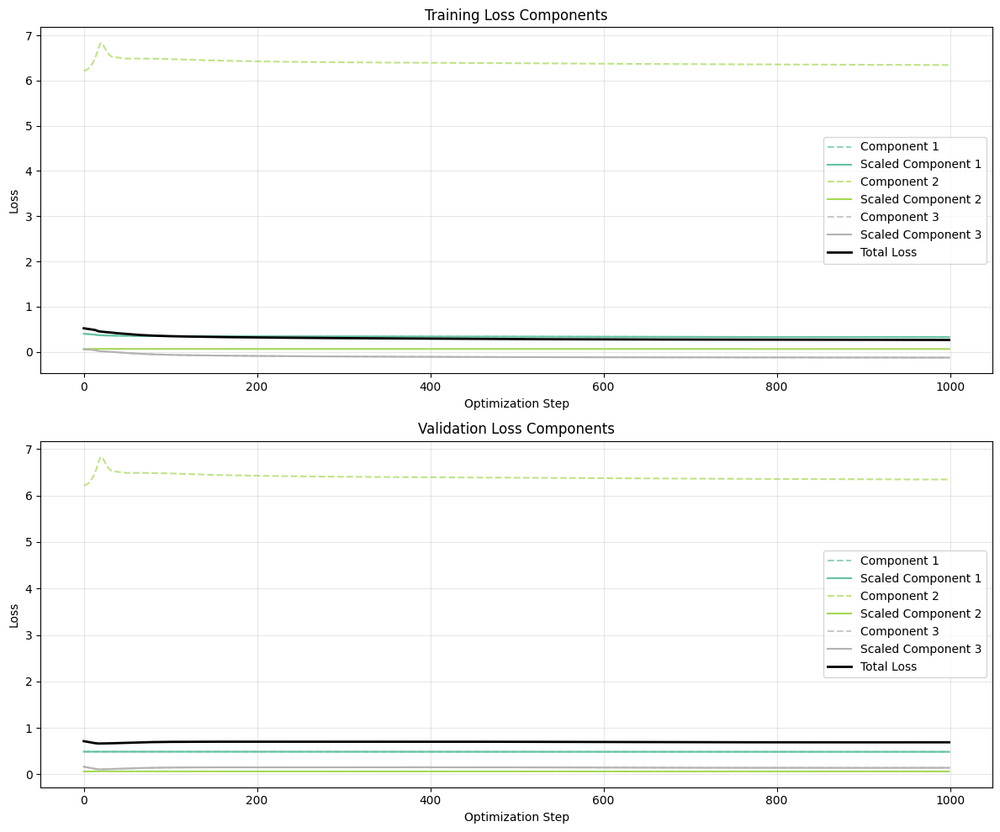

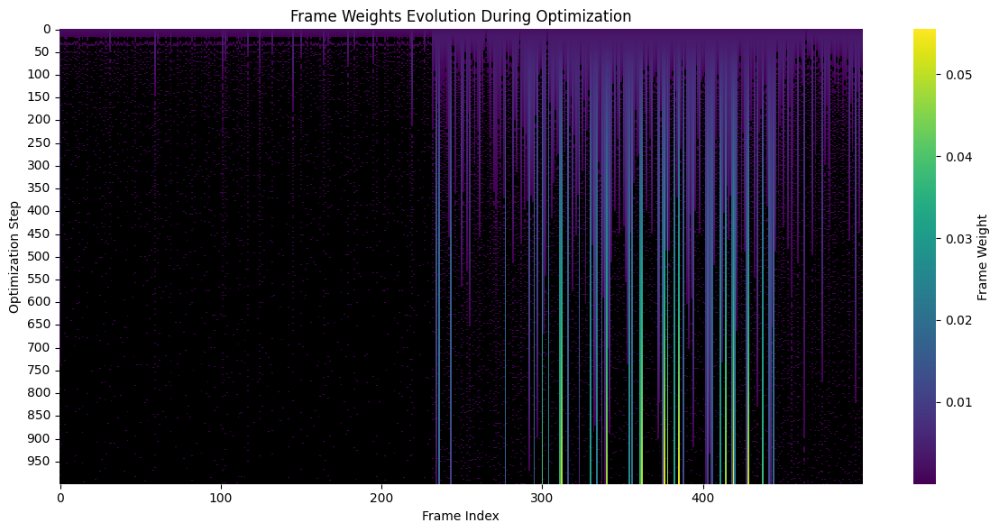

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

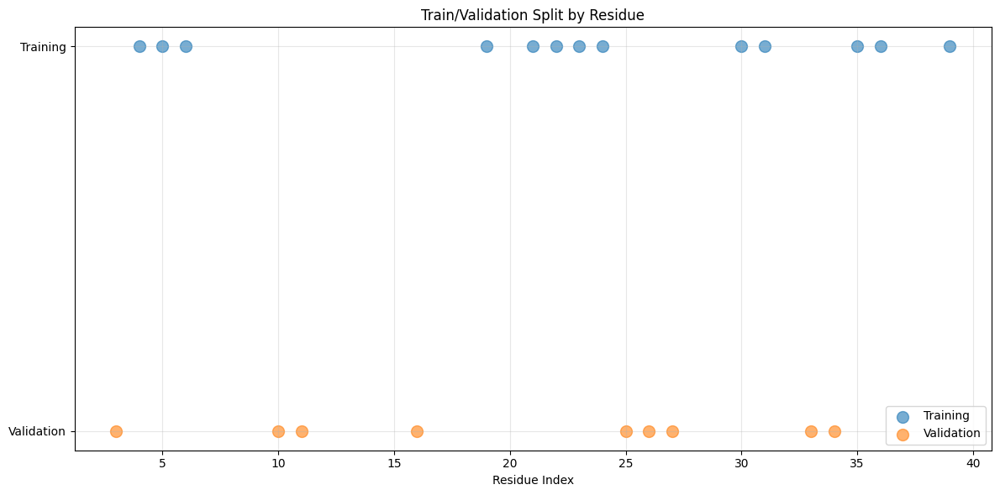

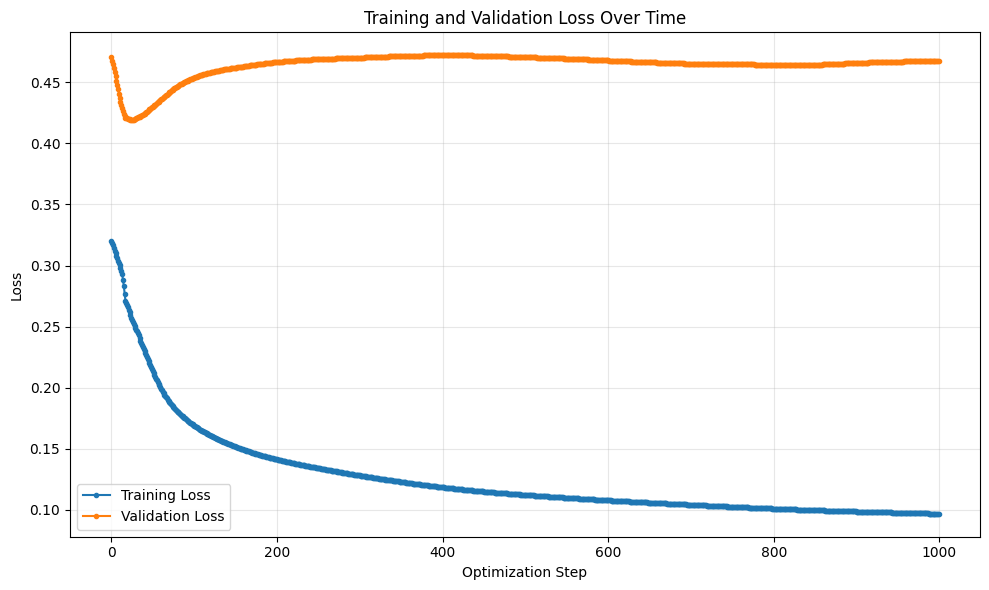

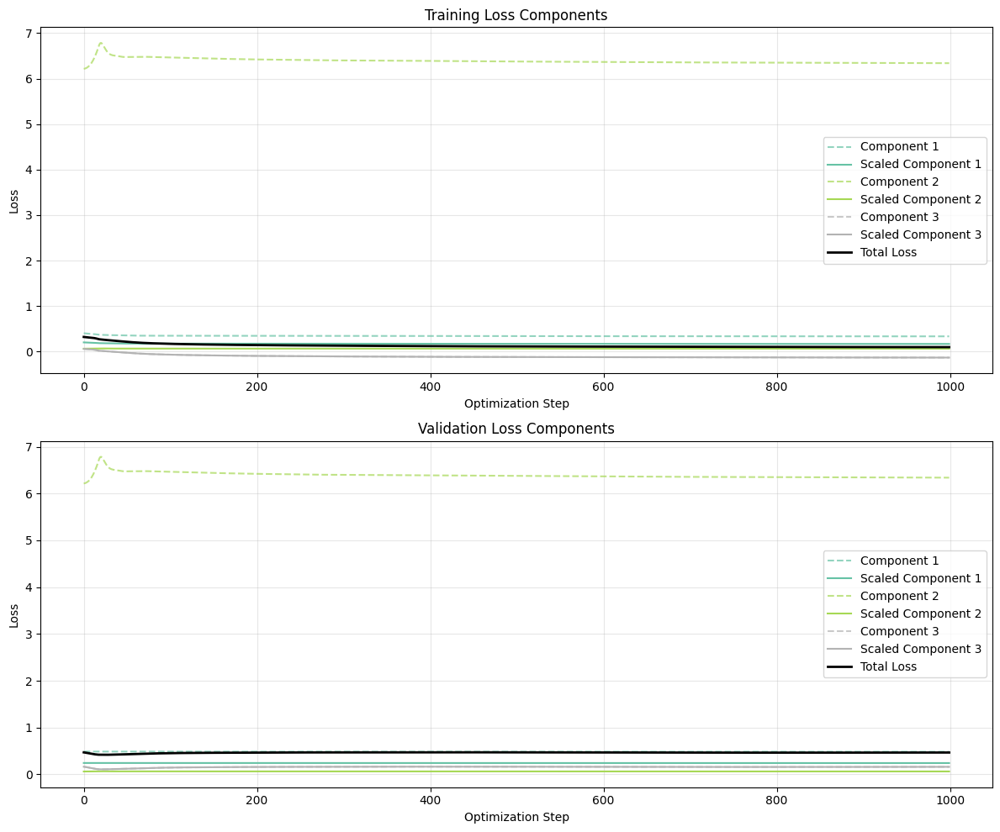

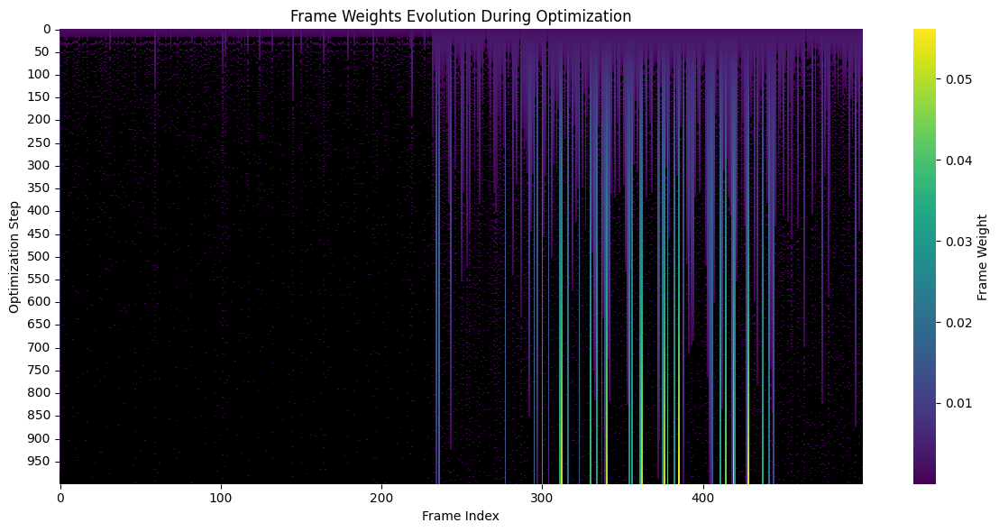

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

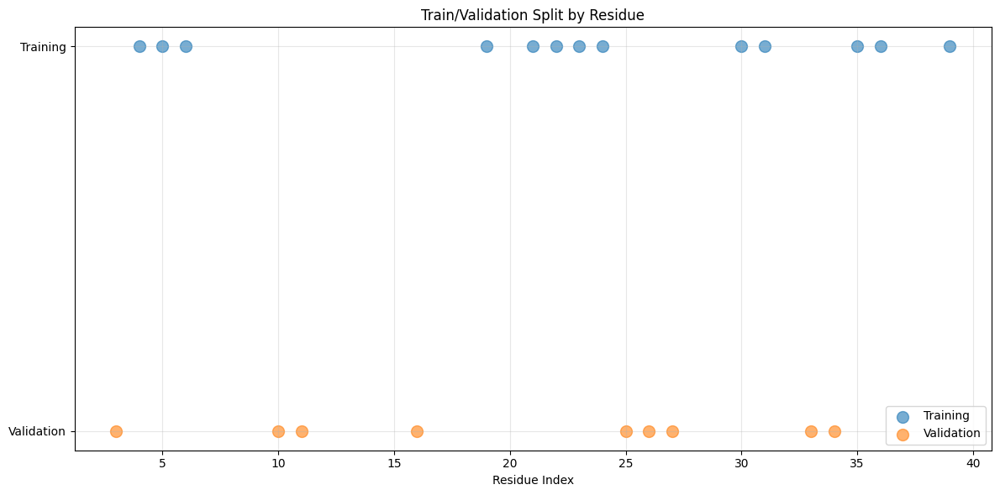

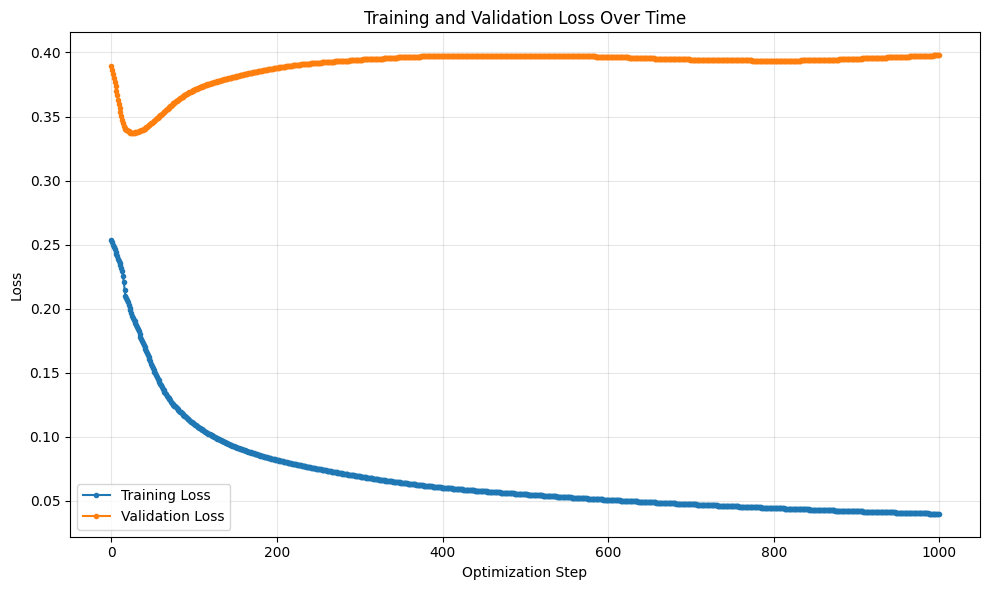

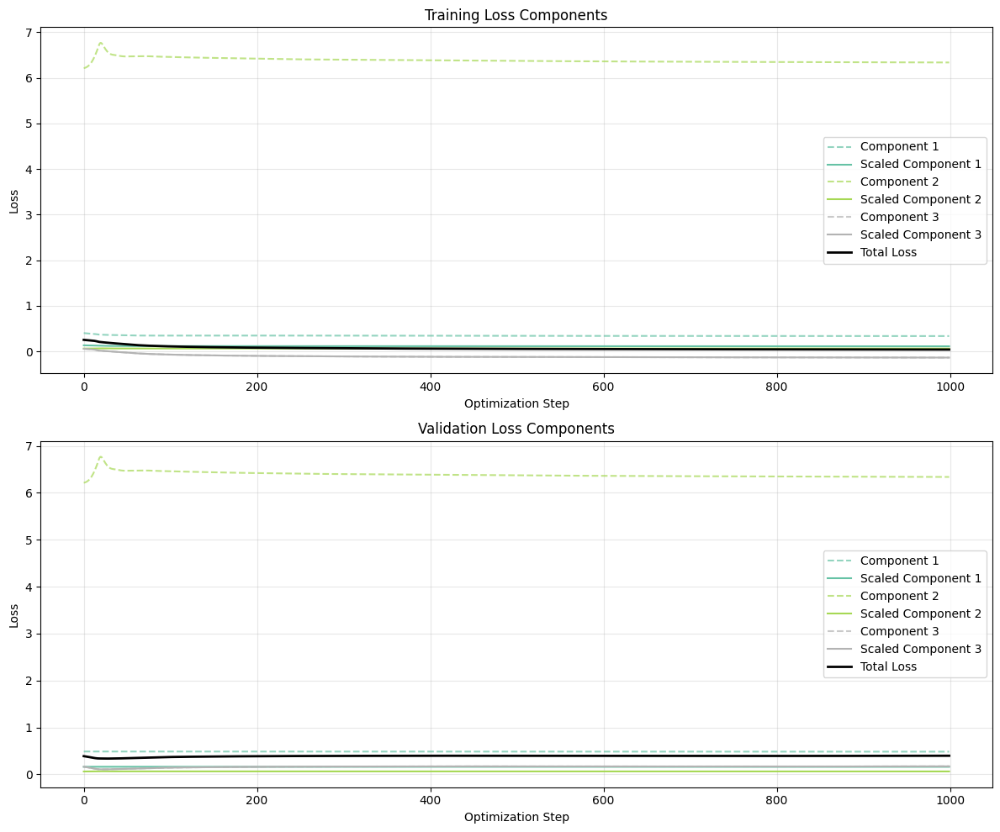

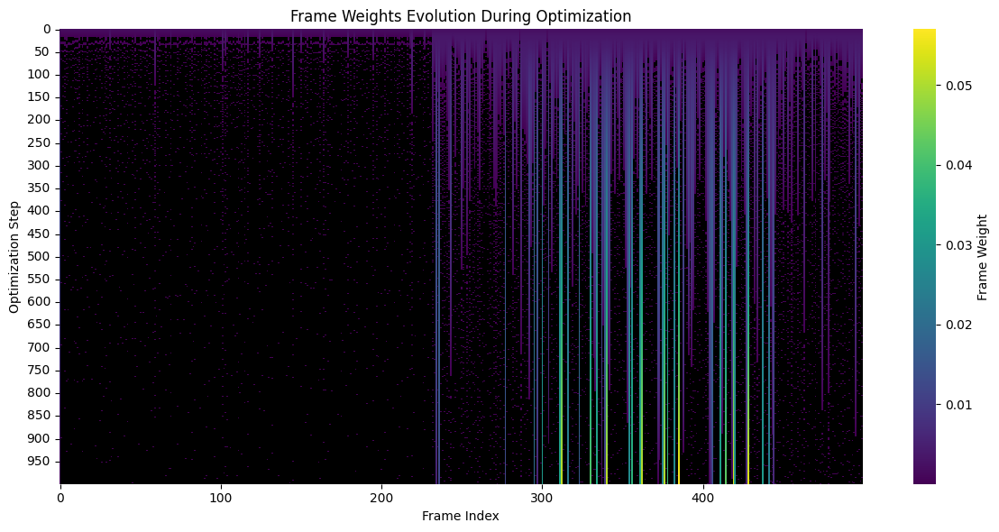

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

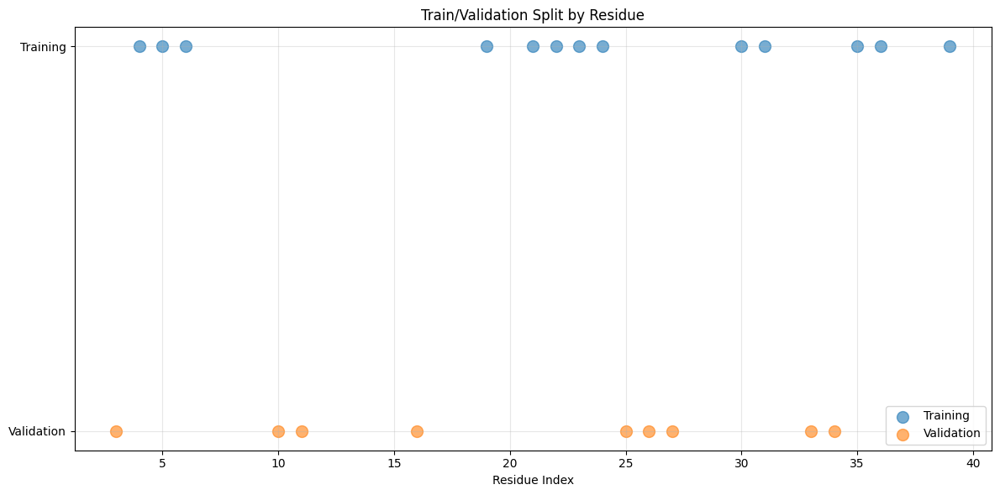

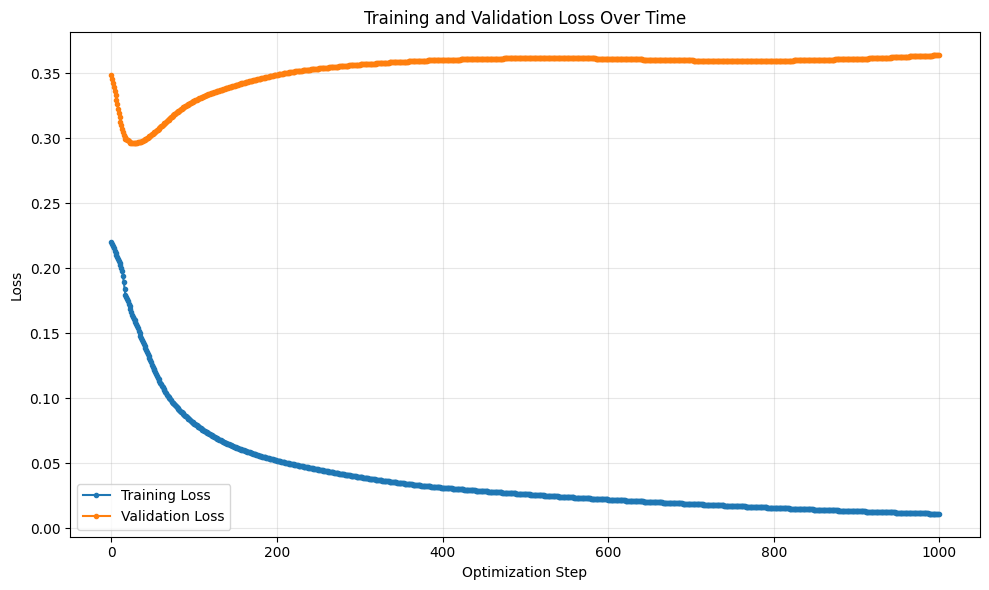

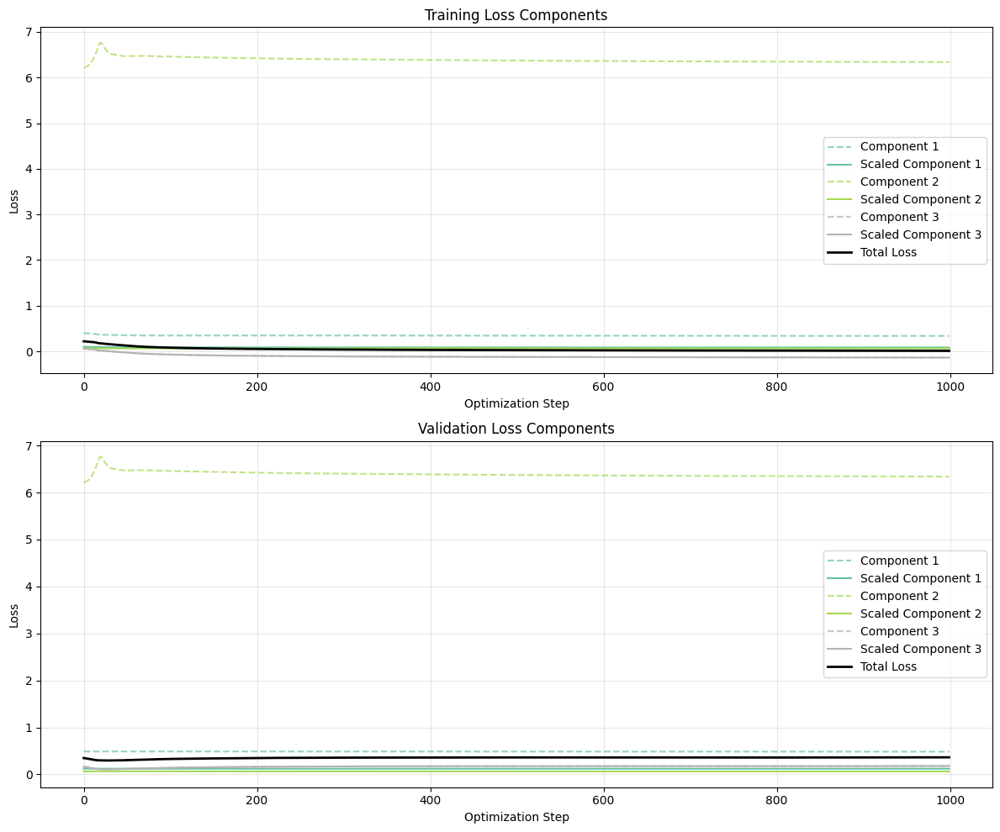

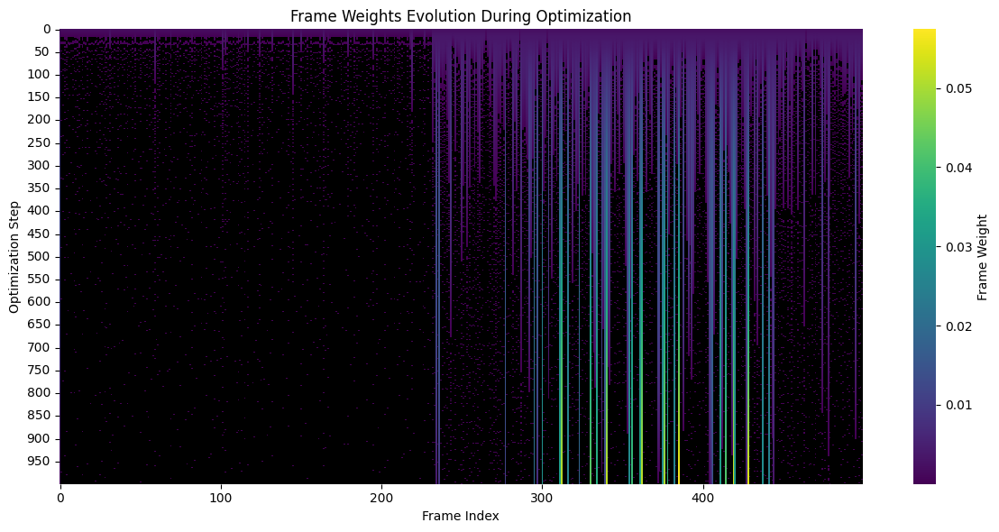

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

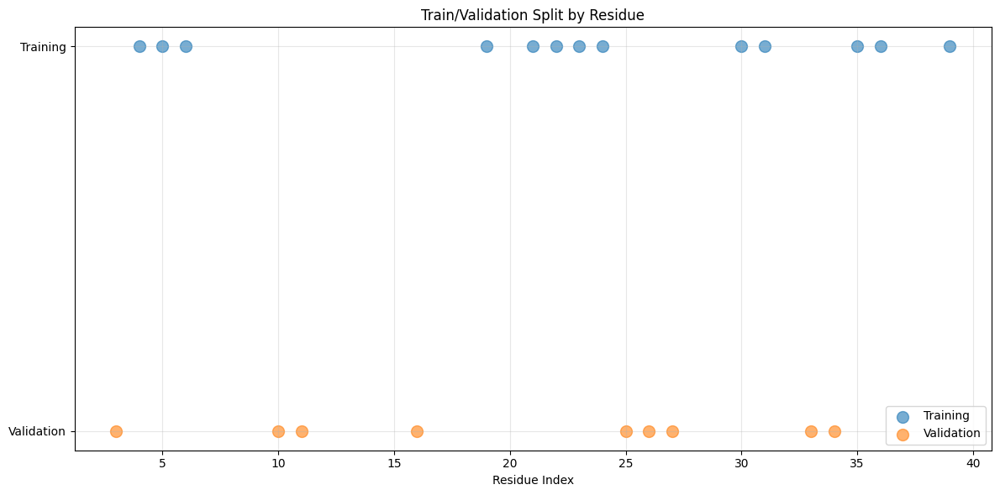

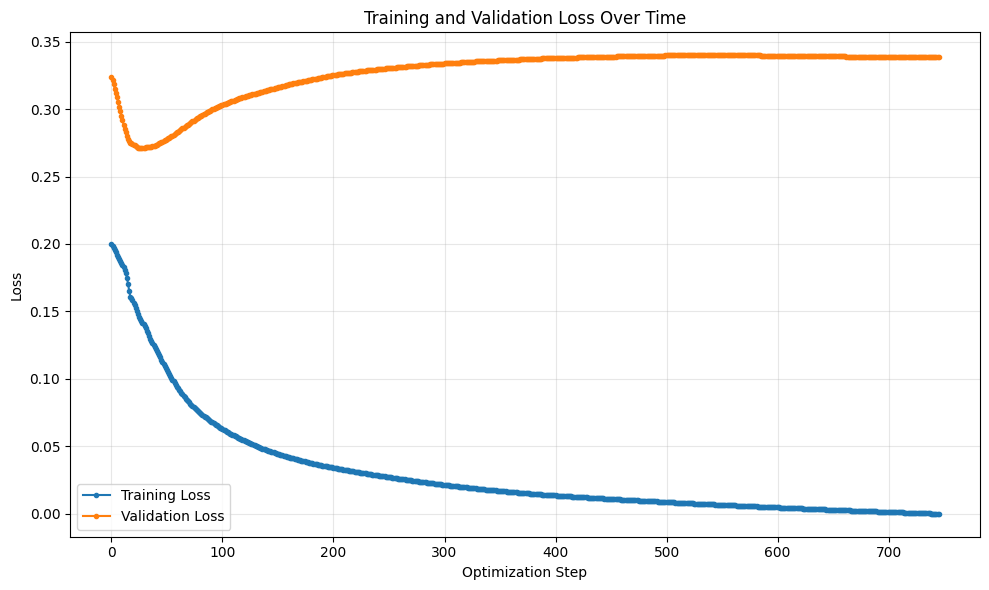

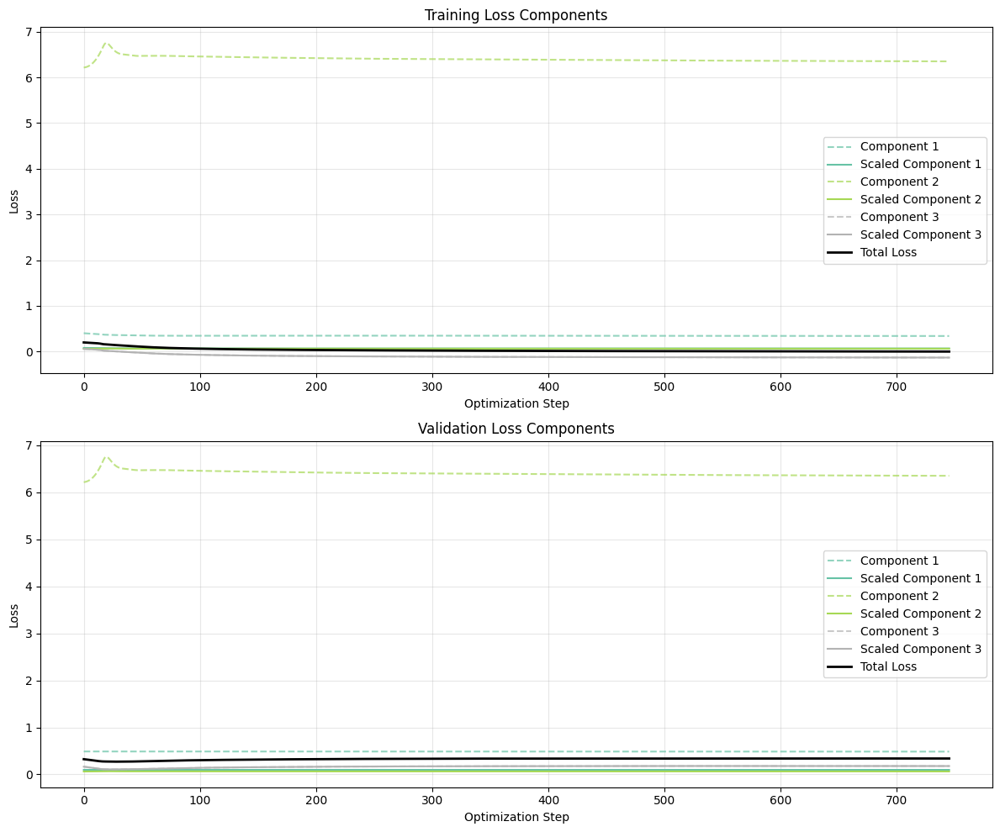

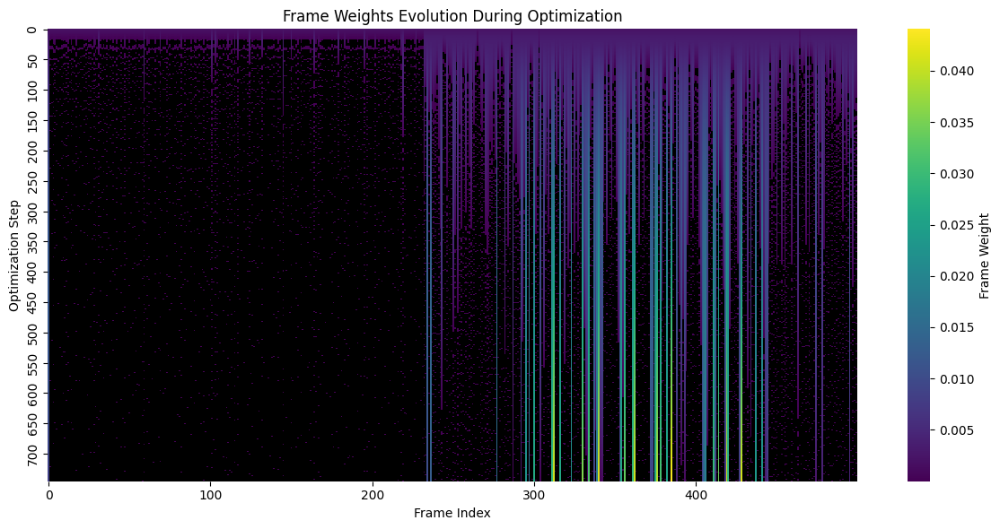

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

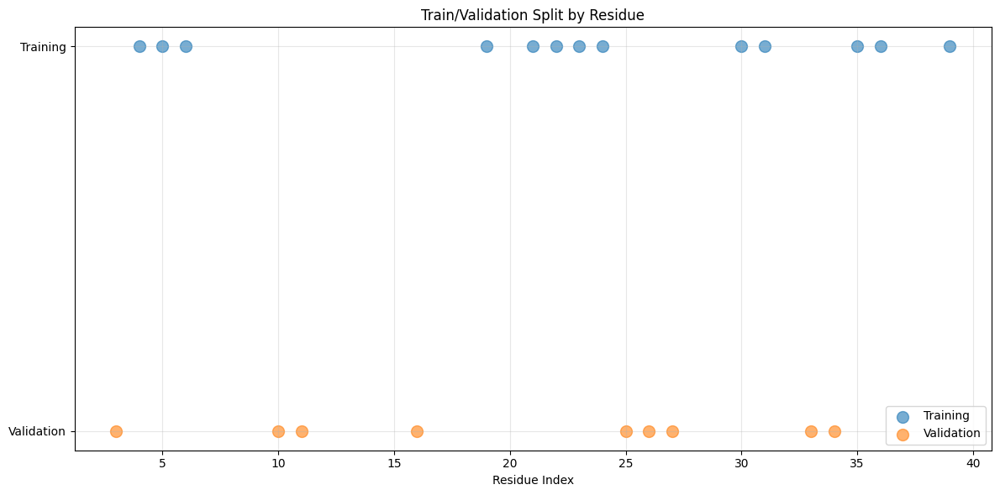

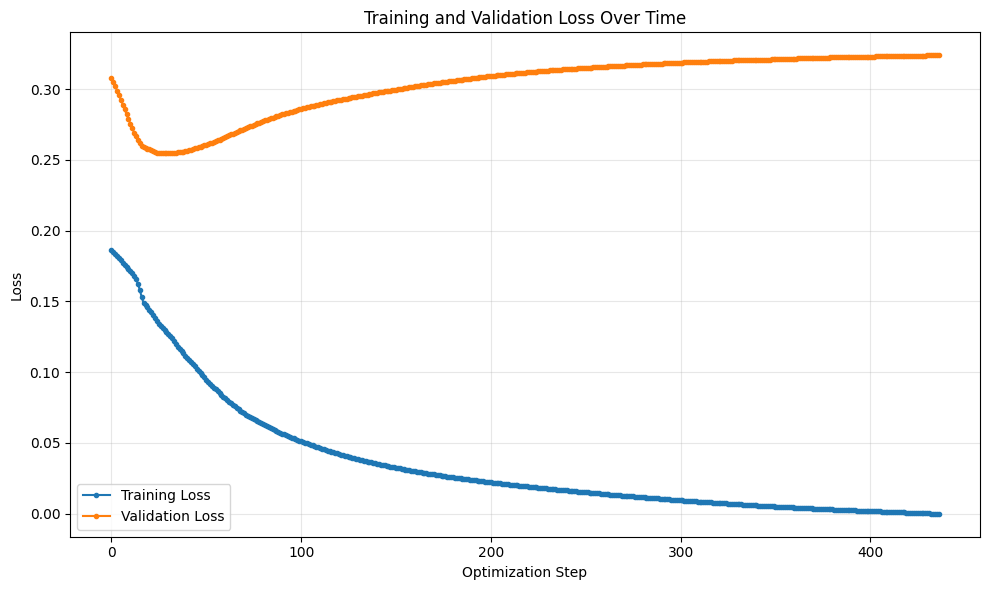

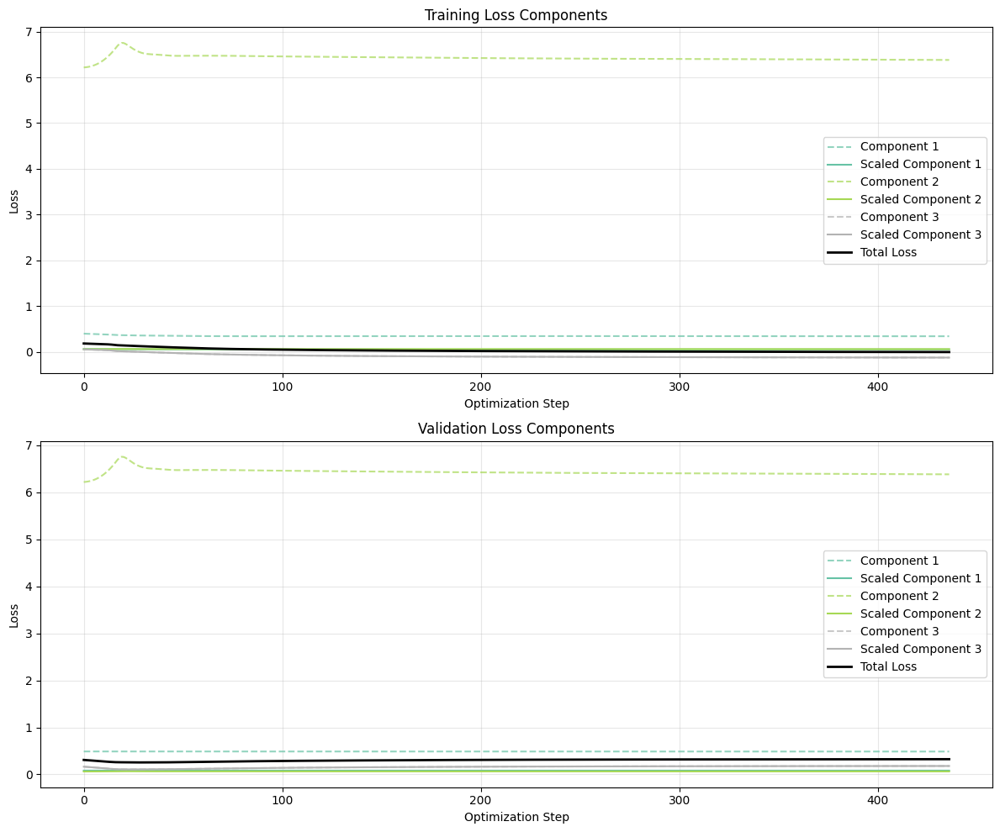

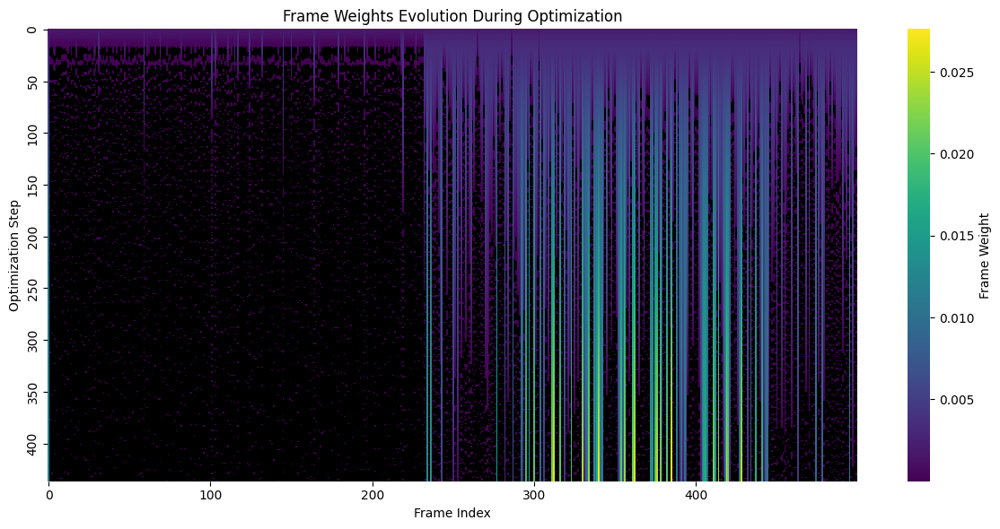

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

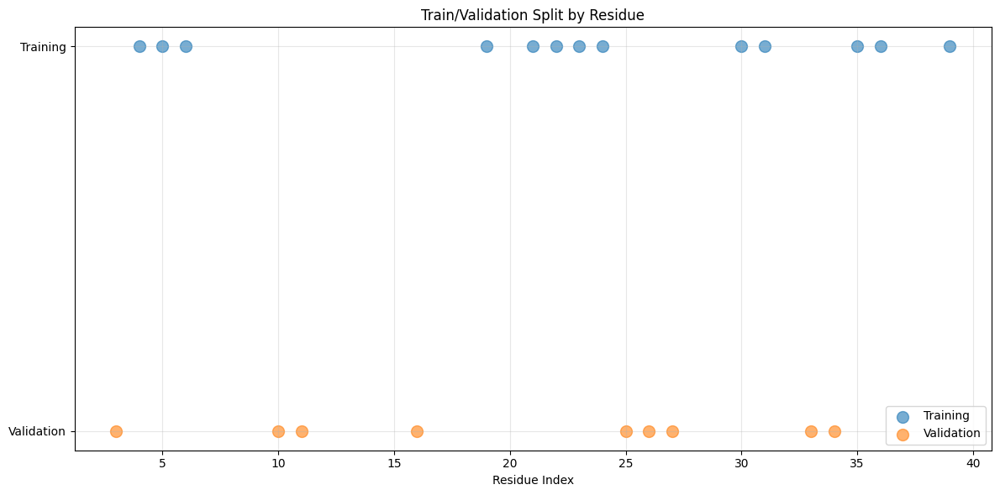

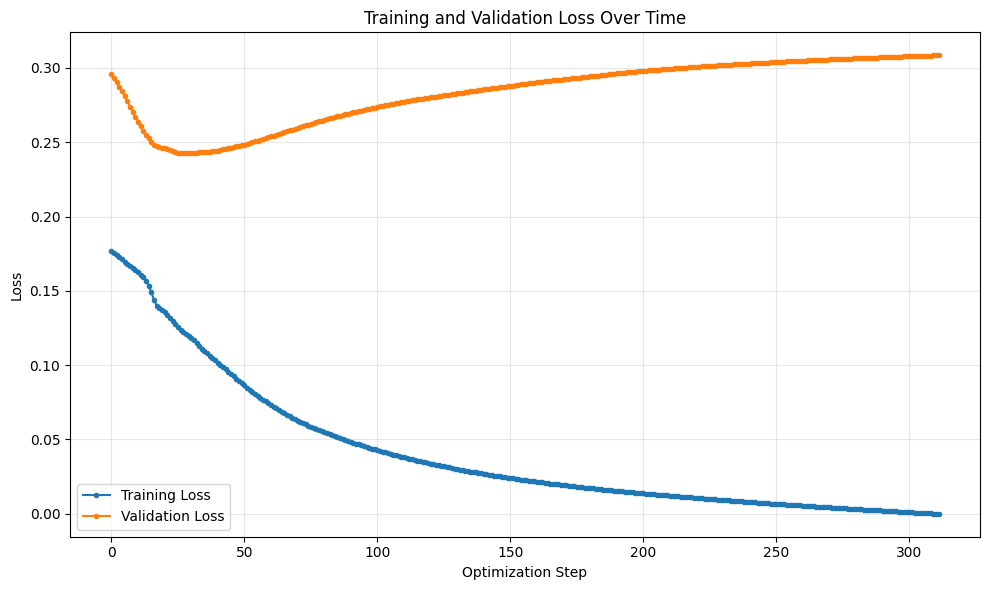

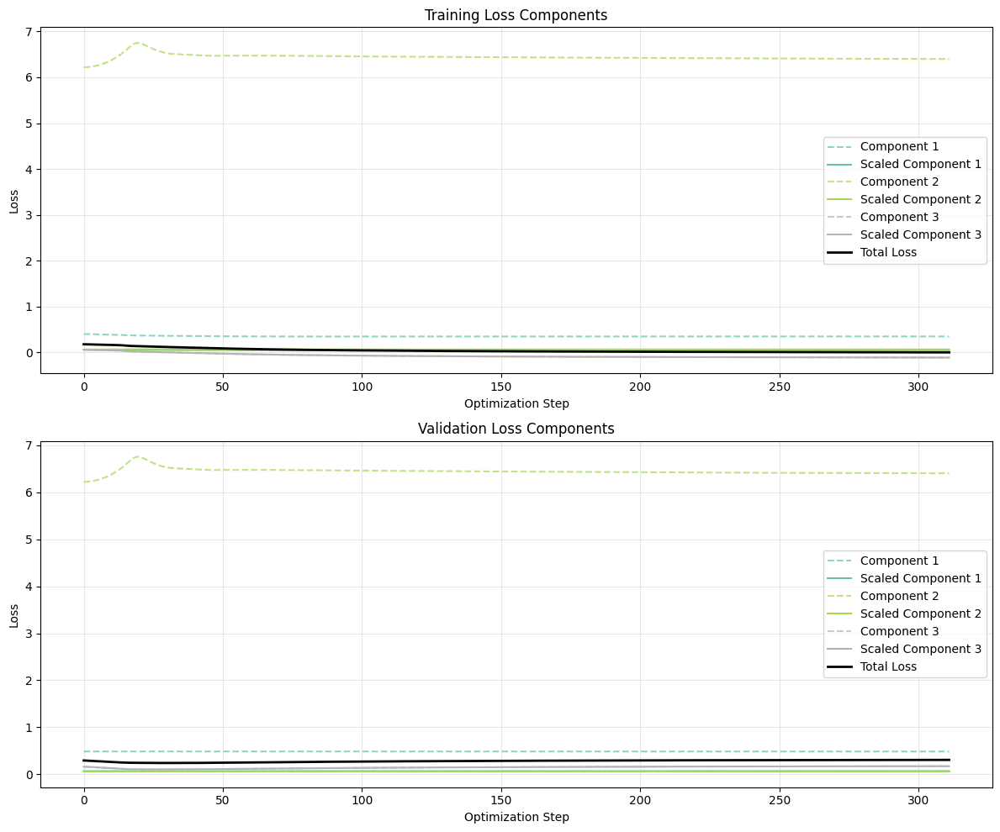

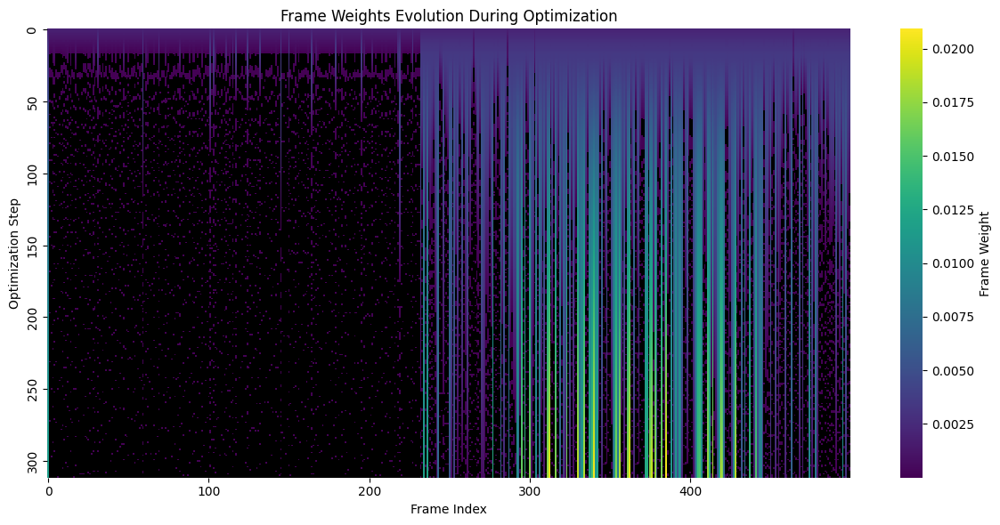

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 2/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

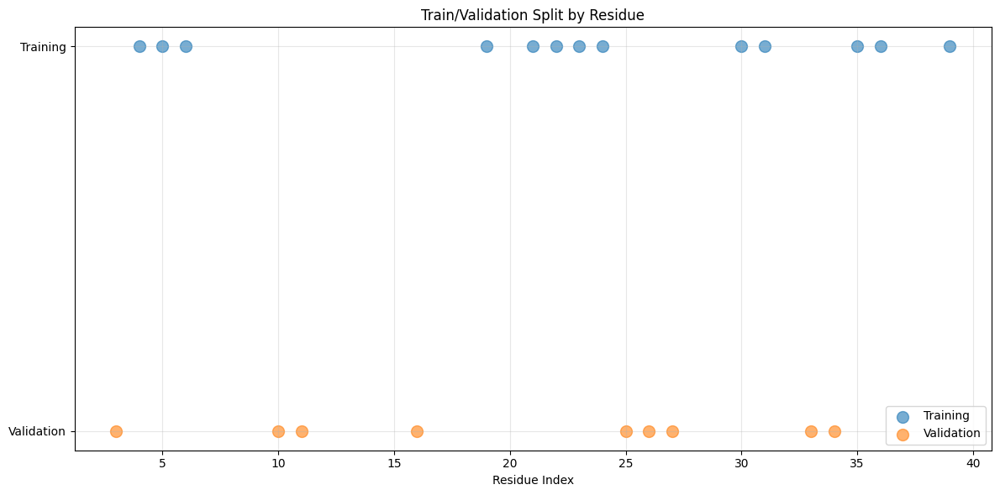

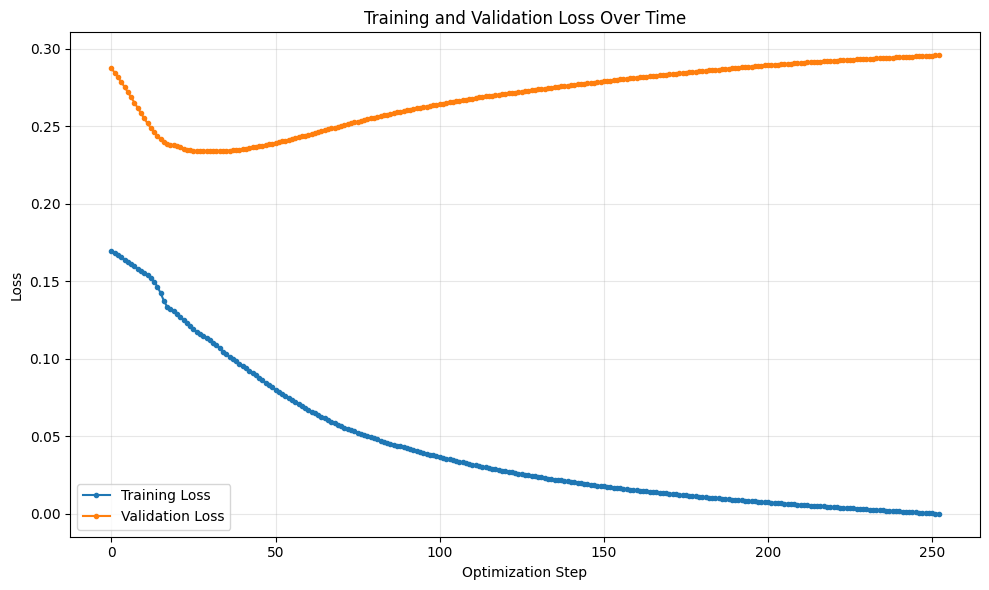

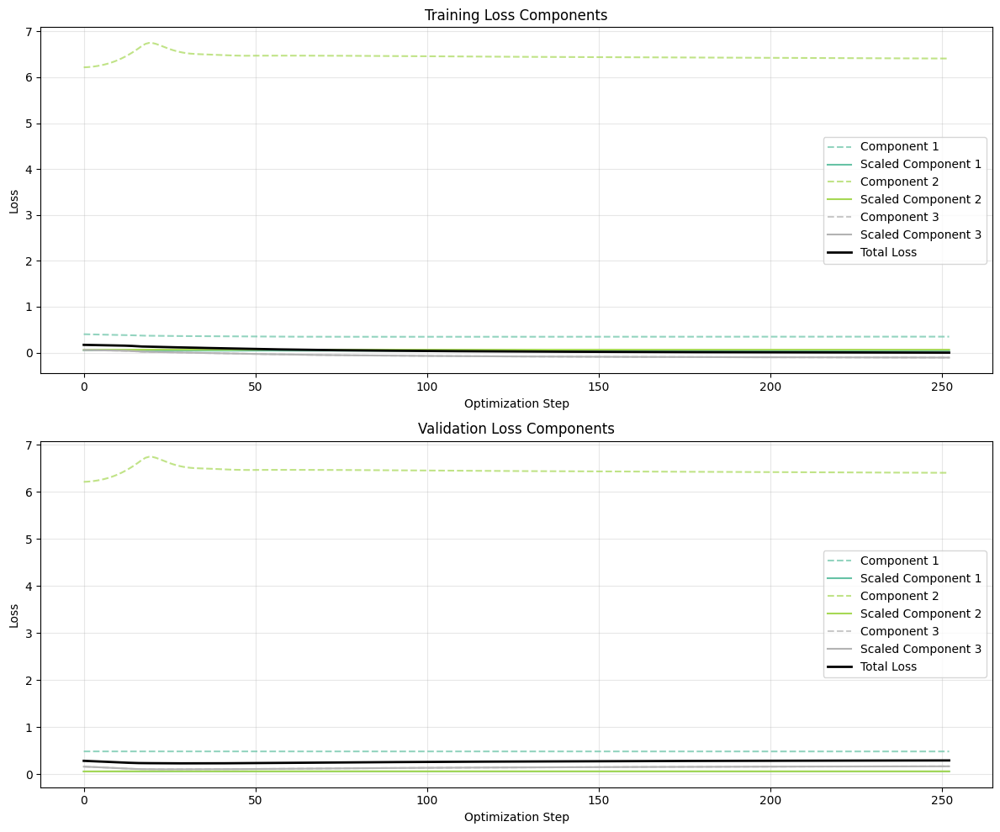

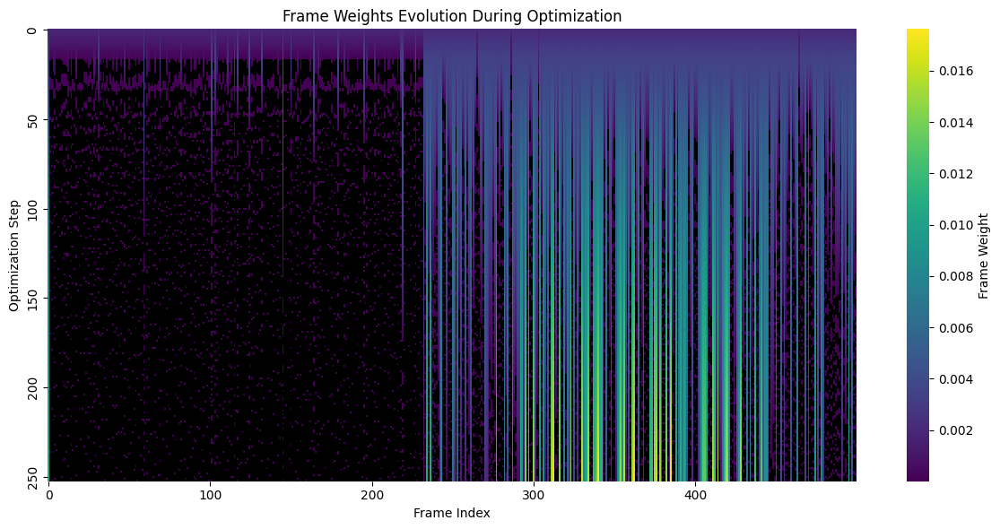

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 1/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

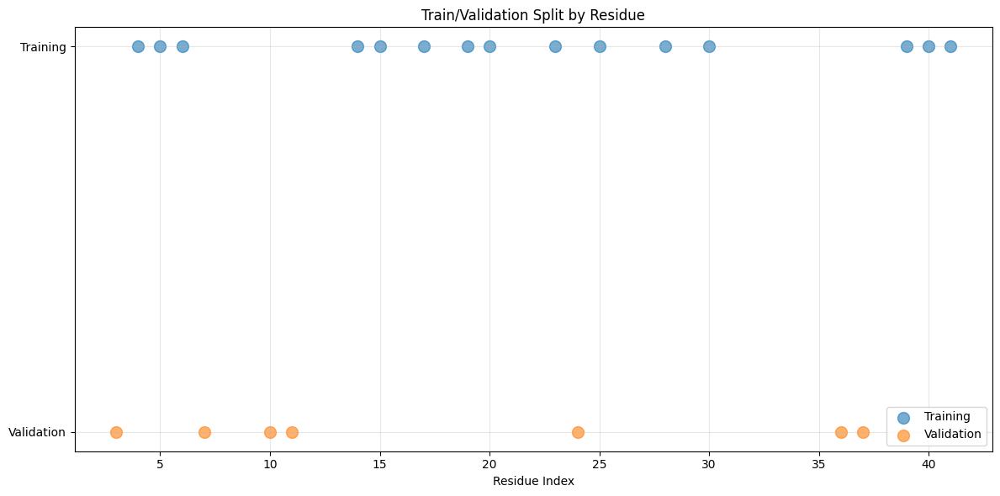

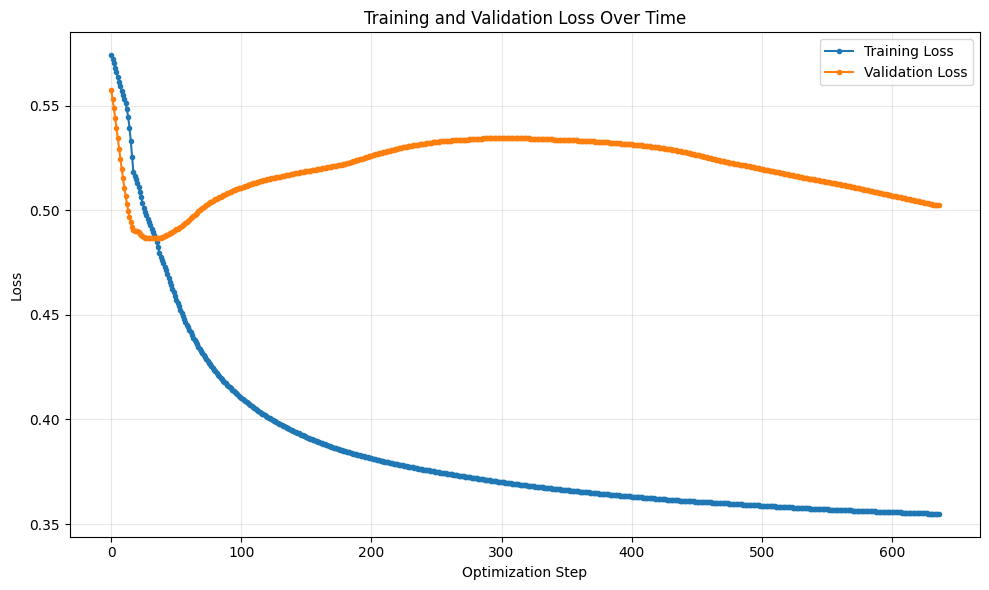

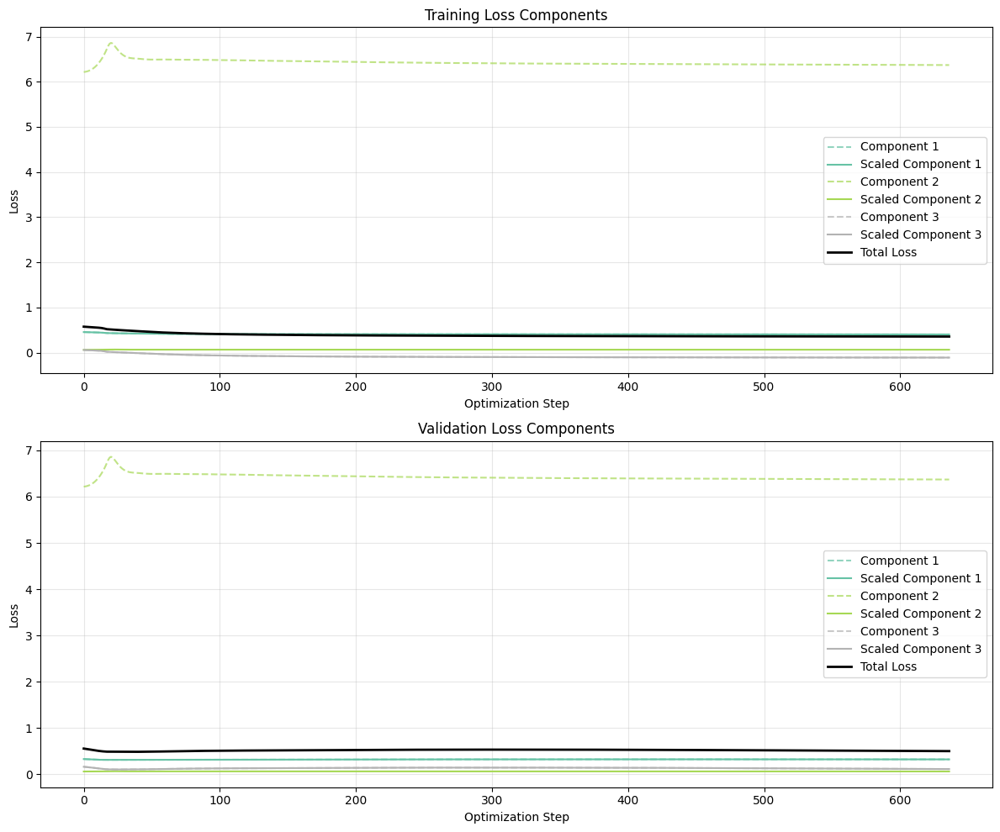

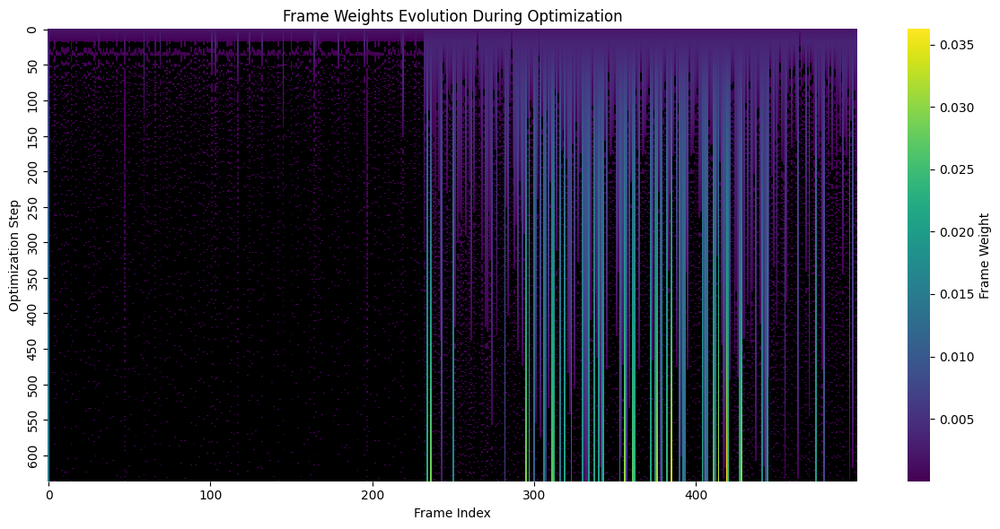

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 2/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

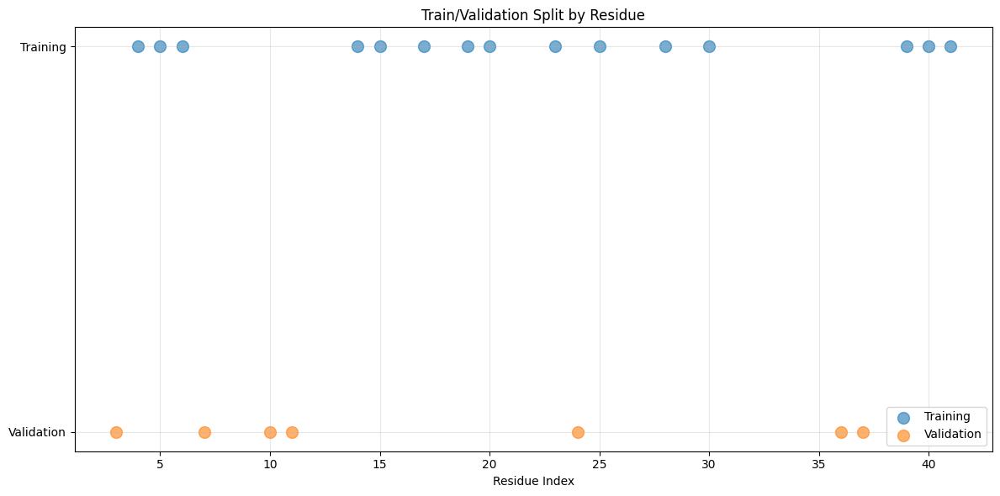

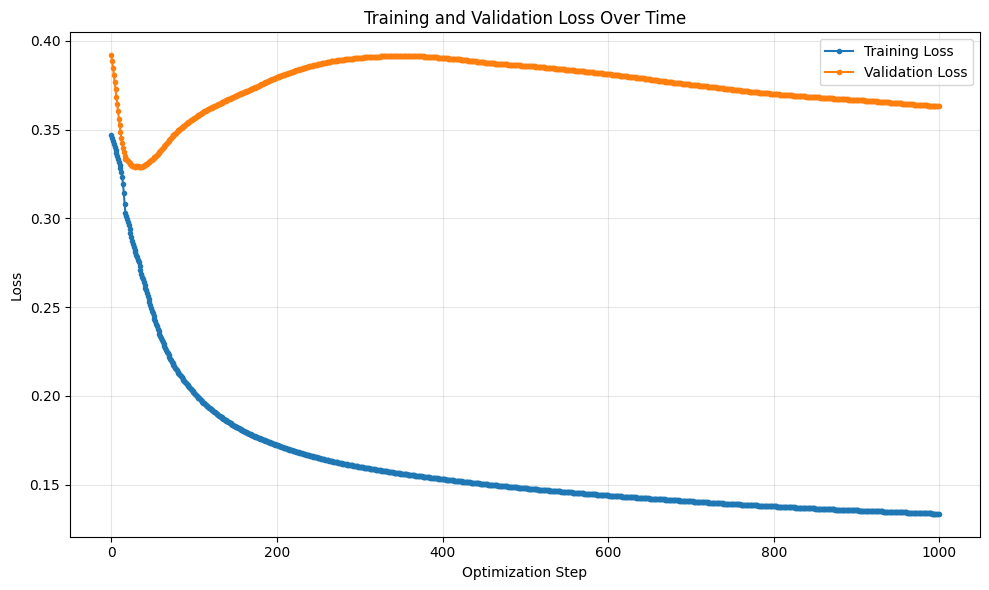

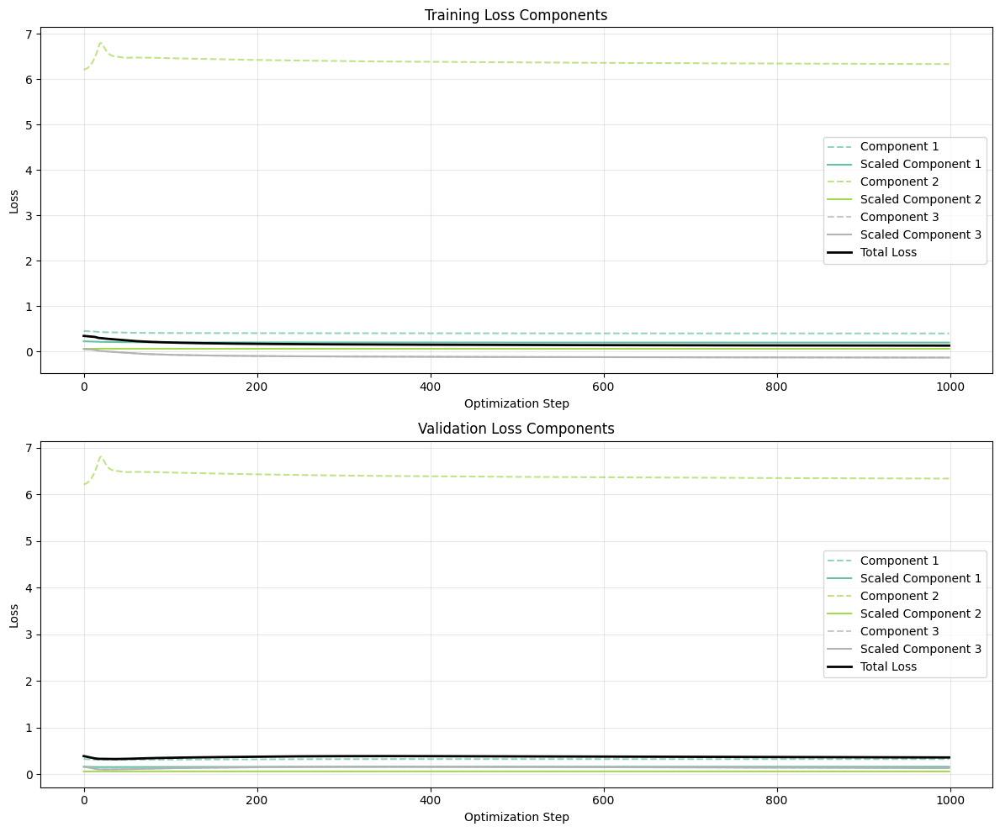

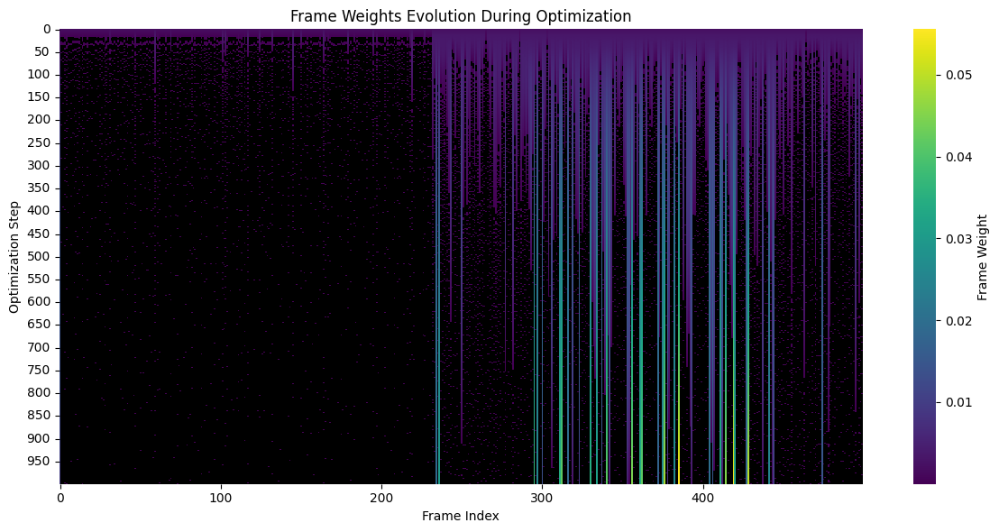

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 3/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

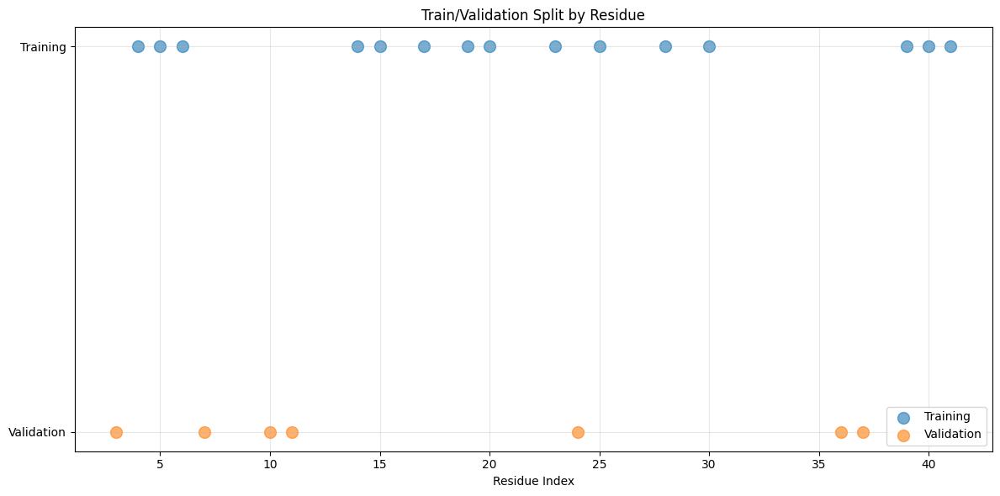

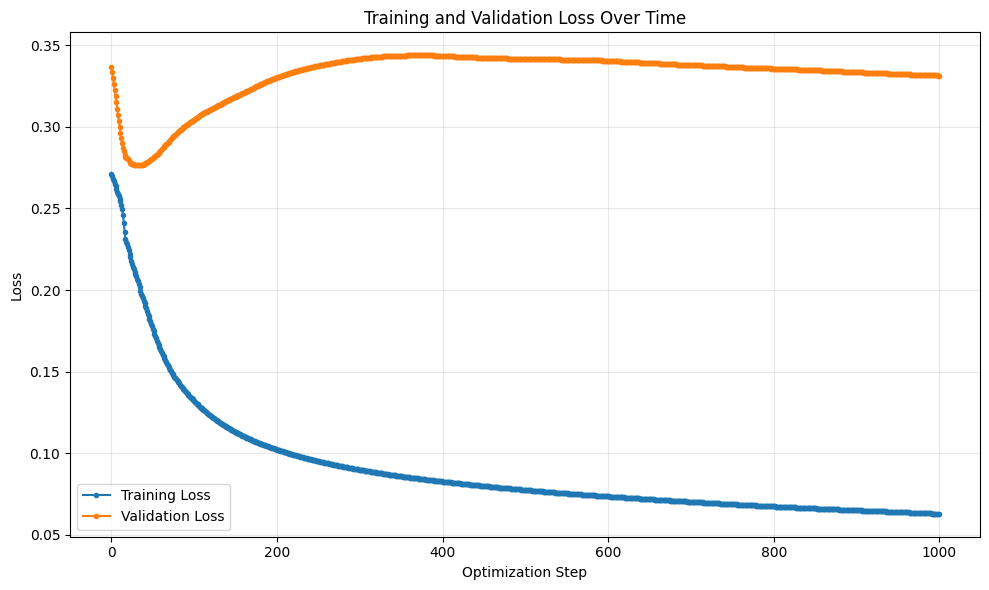

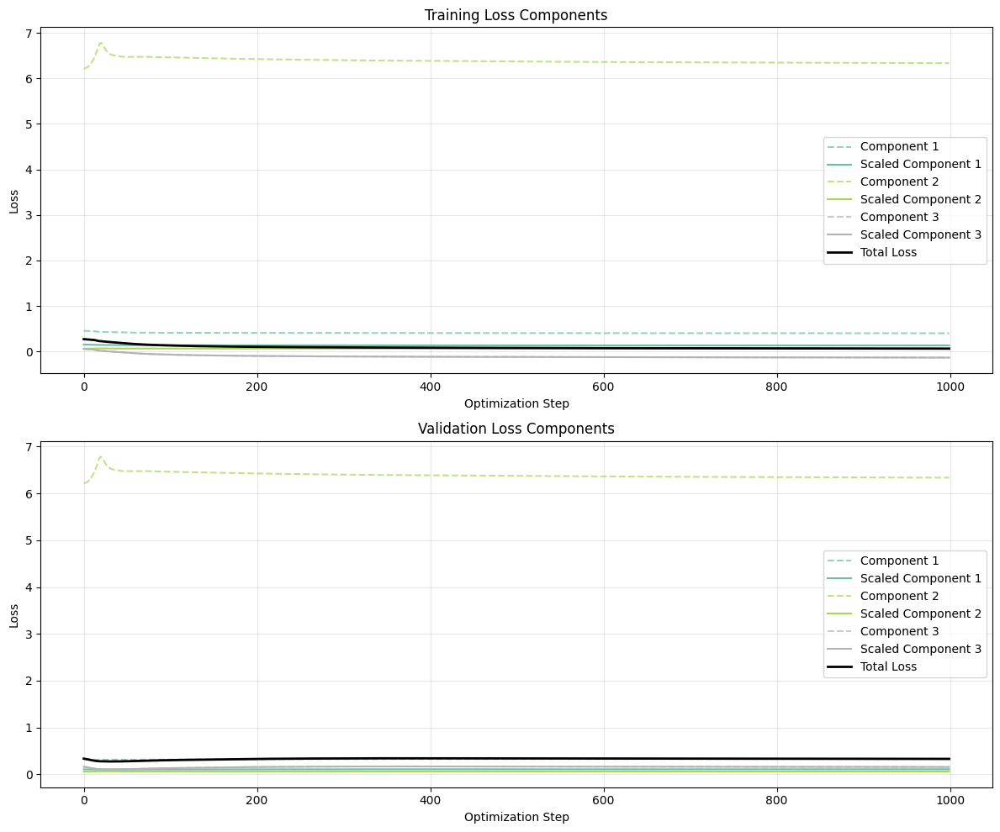

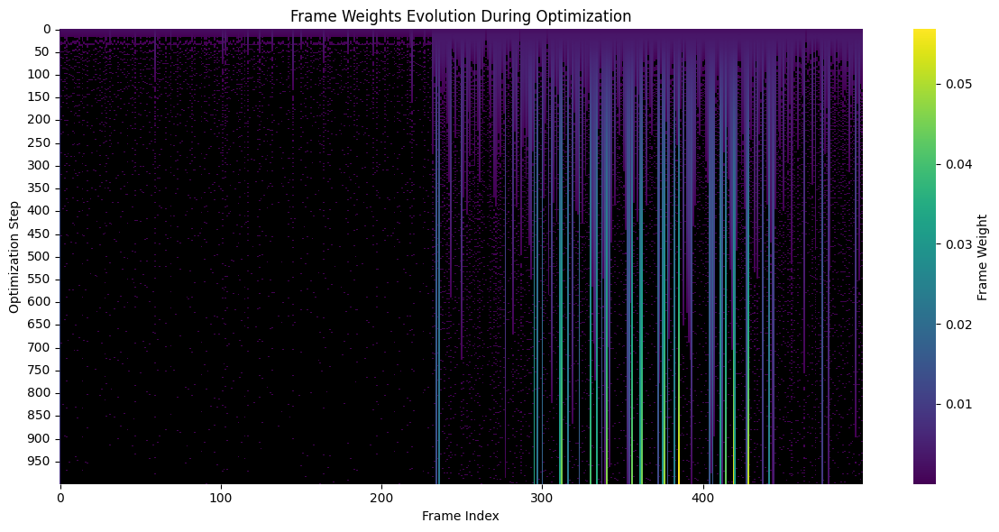

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 4/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

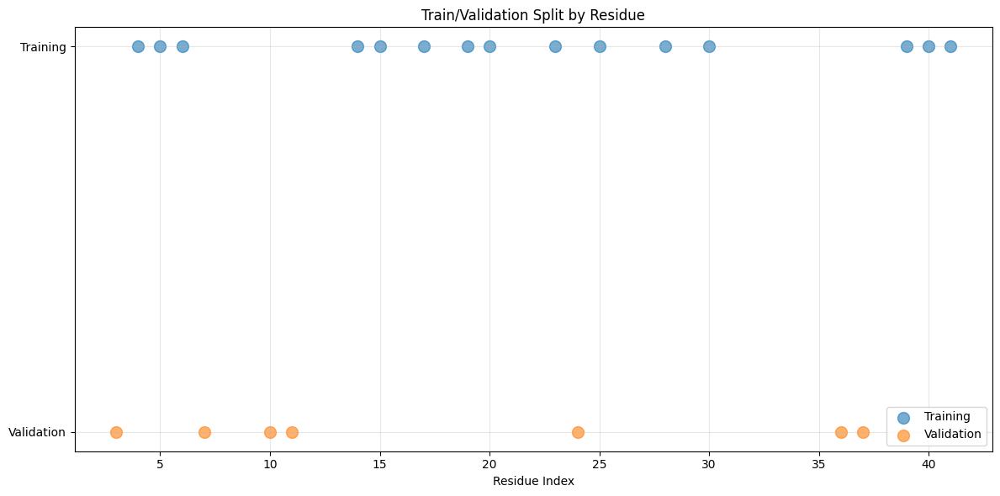

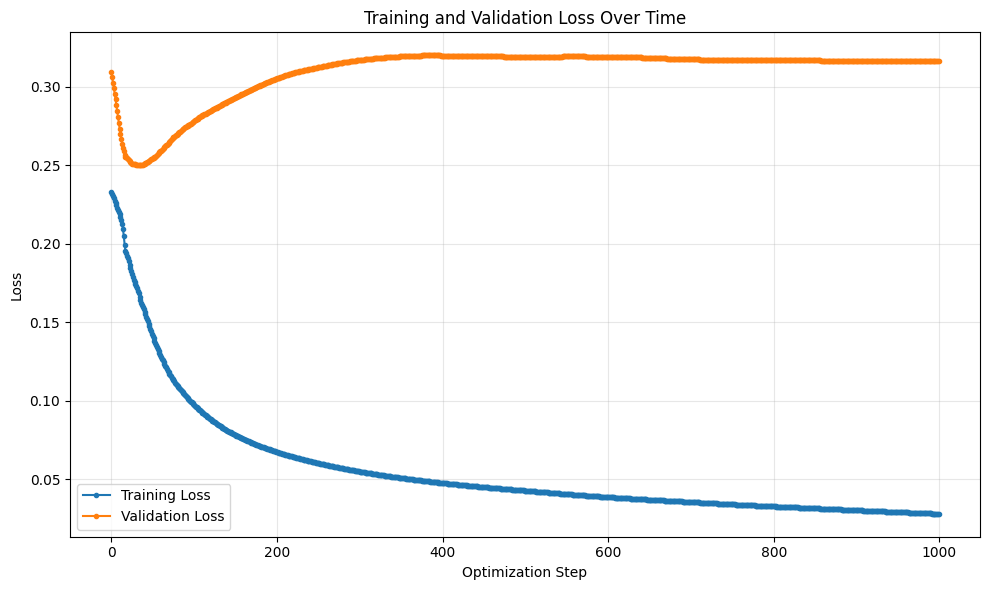

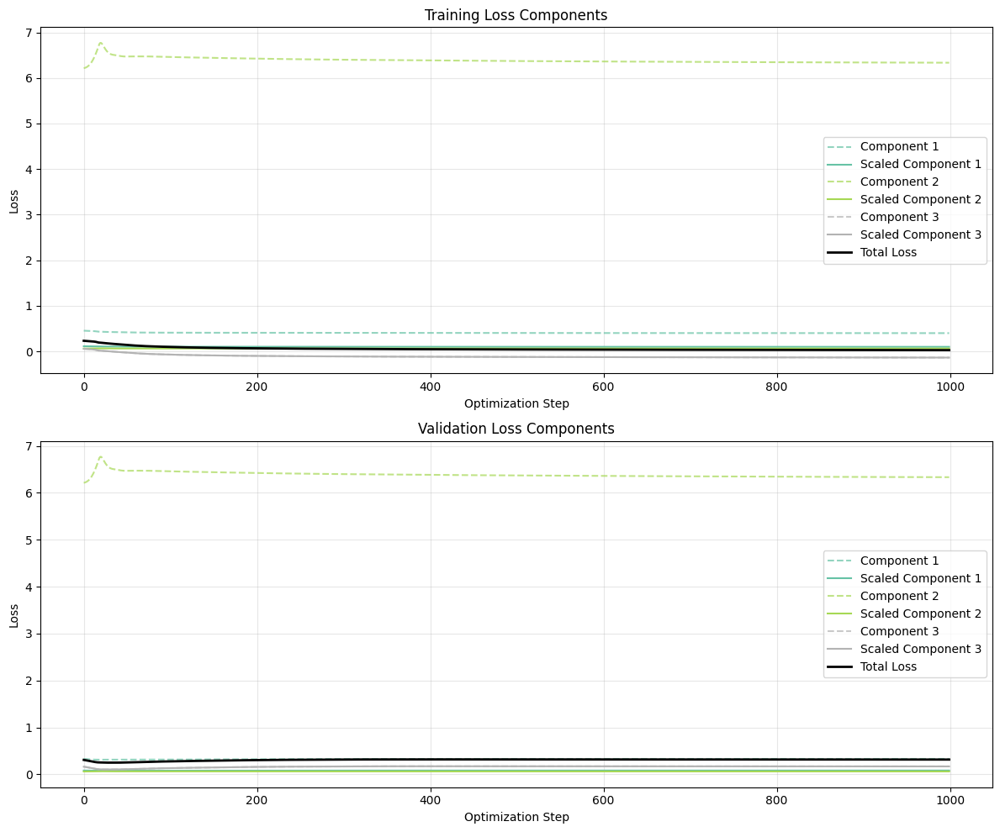

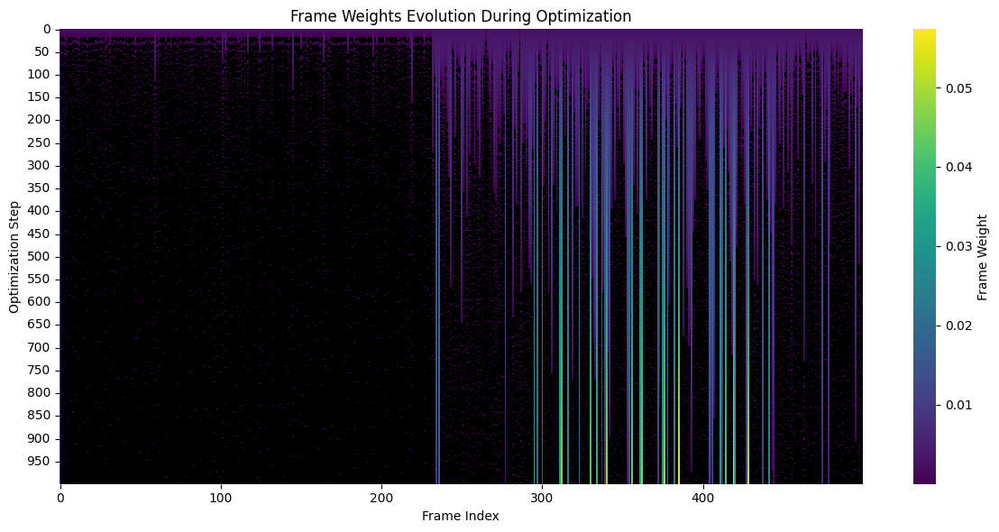

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 5/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

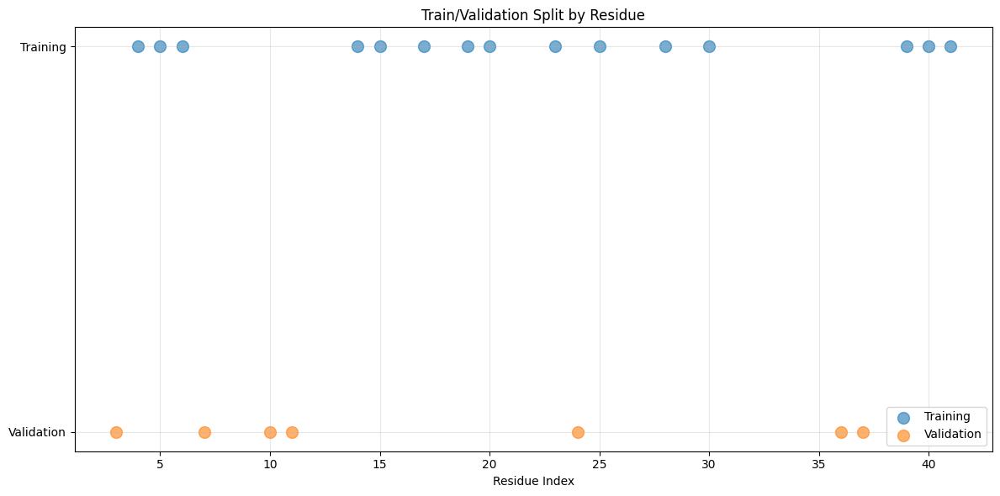

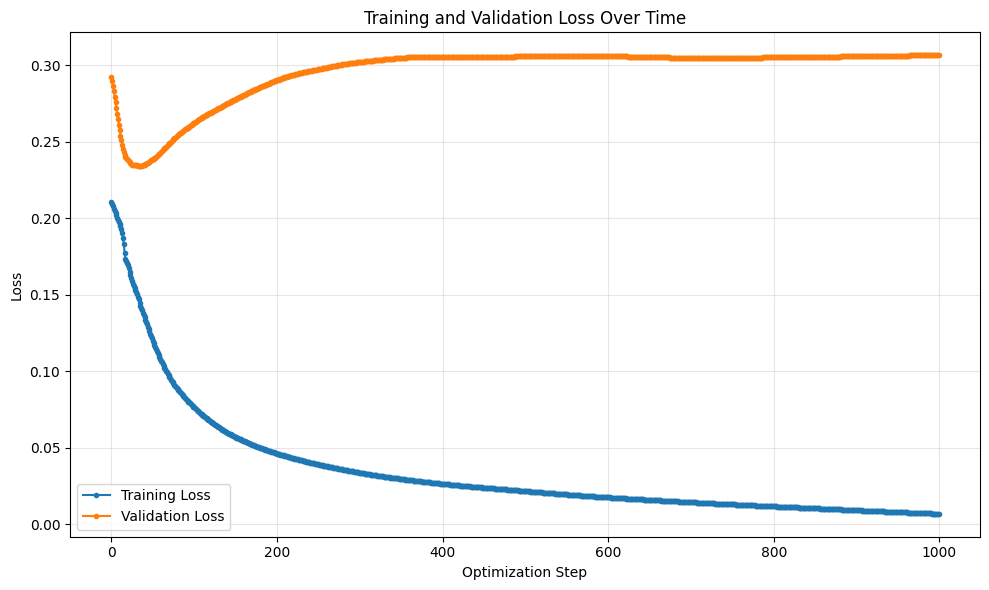

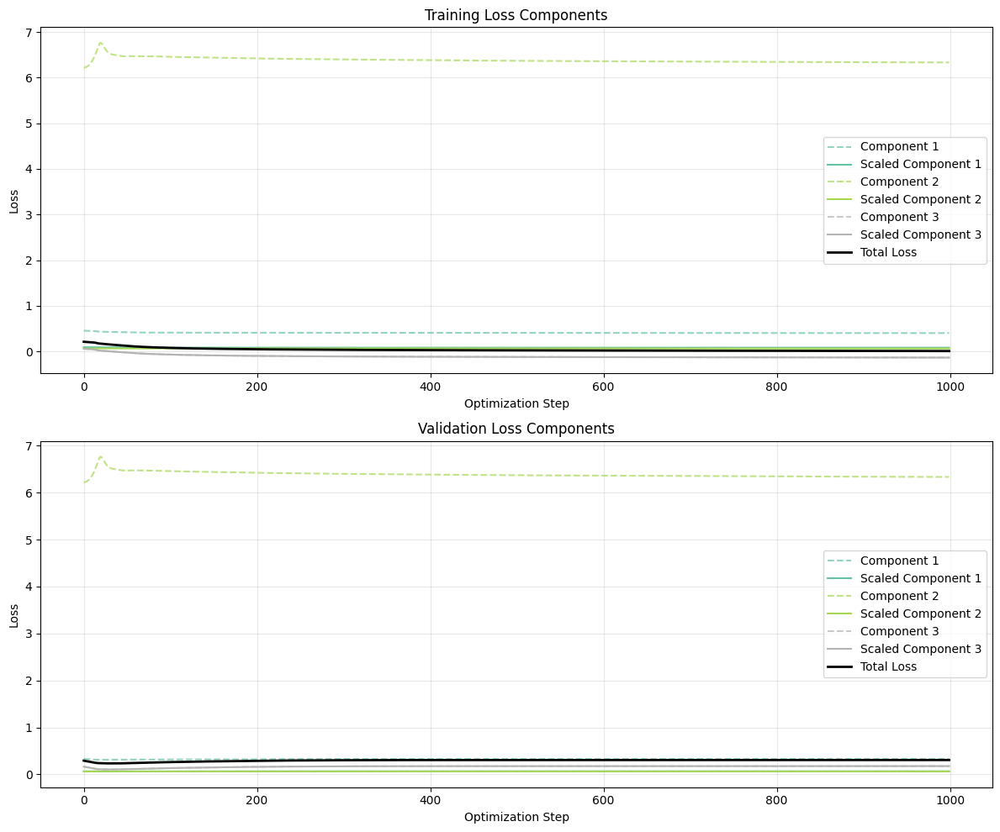

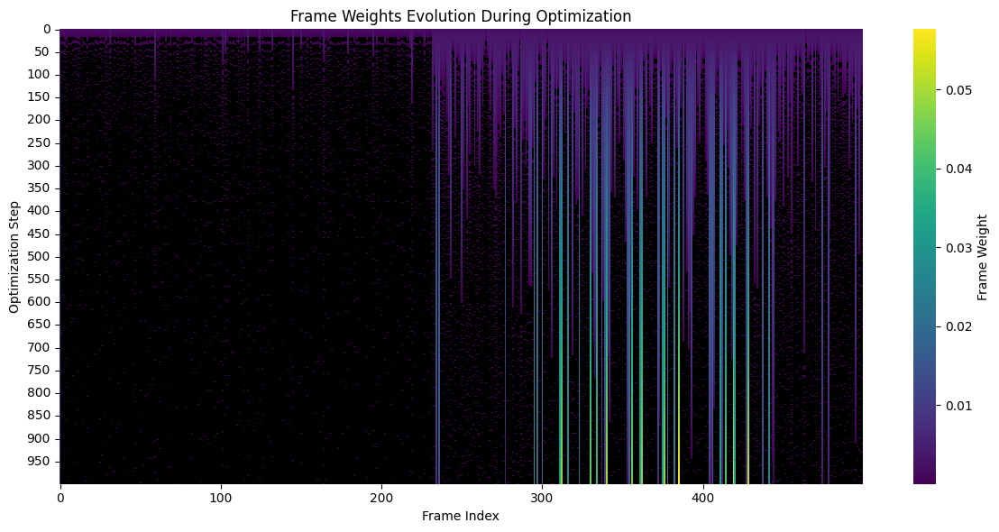

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 6/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

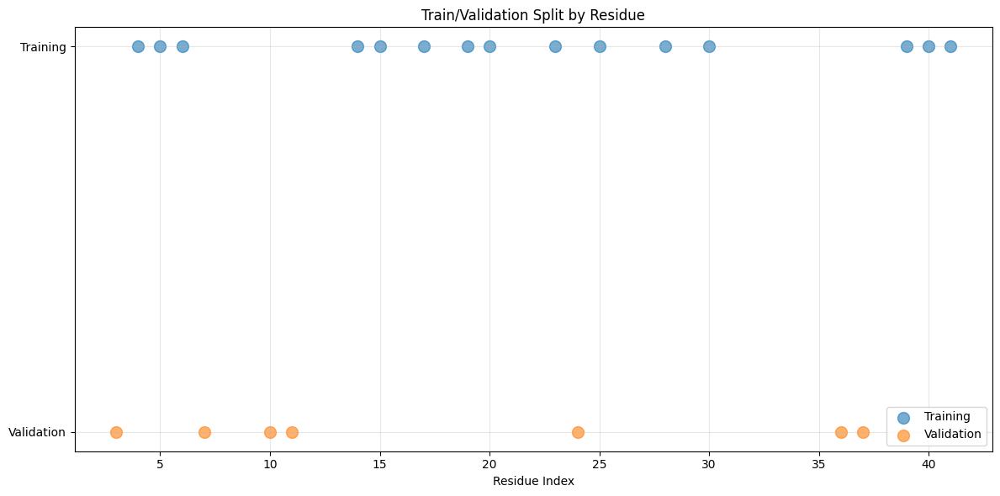

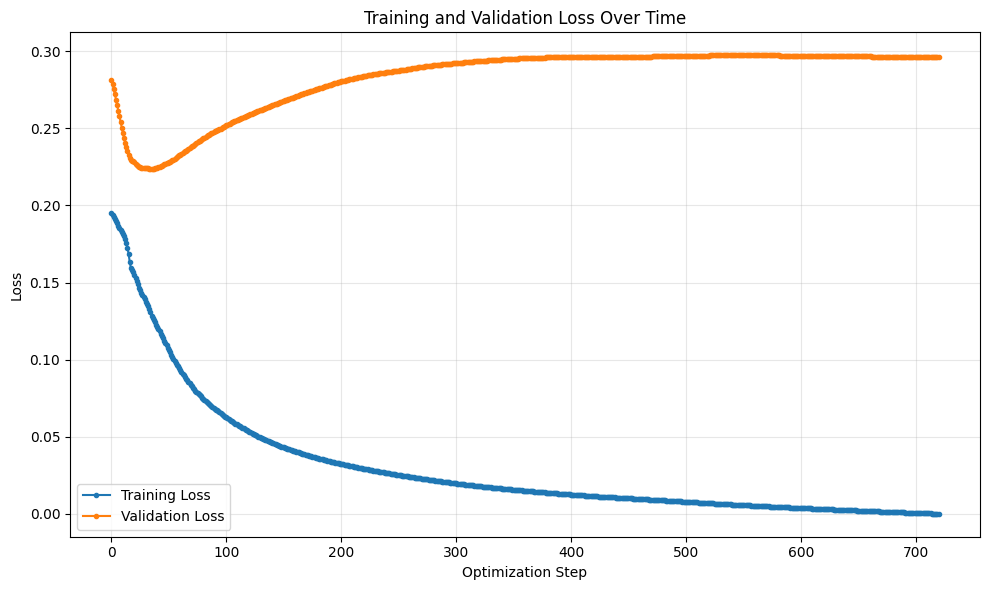

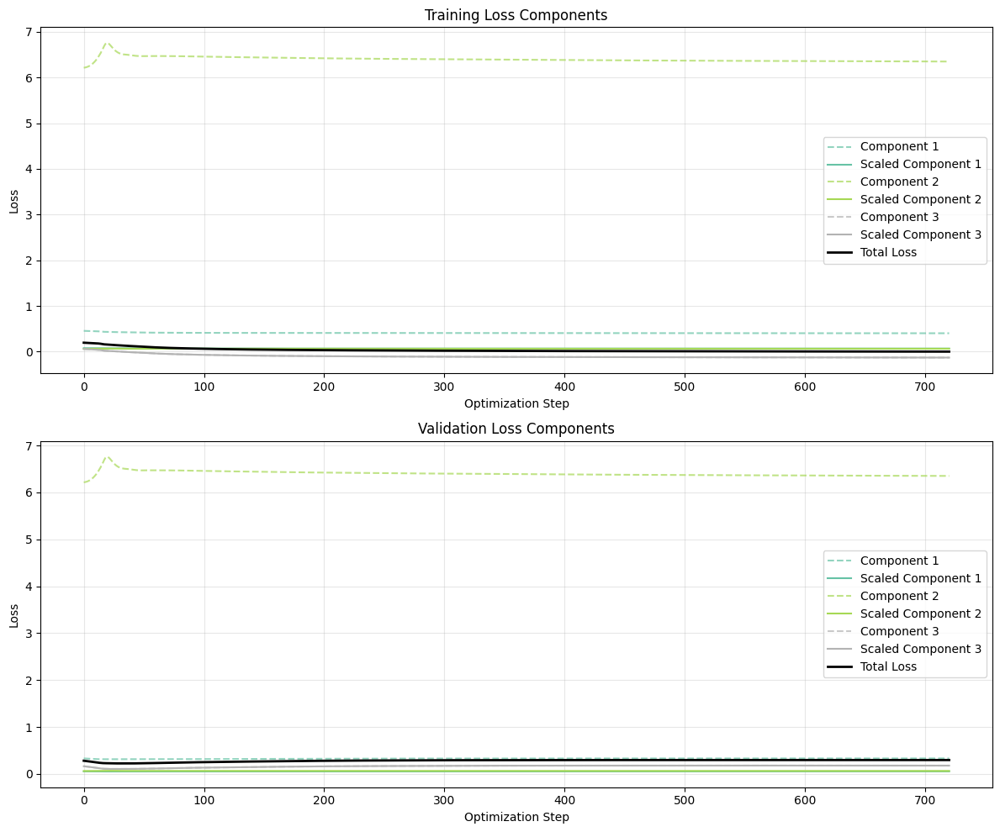

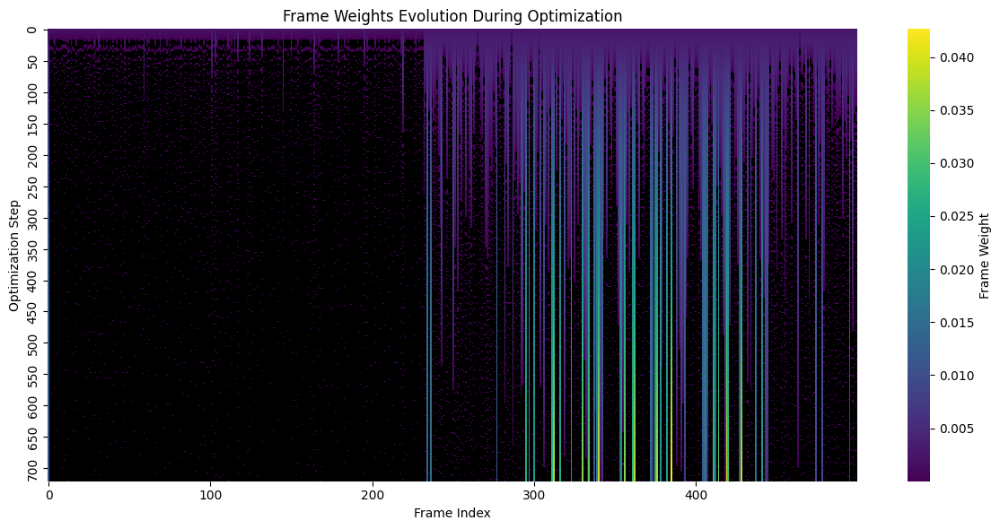

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 7/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

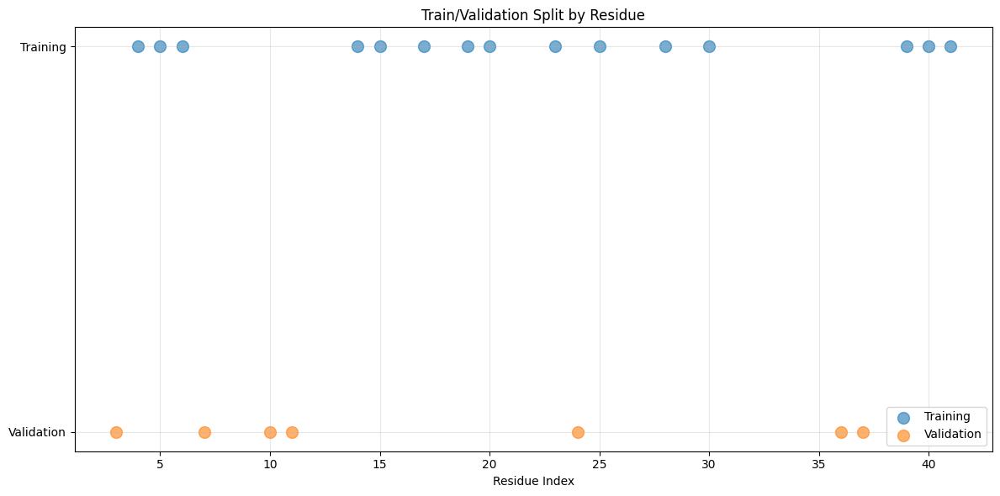

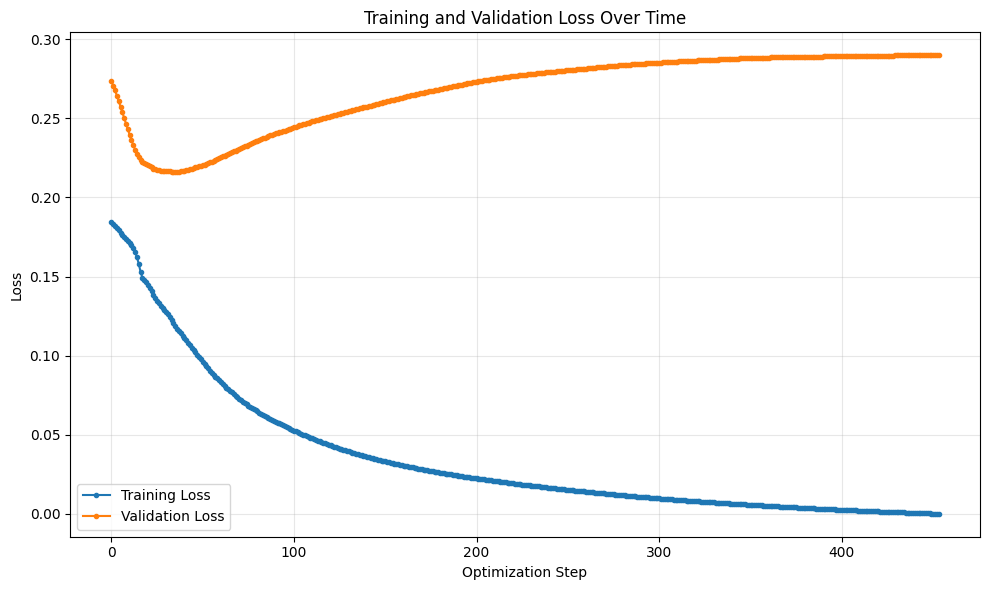

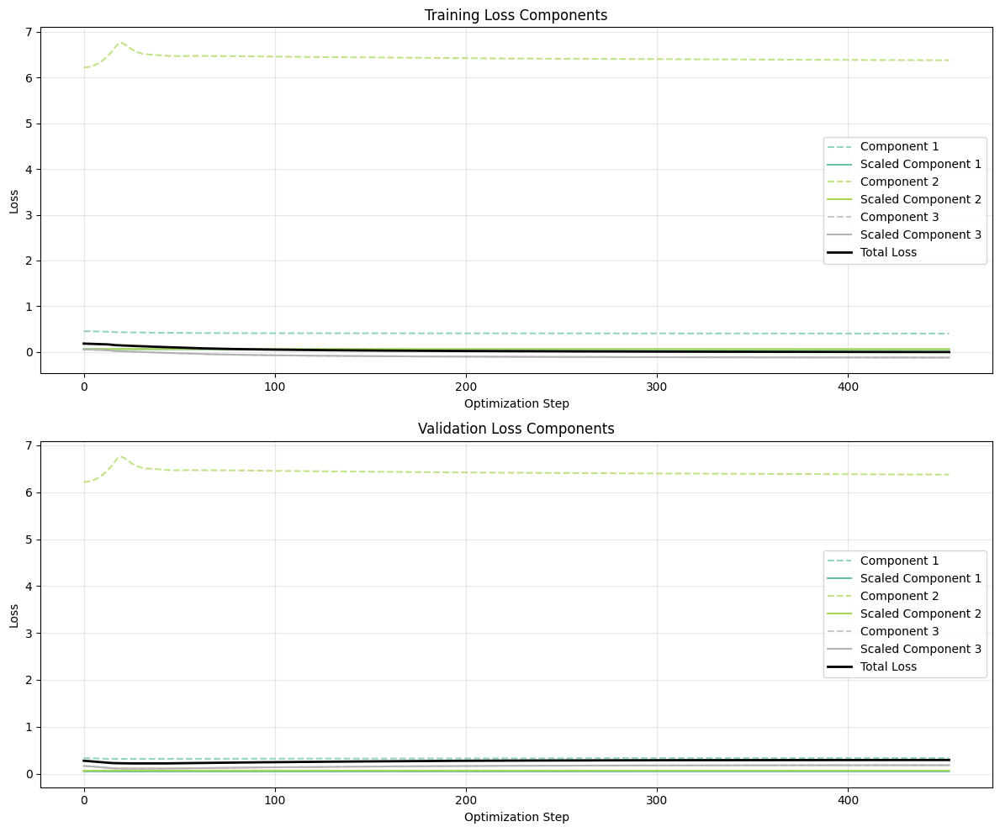

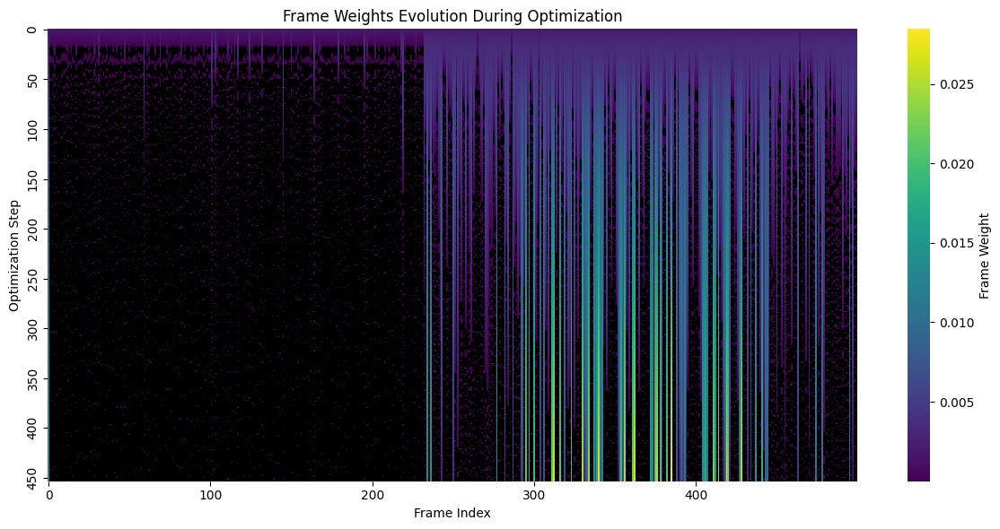

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Running optimization for Dataset Seed 3/3, Replicate 8/8
Params structure: PyTreeDef(CustomNode(Simulation_Parameters[()], [*, *, [CustomNode(BV_Model_Parameters[(300, Array([ 0.167,  1.   , 10.   ], dtype=float32))], [*, *])], *, *, *]))
{<Optimisable_Parameters.frame_weights: 0>}
Masks: frame=1.0, model=0.0, forward=0.0, frame_mask=0.0, scaling=0.0
Frame mask mask: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 

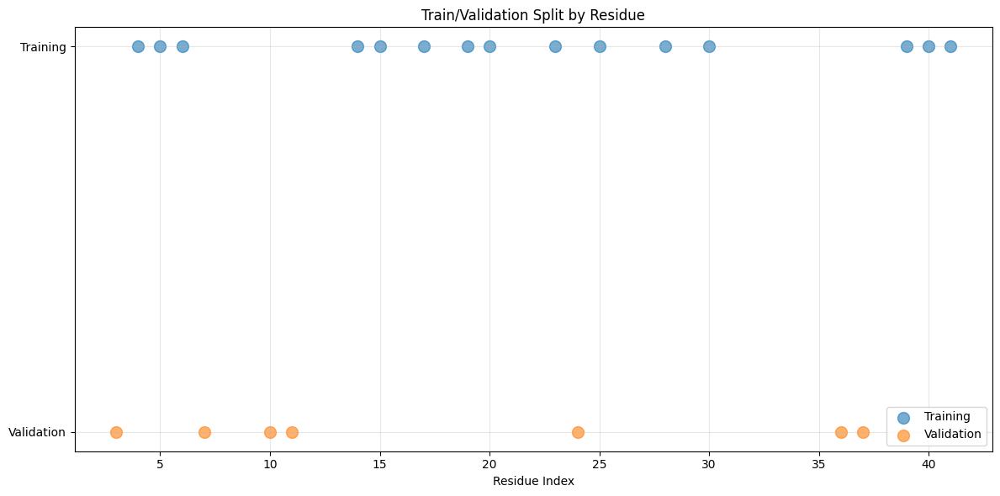

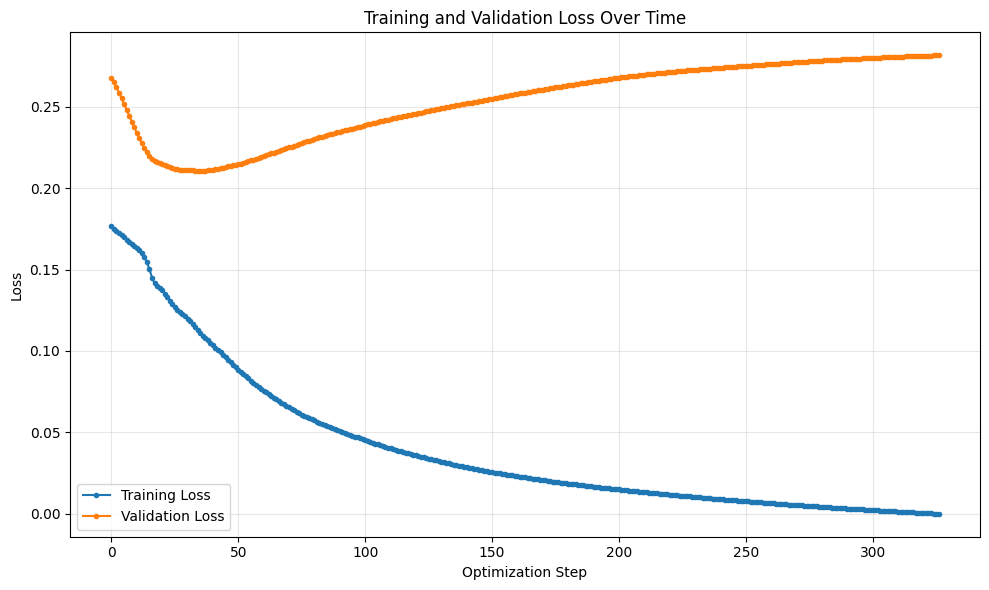

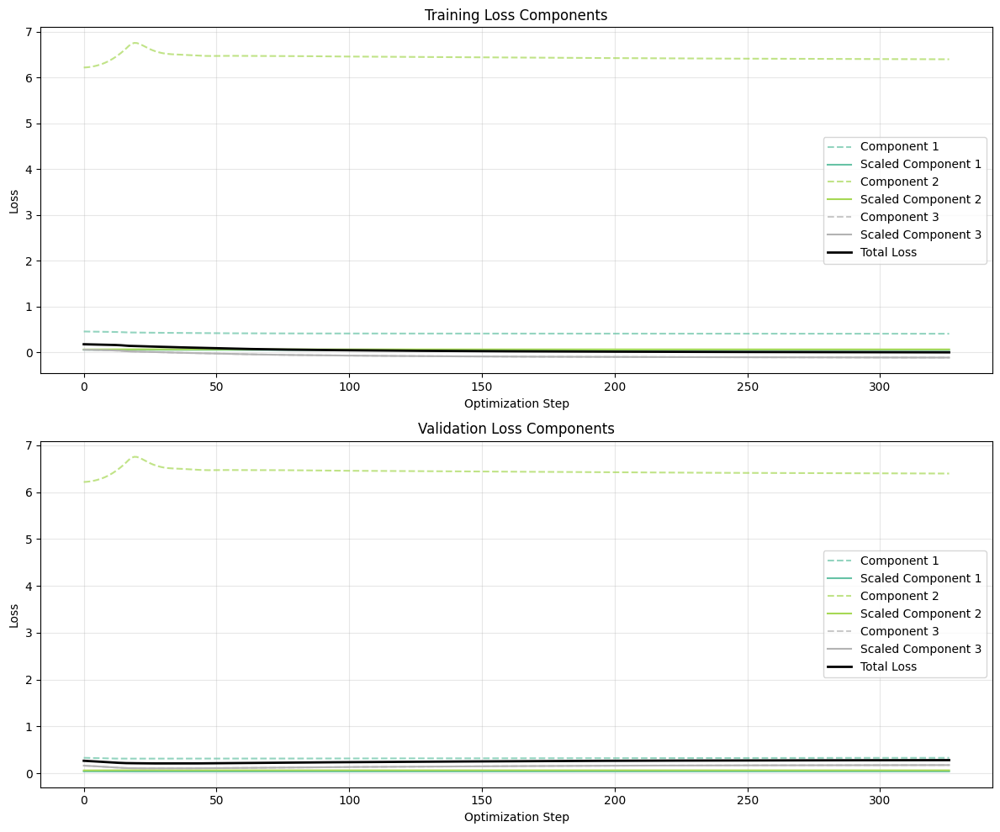

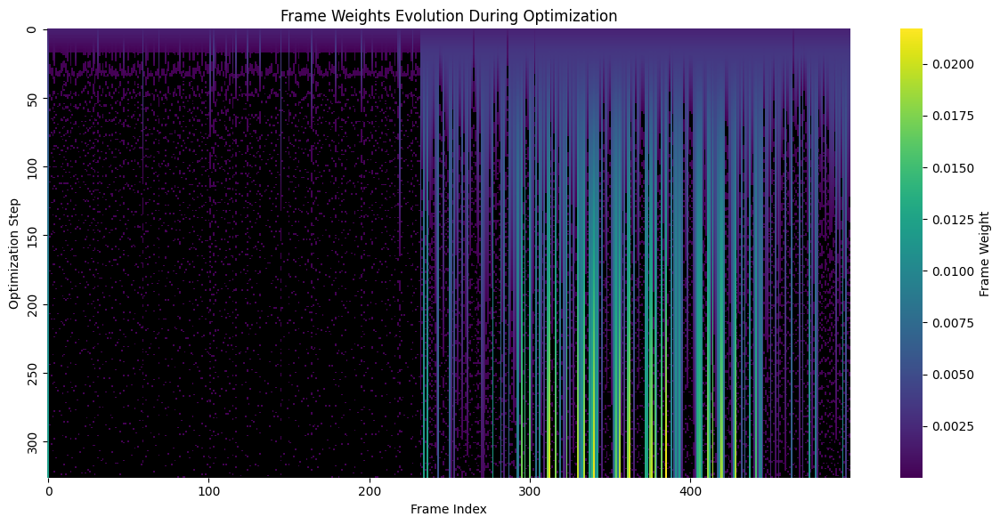

In [40]:
# %% Run the experiment
# Set up parameters
n_seeds = 3
seeds = [42+i for i in range(n_seeds)]
n_replicates = 8


mre_me_optimization_results = run_MAE_max_ent_optimization_replicates(simulation, datasets, models, opt_settings, n_replicates)


In [41]:
mre_me_test_losses = compute_test_losses(mre_me_optimization_results, datasets)

Computing test losses for Dataset Seed 1, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 1000/1000 [00:44<00:00, 22.39it/s]


Computing test losses for Dataset Seed 1, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 1000/1000 [00:42<00:00, 23.68it/s]


Computing test losses for Dataset Seed 1, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 1000/1000 [00:40<00:00, 24.47it/s]


Computing test losses for Dataset Seed 1, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 1000/1000 [00:42<00:00, 23.30it/s]


Computing test losses for Dataset Seed 1, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 902/902 [00:37<00:00, 24.15it/s]


Computing test losses for Dataset Seed 1, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 491/491 [00:20<00:00, 23.42it/s]


Computing test losses for Dataset Seed 1, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 347/347 [00:14<00:00, 23.40it/s]


Computing test losses for Dataset Seed 1, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 277/277 [00:11<00:00, 23.30it/s]


Computing test losses for Dataset Seed 2, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 1000/1000 [00:44<00:00, 22.53it/s]


Computing test losses for Dataset Seed 2, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 1000/1000 [00:43<00:00, 23.04it/s]


Computing test losses for Dataset Seed 2, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 1000/1000 [00:42<00:00, 23.34it/s]


Computing test losses for Dataset Seed 2, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 1000/1000 [00:41<00:00, 24.36it/s]


Computing test losses for Dataset Seed 2, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 746/746 [00:30<00:00, 24.47it/s]


Computing test losses for Dataset Seed 2, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 437/437 [00:18<00:00, 23.66it/s]


Computing test losses for Dataset Seed 2, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 312/312 [00:13<00:00, 23.98it/s]


Computing test losses for Dataset Seed 2, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 253/253 [00:10<00:00, 23.69it/s]


Computing test losses for Dataset Seed 3, Replicate 1
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 1: 100%|██████████| 637/637 [00:26<00:00, 23.92it/s]


Computing test losses for Dataset Seed 3, Replicate 2
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 2: 100%|██████████| 1000/1000 [00:41<00:00, 24.11it/s]


Computing test losses for Dataset Seed 3, Replicate 3
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 3: 100%|██████████| 1000/1000 [00:41<00:00, 24.10it/s]


Computing test losses for Dataset Seed 3, Replicate 4
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 4: 100%|██████████| 1000/1000 [00:42<00:00, 23.56it/s]


Computing test losses for Dataset Seed 3, Replicate 5
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 5: 100%|██████████| 1000/1000 [00:42<00:00, 23.29it/s]


Computing test losses for Dataset Seed 3, Replicate 6
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 6: 100%|██████████| 721/721 [00:30<00:00, 23.73it/s]


Computing test losses for Dataset Seed 3, Replicate 7
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 7: 100%|██████████| 454/454 [00:18<00:00, 24.21it/s]


Computing test losses for Dataset Seed 3, Replicate 8
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 











Replicate 8: 100%|██████████| 327/327 [00:14<00:00, 22.63it/s]


Generating PCA visualization...


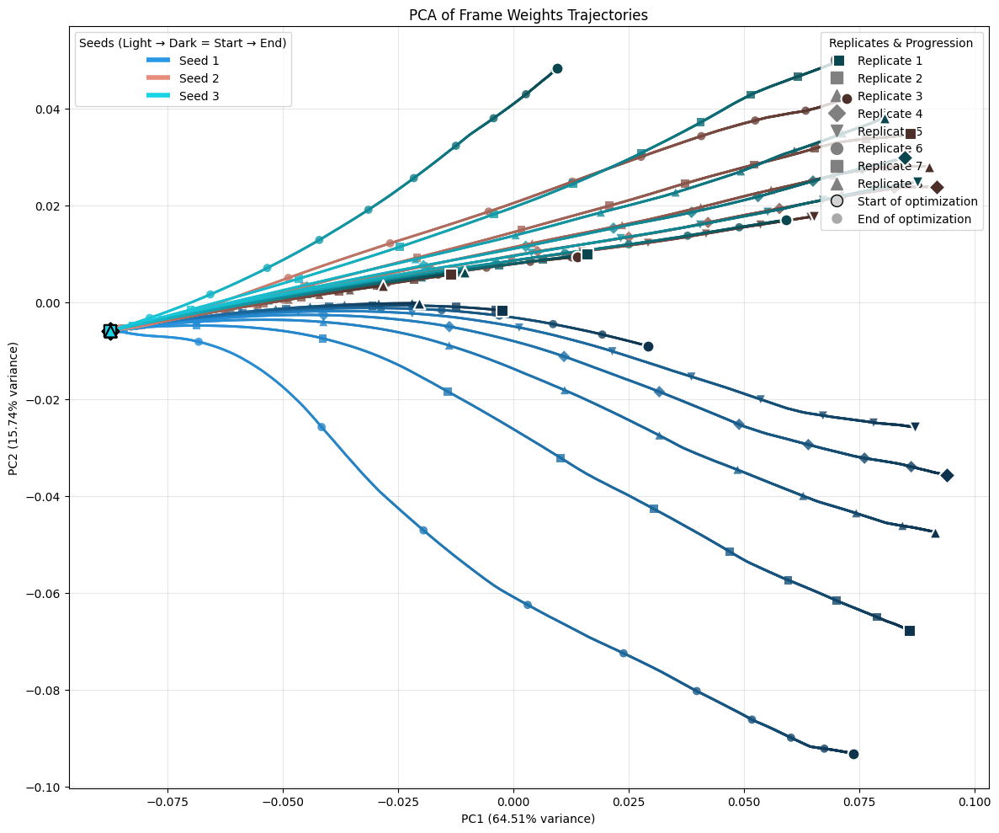

In [42]:

# Visualize PCA trajectories
print("Generating PCA visualization...")
pca_fig = visualize_pca_trajectories(mre_me_optimization_results, n_seeds, n_replicates)
# save_pca_visualization(pca_fig)
plt.show()

Generating 3D PCA visualization with residue-average test loss...


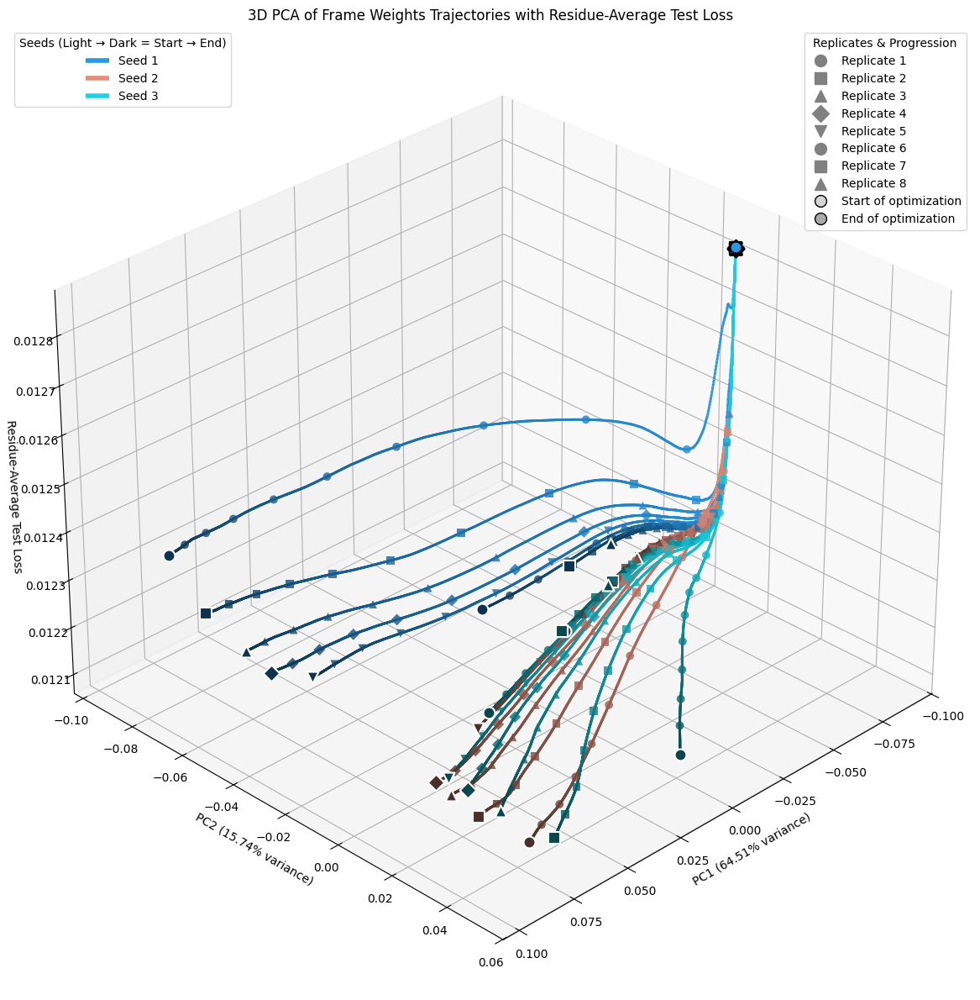

In [43]:
print("Generating 3D PCA visualization with residue-average test loss...")
pca3d_fig = visualize_pca_3d_test_loss(mre_me_optimization_results, mre_me_test_losses, n_seeds, n_replicates)
plt.show()

Generating 3D t-SNE visualization with residue-average test loss...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


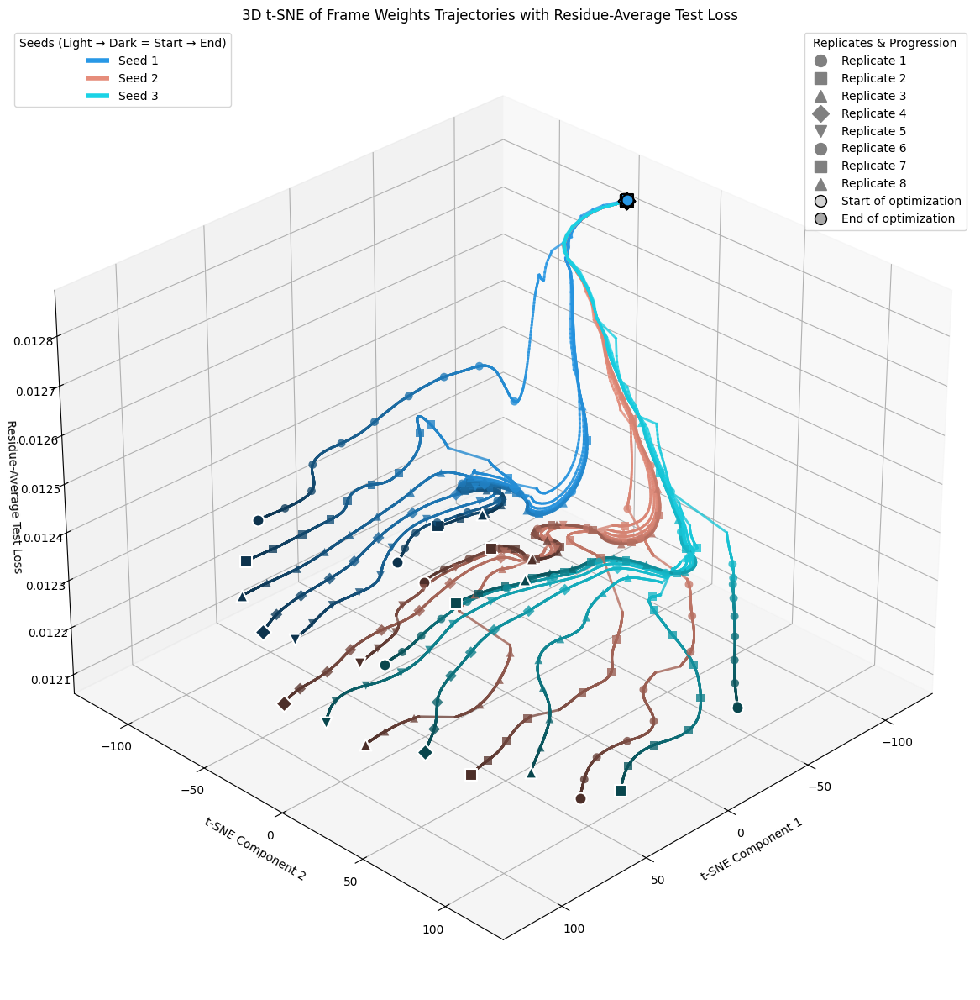

In [44]:

print("Generating 3D t-SNE visualization with residue-average test loss...")
tsne3d_fig = visualize_tsne_3d_loss(mre_me_optimization_results, mre_me_test_losses, n_seeds, n_replicates)
plt.show()

Generating validation vs test loss comparison...


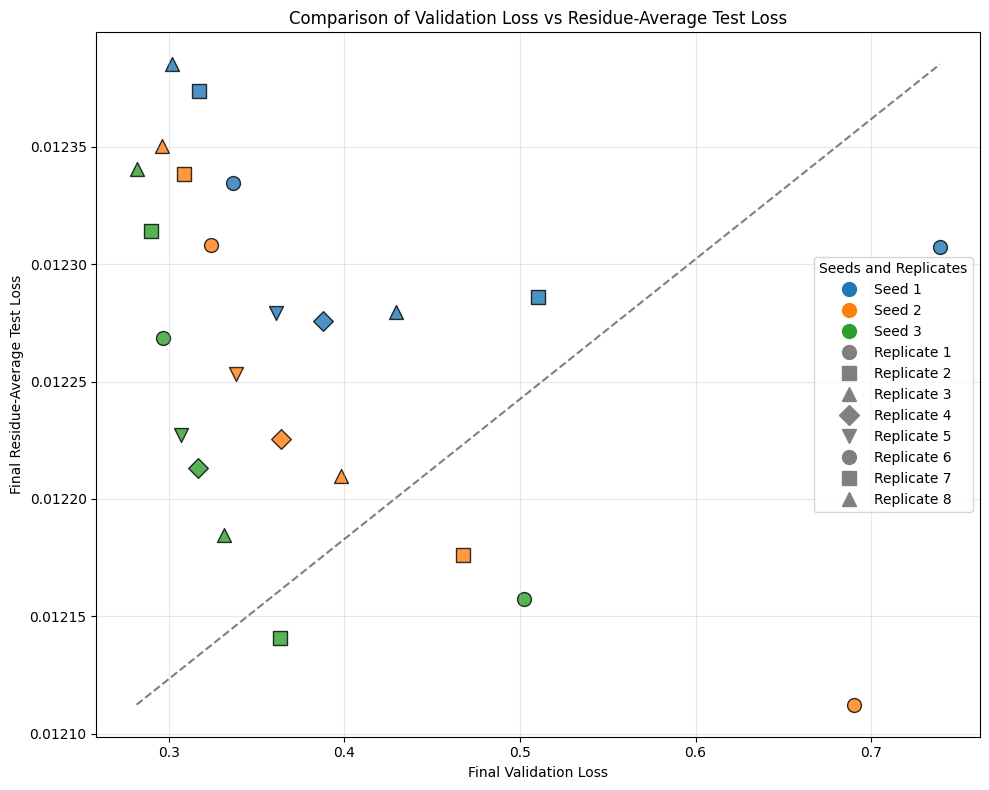

In [45]:
print("Generating validation vs test loss comparison...")
comparison_fig = plot_val_vs_test_loss(mre_me_optimization_results, mre_me_test_losses, n_seeds, n_replicates)
plt.show()

Performing t-SNE with perplexity=30, n_iter=1000...


/home/alexi/Documents/JAX-ENT/.venv/lib/python3.13/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


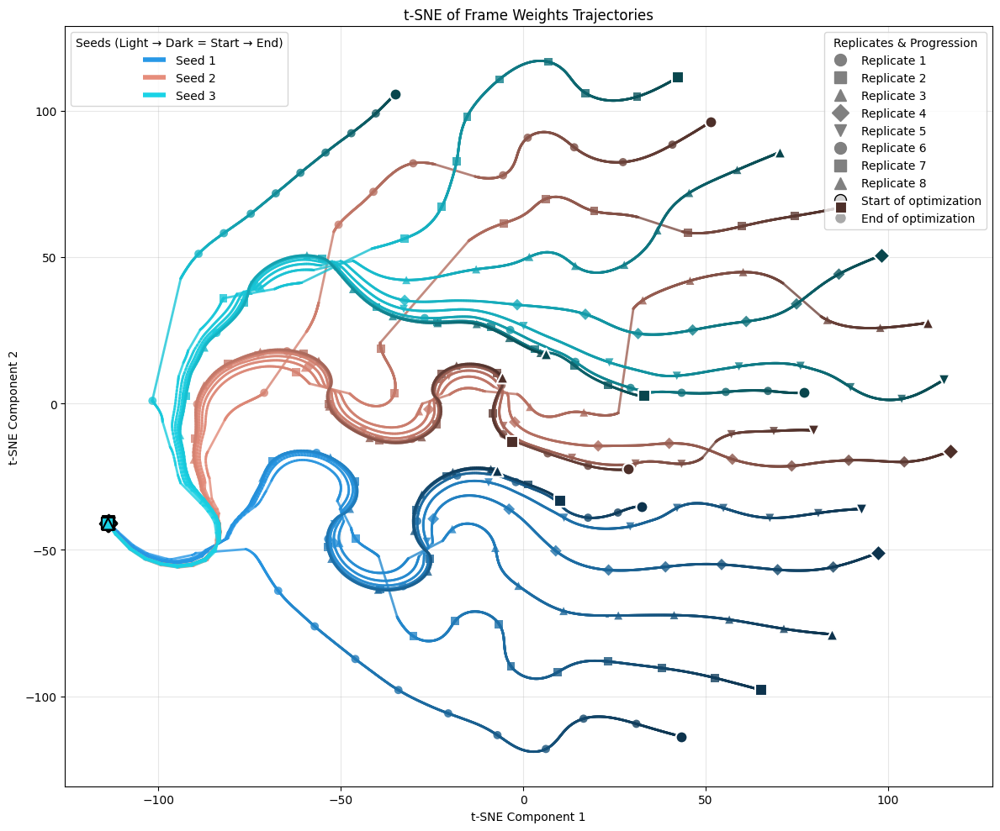

In [46]:
tsne_fig = visualize_tsne_trajectories(mre_me_optimization_results, n_seeds, n_replicates)


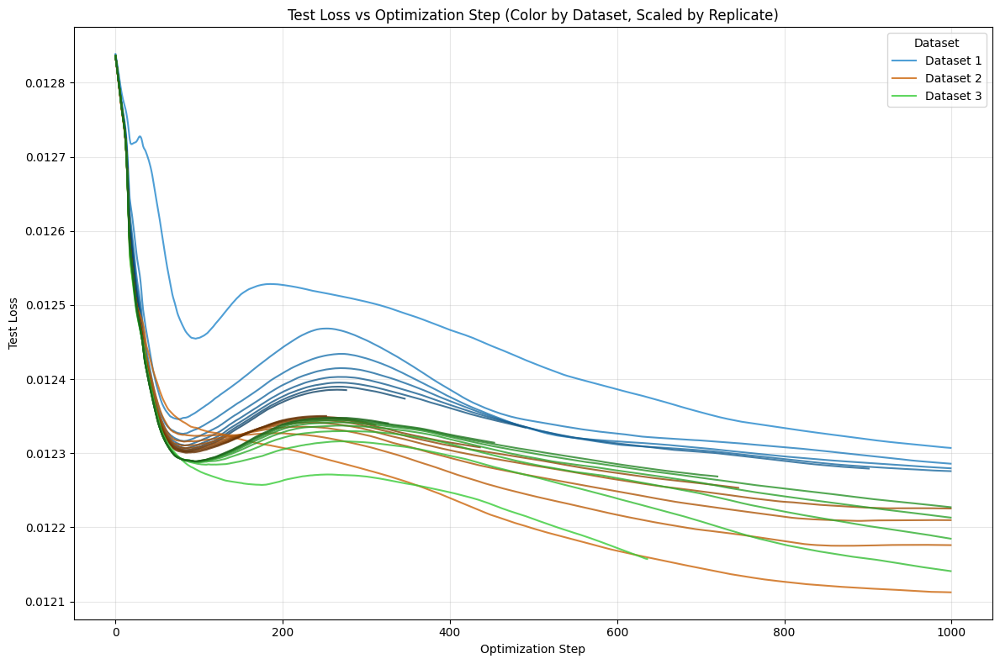

In [47]:
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

plt.figure(figsize=(12, 8))

# Loop over each dataset (seed)
for seed_idx in range(n_seeds):
    seed_key = f'seed_{seed_idx}'
    base_color = plt.cm.tab10(seed_idx)  # base color for the dataset
    # Loop over replicates for this dataset
    for rep_idx in range(n_replicates):
        replicate_losses = mre_me_test_losses[seed_key][rep_idx]
        steps = np.arange(len(replicate_losses))
        
        # Adjust the brightness of the base color according to the replicate
        hsv = mcolors.rgb_to_hsv(base_color[:3])
        # Scale brightness from 0.8 (replicate 0) to 0.4 (last replicate)
        brightness = 0.8 - (rep_idx / (n_replicates - 1)) * (0.8 - 0.4)
        hsv[2] = brightness
        color = mcolors.hsv_to_rgb(hsv)
        
        # Use label only for the first replicate per dataset
        label = f"Dataset {seed_idx+1}" if rep_idx == 0 else None
        
        plt.plot(steps, replicate_losses, color=color, label=label, alpha=0.8)

plt.xlabel("Optimization Step")
plt.ylabel("Test Loss")
plt.title("Test Loss vs Optimization Step (Color by Dataset, Scaled by Replicate)")
plt.legend(title="Dataset")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [48]:
def plot_final_test_error_vs_param(test_losses, n_seeds, n_replicates, param_values=None, 
                                  title="Final Test Error vs Parameter Value", 
                                  param_name="Parameter Value"):
    """
    Creates a plot of final test error for each dataset against the parameter values.
    
    Parameters:
    -----------
    test_losses : dict
        Dictionary of test losses for each dataset seed and replicate
    n_seeds : int
        Number of seeds (datasets)
    n_replicates : int
        Number of replicates per seed
    param_values : list, optional
        List of parameter values corresponding to each replicate.
        If None, uses replicate index as x-axis.
    title : str, optional
        Plot title
    param_name : str, optional
        Name of the parameter being varied
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The plot figure
    """
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.colors as mcolors
    from matplotlib.markers import MarkerStyle
    
    # Create figure
    plt.figure(figsize=(12, 8))
    
    # If param_values not provided, use replicate indices
    if param_values is None:
        param_values = list(range(1, n_replicates + 1))
    
    # Extract final test error for each dataset and replicate
    final_errors = {}
    min_error = float('inf')
    max_error = 0
    
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        final_errors[seed_key] = []
        
        for rep_idx in range(n_replicates):
            if seed_key in test_losses and rep_idx < len(test_losses[seed_key]) and test_losses[seed_key][rep_idx] is not None:
                # Get the final test loss for this replicate
                final_error = test_losses[seed_key][rep_idx][-1]
                final_errors[seed_key].append(final_error)
                
                # Update min and max for y-axis scaling
                min_error = min(min_error, final_error)
                max_error = max(max_error, final_error)
            else:
                # Handle missing data
                final_errors[seed_key].append(np.nan)
    
    # Define markers and colors
    markers = ['o', 's', '^', 'D', 'v', 'p', '*', 'h', 'x', '+']
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    
    # Plot the data
    legend_handles = []
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        color = base_colors[seed_idx]
        marker = markers[seed_idx % len(markers)]
        
        # Create scatter plot for this dataset
        scatter = plt.scatter(
            param_values[:len(final_errors[seed_key])], 
            final_errors[seed_key],
            color=color,
            marker=marker,
            s=100,
            alpha=0.8,
            edgecolors='black',
            label=f"Dataset {seed_idx+1}"
        )
        legend_handles.append(scatter)
        
        # Add connecting lines
        plt.plot(
            param_values[:len(final_errors[seed_key])], 
            final_errors[seed_key],
            color=color,
            alpha=0.6,
            linestyle='-'
        )
    
    # Add annotations for minimum error points
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        if len(final_errors[seed_key]) > 0 and not all(np.isnan(x) for x in final_errors[seed_key]):
            min_idx = np.nanargmin(final_errors[seed_key])
            min_val = final_errors[seed_key][min_idx]
            min_param = param_values[min_idx]
            
            plt.annotate(
                f'Min: {min_val:.4f}',
                xy=(min_param, min_val),
                xytext=(10, -15),
                textcoords='offset points',
                fontsize=9,
                bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.7),
                arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.2')
            )
    
    # Customize the plot
    plt.xlabel(param_name)
    plt.ylabel("Final Test Error")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    # Add legend
    plt.legend(title="Dataset", loc='best')
    
    # Add 5% padding to y-axis
    y_range = max_error - min_error
    plt.ylim(min_error - 0.05 * y_range, max_error + 0.05 * y_range)
    
    plt.tight_layout()
    
    return plt.gcf()



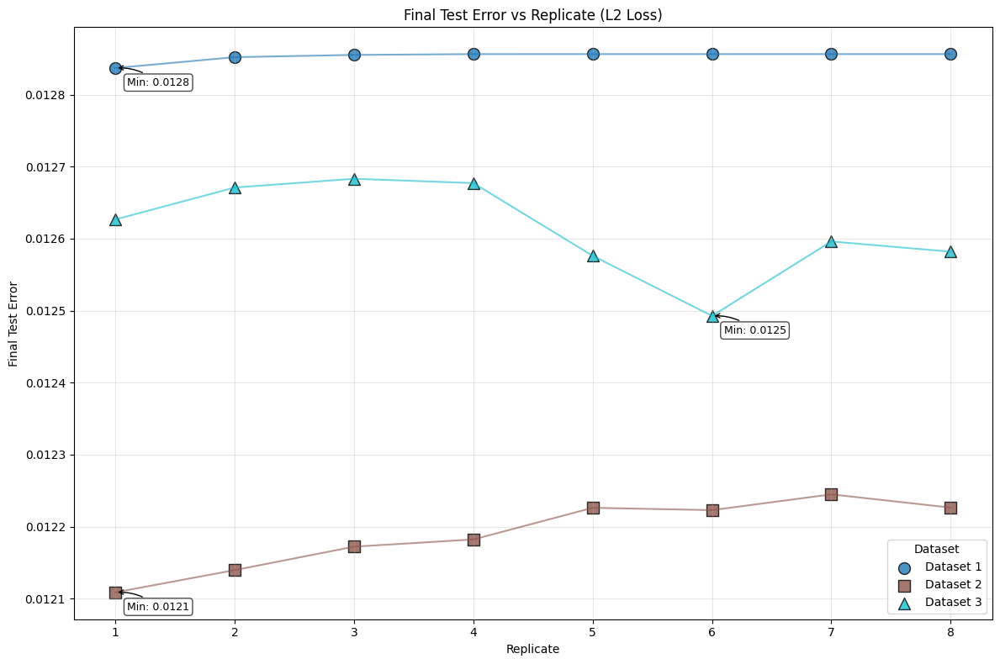

In [49]:

# Example usage:
# For MAE + Max Entropy optimization with parameter sweep of the weight multiplier
# The parameter values are 5, 10, 15, 20, 25 (based on 1/(j+1) in the code)
param_values = [np.exp((j+1)) for j in range(n_replicates)]

# Plot for the original L2 loss results
fig1 = plot_final_test_error_vs_param(
    test_losses, 
    n_seeds, 
    n_replicates,
    param_values=list(range(1, n_replicates + 1)),
    title="Final Test Error vs Replicate (L2 Loss)",
    param_name="Replicate"
)
plt.show()


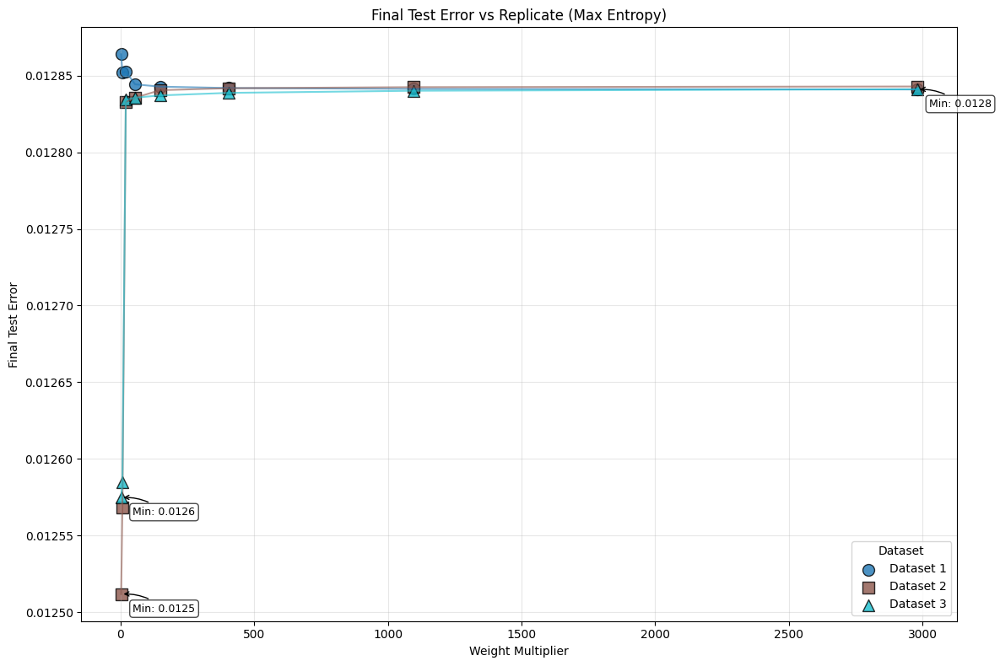

In [50]:

# Plot for Max Entropy results
fig2 = plot_final_test_error_vs_param(
    me_test_losses, 
    n_seeds, 
    n_replicates,
    param_values=param_values,
    title="Final Test Error vs Replicate (Max Entropy)",
    param_name="Weight Multiplier"
)
plt.show()


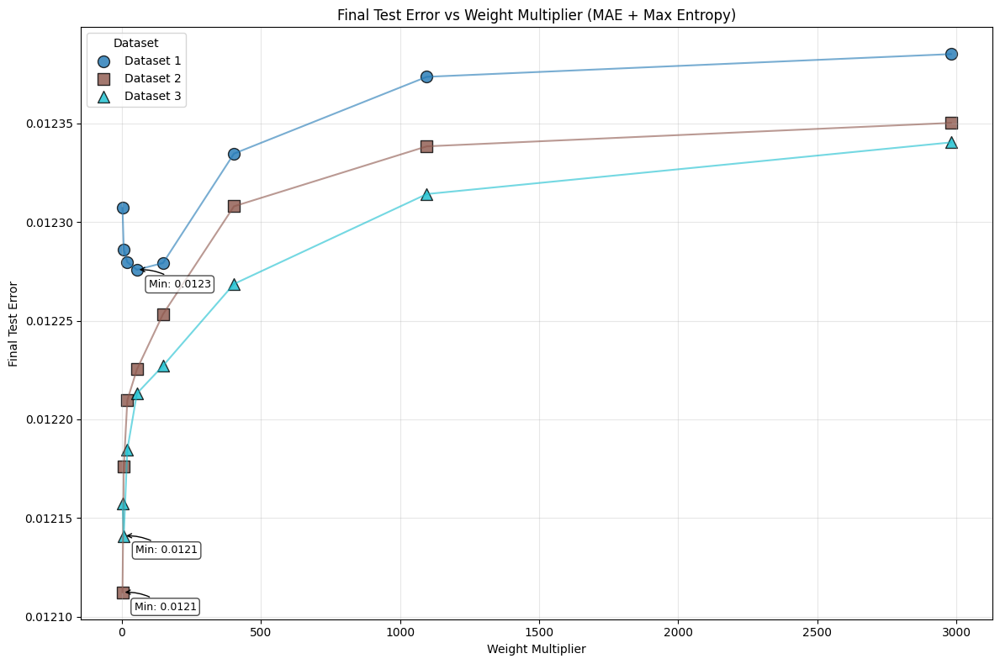

In [51]:

# Plot for MAE + Max Entropy results with parameter sweep
fig3 = plot_final_test_error_vs_param(
    mre_me_test_losses, 
    n_seeds, 
    n_replicates,
    param_values=param_values,
    title="Final Test Error vs Weight Multiplier (MAE + Max Entropy)",
    param_name="Weight Multiplier"
)
plt.show()


In [52]:

# You can also create a combined plot for all three methods:
def plot_combined_final_errors(test_losses_dict, n_seeds, n_replicates, param_values=None, 
                              method_names=None, title="Comparison of Final Test Errors"):
    """
    Creates a combined plot of final test errors for multiple optimization methods.
    
    Parameters:
    -----------
    test_losses_dict : dict
        Dictionary of test losses dictionaries for each method
    n_seeds : int
        Number of seeds (datasets)
    n_replicates : int
        Number of replicates per seed
    param_values : list, optional
        List of parameter values corresponding to each replicate.
        If None, uses replicate index as x-axis.
    method_names : list, optional
        List of method names for the legend
    title : str, optional
        Plot title
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The plot figure
    """
    import numpy as np
    import matplotlib.pyplot as plt
    
    # Create figure
    plt.figure(figsize=(14, 10))
    
    # If param_values not provided, use replicate indices
    if param_values is None:
        param_values = list(range(1, n_replicates + 1))
    
    # If method_names not provided, use default names
    if method_names is None:
        method_names = [f"Method {i+1}" for i in range(len(test_losses_dict))]
    
    # Define colors and markers for methods and seeds
    method_colors = plt.cm.viridis(np.linspace(0, 1, len(test_losses_dict)))
    seed_markers = ['o', 's', '^', 'D', 'v', 'p', '*', 'h', 'x', '+']
    
    # Track min and max for y-axis scaling
    min_error = float('inf')
    max_error = 0
    
    # Plot the data for each method and seed
    for method_idx, (method_name, test_losses) in enumerate(zip(method_names, test_losses_dict.values())):
        method_color = method_colors[method_idx]
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            marker = seed_markers[seed_idx % len(seed_markers)]
            
            # Extract final errors for this seed and method
            final_errors = []
            for rep_idx in range(n_replicates):
                if seed_key in test_losses and rep_idx < len(test_losses[seed_key]) and test_losses[seed_key][rep_idx] is not None:
                    # Get the final test loss for this replicate
                    final_error = test_losses[seed_key][rep_idx][-1]
                    final_errors.append(final_error)
                    
                    # Update min and max for y-axis scaling
                    min_error = min(min_error, final_error)
                    max_error = max(max_error, final_error)
                else:
                    # Handle missing data
                    final_errors.append(np.nan)
            
            # Create scatter plot for this dataset and method
            label = f"{method_name}, Dataset {seed_idx+1}" if method_idx == 0 else None
            scatter = plt.scatter(
                param_values[:len(final_errors)], 
                final_errors,
                color=method_color,
                marker=marker,
                s=80,
                alpha=0.8,
                edgecolors='black',
                label=label
            )
            
            # Add connecting lines
            line_style = ['-', '--', '-.', ':'][method_idx % 4]
            plt.plot(
                param_values[:len(final_errors)], 
                final_errors,
                color=method_color,
                alpha=0.6,
                linestyle=line_style
            )
    
    # Create custom legend for methods and seeds
    from matplotlib.lines import Line2D
    
    # Create legend handles for methods
    method_handles = [Line2D([0], [0], color=method_colors[i], lw=2, label=name) 
                    for i, name in enumerate(method_names)]
    
    # Create legend handles for seeds
    seed_handles = [Line2D([0], [0], marker=seed_markers[i], color='gray', 
                          linestyle='None', markersize=8, label=f"Dataset {i+1}") 
                    for i in range(n_seeds)]
    
    # Add legends
    method_legend = plt.legend(handles=method_handles, title="Method", loc='upper left')
    plt.gca().add_artist(method_legend)
    plt.legend(handles=seed_handles, title="Dataset", loc='upper right')
    
    # Customize the plot
    plt.xlabel("Parameter Value / Replicate")
    plt.ylabel("Final Test Error")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    # Add 5% padding to y-axis
    y_range = max_error - min_error
    plt.ylim(min_error - 0.05 * y_range, max_error + 0.05 * y_range)
    
    plt.tight_layout()
    
    return plt.gcf()

# Example usage of the combined plot
test_losses_dict = {
    "L2 Loss": test_losses,
    "Max Entropy": me_test_losses,
    "MAE + Max Entropy": mre_me_test_losses
}


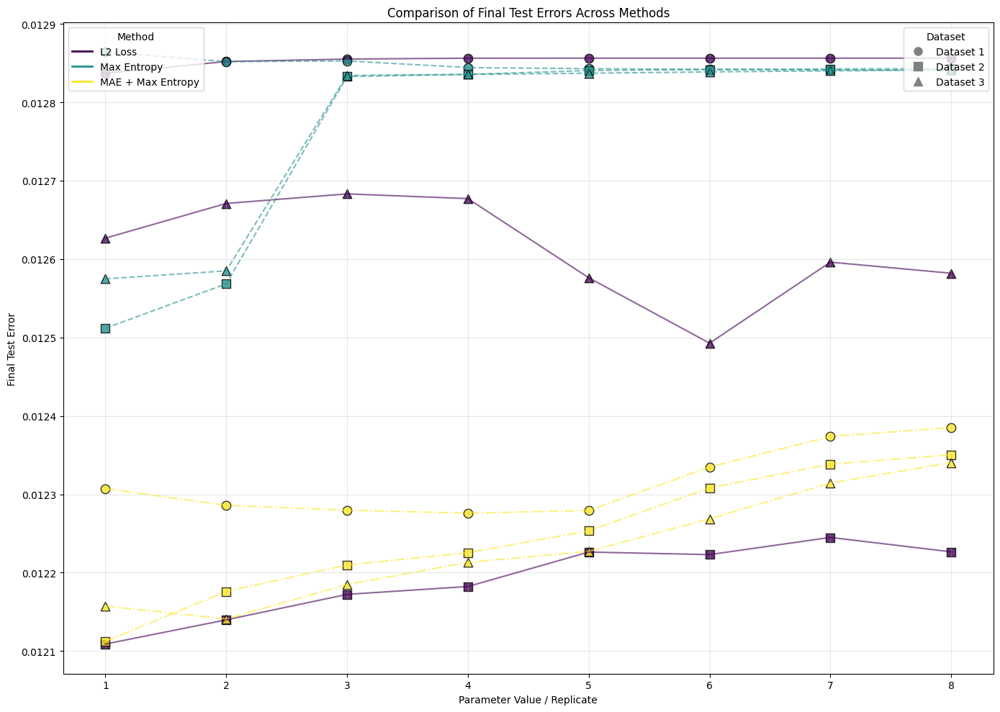

In [53]:

method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy"]

combined_fig = plot_combined_final_errors(
    test_losses_dict,
    n_seeds,
    n_replicates,
    param_values=list(range(1, n_replicates + 1)),
    method_names=method_names,
    title="Comparison of Final Test Errors Across Methods"
)
plt.show()

In [54]:
def HDXer_loadweights_plot_final_test_error_vs_param(simulation, datasets, hdxer_dir, gamma_values=None, n_seeds=5, title="HDXer Test Error vs Gamma Parameter"):
    """
    Loads HDXer weights, computes test loss, and plots them against gamma parameters.
    
    Parameters:
    -----------
    simulation : Simulation
        Simulation object for forward model evaluation
    datasets : list
        List of dataset objects
    hdxer_dir : str
        Directory path to HDXer results
    gamma_values : list, optional
        List of gamma values to analyze. If None, defaults to [1, 2, 3, 4, 5, 6, 7]
    n_seeds : int, optional
        Number of dataset seeds to analyze. Default is 5.
    title : str, optional
        Plot title
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The plot figure
    test_losses : dict
        Dictionary of computed test losses for each seed and gamma value
    """
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.colors as mcolors
    import os
    from matplotlib.markers import MarkerStyle
    
    # Default gamma values if not provided
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    # Initialize dictionary to store test losses
    test_losses = {}
    
    # Loop through seeds
    for seed_idx in range(1, n_seeds + 1):
        seed_key = f'seed_{seed_idx-1}'  # Match your existing seed keys
        test_losses[seed_key] = []
        
        for gamma in gamma_values:
            try:
                # Construct path to HDXer weights file
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                # Load weights from file
                weights = np.loadtxt(weights_file)
                
                # Normalize weights if needed
                weights = weights / np.sum(weights)
                
                # Create simulation params with HDXer weights
                trajectory_length = len(weights)
                hdxer_params = Simulation_Parameters(
                    frame_weights=jnp.array(weights),
                    frame_mask=simulation.params.frame_mask[:trajectory_length],
                    model_parameters=simulation.params.model_parameters,
                    forward_model_weights=simulation.params.forward_model_weights,
                    forward_model_scaling=simulation.params.forward_model_scaling,
                    normalise_loss_functions=simulation.params.normalise_loss_functions
                )
                
                # Create a new simulation with the HDXer weights
                hdxer_sim = Simulation(
                    forward_models=simulation.forward_models,
                    input_features=simulation.input_features,
                    params=hdxer_params
                )
                hdxer_sim.initialise()
                
                # Forward pass with HDXer weights
                hdxer_sim.forward(hdxer_params)
                
                # Extract test data
                test_data = datasets[seed_idx-1].test
                
                # Get predictions
                predictions = hdxer_sim.outputs[0]
                
                # Calculate loss for multiple timepoints
                total_loss = 0.0
                num_timepoints = test_data.y_true.shape[0]
                
                # Iterate over timepoints
                for timepoint_idx in range(num_timepoints):
                    # Get the true uptake for this timepoint
                    true_uptake_timepoint = test_data.y_true[timepoint_idx, :]
                    
                    # Get the predicted uptake for this timepoint
                    pred_uptake_timepoint = predictions.uptake[timepoint_idx]
                    
                    # Apply sparse mapping to predicted uptake
                    pred_mapped = apply_sparse_mapping(
                        test_data.residue_feature_ouput_mapping, 
                        pred_uptake_timepoint
                    )
                    
                    # Compute L2 loss for this timepoint
                    timepoint_loss = jnp.mean((pred_mapped - true_uptake_timepoint) ** 2)
                    
                    # Accumulate loss
                    total_loss += timepoint_loss
                
                # Average loss across timepoints
                test_loss = total_loss / num_timepoints
                
                # Count unique residues in the test set
                test_residues = set()
                for data in test_data.data:
                    for r in data.top.extract_residues():
                        test_residues.add(r.residue_start)
                
                # Compute average loss per residue
                residue_avg_loss = test_loss / len(test_residues)
                
                # Store the per-residue average test loss
                test_losses[seed_key].append(residue_avg_loss)
                
                print(f"Processed seed {seed_idx}, gamma {gamma}: Loss = {residue_avg_loss}")
                
            except Exception as e:
                print(f"Error processing seed {seed_idx}, gamma {gamma}: {e}")
                test_losses[seed_key].append(np.nan)
    
    # Create plot similar to plot_final_test_error_vs_param
    plt.figure(figsize=(12, 8))
    
    # Define markers and colors
    markers = ['o', 's', '^', 'D', 'v']
    base_colors = plt.cm.tab10(np.linspace(0, 1, n_seeds))
    
    # Track min and max for y-axis scaling
    min_error = float('inf')
    max_error = 0
    
    # Plot the data
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        color = base_colors[seed_idx]
        marker = markers[seed_idx % len(markers)]
        
        # Filter out NaN values for plotting
        errors = np.array(test_losses[seed_key])
        valid_indices = ~np.isnan(errors)
        
        valid_gammas = [gamma_values[i] for i in range(len(gamma_values)) if valid_indices[i]]
        valid_errors = errors[valid_indices]
        
        if len(valid_errors) > 0:
            min_error = min(min_error, np.min(valid_errors))
            max_error = max(max_error, np.max(valid_errors))
        
        # Create scatter plot for this dataset
        scatter = plt.scatter(
            valid_gammas, 
            valid_errors,
            color=color,
            marker=marker,
            s=100,
            alpha=0.8,
            edgecolors='black',
            label=f"Dataset {seed_idx+1}"
        )
        
        # Add connecting lines
        plt.plot(
            valid_gammas, 
            valid_errors,
            color=color,
            alpha=0.6,
            linestyle='-'
        )
    
    # Add annotations for minimum error points
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        errors = np.array(test_losses[seed_key])
        valid_indices = ~np.isnan(errors)
        
        if np.any(valid_indices):
            min_idx = np.nanargmin(errors)
            min_val = errors[min_idx]
            min_gamma = gamma_values[min_idx]
            
            plt.annotate(
                f'Min: {min_val:.4f}',
                xy=(min_gamma, min_val),
                xytext=(10, -15),
                textcoords='offset points',
                fontsize=9,
                bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.7),
                arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.2')
            )
    
    # Customize the plot
    plt.xlabel("Gamma Parameter Value")
    plt.ylabel("Residue-Average Test Loss")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    # Add legend
    plt.legend(title="Dataset", loc='best')
    
    # Ensure y-axis has reasonable limits
    if min_error != float('inf') and max_error != 0:
        y_range = max_error - min_error
        plt.ylim(min_error - 0.05 * y_range, max_error + 0.05 * y_range)
    
    plt.tight_layout()
    
    return plt.gcf(), test_losses

Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Processed seed 1, gamma 1: Loss = 0.012592179700732231
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Processed seed 1, gamma 2: Loss = 0.012575180269777775
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Processed seed 1, gamma 3: Loss = 0.012565669603645802
Loaded forward passes
(<jaxent.src.models.HDX.forward.BV_uptake_ForwardPass object at 0x13c5620d0>,)
Simulation initialised successfully.









 JIT compilation successful 









Processed seed 1, gamma 4: Loss = 0.01256070751696825
Loaded forward passes
(<jaxent.src.models

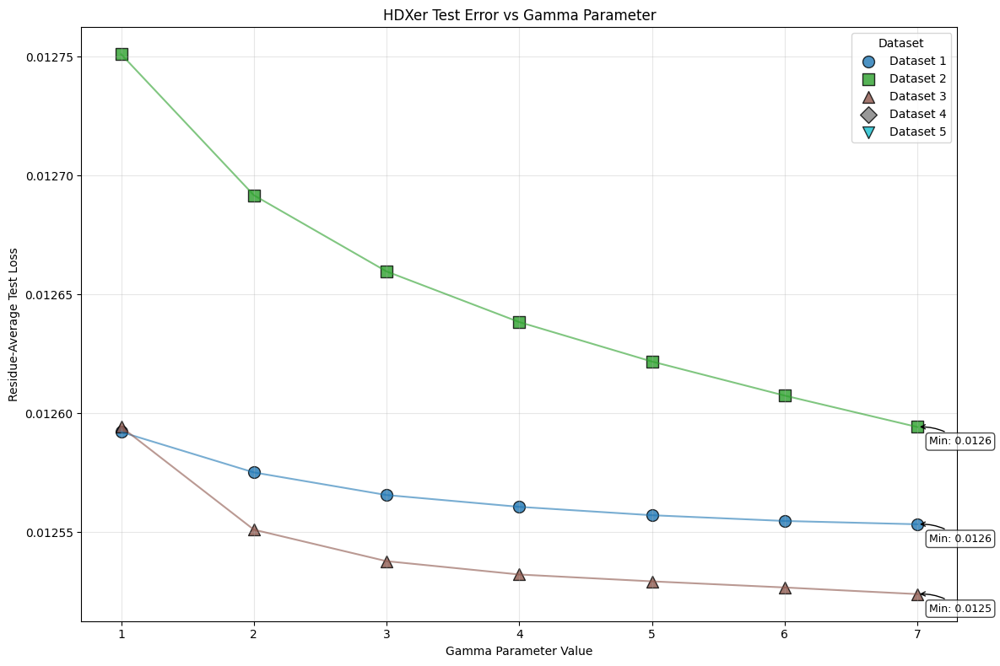

In [55]:
# load in HDXer weights 
hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
fig, hdxer_losses = HDXer_loadweights_plot_final_test_error_vs_param(simulation, datasets, hdxer_dir)
plt.show()


In [56]:
def plot_combined_final_errors_with_hdxer(test_losses_dict, hdxer_losses, n_seeds, gamma_values=None,
                                         method_names=None, title="Comparison with HDXer"):
    """
    Creates a combined plot of final test errors comparing your methods with HDXer.
    
    Parameters:
    -----------
    test_losses_dict : dict
        Dictionary of test losses dictionaries for each of your methods
    hdxer_losses : dict
        Dictionary of HDXer test losses from HDXer_loadweights_plot_final_test_error_vs_param
    n_seeds : int
        Number of seeds (datasets)
    gamma_values : list, optional
        List of gamma values for HDXer x-axis
    method_names : list, optional
        List of method names for the legend
    title : str, optional
        Plot title
    """
    import numpy as np
    import matplotlib.pyplot as plt
    
    # Create figure
    plt.figure(figsize=(14, 20))
    
    # If gamma_values not provided, use default
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    # If method_names not provided, use default names
    if method_names is None:
        method_names = [f"Method {i+1}" for i in range(len(test_losses_dict))] + ["HDXer"]
    else:
        method_names = method_names + ["HDXer"]
    
    # Define colors for methods and markers for seeds
    all_methods = list(test_losses_dict.values()) + [hdxer_losses]
    method_colors = plt.cm.viridis(np.linspace(0, 1, len(all_methods)))
    seed_markers = ['o', 's', '^', 'D', 'v']
    
    # Track min and max for y-axis scaling
    min_error = float('inf')
    max_error = 0
    
    # Plot your methods first
    for method_idx, (method_name, test_losses) in enumerate(zip(method_names[:-1], test_losses_dict.values())):
        method_color = method_colors[method_idx]
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            marker = seed_markers[seed_idx % len(seed_markers)]
            
            # For your methods, plot at equal spacing on left side
            x_positions = np.arange(1, len(test_losses[seed_key])+1)
            
            # Extract the final losses
            final_errors = []
            for rep_idx in range(len(test_losses[seed_key])):
                if test_losses[seed_key][rep_idx] is not None:
                    final_error = test_losses[seed_key][rep_idx][-1]  # Get last value
                    final_errors.append(final_error)
                    
                    min_error = min(min_error, final_error)
                    max_error = max(max_error, final_error)
                else:
                    final_errors.append(np.nan)
            
            # Create scatter plot for this dataset and method
            label = f"{method_name}, Dataset {seed_idx+1}" if method_idx == 0 else None
            scatter = plt.scatter(
                x_positions, 
                final_errors,
                color=method_color,
                marker=marker,
                s=80,
                alpha=0.8,
                edgecolors='black',
                label=label
            )
            
            # Add connecting lines
            line_style = ['-', '--', '-.', ':'][method_idx % 4]
            plt.plot(
                x_positions, 
                final_errors,
                color=method_color,
                alpha=0.6,
                linestyle=line_style
            )
    
    # Now plot HDXer results
    hdxer_idx = len(method_names) - 1
    hdxer_color = method_colors[hdxer_idx]
    
    # Offset HDXer x positions to right side
    offset = len(gamma_values) + 2  # Gap between your methods and HDXer
    
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        marker = seed_markers[seed_idx % len(seed_markers)]
        
        # Filter out NaN values for plotting
        errors = np.array(hdxer_losses[seed_key])
        valid_indices = ~np.isnan(errors)
        
        valid_gammas = [gamma_values[i] + offset for i in range(len(gamma_values)) if valid_indices[i]]
        valid_errors = errors[valid_indices]
        
        if len(valid_errors) > 0:
            min_error = min(min_error, np.min(valid_errors))
            max_error = max(max_error, np.max(valid_errors))
        
        # Create scatter plot for HDXer
        label = f"HDXer, Dataset {seed_idx+1}" if seed_idx == 0 else None
        scatter = plt.scatter(
            valid_gammas, 
            valid_errors,
            color=hdxer_color,
            marker=marker,
            s=80,
            alpha=0.8,
            edgecolors='black',
            label=label
        )
        
        # Add connecting lines
        plt.plot(
            valid_gammas, 
            valid_errors,
            color=hdxer_color,
            alpha=0.6,
            linestyle='-'
        )
    
    # Create custom legend handles
    from matplotlib.lines import Line2D
    
    # Create legend handles for methods
    method_handles = [Line2D([0], [0], color=method_colors[i], lw=2, label=name) 
                     for i, name in enumerate(method_names)]
    
    # Create legend handles for seeds
    seed_handles = [Line2D([0], [0], marker=seed_markers[i], color='gray', 
                          linestyle='None', markersize=8, label=f"Dataset {i+1}") 
                   for i in range(n_seeds)]
    
    # Add legends
    method_legend = plt.legend(handles=method_handles, title="Method", loc='upper left')
    plt.gca().add_artist(method_legend)
    plt.legend(handles=seed_handles, title="Dataset", loc='upper right')
    
    # Customize x-axis ticks and labels
    x_ticks = list(range(1, max(len(test_losses[seed_key]) for seed_key in test_losses) + 1))
    x_ticks += [g + offset for g in gamma_values]
    x_labels = [str(i) for i in range(1, len(x_ticks) - len(gamma_values) + 1)]
    x_labels += [str(g) for g in gamma_values]
    
    plt.xticks(x_ticks, x_labels)
    
    # Add vertical separator
    plt.axvline(x=offset-1, color='gray', linestyle='--', alpha=0.5)
    
    # Add group labels
    plt.text(np.mean(range(1, len(x_ticks) - len(gamma_values) + 1)), 
             max_error * 1.05, 
             "Your Methods (Replicate #)", 
             ha='center')
    
    plt.text(np.mean([g + offset for g in gamma_values]), 
             max_error * 1.05, 
             "HDXer (Gamma Value)", 
             ha='center')
    
    # Customize the plot
    plt.xlabel("Parameter Value / Gamma")
    plt.ylabel("Residue-Average Test Loss")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    # Add 5% padding to y-axis
    y_range = max_error - min_error
    # plt.ylim(0, max_error + 0.5 * y_range)
    
    plt.tight_layout()
    
    return plt.gcf()

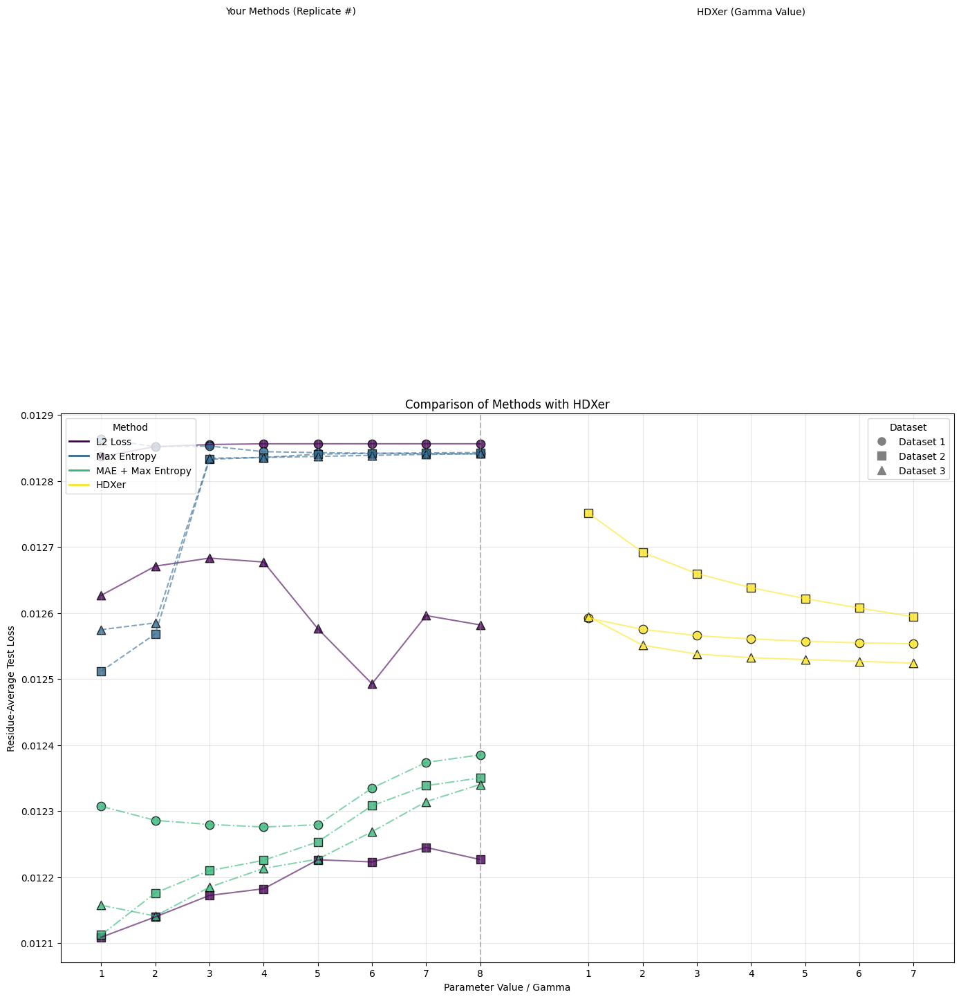

In [ ]:
# First, get all your test losses in a dictionary
test_losses_dict = {
    "L2 Loss": test_losses,
    "Max Entropy": me_test_losses,
    "MAE + Max Entropy": mre_me_test_losses
}

# # Get HDXer losses
# hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
# _, hdxer_losses = HDXer_loadweights_plot_final_test_error_vs_param(simulation, datasets, hdxer_dir, 
#                                                                  gamma_values=[1, 2, 3, 4, 5, 6, 7])

# Create the combined plot
method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy"]
combined_fig = plot_combined_final_errors_with_hdxer(
    test_losses_dict,
    hdxer_losses,
    n_seeds=3,                                                                                                                           
    gamma_values=[1, 2, 3, 4, 5, 6, 7],
    method_names=method_names,
    title="Comparison of Methods with HDXer"
)
plt.show()

In [58]:
def plot_combined_min_errors_with_hdxer(test_losses_dict, hdxer_losses, n_seeds, gamma_values=None,
                                         method_names=None, title="Comparison of Minimum Test Errors with HDXer"):
    """
    Creates a combined plot of minimum test errors (best performance during optimization) 
    for each method compared with HDXer.
    
    Parameters:
    -----------
    test_losses_dict : dict
        Dictionary of test losses dictionaries for each of your methods
    hdxer_losses : dict
        Dictionary of HDXer test losses from HDXer_loadweights_plot_final_test_error_vs_param
    n_seeds : int
        Number of seeds (datasets)
    gamma_values : list, optional
        List of gamma values for HDXer x-axis
    method_names : list, optional
        List of method names for the legend
    title : str, optional
        Plot title
    """
    import numpy as np
    import matplotlib.pyplot as plt
    
    # Create figure
    plt.figure(figsize=(14, 20))
    
    # If gamma_values not provided, use default
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    # If method_names not provided, use default names
    if method_names is None:
        method_names = [f"Method {i+1}" for i in range(len(test_losses_dict))] + ["HDXer"]
    else:
        method_names = method_names + ["HDXer"]
    
    # Define colors for methods and markers for seeds
    all_methods = list(test_losses_dict.values()) + [hdxer_losses]
    method_colors = plt.cm.viridis(np.linspace(0, 1, len(all_methods)))
    seed_markers = ['o', 's', '^', 'D', 'v']
    
    # Track min and max for y-axis scaling
    min_error = float('inf')
    max_error = 0
    
    # Plot your methods first
    for method_idx, (method_name, test_losses) in enumerate(zip(method_names[:-1], test_losses_dict.values())):
        method_color = method_colors[method_idx]
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            marker = seed_markers[seed_idx % len(seed_markers)]
            
            # For your methods, plot at equal spacing on left side
            x_positions = np.arange(1, len(test_losses[seed_key])+1)
            
            # Extract the minimum losses from each optimization history
            min_errors = []
            for rep_idx in range(len(test_losses[seed_key])):
                if test_losses[seed_key][rep_idx] is not None:
                    # Find the minimum loss in the entire optimization history
                    min_error_value = np.min(test_losses[seed_key][rep_idx])
                    min_errors.append(min_error_value)
                    
                    min_error = min(min_error, min_error_value)
                    max_error = max(max_error, min_error_value)
                else:
                    min_errors.append(np.nan)
            
            # Create scatter plot for this dataset and method
            label = f"{method_name}, Dataset {seed_idx+1}" if method_idx == 0 else None
            scatter = plt.scatter(
                x_positions, 
                min_errors,
                color=method_color,
                marker=marker,
                s=80,
                alpha=0.8,
                edgecolors='black',
                label=label
            )
            
            # Add connecting lines
            line_style = ['-', '--', '-.', ':'][method_idx % 4]
            plt.plot(
                x_positions, 
                min_errors,
                color=method_color,
                alpha=0.6,
                linestyle=line_style
            )
    
    # Now plot HDXer results (HDXer losses are already final values, not histories)
    hdxer_idx = len(method_names) - 1
    hdxer_color = method_colors[hdxer_idx]
    
    # Offset HDXer x positions to right side
    offset = len(gamma_values) + 2  # Gap between your methods and HDXer
    
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        marker = seed_markers[seed_idx % len(seed_markers)]
        
        # Filter out NaN values for plotting
        errors = np.array(hdxer_losses[seed_key])
        valid_indices = ~np.isnan(errors)
        
        valid_gammas = [gamma_values[i] + offset for i in range(len(gamma_values)) if valid_indices[i]]
        valid_errors = errors[valid_indices]
        
        if len(valid_errors) > 0:
            min_error = min(min_error, np.min(valid_errors))
            max_error = max(max_error, np.max(valid_errors))
        
        # Create scatter plot for HDXer
        label = f"HDXer, Dataset {seed_idx+1}" if seed_idx == 0 else None
        scatter = plt.scatter(
            valid_gammas, 
            valid_errors,
            color=hdxer_color,
            marker=marker,
            s=80,
            alpha=0.8,
            edgecolors='black',
            label=label
        )
        
        # Add connecting lines
        plt.plot(
            valid_gammas, 
            valid_errors,
            color=hdxer_color,
            alpha=0.6,
            linestyle='-'
        )
    
    # Create custom legend handles
    from matplotlib.lines import Line2D
    
    # Create legend handles for methods
    method_handles = [Line2D([0], [0], color=method_colors[i], lw=2, label=name) 
                     for i, name in enumerate(method_names)]
    
    # Create legend handles for seeds
    seed_handles = [Line2D([0], [0], marker=seed_markers[i], color='gray', 
                          linestyle='None', markersize=8, label=f"Dataset {i+1}") 
                   for i in range(n_seeds)]
    
    # Add legends
    method_legend = plt.legend(handles=method_handles, title="Method", loc='upper left')
    plt.gca().add_artist(method_legend)
    plt.legend(handles=seed_handles, title="Dataset", loc='upper right')
    
    # Customize x-axis ticks and labels
    x_ticks = list(range(1, max(len(test_losses[seed_key]) for seed_key in test_losses) + 1))
    x_ticks += [g + offset for g in gamma_values]
    x_labels = [str(i) for i in range(1, len(x_ticks) - len(gamma_values) + 1)]
    x_labels += [str(g) for g in gamma_values]
    
    plt.xticks(x_ticks, x_labels)
    
    # Add vertical separator
    plt.axvline(x=offset-1, color='gray', linestyle='--', alpha=0.5)
    
    # Add group labels
    plt.text(np.mean(range(1, len(x_ticks) - len(gamma_values) + 1)), 
             max_error * 1.05, 
             "Your Methods (Replicate #)", 
             ha='center')
    
    plt.text(np.mean([g + offset for g in gamma_values]), 
             max_error * 1.05, 
             "HDXer (Gamma Value)", 
             ha='center')
    
    # Customize the plot
    plt.xlabel("Parameter Value / Gamma")
    plt.ylabel("Minimum Residue-Average Test Loss")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    # Add 5% padding to y-axis
    y_range = max_error - min_error
    plt.ylim(min_error - 0.05 * y_range, max_error + 0.05 * y_range)
    
    plt.tight_layout()
    
    return plt.gcf()

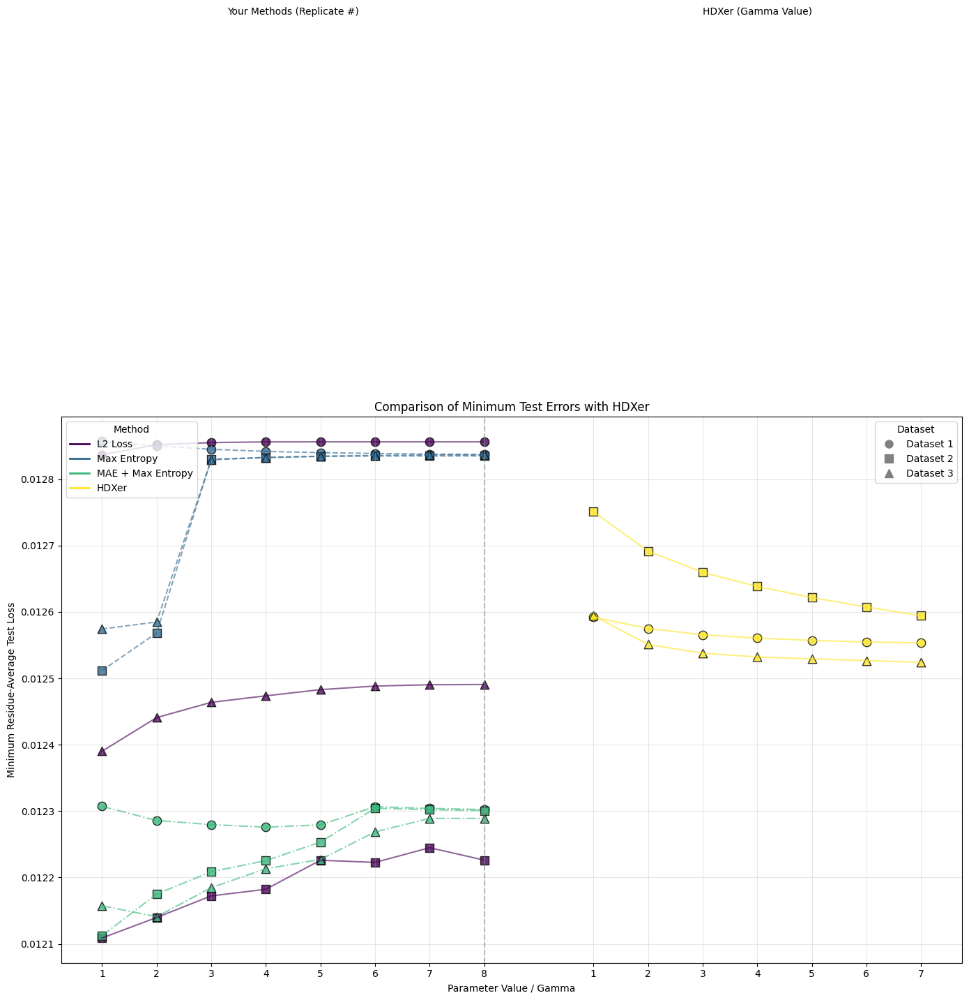

In [59]:
# First, get all your test losses in a dictionary
test_losses_dict = {
    "L2 Loss": test_losses,
    "Max Entropy": me_test_losses,
    "MAE + Max Entropy": mre_me_test_losses
}

# # Get HDXer losses
# hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
# _, hdxer_losses = HDXer_loadweights_plot_final_test_error_vs_param(simulation, datasets, hdxer_dir, 
#                                                                  gamma_values=[1, 2, 3, 4, 5, 6, 7])
# Example usage with your existing data
min_errors_fig = plot_combined_min_errors_with_hdxer(
    test_losses_dict,
    hdxer_losses,
    n_seeds=3,
    gamma_values=[1, 2, 3, 4, 5, 6, 7],
    method_names=["L2 Loss", "Max Entropy", "MAE + Max Entropy"],
    title="Comparison of Minimum Test Errors with HDXer"
)
plt.show()

In [60]:
# measure the KL divergence between different sets of weights
# First: measure dataset variability across replicates - measure the KL divergece between the weights of different seeds. For both jaxENT and HDXer


Extracting weights from optimization results...
Extracting HDXer weights...
Creating combined weights dictionary...
Computing pairwise KL divergences...
Creating visualization...


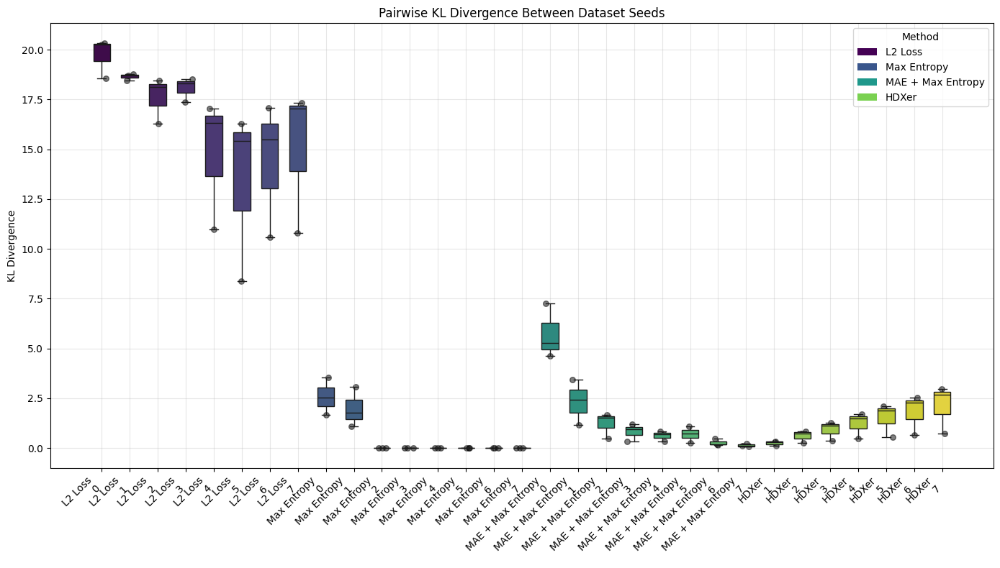

In [90]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import itertools
from scipy.stats import entropy
import jax.numpy as jnp

def kl_divergence(p, q):
    """
    Calculate the KL divergence between two probability distributions.
    Adds small epsilon to avoid division by zero.
    """
    epsilon = 1e-10
    p = np.array(p) + epsilon
    q = np.array(q) + epsilon
    
    # Normalize to ensure they are probability distributions
    p = p / np.sum(p)
    q = q / np.sum(q)
    
    return entropy(p, q)

def compute_pairwise_kl_divergences(weights_dict):
    """
    Compute pairwise KL divergences between all pairs of seeds for each method and parameter.
    
    Parameters:
    -----------
    weights_dict : dict
        Nested dictionary with structure:
        {method_name: {parameter_value: {seed_key: weights_array}}}
    
    Returns:
    --------
    kl_results : dict
        Dictionary with KL divergences grouped by method and parameter
        {method_name: {parameter_value: [kl_values]}}
    """
    kl_results = {}
    
    for method, param_dict in weights_dict.items():
        kl_results[method] = {}
        
        for param, seed_dict in param_dict.items():
            # Get all seed keys
            seed_keys = list(seed_dict.keys())
            
            # Compute all pairwise KL divergences
            kl_values = []
            for seed1, seed2 in itertools.combinations(seed_keys, 2):
                weights1 = seed_dict[seed1]
                weights2 = seed_dict[seed2]
                
                # Skip if either weights array is None
                if weights1 is None or weights2 is None:
                    continue
                    
                # If weights arrays have different lengths, truncate to the shorter one
                min_length = min(len(weights1), len(weights2))
                w1 = weights1[:min_length]
                w2 = weights2[:min_length]
                
                # Calculate KL divergence in both directions (as it's asymmetric)
                kl_1_to_2 = kl_divergence(w1, w2)
                kl_2_to_1 = kl_divergence(w2, w1)
                
                # Use average of both directions
                avg_kl = (kl_1_to_2 + kl_2_to_1) / 2
                kl_values.append(avg_kl)
            
            kl_results[method][param] = kl_values
    
    return kl_results

def extract_weights_from_optimization_results(opt_results, n_seeds, n_replicates):
    """
    Extract final frame weights from optimization results.
    
    Parameters:
    -----------
    opt_results : dict
        Dictionary with optimization results from run_optimization_replicates
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates
    
    Returns:
    --------
    weights_dict : dict
        Dictionary with structure {replicate_idx: {seed_key: weights_array}}
    """
    weights_dict = {}
    
    # Initialize weights dictionary
    for rep_idx in range(n_replicates):
        weights_dict[rep_idx] = {}
    
    # Extract weights for each seed and replicate
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        
        if seed_key in opt_results:
            for rep_idx, rep_result in enumerate(opt_results[seed_key]):
                if rep_idx >= n_replicates:
                    break
                    
                try:
                    # Check if the result exists
                    if rep_result is not None:
                        # Extract the simulation and history
                        sim, history = rep_result
                        
                        if hasattr(history, 'states') and len(history.states) > 0:
                            # Get the final state
                            final_state = history.states[-1]
                            
                            if hasattr(final_state, 'params'):
                                # Extract weights and apply mask
                                frame_weights = final_state.params.frame_weights
                                frame_mask = final_state.params.frame_mask
                                
                                # Convert to numpy array
                                if hasattr(frame_weights, 'shape'):
                                    masked_weights = np.array(frame_weights * frame_mask)
                                    weights_dict[rep_idx][seed_key] = masked_weights
                                else:
                                    print(f"Invalid frame weights for seed {seed_idx}, replicate {rep_idx}")
                                    weights_dict[rep_idx][seed_key] = None
                            else:
                                print(f"No params attribute in state for seed {seed_idx}, replicate {rep_idx}")
                                weights_dict[rep_idx][seed_key] = None
                        else:
                            print(f"No valid states in history for seed {seed_idx}, replicate {rep_idx}")
                            weights_dict[rep_idx][seed_key] = None
                    else:
                        print(f"Null result for seed {seed_idx}, replicate {rep_idx}")
                        weights_dict[rep_idx][seed_key] = None
                except Exception as e:
                    print(f"Error extracting weights for seed {seed_idx}, replicate {rep_idx}: {e}")
                    weights_dict[rep_idx][seed_key] = None
                    
    return weights_dict

def extract_hdxer_weights(hdxer_dir, n_seeds, gamma_values):
    """
    Extract HDXer weights from files.
    
    Parameters:
    -----------
    hdxer_dir : str
        Directory containing HDXer weight files
    n_seeds : int
        Number of seeds
    gamma_values : list
        List of gamma values
    
    Returns:
    --------
    weights_dict : dict
        Dictionary with structure {gamma_value: {seed_key: weights_array}}
    """
    weights_dict = {}
    
    for gamma in gamma_values:
        weights_dict[gamma] = {}
        
        for seed_idx in range(1, n_seeds + 1):
            seed_key = f'seed_{seed_idx-1}'
            
            try:
                # Construct path to HDXer weights file
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                # Check if file exists
                if os.path.exists(weights_file):
                    # Load weights from file
                    weights = np.loadtxt(weights_file)
                    
                    # Normalize weights
                    weights = weights / np.sum(weights)
                    
                    # Store the weights
                    weights_dict[gamma][seed_key] = weights
                else:
                    print(f"HDXer weights file not found: {weights_file}")
                    weights_dict[gamma][seed_key] = None
            except Exception as e:
                print(f"Error loading HDXer weights for seed {seed_idx}, gamma {gamma}: {e}")
                weights_dict[gamma][seed_key] = None
    
    return weights_dict

def extract_final_state_weights(simulation, dataset_seed, history_state):
    """
    Extract weights from a simulation state.
    
    Parameters:
    -----------
    simulation : object
        Simulation object
    dataset_seed : int
        Dataset seed index
    history_state : object
        History state object containing parameters
    
    Returns:
    --------
    weights : array
        Extracted weights
    """
    try:
        # Reconstruct the params from the history state
        frame_weights = history_state.params.frame_weights
        frame_mask = history_state.params.frame_mask
        masked_weights = np.array(frame_weights * frame_mask)
        return masked_weights
    except Exception as e:
        print(f"Error extracting weights from state for seed {dataset_seed}: {e}")
        return None

def plot_kl_divergence_boxplots(kl_results, method_names=None, title="Pairwise KL Divergence Between Seeds"):
    """
    Create box plots of pairwise KL divergences between seeds.
    
    Parameters:
    -----------
    kl_results : dict
        Dictionary with KL divergences grouped by method and parameter
    method_names : list, optional
        List of method names for the legend
    title : str, optional
        Plot title
    
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The box plot figure
    """
    # Create figure
    plt.figure(figsize=(14, 8))
    
    # Prepare data for boxplot
    all_data = []
    all_labels = []
    all_method_labels = []
    method_param_count = {}
    
    # Count parameters for each method
    for method, param_dict in kl_results.items():
        valid_params = [p for p, vals in param_dict.items() if vals]
        method_param_count[method] = len(valid_params)
    
    # Count total number of valid parameters
    total_valid_params = sum(method_param_count.values())
    
    # Define colors for methods
    method_colors = plt.cm.viridis(np.linspace(0, 1, max(total_valid_params, 1)))
    color_idx = 0
    
    # Collect data for each method and parameter
    for method, param_dict in kl_results.items():
        for param, kl_values in sorted(param_dict.items()):
            if kl_values:  # Only add if there are values
                all_data.append(kl_values)
                all_labels.append(f"{method}\n{param}")
                all_method_labels.append(method)
                color_idx += 1
    
    # Create box plot with seaborn, converting method_colors to a list
    if all_data:
        boxplot = sns.boxplot(data=all_data, palette=list(method_colors[:len(all_data)]), width=0.6)
        
        # Add data points
        for i, data in enumerate(all_data):
            # Add jittered points
            x = np.random.normal(i, 0.1, size=len(data))
            plt.scatter(x, data, color='black', alpha=0.5, s=30)
        
        # Set x-tick labels
        plt.xticks(range(len(all_labels)), all_labels, rotation=45, ha='right')
        
        # Customize the plot
        plt.ylabel("KL Divergence")
        plt.title(title)
        plt.grid(True, alpha=0.3)
        
        # Add a legend for methods if methods have multiple parameters
        if len(set(all_method_labels)) > 1:
            from matplotlib.patches import Patch
            
            unique_methods = list(dict.fromkeys(all_method_labels))
            
            # Create a color map for methods
            method_to_color = {}
            color_idx = 0
            for method in unique_methods:
                if method not in method_to_color:
                    method_to_color[method] = method_colors[color_idx % len(method_colors)]
                    color_idx += method_param_count.get(method, 1)
            
            legend_elements = [Patch(facecolor=method_to_color.get(method, 'gray'), 
                                    label=method)
                            for method in unique_methods]
            
            plt.legend(handles=legend_elements, title="Method", loc='upper right')
    else:
        plt.text(0.5, 0.5, "No valid KL divergence data available", 
                 ha='center', va='center', fontsize=14)
    
    plt.tight_layout()
    
    return plt.gcf()

def create_dummy_weights(n_seeds, n_replicates, trajectory_length=500):
    """
    Create dummy weights for testing purposes.
    """
    weights_dict = {}
    
    rng = np.random.RandomState(42)  # For reproducibility
    
    for rep_idx in range(n_replicates):
        weights_dict[rep_idx] = {}
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            
            # Generate random weights
            weights = rng.dirichlet(np.ones(trajectory_length))
            weights_dict[rep_idx][seed_key] = weights
    
    return weights_dict

def main(optimization_results, me_optimization_results, mre_me_optimization_results, 
         hdxer_dir, n_seeds, n_replicates, gamma_values):
    """
    Main function to compute and visualize KL divergences.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary with L2 Loss optimization results
    me_optimization_results : dict
        Dictionary with Max Entropy optimization results
    mre_me_optimization_results : dict
        Dictionary with MAE + Max Entropy optimization results
    hdxer_dir : str
        Directory containing HDXer weight files
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates
    gamma_values : list
        List of gamma values for HDXer
    
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The box plot figure
    kl_results : dict
        Dictionary with KL divergences
    """
    print("Extracting weights from optimization results...")
    
    # Extract real weights from optimization results
    l2_weights = extract_weights_from_optimization_results(optimization_results, n_seeds, n_replicates)
    me_weights = extract_weights_from_optimization_results(me_optimization_results, n_seeds, n_replicates)
    mae_me_weights = extract_weights_from_optimization_results(mre_me_optimization_results, n_seeds, n_replicates)
    
    print("Extracting HDXer weights...")
    # Extract HDXer weights
    hdxer_weights = extract_hdxer_weights(hdxer_dir, n_seeds, gamma_values)
    
    print("Creating combined weights dictionary...")
    # Create all_weights dictionary
    all_weights = {
        "L2 Loss": l2_weights,
        "Max Entropy": me_weights,
        "MAE + Max Entropy": mae_me_weights,
        "HDXer": hdxer_weights
    }
    
    print("Computing pairwise KL divergences...")
    # Compute pairwise KL divergences
    kl_results = compute_pairwise_kl_divergences(all_weights)
    
    print("Creating visualization...")
    # Create box plot visualization
    method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"]
    fig = plot_kl_divergence_boxplots(kl_results, method_names=method_names,
                                    title="Pairwise KL Divergence Between Dataset Seeds")
    
    return fig, kl_results

# Example usage:
# HDXer directory
hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
# Parameters
n_seeds = 3
n_replicates = 8
gamma_values = [1, 2, 3, 4, 5, 6, 7]
# Optimization results
optimization_results_dict = {
    "L2 Loss": optimization_results,
    "Max Entropy": me_optimization_results,
    "MAE + Max Entropy": mre_me_optimization_results
}
fig, kl_results = main(optimization_results, me_optimization_results, mre_me_optimization_results,
                       hdxer_dir, n_seeds, n_replicates, gamma_values)
plt.show()

Extracting weights from optimization results...
Extracting HDXer weights...
Creating combined weights dictionary...
Computing KL divergences to uniform distribution...
Creating visualization...


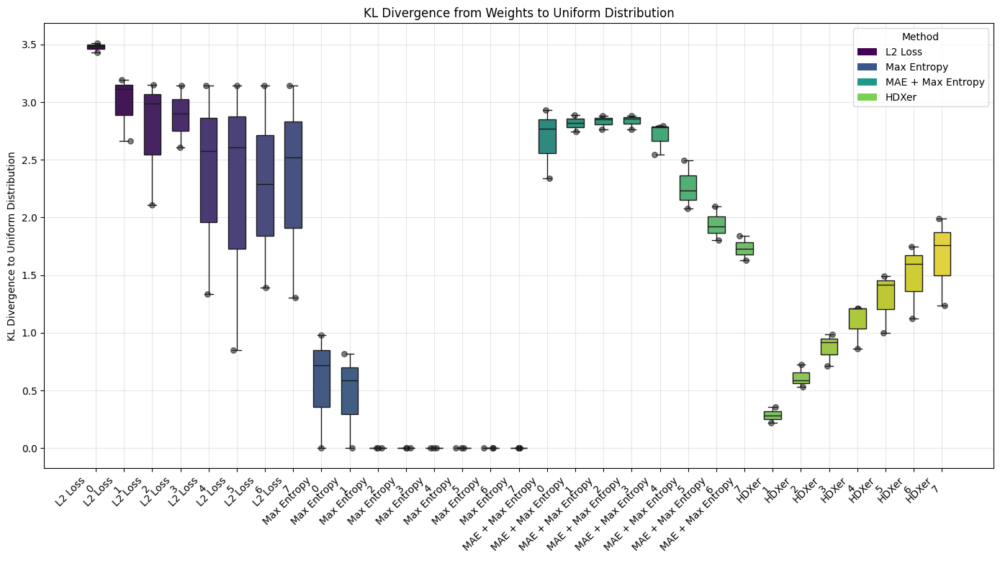

In [91]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import itertools
from scipy.stats import entropy
import jax.numpy as jnp

def kl_divergence(p, q):
    """
    Calculate the KL divergence between two probability distributions.
    Adds small epsilon to avoid division by zero.
    """
    epsilon = 1e-10
    p = np.array(p) + epsilon
    q = np.array(q) + epsilon
    
    # Normalize to ensure they are probability distributions
    p = p / np.sum(p)
    q = q / np.sum(q)
    
    return entropy(p, q)

def compute_kl_divergence_to_uniform(weights_dict):
    """
    Compute KL divergences from each set of weights to a uniform distribution.
    
    Parameters:
    -----------
    weights_dict : dict
        Nested dictionary with structure:
        {method_name: {parameter_value: {seed_key: weights_array}}}
    
    Returns:
    --------
    kl_results : dict
        Dictionary with KL divergences grouped by method and parameter
        {method_name: {parameter_value: [kl_values]}}
    """
    kl_results = {}
    
    for method, param_dict in weights_dict.items():
        kl_results[method] = {}
        
        for param, seed_dict in param_dict.items():
            # Compute KL divergence to uniform for each seed
            kl_values = []
            
            for seed_key, weights in seed_dict.items():
                if weights is None:
                    continue
                
                # Create uniform distribution of the same length
                uniform_weights = np.ones_like(weights) / len(weights)
                
                # Calculate KL divergence from weights to uniform (unidirectional)
                kl_div = kl_divergence(weights, uniform_weights)
                kl_values.append(kl_div)
            
            kl_results[method][param] = kl_values
    
    return kl_results

def extract_weights_from_optimization_results(opt_results, n_seeds, n_replicates):
    """
    Extract final frame weights from optimization results.
    
    Parameters:
    -----------
    opt_results : dict
        Dictionary with optimization results from run_optimization_replicates
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates
    
    Returns:
    --------
    weights_dict : dict
        Dictionary with structure {replicate_idx: {seed_key: weights_array}}
    """
    weights_dict = {}
    
    # Initialize weights dictionary
    for rep_idx in range(n_replicates):
        weights_dict[rep_idx] = {}
    
    # Extract weights for each seed and replicate
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        
        if seed_key in opt_results:
            for rep_idx, rep_result in enumerate(opt_results[seed_key]):
                if rep_idx >= n_replicates:
                    break
                    
                try:
                    # Check if the result exists
                    if rep_result is not None:
                        # Extract the simulation and history
                        sim, history = rep_result
                        
                        if hasattr(history, 'states') and len(history.states) > 0:
                            # Get the final state
                            final_state = history.states[-1]
                            
                            if hasattr(final_state, 'params'):
                                # Extract weights and apply mask
                                frame_weights = final_state.params.frame_weights
                                frame_mask = final_state.params.frame_mask
                                
                                # Convert to numpy array
                                if hasattr(frame_weights, 'shape'):
                                    masked_weights = np.array(frame_weights * frame_mask)
                                    weights_dict[rep_idx][seed_key] = masked_weights
                                else:
                                    print(f"Invalid frame weights for seed {seed_idx}, replicate {rep_idx}")
                                    weights_dict[rep_idx][seed_key] = None
                            else:
                                print(f"No params attribute in state for seed {seed_idx}, replicate {rep_idx}")
                                weights_dict[rep_idx][seed_key] = None
                        else:
                            print(f"No valid states in history for seed {seed_idx}, replicate {rep_idx}")
                            weights_dict[rep_idx][seed_key] = None
                    else:
                        print(f"Null result for seed {seed_idx}, replicate {rep_idx}")
                        weights_dict[rep_idx][seed_key] = None
                except Exception as e:
                    print(f"Error extracting weights for seed {seed_idx}, replicate {rep_idx}: {e}")
                    weights_dict[rep_idx][seed_key] = None
                    
    return weights_dict

def extract_hdxer_weights(hdxer_dir, n_seeds, gamma_values):
    """
    Extract HDXer weights from files.
    
    Parameters:
    -----------
    hdxer_dir : str
        Directory containing HDXer weight files
    n_seeds : int
        Number of seeds
    gamma_values : list
        List of gamma values
    
    Returns:
    --------
    weights_dict : dict
        Dictionary with structure {gamma_value: {seed_key: weights_array}}
    """
    weights_dict = {}
    
    for gamma in gamma_values:
        weights_dict[gamma] = {}
        
        for seed_idx in range(1, n_seeds + 1):
            seed_key = f'seed_{seed_idx-1}'
            
            try:
                # Construct path to HDXer weights file
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                # Check if file exists
                if os.path.exists(weights_file):
                    # Load weights from file
                    weights = np.loadtxt(weights_file)
                    
                    # Normalize weights
                    weights = weights / np.sum(weights)
                    
                    # Store the weights
                    weights_dict[gamma][seed_key] = weights
                else:
                    print(f"HDXer weights file not found: {weights_file}")
                    weights_dict[gamma][seed_key] = None
            except Exception as e:
                print(f"Error loading HDXer weights for seed {seed_idx}, gamma {gamma}: {e}")
                weights_dict[gamma][seed_key] = None
    
    return weights_dict

def plot_kl_divergence_boxplots(kl_results, method_names=None, title="KL Divergence to Uniform Distribution"):
    """
    Create box plots of KL divergences from weights to uniform distribution.
    
    Parameters:
    -----------
    kl_results : dict
        Dictionary with KL divergences grouped by method and parameter
    method_names : list, optional
        List of method names for the legend
    title : str, optional
        Plot title
    
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The box plot figure
    """
    # Create figure
    plt.figure(figsize=(14, 8))
    
    # Prepare data for boxplot
    all_data = []
    all_labels = []
    all_method_labels = []
    method_param_count = {}
    
    # Count parameters for each method
    for method, param_dict in kl_results.items():
        valid_params = [p for p, vals in param_dict.items() if vals]
        method_param_count[method] = len(valid_params)
    
    # Count total number of valid parameters
    total_valid_params = sum(method_param_count.values())
    
    # Define colors for methods
    method_colors = plt.cm.viridis(np.linspace(0, 1, max(total_valid_params, 1)))
    color_idx = 0
    
    # Collect data for each method and parameter
    for method, param_dict in kl_results.items():
        for param, kl_values in sorted(param_dict.items()):
            if kl_values:  # Only add if there are values
                all_data.append(kl_values)
                all_labels.append(f"{method}\n{param}")
                all_method_labels.append(method)
                color_idx += 1
    
    # Create box plot with seaborn, converting method_colors to a list
    if all_data:
        boxplot = sns.boxplot(data=all_data, palette=list(method_colors[:len(all_data)]), width=0.6)
        
        # Add data points
        for i, data in enumerate(all_data):
            # Add jittered points
            x = np.random.normal(i, 0.1, size=len(data))
            plt.scatter(x, data, color='black', alpha=0.5, s=30)
        
        # Set x-tick labels
        plt.xticks(range(len(all_labels)), all_labels, rotation=45, ha='right')
        
        # Customize the plot
        plt.ylabel("KL Divergence to Uniform Distribution")
        plt.title(title)
        plt.grid(True, alpha=0.3)
        
        # Add a legend for methods if methods have multiple parameters
        if len(set(all_method_labels)) > 1:
            from matplotlib.patches import Patch
            
            unique_methods = list(dict.fromkeys(all_method_labels))
            
            # Create a color map for methods
            method_to_color = {}
            color_idx = 0
            for method in unique_methods:
                if method not in method_to_color:
                    method_to_color[method] = method_colors[color_idx % len(method_colors)]
                    color_idx += method_param_count.get(method, 1)
            
            legend_elements = [Patch(facecolor=method_to_color.get(method, 'gray'), 
                                    label=method)
                            for method in unique_methods]
            
            plt.legend(handles=legend_elements, title="Method", loc='upper right')
    else:
        plt.text(0.5, 0.5, "No valid KL divergence data available", 
                 ha='center', va='center', fontsize=14)
    
    plt.tight_layout()
    
    return plt.gcf()

def create_dummy_weights(n_seeds, n_replicates, trajectory_length=500):
    """
    Create dummy weights for testing purposes.
    """
    weights_dict = {}
    
    rng = np.random.RandomState(42)  # For reproducibility
    
    for rep_idx in range(n_replicates):
        weights_dict[rep_idx] = {}
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            
            # Generate random weights
            weights = rng.dirichlet(np.ones(trajectory_length))
            weights_dict[rep_idx][seed_key] = weights
    
    return weights_dict

def main(optimization_results, me_optimization_results, mre_me_optimization_results, 
         hdxer_dir, n_seeds, n_replicates, gamma_values):
    """
    Main function to compute and visualize KL divergences to uniform.
    
    Parameters:
    -----------
    optimization_results : dict
        Dictionary with L2 Loss optimization results
    me_optimization_results : dict
        Dictionary with Max Entropy optimization results
    mre_me_optimization_results : dict
        Dictionary with MAE + Max Entropy optimization results
    hdxer_dir : str
        Directory containing HDXer weight files
    n_seeds : int
        Number of seeds
    n_replicates : int
        Number of replicates
    gamma_values : list
        List of gamma values for HDXer
    
    Returns:
    --------
    fig : matplotlib.figure.Figure
        The box plot figure
    kl_results : dict
        Dictionary with KL divergences
    """
    print("Extracting weights from optimization results...")
    
    # Extract real weights from optimization results
    l2_weights = extract_weights_from_optimization_results(optimization_results, n_seeds, n_replicates)
    me_weights = extract_weights_from_optimization_results(me_optimization_results, n_seeds, n_replicates)
    mae_me_weights = extract_weights_from_optimization_results(mre_me_optimization_results, n_seeds, n_replicates)
    
    print("Extracting HDXer weights...")
    # Extract HDXer weights
    hdxer_weights = extract_hdxer_weights(hdxer_dir, n_seeds, gamma_values)
    
    print("Creating combined weights dictionary...")
    # Create all_weights dictionary
    all_weights = {
        "L2 Loss": l2_weights,
        "Max Entropy": me_weights,
        "MAE + Max Entropy": mae_me_weights,
        "HDXer": hdxer_weights
    }
    
    print("Computing KL divergences to uniform distribution...")
    # Compute KL divergences to uniform distribution
    kl_results = compute_kl_divergence_to_uniform(all_weights)
    
    print("Creating visualization...")
    # Create box plot visualization
    method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"]
    fig = plot_kl_divergence_boxplots(kl_results, method_names=method_names,
                                    title="KL Divergence from Weights to Uniform Distribution")
    
    return fig, kl_results

# Example usage:
# HDXer directory
hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
# Parameters
n_seeds = 3
n_replicates = 8
gamma_values = [1, 2, 3, 4, 5, 6, 7]
# Optimization results
optimization_results_dict = {
    "L2 Loss": optimization_results,
    "Max Entropy": me_optimization_results,
    "MAE + Max Entropy": mre_me_optimization_results
}
fig, kl_results = main(optimization_results, me_optimization_results, mre_me_optimization_results,
                       hdxer_dir, n_seeds, n_replicates, gamma_values)
plt.show()

In [ ]:

# Second: measure the KL divergence between the best and final weights, across seeds for all method/replicates.


In [61]:
# compare W1 of final ensemele for each parameter to the NMR ensemble
# for both HDXer and the 3 experiments so far 

# load pdb code 1UUA

reference_path = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/1UUA_BPTI.pdb"


# load in the NMR ensemble
reference_top = Universe(reference_path)

In [62]:
# first compare W1 distance between final ensembles and NMR ensemble
# also compare the best ensembles from each method to the NMR ensemble
# for each method/seed combination - average weights across seeds


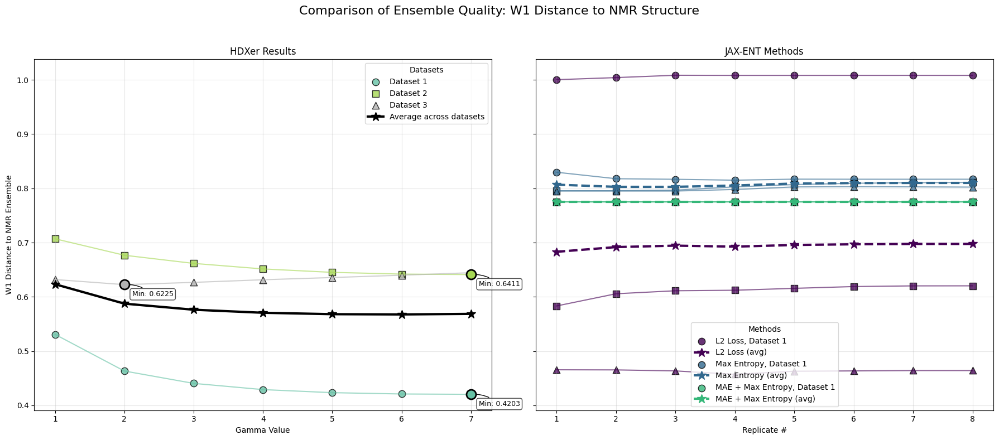

In [ ]:
def calculate_w1_distances(opt_history, hdxer_dir, universes, reference_pdb, 
                          n_seeds=3, n_replicates=8, gamma_values=None):
    """
    Calculate W1 distances between reweighted ensembles and NMR reference structure.
    
    Parameters:
    -----------
    opt_history : dict
        Dictionary containing optimization history for each method
    hdxer_dir : str
        Path to HDXer results directory
    universes : list
        List of MDAnalysis Universe objects containing the trajectory
    reference_pdb : str
        Path to NMR reference PDB file
    n_seeds : int
        Number of seeds/datasets
    n_replicates : int
        Number of replicates per seed
    gamma_values : list
        List of gamma values for HDXer results
        
    Returns:
    --------
    w1_distances : dict
        Dictionary of W1 distances for each method/seed/replicate
    """
    import numpy as np
    import os
    import MDAnalysis as mda
    from scipy.stats import wasserstein_distance
    from scipy.spatial.distance import pdist, squareform
    
    # Default values
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    # Method keys
    method_keys = ["L2_Loss", "Max_Entropy", "MAE_Max_Entropy"]
    
    # Get trajectory info
    md_universe = universes[0]
    n_frames = md_universe.trajectory.n_frames
    
    # Load reference NMR ensemble
    ref_universe = mda.Universe(reference_pdb)
    ref_ca = ref_universe.select_atoms('name CA')
    n_ref_frames = ref_universe.trajectory.n_frames
    n_atoms = ref_ca.n_atoms
    
    # Extract pairwise distances from reference NMR ensemble
    ref_pairwise_distances = []
    for ts in ref_universe.trajectory:
        coords = ref_ca.positions
        pairwise_dists = pdist(coords)
        ref_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    ref_pairwise_distances = np.array(ref_pairwise_distances)
    
    # Reference weights (uniform)
    ref_weights = np.ones(n_ref_frames) / n_ref_frames
    
    # Compute average pairwise distances for reference
    ref_avg_pairwise = np.average(ref_pairwise_distances, axis=0, weights=ref_weights)
    
    # Extract pairwise distances from MD trajectory
    md_ca = md_universe.select_atoms('name CA')
    md_pairwise_distances = []
    for ts in md_universe.trajectory:
        coords = md_ca.positions
        pairwise_dists = pdist(coords)
        md_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    md_pairwise_distances = np.array(md_pairwise_distances)
    
    # W1 distance calculation function using scipy
    def compute_w1_distance(ref_avg_pairwise, md_pairwise, md_weights):
        """Calculate Wasserstein-1 distance between reference and weighted MD ensemble."""
        # Compute average pairwise distances for MD using weights
        md_avg_pairwise = np.average(md_pairwise, axis=0, weights=md_weights)
        
        # Calculate Wasserstein distance between the two distributions
        w1_dist = wasserstein_distance(ref_avg_pairwise, md_avg_pairwise)
        
        return w1_dist
    
    # Initialize results dictionary
    w1_distances = {
        "L2_Loss": {},
        "Max_Entropy": {},
        "MAE_Max_Entropy": {},
        "HDXer": {},
        "Avg_Weights": {}
    }
    
    # Track average weights
    avg_weights = {
        "L2_Loss": np.zeros((n_replicates, n_frames)),
        "Max_Entropy": np.zeros((n_replicates, n_frames)),
        "MAE_Max_Entropy": np.zeros((n_replicates, n_frames)),
        "HDXer": np.zeros((len(gamma_values), n_frames))
    }
    
    # Track counts for averaging
    seed_counts = {
        "L2_Loss": np.zeros(n_replicates),
        "Max_Entropy": np.zeros(n_replicates),
        "MAE_Max_Entropy": np.zeros(n_replicates),
        "HDXer": np.zeros(len(gamma_values))
    }
    
    # Extract frame weights and calculate W1 distances for JAX-ENT methods
    for method_idx, method_key in enumerate(method_keys):
        w1_distances[method_key] = {}
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            w1_distances[method_key][seed_key] = []
            
            for rep_idx in range(n_replicates):
                try:
                    # Extract frame weights - need to handle tuple structure
                    if seed_key in opt_history[method_key] and rep_idx < len(opt_history[method_key][seed_key]):
                        opt_result = opt_history[method_key][seed_key][rep_idx]
                        
                        # Skip if None
                        if opt_result is None:
                            w1_distances[method_key][seed_key].append(np.nan)
                            continue
                        
                        # This is a tuple (simulation, history)
                        sim = opt_result[0]
                        
                        # Get final state parameters
                        final_weights = np.array(sim.params.frame_weights)
                        final_mask = np.ones_like(final_weights)
                        
                        # Apply mask and normalize
                        weights = final_weights * final_mask
                        weights = weights / np.sum(weights)
                        
                        # Update average weights
                        avg_weights[method_key][rep_idx] += weights
                        seed_counts[method_key][rep_idx] += 1
                        
                        # Calculate W1 distance
                        w1_dist = compute_w1_distance(ref_avg_pairwise, 
                                                      md_pairwise_distances, 
                                                      weights)
                        w1_distances[method_key][seed_key].append(w1_dist)
                    else:
                        w1_distances[method_key][seed_key].append(np.nan)
                
                except Exception as e:
                    print(f"Error processing {method_key}, Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
                    w1_distances[method_key][seed_key].append(np.nan)
    
    # Calculate W1 distances for HDXer
    w1_distances["HDXer"] = {}
    
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        w1_distances["HDXer"][seed_key] = []
        
        for gamma_idx, gamma in enumerate(gamma_values):
            try:
                # Load HDXer weights
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx+1}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                weights = np.loadtxt(weights_file)
                
                # Ensure correct length and normalize
                if len(weights) != n_frames:
                    print(f"Warning: HDXer weights length {len(weights)} != MD frames {n_frames}")
                    # Truncate or pad as needed
                    if len(weights) > n_frames:
                        weights = weights[:n_frames]
                    else:
                        padded = np.zeros(n_frames)
                        padded[:len(weights)] = weights
                        weights = padded
                
                # Normalize weights
                if np.sum(weights) > 0:
                    weights = weights / np.sum(weights)
                else:
                    weights = np.ones(n_frames) / n_frames
                
                # Update average weights
                avg_weights["HDXer"][gamma_idx] += weights
                seed_counts["HDXer"][gamma_idx] += 1
                
                # Calculate W1 distance
                w1_dist = compute_w1_distance(ref_avg_pairwise, 
                                              md_pairwise_distances, 
                                              weights)
                w1_distances["HDXer"][seed_key].append(w1_dist)
            
            except Exception as e:
                print(f"Error processing HDXer, Seed {seed_idx+1}, Gamma {gamma}: {e}")
                w1_distances["HDXer"][seed_key].append(np.nan)
    
    # Calculate W1 distances for averaged weights
    w1_distances["Avg_Weights"] = {}
    
    # For JAX-ENT methods
    for method_key in method_keys:
        w1_distances["Avg_Weights"][method_key] = []
        
        for rep_idx in range(n_replicates):
            if seed_counts[method_key][rep_idx] > 0:
                # Average weights
                avg_w = avg_weights[method_key][rep_idx] / seed_counts[method_key][rep_idx]
                avg_w = avg_w / np.sum(avg_w)
                
                # Calculate W1 distance
                w1_dist = compute_w1_distance(ref_avg_pairwise, 
                                              md_pairwise_distances, 
                                              avg_w)
                w1_distances["Avg_Weights"][method_key].append(w1_dist)
            else:
                w1_distances["Avg_Weights"][method_key].append(np.nan)
    
    # For HDXer
    w1_distances["Avg_Weights"]["HDXer"] = []
    
    for gamma_idx, gamma in enumerate(gamma_values):
        if seed_counts["HDXer"][gamma_idx] > 0:
            # Average weights
            avg_w = avg_weights["HDXer"][gamma_idx] / seed_counts["HDXer"][gamma_idx]
            avg_w = avg_w / np.sum(avg_w)
            
            # Calculate W1 distance
            w1_dist = compute_w1_distance(ref_avg_pairwise, 
                                          md_pairwise_distances, 
                                          avg_w)
            w1_distances["Avg_Weights"]["HDXer"].append(w1_dist)
        else:
            w1_distances["Avg_Weights"]["HDXer"].append(np.nan)
    
    return w1_distances

def plot_w1_distances(w1_distances, n_seeds=3, n_replicates=8, gamma_values=None, 
                     method_names=None, title="W1 Distances to NMR Ensemble"):
    """
    Create visualization comparing W1 distances to NMR ensemble.
    
    Parameters:
    -----------
    w1_distances : dict
        Dictionary of W1 distances for each method/seed/replicate
    n_seeds : int
        Number of seeds/datasets
    n_replicates : int
        Number of replicates per seed
    gamma_values : list
        List of gamma values for HDXer results
    method_names : list
        List of method names for the plot
    title : str
        Plot title
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        Figure object with the plot
    """
    import numpy as np
    import matplotlib.pyplot as plt
    
    # Default values
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    if method_names is None:
        method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"]
    
    # Method keys
    method_keys = ["L2_Loss", "Max_Entropy", "MAE_Max_Entropy"]
    
    # Create visualization
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8), sharey=True)
    
    # Colors and markers
    method_colors = plt.cm.viridis(np.linspace(0, 1, 4))  # One for each method
    seed_markers = ['o', 's', '^', 'D', 'v']
    seed_colors = plt.cm.Set2(np.linspace(0, 1, n_seeds))
    
    # Track min/max for y-axis
    min_w1 = float('inf')
    max_w1 = 0
    
    # Plot HDXer on left panel
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        marker = seed_markers[seed_idx % len(seed_markers)]
        color = seed_colors[seed_idx]
        
        # Get HDXer data
        x_positions = gamma_values[:len(w1_distances["HDXer"][seed_key])]
        y_values = w1_distances["HDXer"][seed_key]
        
        # Plot HDXer results
        ax1.scatter(
            x_positions,
            y_values,
            color=color,
            marker=marker,
            s=80,
            alpha=0.8,
            edgecolors='black',
            label=f"Dataset {seed_idx+1}"
        )
        
        # Add connecting lines
        ax1.plot(
            x_positions,
            y_values,
            color=color,
            alpha=0.6,
            linestyle='-'
        )
        
        # Update min/max
        valid_values = [v for v in y_values if not np.isnan(v)]
        if valid_values:
            min_w1 = min(min_w1, min(valid_values))
            max_w1 = max(max_w1, max(valid_values))
    
    # Plot averaged HDXer results
    avg_values = w1_distances["Avg_Weights"]["HDXer"]
    ax1.plot(
        gamma_values[:len(avg_values)],
        avg_values,
        color='black',
        linewidth=3,
        linestyle='-',
        marker='*',
        markersize=12,
        label="Average across datasets"
    )
    
    # Add min markers for HDXer
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        y_values = w1_distances["HDXer"][seed_key]
        valid_indices = [i for i, v in enumerate(y_values) if not np.isnan(v)]
        
        if valid_indices:
            min_idx = valid_indices[np.argmin([y_values[i] for i in valid_indices])]
            min_val = y_values[min_idx]
            min_x = gamma_values[min_idx]
            
            ax1.scatter(
                min_x,
                min_val,
                s=150,
                color=seed_colors[seed_idx],
                marker='o',
                edgecolors='black',
                linewidth=2,
                zorder=10
            )
            
            ax1.annotate(
                f'Min: {min_val:.4f}',
                xy=(min_x, min_val),
                xytext=(10, -15),
                textcoords='offset points',
                fontsize=9,
                bbox=dict(boxstyle='round,pad=0.3', fc='white', alpha=0.7),
                arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.2')
            )
    
    # Customize left plot
    ax1.set_xlabel("Gamma Value")
    ax1.set_ylabel("W1 Distance to NMR Ensemble")
    ax1.set_title("HDXer Results")
    ax1.grid(True, alpha=0.3)
    ax1.legend(title="Datasets", loc='best')
    
    # Plot JAX-ENT methods on right panel
    for method_idx, (method_key, method_name) in enumerate(zip(method_keys, method_names[:-1])):
        method_color = method_colors[method_idx]
        
        # Plot each dataset
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            marker = seed_markers[seed_idx % len(seed_markers)]
            
            # Get data
            x_positions = np.arange(1, len(w1_distances[method_key][seed_key])+1)
            y_values = w1_distances[method_key][seed_key]
            
            # Plot points
            ax2.scatter(
                x_positions,
                y_values,
                color=method_color,
                marker=marker,
                s=80,
                alpha=0.8,
                edgecolors='black',
                label=f"{method_name}, Dataset {seed_idx+1}" if seed_idx == 0 else None
            )
            
            # Add connecting lines
            ax2.plot(
                x_positions,
                y_values,
                color=method_color,
                alpha=0.6,
                linestyle='-'
            )
            
            # Update min/max
            valid_values = [v for v in y_values if not np.isnan(v)]
            if valid_values:
                min_w1 = min(min_w1, min(valid_values))
                max_w1 = max(max_w1, max(valid_values))
        
        # Plot averaged results
        avg_values = w1_distances["Avg_Weights"][method_key]
        ax2.plot(
            np.arange(1, len(avg_values)+1),
            avg_values,
            color=method_color,
            linewidth=3,
            linestyle='--',
            marker='*',
            markersize=12,
            label=f"{method_name} (avg)"
        )
    
    # Customize right plot
    ax2.set_xlabel("Replicate #")
    ax2.set_title("JAX-ENT Methods")
    ax2.grid(True, alpha=0.3)
    ax2.legend(title="Methods", loc='best')
    
    # Set y-axis limits
    if min_w1 != float('inf') and max_w1 != 0:
        y_range = max_w1 - min_w1
        y_min = max(0, min_w1 - 0.05 * y_range)
        y_max = max_w1 + 0.05 * y_range
        ax1.set_ylim(y_min, y_max)
        ax2.set_ylim(y_min, y_max)
    
    # Main title
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    return fig

def calculate_and_plot_w1_distances(opt_history, hdxer_dir, universes, reference_pdb, 
                                   n_seeds=3, n_replicates=8, gamma_values=None, 
                                   method_names=None, title="W1 Distances to NMR Ensemble"):
    """
    Calculate W1 distances and create visualization.
    
    Parameters:
    -----------
    opt_history : dict
        Dictionary containing optimization history for each method
    hdxer_dir : str
        Path to HDXer results directory
    universes : list
        List of MDAnalysis Universe objects containing the trajectory
    reference_pdb : str
        Path to NMR reference PDB file
    n_seeds : int
        Number of seeds/datasets
    n_replicates : int
        Number of replicates per seed
    gamma_values : list
        List of gamma values for HDXer results
    method_names : list
        List of method names for the plot
    title : str
        Plot title
        
    Returns:
    --------
    fig : matplotlib.figure.Figure
        Figure object with the plot
    w1_distances : dict
        Dictionary containing W1 distances for each method/seed/replicate
    """
    # Calculate W1 distances
    w1_distances = calculate_w1_distances(
        opt_history, hdxer_dir, universes, reference_pdb, 
        n_seeds, n_replicates, gamma_values
    )
    
    # Create visualization
    fig = plot_w1_distances(
        w1_distances, n_seeds, n_replicates, gamma_values, 
        method_names, title
    )
    
    return fig, w1_distances

# Example usage

# Dictionary with all optimization results
opt_history = {
    "L2_Loss": optimization_results,
    "Max_Entropy": me_optimization_results,
    "MAE_Max_Entropy": mre_me_optimization_results
}

# Run W1 distance analysis
reference_path = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/1UUA_BPTI.pdb"
hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
gamma_values = [1, 2, 3, 4, 5, 6, 7]

w1_fig, w1_distances = calculate_and_plot_w1_distances(
    opt_history,
    hdxer_dir,
    universes,
    reference_path,
    n_seeds=3,
    n_replicates=8,
    gamma_values=gamma_values,
    method_names=["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"],
    title="Comparison of Ensemble Quality: W1 Distance to NMR Structure"
)

plt.show()

# If you want to save the figure
w1_fig.savefig("w1_distance_comparison.png", dpi=300, bbox_inches='tight')


/var/folders/4c/64jkr7n54w1558kqk0ks5rgr0000gn/T/ipykernel_99091/4191756532.py:352: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bplot = ax2.boxplot(boxplot_data, patch_artist=True, labels=boxplot_labels)


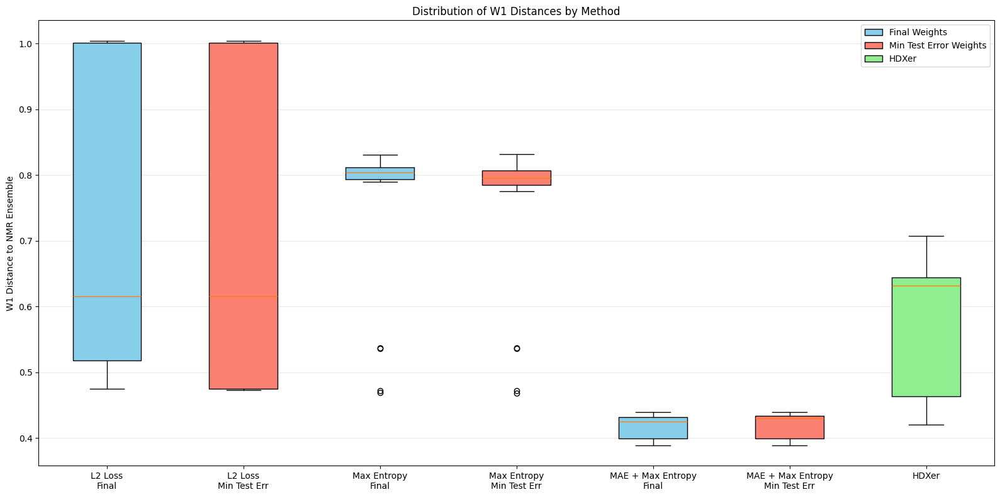

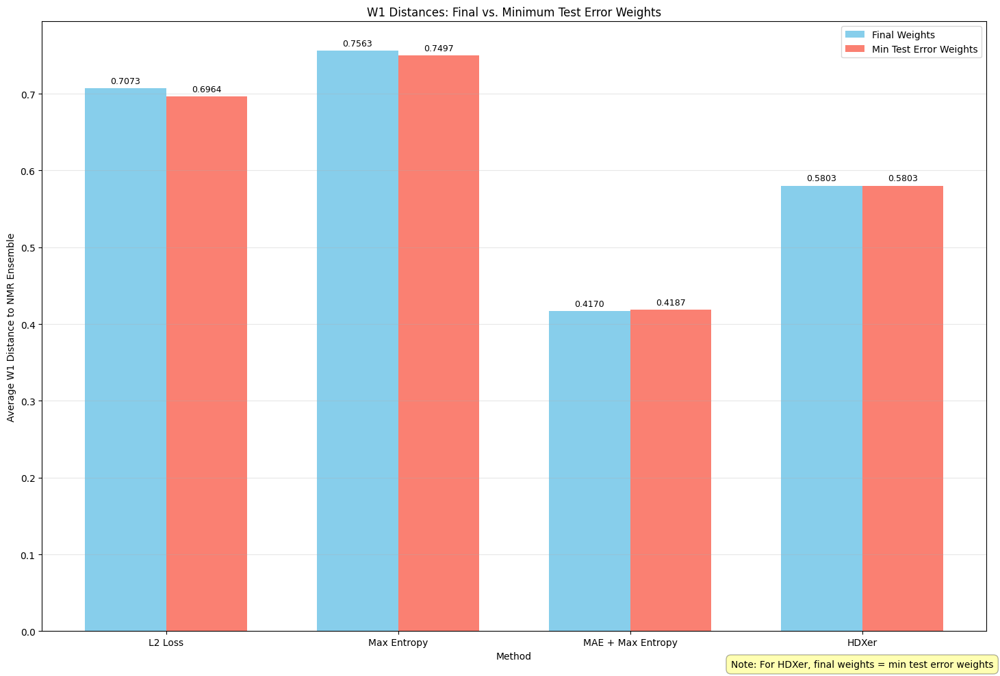

<Figure size 640x480 with 0 Axes>

In [78]:
def compare_w1_distances_final_vs_min_test_error(opt_history, test_losses_dict, hdxer_dir, universes, reference_pdb, 
                                               n_seeds=3, n_replicates=8, gamma_values=None, 
                                               method_names=None, title="W1 Distances: Final vs. Minimum Test Error"):
    """
    Calculate and visualize W1 distances for weights at minimum test error vs. final weights.
    
    Parameters:
    -----------
    opt_history : dict
        Dictionary containing optimization history for each method
        {"L2_Loss": optimization_results, "Max_Entropy": me_optimization_results, ...}
    test_losses_dict : dict
        Dictionary containing test losses for each optimization state
        {"L2 Loss": test_losses, "Max Entropy": me_test_losses, ...}
    hdxer_dir : str
        Path to HDXer results directory
    universes : list
        List of MDAnalysis Universe objects containing the trajectory
    reference_pdb : str
        Path to NMR reference PDB file
    n_seeds : int
        Number of seeds/datasets
    n_replicates : int
        Number of replicates per seed
    gamma_values : list
        List of gamma values for HDXer results
    method_names : list
        List of method names for the plot
    title : str
        Plot title
        
    Returns:
    --------
    figs : tuple
        Tuple of matplotlib figures (bar_chart, boxplot)
    w1_distances : tuple
        Tuple of dictionaries (w1_distances_final, w1_distances_min_test_error)
    """
    import numpy as np
    import os
    import matplotlib.pyplot as plt
    import MDAnalysis as mda
    from scipy.stats import wasserstein_distance
    from scipy.spatial.distance import pdist
    
    # Default values
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    if method_names is None:
        method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"]
    
    # Method keys and mapping to test_losses keys
    method_keys = ["L2_Loss", "Max_Entropy", "MAE_Max_Entropy"]
    test_loss_keys = {
        "L2_Loss": "L2 Loss",
        "Max_Entropy": "Max Entropy",
        "MAE_Max_Entropy": "MAE + Max Entropy"
    }
    
    # Helper function to compute W1 distance
    def compute_w1_distance(ref_avg_pairwise, md_pairwise, md_weights):
        """Calculate Wasserstein-1 distance between reference and weighted MD ensemble."""
        # Compute average pairwise distances for MD using weights
        md_avg_pairwise = np.average(md_pairwise, axis=0, weights=md_weights)
        
        # Calculate Wasserstein distance between the two distributions
        w1_dist = wasserstein_distance(ref_avg_pairwise, md_avg_pairwise)
        
        return w1_dist
    
    # Get trajectory info
    md_universe = universes[0]
    n_frames = md_universe.trajectory.n_frames
    
    # Load reference NMR ensemble
    ref_universe = mda.Universe(reference_pdb)
    ref_ca = ref_universe.select_atoms('name CA')
    n_ref_frames = ref_universe.trajectory.n_frames
    
    # Extract pairwise distances from reference NMR ensemble
    ref_pairwise_distances = []
    for ts in ref_universe.trajectory:
        coords = ref_ca.positions
        pairwise_dists = pdist(coords)
        ref_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    ref_pairwise_distances = np.array(ref_pairwise_distances)
    
    # Reference weights (uniform)
    ref_weights = np.ones(n_ref_frames) / n_ref_frames
    
    # Compute average pairwise distances for reference
    ref_avg_pairwise = np.average(ref_pairwise_distances, axis=0, weights=ref_weights)
    
    # Extract pairwise distances from MD trajectory
    md_ca = md_universe.select_atoms('name CA')
    md_pairwise_distances = []
    for ts in md_universe.trajectory:
        coords = md_ca.positions
        pairwise_dists = pdist(coords)
        md_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    md_pairwise_distances = np.array(md_pairwise_distances)
    
    # Initialize dictionaries for W1 distances
    w1_final = {method_key: {} for method_key in method_keys + ["HDXer"]}
    w1_min_test = {method_key: {} for method_key in method_keys + ["HDXer"]}
    
    # Calculate W1 distances for JAX-ENT methods
    for method_key in method_keys:
        test_loss_key = test_loss_keys[method_key]
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            w1_final[method_key][seed_key] = []
            w1_min_test[method_key][seed_key] = []
            
            for rep_idx in range(n_replicates):
                try:
                    if (seed_key in opt_history[method_key] and 
                        rep_idx < len(opt_history[method_key][seed_key]) and
                        seed_key in test_losses_dict[test_loss_key] and
                        rep_idx < len(test_losses_dict[test_loss_key][seed_key])):
                        
                        opt_result = opt_history[method_key][seed_key][rep_idx]
                        test_loss_history = test_losses_dict[test_loss_key][seed_key][rep_idx]
                        
                        # Skip if None
                        if opt_result is None or test_loss_history is None:
                            w1_final[method_key][seed_key].append(np.nan)
                            w1_min_test[method_key][seed_key].append(np.nan)
                            continue
                        
                        # Unpack results
                        sim, history = opt_result
                        
                        # Find index with minimum test loss
                        min_test_loss_idx = np.nanargmin(test_loss_history)
                        
                        # Get weights for final state
                        final_weights = np.array(history.states[-1].params.frame_weights)
                        final_mask = np.array(history.states[-1].params.frame_mask)
                        
                        # Get weights for min test error state
                        min_weights = np.array(history.states[min_test_loss_idx].params.frame_weights)
                        min_mask = np.array(history.states[min_test_loss_idx].params.frame_mask)
                        
                        # Apply masks and normalize
                        final_weights = final_weights * final_mask
                        final_weights = final_weights / np.sum(final_weights)
                        
                        min_weights = min_weights * min_mask
                        min_weights = min_weights / np.sum(min_weights)
                        
                        # Calculate W1 distances
                        final_w1 = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, final_weights)
                        min_w1 = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, min_weights)
                        
                        w1_final[method_key][seed_key].append(final_w1)
                        w1_min_test[method_key][seed_key].append(min_w1)
                    else:
                        w1_final[method_key][seed_key].append(np.nan)
                        w1_min_test[method_key][seed_key].append(np.nan)
                except Exception as e:
                    print(f"Error processing {method_key}, Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
                    w1_final[method_key][seed_key].append(np.nan)
                    w1_min_test[method_key][seed_key].append(np.nan)
    
    # Calculate W1 distances for HDXer (same for both final and min test)
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        w1_final["HDXer"][seed_key] = []
        w1_min_test["HDXer"][seed_key] = []
        
        for gamma_idx, gamma in enumerate(gamma_values):
            try:
                # Load HDXer weights
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx+1}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                weights = np.loadtxt(weights_file)
                
                # Ensure correct length and normalize
                if len(weights) != n_frames:
                    print(f"Warning: HDXer weights length {len(weights)} != MD frames {n_frames}")
                    # Truncate or pad as needed
                    if len(weights) > n_frames:
                        weights = weights[:n_frames]
                    else:
                        padded = np.zeros(n_frames)
                        padded[:len(weights)] = weights
                        weights = padded
                
                # Normalize weights
                if np.sum(weights) > 0:
                    weights = weights / np.sum(weights)
                else:
                    weights = np.ones(n_frames) / n_frames
                
                # Calculate W1 distance
                w1_dist = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, weights)
                
                # Store the same value for both final and min test
                w1_final["HDXer"][seed_key].append(w1_dist)
                w1_min_test["HDXer"][seed_key].append(w1_dist)
            except Exception as e:
                print(f"Error processing HDXer, Seed {seed_idx+1}, Gamma {gamma}: {e}")
                w1_final["HDXer"][seed_key].append(np.nan)
                w1_min_test["HDXer"][seed_key].append(np.nan)
    
    # Create bar chart comparing average W1 distances
    fig1, ax1 = plt.subplots(figsize=(15, 10))
    
    # Set up bar positions
    n_methods = len(method_keys) + 1  # +1 for HDXer
    bar_width = 0.35
    x_positions = np.arange(n_methods)
    
    # Collect data for bar chart
    final_avg_w1 = []
    min_avg_w1 = []
    method_labels = []
    
    # Calculate averages for each method
    for method_key, method_name in zip(method_keys, method_names[:-1]):
        # Average W1 for final weights
        method_final_w1 = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for w in w1_final[method_key][seed_key]:
                if not np.isnan(w):
                    method_final_w1.append(w)
        
        avg_final = np.mean(method_final_w1) if method_final_w1 else np.nan
        final_avg_w1.append(avg_final)
        
        # Average W1 for min test error weights
        method_min_w1 = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for w in w1_min_test[method_key][seed_key]:
                if not np.isnan(w):
                    method_min_w1.append(w)
        
        avg_min = np.mean(method_min_w1) if method_min_w1 else np.nan
        min_avg_w1.append(avg_min)
        
        method_labels.append(method_name)
    
    # Add HDXer (same for both final and min)
    hdxer_w1 = []
    for s in range(n_seeds):
        seed_key = f'seed_{s}'
        for w in w1_final["HDXer"][seed_key]:
            if not np.isnan(w):
                hdxer_w1.append(w)
    
    avg_hdxer = np.mean(hdxer_w1) if hdxer_w1 else np.nan
    final_avg_w1.append(avg_hdxer)
    min_avg_w1.append(avg_hdxer)
    method_labels.append("HDXer")
    
    # Plot bars
    bars1 = ax1.bar(x_positions - bar_width/2, final_avg_w1, bar_width, 
                   label='Final Weights', color='skyblue')
    bars2 = ax1.bar(x_positions + bar_width/2, min_avg_w1, bar_width,
                   label='Min Test Error Weights', color='salmon')
    
    # Add value labels
    def add_labels(bars):
        for bar in bars:
            height = bar.get_height()
            ax1.annotate(f'{height:.4f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 3),  # 3 points vertical offset
                        textcoords="offset points",
                        ha='center', va='bottom', fontsize=9)
    
    add_labels(bars1)
    add_labels(bars2)
    
    # Customize bar chart
    ax1.set_xlabel('Method')
    ax1.set_ylabel('Average W1 Distance to NMR Ensemble')
    ax1.set_title(title)
    ax1.set_xticks(x_positions)
    ax1.set_xticklabels(method_labels)
    ax1.legend()
    ax1.grid(True, axis='y', alpha=0.3)
    
    # Add note for HDXer
    ax1.annotate("Note: For HDXer, final weights = min test error weights",
                xy=(n_methods-1, 0),
                xytext=(0, -30),
                textcoords="offset points",
                ha='center', va='top', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.3))
    
    plt.tight_layout()
    
    # Create boxplot showing distributions
    fig2, ax2 = plt.subplots(figsize=(16, 8))
    
    # Prepare data for boxplots
    boxplot_data = []
    boxplot_labels = []
    
    # Collect W1 values for each method
    for method_key, method_name in zip(method_keys, method_names[:-1]):
        # Final weights
        method_final_data = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for val in w1_final[method_key][seed_key]:
                if not np.isnan(val):
                    method_final_data.append(val)
        
        boxplot_data.append(method_final_data)
        boxplot_labels.append(f"{method_name}\nFinal")
        
        # Min test error weights
        method_min_data = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for val in w1_min_test[method_key][seed_key]:
                if not np.isnan(val):
                    method_min_data.append(val)
        
        boxplot_data.append(method_min_data)
        boxplot_labels.append(f"{method_name}\nMin Test Err")
    
    # Add HDXer data
    hdxer_data = []
    for s in range(n_seeds):
        seed_key = f'seed_{s}'
        for val in w1_final["HDXer"][seed_key]:
            if not np.isnan(val):
                hdxer_data.append(val)
    
    boxplot_data.append(hdxer_data)
    boxplot_labels.append("HDXer")
    
    # Create boxplot
    box_colors = ['skyblue', 'salmon'] * len(method_keys) + ['lightgreen']
    
    bplot = ax2.boxplot(boxplot_data, patch_artist=True, labels=boxplot_labels)
    
    # Color boxes
    for patch, color in zip(bplot['boxes'], box_colors):
        patch.set_facecolor(color)
    
    # Customize boxplot
    ax2.set_ylabel('W1 Distance to NMR Ensemble')
    ax2.set_title('Distribution of W1 Distances by Method')
    ax2.grid(True, axis='y', alpha=0.3)
    
    # Add legend for colors
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='skyblue', edgecolor='black', label='Final Weights'),
        Patch(facecolor='salmon', edgecolor='black', label='Min Test Error Weights'),
        Patch(facecolor='lightgreen', edgecolor='black', label='HDXer')
    ]
    ax2.legend(handles=legend_elements, loc='best')
    
    plt.tight_layout()
    
    return (fig1, fig2), (w1_final, w1_min_test)

# Example usage
# def plot_min_test_error_comparison():
    # Dictionary with all test losses
test_losses_dict = {
    "L2 Loss": test_losses,
    "Max Entropy": me_test_losses,
    "MAE + Max Entropy": mre_me_test_losses
}

# Dictionary with all optimization results
opt_history = {
    "L2_Loss": optimization_results,
    "Max_Entropy": me_optimization_results,
    "MAE_Max_Entropy": mre_me_optimization_results
}

# Run W1 distance analysis
reference_path = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/1UUA_BPTI.pdb"
hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
gamma_values = [1, 2, 3, 4, 5, 6, 7]

(bar_chart, boxplot), (w1_final, w1_min) = compare_w1_distances_final_vs_min_test_error(
    opt_history,
    test_losses_dict,
    hdxer_dir,
    universes,
    reference_path,
    n_seeds=3,
    n_replicates=8,
    gamma_values=gamma_values,
    method_names=["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"],
    title="W1 Distances: Final vs. Minimum Test Error Weights"
)

plt.figure(1)
plt.show()

plt.figure(2)
plt.show()

# You can also save the figures
bar_chart.savefig("w1_distance_bar_chart.png", dpi=300, bbox_inches='tight')
boxplot.savefig("w1_distance_boxplot.png", dpi=300, bbox_inches='tight')

# return (bar_chart, boxplot), (w1_final, w1_min)

/var/folders/4c/64jkr7n54w1558kqk0ks5rgr0000gn/T/ipykernel_99091/3425975547.py:353: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bplot = ax2.boxplot(boxplot_data, patch_artist=True, labels=boxplot_labels)
/var/folders/4c/64jkr7n54w1558kqk0ks5rgr0000gn/T/ipykernel_99091/3425975547.py:416: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_final = plt.cm.get_cmap(cmap)
/var/folders/4c/64jkr7n54w1558kqk0ks5rgr0000gn/T/ipykernel_99091/3425975547.py:417: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_min = plt.cm.

Displaying bar chart comparing overall W1 distances...


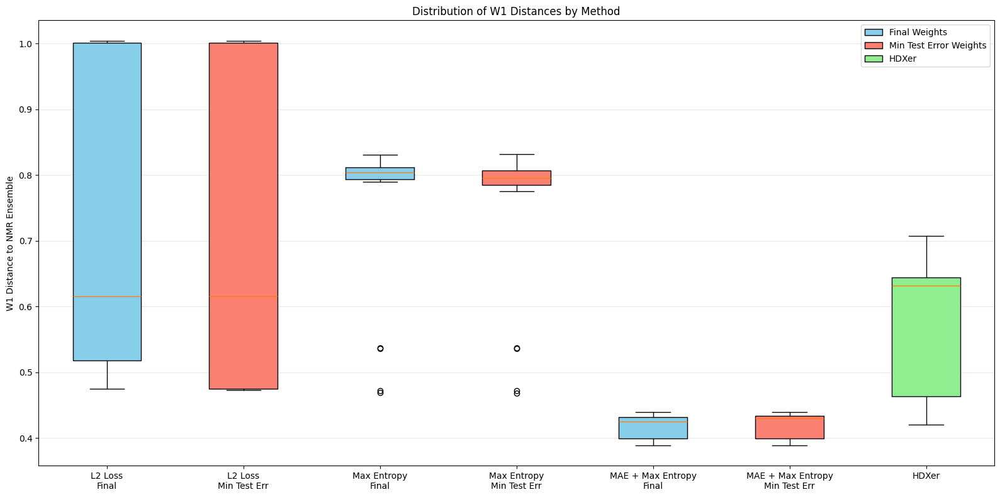

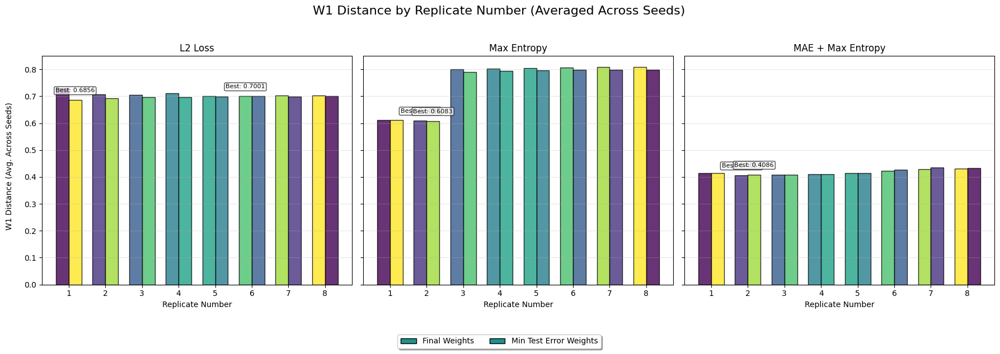

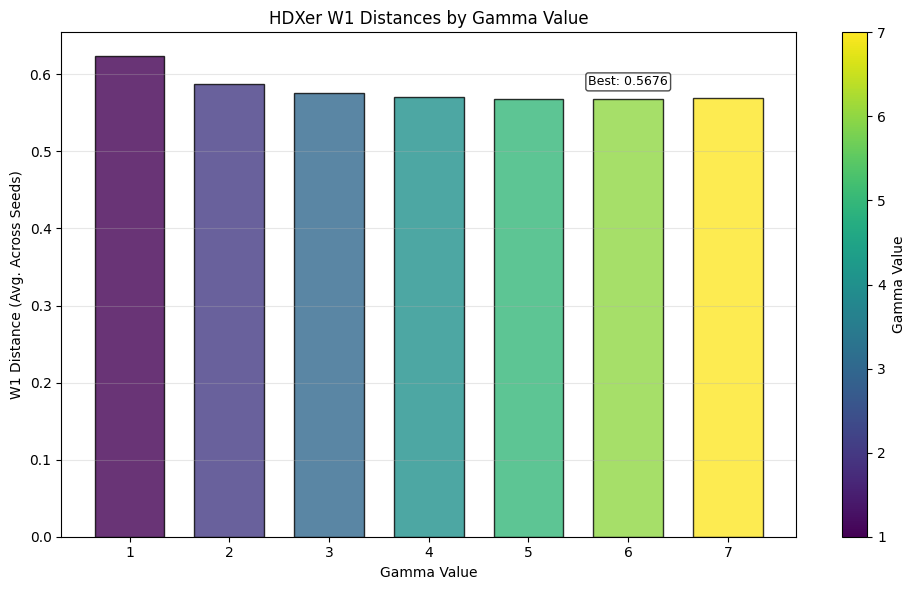

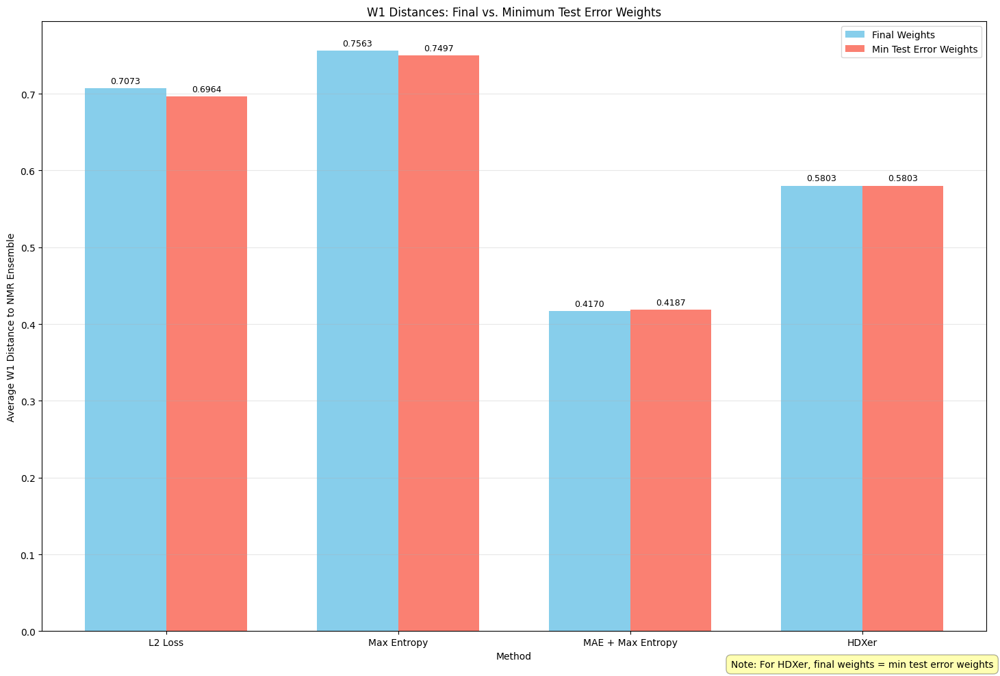

Displaying boxplot of W1 distance distributions...


<Figure size 640x480 with 0 Axes>

Displaying parameter-specific (replicate number) W1 distances for JAX-ENT methods...


<Figure size 640x480 with 0 Axes>

Displaying parameter-specific (gamma value) W1 distances for HDXer...


<Figure size 640x480 with 0 Axes>

NameError: name 'param_charts' is not defined

In [85]:
def compare_w1_distances_final_vs_min_test_error(opt_history, test_losses_dict, hdxer_dir, universes, reference_pdb, 
                                               n_seeds=3, n_replicates=8, gamma_values=None, 
                                               method_names=None, title="W1 Distances: Final vs. Minimum Test Error",
                                               cmap="viridis"):
    """
    Calculate and visualize W1 distances for weights at minimum test error vs. final weights.
    
    Parameters:
    -----------
    opt_history : dict
        Dictionary containing optimization history for each method
        {"L2_Loss": optimization_results, "Max_Entropy": me_optimization_results, ...}
    test_losses_dict : dict
        Dictionary containing test losses for each optimization state
        {"L2 Loss": test_losses, "Max Entropy": me_test_losses, ...}
    hdxer_dir : str
        Path to HDXer results directory
    universes : list
        List of MDAnalysis Universe objects containing the trajectory
    reference_pdb : str
        Path to NMR reference PDB file
    n_seeds : int
        Number of seeds/datasets
    n_replicates : int
        Number of replicates per seed
    gamma_values : list
        List of gamma values for HDXer results
    method_names : list
        List of method names for the plot
    title : str
        Plot title
        
    Returns:
    --------
    figs : tuple
        Tuple of matplotlib figures (bar_chart, boxplot)
    w1_distances : tuple
        Tuple of dictionaries (w1_distances_final, w1_distances_min_test_error)
    """
    import numpy as np
    import os
    import matplotlib.pyplot as plt
    import MDAnalysis as mda
    from scipy.stats import wasserstein_distance
    from scipy.spatial.distance import pdist
    
    # Default values
    if gamma_values is None:
        gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    if method_names is None:
        method_names = ["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"]
    
    # Method keys and mapping to test_losses keys
    method_keys = ["L2_Loss", "Max_Entropy", "MAE_Max_Entropy"]
    test_loss_keys = {
        "L2_Loss": "L2 Loss",
        "Max_Entropy": "Max Entropy",
        "MAE_Max_Entropy": "MAE + Max Entropy"
    }
    
    # Helper function to compute W1 distance
    def compute_w1_distance(ref_avg_pairwise, md_pairwise, md_weights):
        """Calculate Wasserstein-1 distance between reference and weighted MD ensemble."""
        # Compute average pairwise distances for MD using weights
        md_avg_pairwise = np.average(md_pairwise, axis=0, weights=md_weights)
        
        # Calculate Wasserstein distance between the two distributions
        w1_dist = wasserstein_distance(ref_avg_pairwise, md_avg_pairwise)
        
        return w1_dist
    
    # Get trajectory info
    md_universe = universes[0]
    n_frames = md_universe.trajectory.n_frames
    
    # Load reference NMR ensemble
    ref_universe = mda.Universe(reference_pdb)
    ref_ca = ref_universe.select_atoms('name CA')
    n_ref_frames = ref_universe.trajectory.n_frames
    
    # Extract pairwise distances from reference NMR ensemble
    ref_pairwise_distances = []
    for ts in ref_universe.trajectory:
        coords = ref_ca.positions
        pairwise_dists = pdist(coords)
        ref_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    ref_pairwise_distances = np.array(ref_pairwise_distances)
    
    # Reference weights (uniform)
    ref_weights = np.ones(n_ref_frames) / n_ref_frames
    
    # Compute average pairwise distances for reference
    ref_avg_pairwise = np.average(ref_pairwise_distances, axis=0, weights=ref_weights)
    
    # Extract pairwise distances from MD trajectory
    md_ca = md_universe.select_atoms('name CA')
    md_pairwise_distances = []
    for ts in md_universe.trajectory:
        coords = md_ca.positions
        pairwise_dists = pdist(coords)
        md_pairwise_distances.append(pairwise_dists)
    
    # Convert to numpy array for easier manipulation
    md_pairwise_distances = np.array(md_pairwise_distances)
    
    # Initialize dictionaries for W1 distances
    w1_final = {method_key: {} for method_key in method_keys + ["HDXer"]}
    w1_min_test = {method_key: {} for method_key in method_keys + ["HDXer"]}
    
    # Calculate W1 distances for JAX-ENT methods
    for method_key in method_keys:
        test_loss_key = test_loss_keys[method_key]
        
        for seed_idx in range(n_seeds):
            seed_key = f'seed_{seed_idx}'
            w1_final[method_key][seed_key] = []
            w1_min_test[method_key][seed_key] = []
            
            for rep_idx in range(n_replicates):
                try:
                    if (seed_key in opt_history[method_key] and 
                        rep_idx < len(opt_history[method_key][seed_key]) and
                        seed_key in test_losses_dict[test_loss_key] and
                        rep_idx < len(test_losses_dict[test_loss_key][seed_key])):
                        
                        opt_result = opt_history[method_key][seed_key][rep_idx]
                        test_loss_history = test_losses_dict[test_loss_key][seed_key][rep_idx]
                        
                        # Skip if None
                        if opt_result is None or test_loss_history is None:
                            w1_final[method_key][seed_key].append(np.nan)
                            w1_min_test[method_key][seed_key].append(np.nan)
                            continue
                        
                        # Unpack results
                        sim, history = opt_result
                        
                        # Find index with minimum test loss
                        min_test_loss_idx = np.nanargmin(test_loss_history)
                        
                        # Get weights for final state
                        final_weights = np.array(history.states[-1].params.frame_weights)
                        final_mask = np.array(history.states[-1].params.frame_mask)
                        
                        # Get weights for min test error state
                        min_weights = np.array(history.states[min_test_loss_idx].params.frame_weights)
                        min_mask = np.array(history.states[min_test_loss_idx].params.frame_mask)
                        
                        # Apply masks and normalize
                        final_weights = final_weights * final_mask
                        final_weights = final_weights / np.sum(final_weights)
                        
                        min_weights = min_weights * min_mask
                        min_weights = min_weights / np.sum(min_weights)
                        
                        # Calculate W1 distances
                        final_w1 = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, final_weights)
                        min_w1 = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, min_weights)
                        
                        w1_final[method_key][seed_key].append(final_w1)
                        w1_min_test[method_key][seed_key].append(min_w1)
                    else:
                        w1_final[method_key][seed_key].append(np.nan)
                        w1_min_test[method_key][seed_key].append(np.nan)
                except Exception as e:
                    print(f"Error processing {method_key}, Seed {seed_idx+1}, Rep {rep_idx+1}: {e}")
                    w1_final[method_key][seed_key].append(np.nan)
                    w1_min_test[method_key][seed_key].append(np.nan)
    
    # Calculate W1 distances for HDXer (same for both final and min test)
    for seed_idx in range(n_seeds):
        seed_key = f'seed_{seed_idx}'
        w1_final["HDXer"][seed_key] = []
        w1_min_test["HDXer"][seed_key] = []
        
        for gamma_idx, gamma in enumerate(gamma_values):
            try:
                # Load HDXer weights
                weights_file = os.path.join(
                    hdxer_dir, 
                    f"train_BPTI_TFES_{seed_idx+1}", 
                    f"reweighting_gamma_{gamma}x10^0final_weights.dat"
                )
                
                weights = np.loadtxt(weights_file)
                
                # Ensure correct length and normalize
                if len(weights) != n_frames:
                    print(f"Warning: HDXer weights length {len(weights)} != MD frames {n_frames}")
                    # Truncate or pad as needed
                    if len(weights) > n_frames:
                        weights = weights[:n_frames]
                    else:
                        padded = np.zeros(n_frames)
                        padded[:len(weights)] = weights
                        weights = padded
                
                # Normalize weights
                if np.sum(weights) > 0:
                    weights = weights / np.sum(weights)
                else:
                    weights = np.ones(n_frames) / n_frames
                
                # Calculate W1 distance
                w1_dist = compute_w1_distance(ref_avg_pairwise, md_pairwise_distances, weights)
                
                # Store the same value for both final and min test
                w1_final["HDXer"][seed_key].append(w1_dist)
                w1_min_test["HDXer"][seed_key].append(w1_dist)
            except Exception as e:
                print(f"Error processing HDXer, Seed {seed_idx+1}, Gamma {gamma}: {e}")
                w1_final["HDXer"][seed_key].append(np.nan)
                w1_min_test["HDXer"][seed_key].append(np.nan)
    
    # Create bar chart comparing average W1 distances
    fig1, ax1 = plt.subplots(figsize=(15, 10))
    
    # Set up bar positions
    n_methods = len(method_keys) + 1  # +1 for HDXer
    bar_width = 0.35
    x_positions = np.arange(n_methods)
    
    # Collect data for bar chart
    final_avg_w1 = []
    min_avg_w1 = []
    method_labels = []
    
    # Calculate averages for each method
    for method_key, method_name in zip(method_keys, method_names[:-1]):
        # Average W1 for final weights
        method_final_w1 = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for w in w1_final[method_key][seed_key]:
                if not np.isnan(w):
                    method_final_w1.append(w)
        
        avg_final = np.mean(method_final_w1) if method_final_w1 else np.nan
        final_avg_w1.append(avg_final)
        
        # Average W1 for min test error weights
        method_min_w1 = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for w in w1_min_test[method_key][seed_key]:
                if not np.isnan(w):
                    method_min_w1.append(w)
        
        avg_min = np.mean(method_min_w1) if method_min_w1 else np.nan
        min_avg_w1.append(avg_min)
        
        method_labels.append(method_name)
    
    # Add HDXer (same for both final and min)
    hdxer_w1 = []
    for s in range(n_seeds):
        seed_key = f'seed_{s}'
        for w in w1_final["HDXer"][seed_key]:
            if not np.isnan(w):
                hdxer_w1.append(w)
    
    avg_hdxer = np.mean(hdxer_w1) if hdxer_w1 else np.nan
    final_avg_w1.append(avg_hdxer)
    min_avg_w1.append(avg_hdxer)
    method_labels.append("HDXer")
    
    # Plot bars
    bars1 = ax1.bar(x_positions - bar_width/2, final_avg_w1, bar_width, 
                   label='Final Weights', color='skyblue')
    bars2 = ax1.bar(x_positions + bar_width/2, min_avg_w1, bar_width,
                   label='Min Test Error Weights', color='salmon')
    
    # Add value labels
    def add_labels(bars):
        for bar in bars:
            height = bar.get_height()
            ax1.annotate(f'{height:.4f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 3),  # 3 points vertical offset
                        textcoords="offset points",
                        ha='center', va='bottom', fontsize=9)
    
    add_labels(bars1)
    add_labels(bars2)
    
    # Customize bar chart
    ax1.set_xlabel('Method')
    ax1.set_ylabel('Average W1 Distance to NMR Ensemble')
    ax1.set_title(title)
    ax1.set_xticks(x_positions)
    ax1.set_xticklabels(method_labels)
    ax1.legend()
    ax1.grid(True, axis='y', alpha=0.3)
    
    # Add note for HDXer
    ax1.annotate("Note: For HDXer, final weights = min test error weights",
                xy=(n_methods-1, 0),
                xytext=(0, -30),
                textcoords="offset points",
                ha='center', va='top', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.3))
    
    plt.tight_layout()
    
    # Create boxplot showing distributions
    fig2, ax2 = plt.subplots(figsize=(16, 8))
    
    # Prepare data for boxplots
    boxplot_data = []
    boxplot_labels = []
    
    # Collect W1 values for each method
    for method_key, method_name in zip(method_keys, method_names[:-1]):
        # Final weights
        method_final_data = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for val in w1_final[method_key][seed_key]:
                if not np.isnan(val):
                    method_final_data.append(val)
        
        boxplot_data.append(method_final_data)
        boxplot_labels.append(f"{method_name}\nFinal")
        
        # Min test error weights
        method_min_data = []
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            for val in w1_min_test[method_key][seed_key]:
                if not np.isnan(val):
                    method_min_data.append(val)
        
        boxplot_data.append(method_min_data)
        boxplot_labels.append(f"{method_name}\nMin Test Err")
    
    # Add HDXer data
    hdxer_data = []
    for s in range(n_seeds):
        seed_key = f'seed_{s}'
        for val in w1_final["HDXer"][seed_key]:
            if not np.isnan(val):
                hdxer_data.append(val)
    
    boxplot_data.append(hdxer_data)
    boxplot_labels.append("HDXer")
    
    # Create boxplot
    box_colors = ['skyblue', 'salmon'] * len(method_keys) + ['lightgreen']
    
    bplot = ax2.boxplot(boxplot_data, patch_artist=True, labels=boxplot_labels)
    
    # Color boxes
    for patch, color in zip(bplot['boxes'], box_colors):
        patch.set_facecolor(color)
    
    # Customize boxplot
    ax2.set_ylabel('W1 Distance to NMR Ensemble')
    ax2.set_title('Distribution of W1 Distances by Method')
    ax2.grid(True, axis='y', alpha=0.3)
    
    # Add legend for colors
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='skyblue', edgecolor='black', label='Final Weights'),
        Patch(facecolor='salmon', edgecolor='black', label='Min Test Error Weights'),
        Patch(facecolor='lightgreen', edgecolor='black', label='HDXer')
    ]
    ax2.legend(handles=legend_elements, loc='best')
    
    plt.tight_layout()
    
    # Create parameter-focused gradient bar charts
    # One set for JAX-ENT methods by replicate number
    # One for HDXer by gamma value
    
    # JAX-ENT methods by replicate
    fig3, axes3 = plt.subplots(1, len(method_keys), figsize=(18, 6), sharey=True)
    
    for m_idx, (method_key, method_name) in enumerate(zip(method_keys, method_names[:-1])):
        ax = axes3[m_idx]
        
        # Collect W1 distances by replicate, averaged across seeds
        final_by_rep = []
        min_by_rep = []
        
        for r in range(n_replicates):
            # Average across seeds for this replicate
            final_vals = []
            min_vals = []
            
            for s in range(n_seeds):
                seed_key = f'seed_{s}'
                if r < len(w1_final[method_key][seed_key]):
                    f_val = w1_final[method_key][seed_key][r]
                    m_val = w1_min_test[method_key][seed_key][r]
                    
                    if not np.isnan(f_val):
                        final_vals.append(f_val)
                    if not np.isnan(m_val):
                        min_vals.append(m_val)
            
            if final_vals:
                final_by_rep.append(np.mean(final_vals))
            else:
                final_by_rep.append(np.nan)
                
            if min_vals:
                min_by_rep.append(np.mean(min_vals))
            else:
                min_by_rep.append(np.nan)
        
        # Create colormap for gradient
        cmap_final = plt.cm.get_cmap(cmap)
        cmap_min = plt.cm.get_cmap(cmap + "_r")  # Reversed colormap for contrast
        
        x = np.arange(n_replicates)
        bar_width = 0.35
        
        # Plot bars with gradient colors
        for i, (f_val, m_val) in enumerate(zip(final_by_rep, min_by_rep)):
            if not np.isnan(f_val):
                color_final = cmap_final(i / (n_replicates - 1))
                ax.bar(i - bar_width/2, f_val, width=bar_width, color=color_final, 
                      alpha=0.8, edgecolor='black', linewidth=1)
                
            if not np.isnan(m_val):
                color_min = cmap_min(i / (n_replicates - 1))
                ax.bar(i + bar_width/2, m_val, width=bar_width, color=color_min,
                      alpha=0.8, edgecolor='black', linewidth=1)
        
        # Add labels and customize
        ax.set_title(method_name)
        ax.set_xlabel('Replicate Number')
        ax.set_xticks(np.arange(n_replicates))
        ax.set_xticklabels([str(i+1) for i in range(n_replicates)])
        ax.grid(True, axis='y', alpha=0.3)
        
        # Identify best replicate
        if not all(np.isnan(final_by_rep)):
            best_final_idx = np.nanargmin(final_by_rep)
            best_final_val = final_by_rep[best_final_idx]
            ax.annotate(f'Best: {best_final_val:.4f}',
                      xy=(best_final_idx - bar_width/2, best_final_val),
                      xytext=(0, 10), textcoords='offset points',
                      ha='center', fontsize=8, color='black',
                      bbox=dict(boxstyle='round,pad=0.2', fc='white', alpha=0.7))
        
        if not all(np.isnan(min_by_rep)):
            best_min_idx = np.nanargmin(min_by_rep)
            best_min_val = min_by_rep[best_min_idx]
            ax.annotate(f'Best: {best_min_val:.4f}',
                      xy=(best_min_idx + bar_width/2, best_min_val),
                      xytext=(0, 10), textcoords='offset points',
                      ha='center', fontsize=8, color='black',
                      bbox=dict(boxstyle='round,pad=0.2', fc='white', alpha=0.7))
    
    # Set common y-label
    fig3.text(0.01, 0.5, 'W1 Distance (Avg. Across Seeds)', va='center', rotation='vertical')
    
    # Add legend for final vs min test error
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor=cmap_final(0.5), edgecolor='black', label='Final Weights'),
        Patch(facecolor=cmap_min(0.5), edgecolor='black', label='Min Test Error Weights')
    ]
    fig3.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, 0.01),
              ncol=2, fancybox=True, shadow=True)
    
    fig3.suptitle('W1 Distance by Replicate Number (Averaged Across Seeds)', fontsize=16)
    plt.tight_layout(rect=[0.02, 0.05, 1, 0.95])
    
    # HDXer by gamma value
    fig4, ax4 = plt.subplots(figsize=(10, 6))
    
    # Collect W1 distances by gamma, averaged across seeds
    hdxer_by_gamma = []
    
    for g_idx, gamma in enumerate(gamma_values):
        # Average across seeds for this gamma
        gamma_vals = []
        
        for s in range(n_seeds):
            seed_key = f'seed_{s}'
            if g_idx < len(w1_final["HDXer"][seed_key]):
                g_val = w1_final["HDXer"][seed_key][g_idx]
                
                if not np.isnan(g_val):
                    gamma_vals.append(g_val)
        
        if gamma_vals:
            hdxer_by_gamma.append(np.mean(gamma_vals))
        else:
            hdxer_by_gamma.append(np.nan)
    
    # Create colormap for gradient
    cmap_hdxer = plt.cm.get_cmap(cmap)
    
    # Plot bars with gradient colors
    x = np.arange(len(gamma_values))
    bar_width = 0.7  # Wider since no split
    
    for i, g_val in enumerate(hdxer_by_gamma):
        if not np.isnan(g_val):
            color = cmap_hdxer(i / (len(gamma_values) - 1))
            ax4.bar(x[i], g_val, width=bar_width, color=color, 
                  alpha=0.8, edgecolor='black', linewidth=1)
    
    # Add labels and customize
    ax4.set_title('HDXer W1 Distances by Gamma Value')
    ax4.set_xlabel('Gamma Value')
    ax4.set_ylabel('W1 Distance (Avg. Across Seeds)')
    ax4.set_xticks(x)
    ax4.set_xticklabels([str(g) for g in gamma_values])
    ax4.grid(True, axis='y', alpha=0.3)
    
    # Identify best gamma
    if not all(np.isnan(hdxer_by_gamma)):
        best_gamma_idx = np.nanargmin(hdxer_by_gamma)
        best_gamma_val = hdxer_by_gamma[best_gamma_idx]
        ax4.annotate(f'Best: {best_gamma_val:.4f}',
                    xy=(best_gamma_idx, best_gamma_val),
                    xytext=(0, 10), textcoords='offset points',
                    ha='center', fontsize=9, color='black',
                    bbox=dict(boxstyle='round,pad=0.2', fc='white', alpha=0.7))
    
    # Add colorbar to show gradient
    sm = plt.cm.ScalarMappable(cmap=cmap_hdxer, norm=plt.Normalize(vmin=1, vmax=gamma_values[-1]))
    sm.set_array([])
    cbar = fig4.colorbar(sm, ax=ax4)
    cbar.set_label('Gamma Value')
    
    plt.tight_layout()
    
    return (fig1, fig2, fig3, fig4), (w1_final, w1_min_test)

# Example usage
def plot_min_test_error_comparison():
    # Dictionary with all test losses
    test_losses_dict = {
        "L2 Loss": test_losses,
        "Max Entropy": me_test_losses,
        "MAE + Max Entropy": mre_me_test_losses
    }
    
    # Dictionary with all optimization results
    opt_history = {
        "L2_Loss": optimization_results,
        "Max_Entropy": me_optimization_results,
        "MAE_Max_Entropy": mre_me_optimization_results
    }
    
    # Run W1 distance analysis
    reference_path = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/1UUA_BPTI.pdb"
    hdxer_dir = "/home/alexi/Documents/JAX-ENT/notebooks/CrossValidation/BPTI/HDXer/BPTI_TFES_RW_bench_R3_k_sequence"
    gamma_values = [1, 2, 3, 4, 5, 6, 7]
    
    (bar_chart, boxplot, replicate_charts, gamma_chart), (w1_final, w1_min) = compare_w1_distances_final_vs_min_test_error(
        opt_history,
        test_losses_dict,
        hdxer_dir,
        universes,
        reference_path,
        n_seeds=3,
        n_replicates=8,
        gamma_values=gamma_values,
        method_names=["L2 Loss", "Max Entropy", "MAE + Max Entropy", "HDXer"],
        title="W1 Distances: Final vs. Minimum Test Error Weights",
        cmap="viridis"  # You can customize the color gradient: viridis, plasma, inferno, magma, cividis
    )
    
    # Display plots
    print("Displaying bar chart comparing overall W1 distances...")
    plt.figure(bar_chart.number)
    plt.show()
    
    print("Displaying boxplot of W1 distance distributions...")
    plt.figure(boxplot.number)
    plt.show()
    
    print("Displaying parameter-specific (replicate number) W1 distances for JAX-ENT methods...")
    plt.figure(replicate_charts.number)
    plt.show()
    
    print("Displaying parameter-specific (gamma value) W1 distances for HDXer...")
    plt.figure(gamma_chart.number)
    plt.show()
    
    # You can also save the figures
    bar_chart.savefig("w1_distance_bar_chart.png", dpi=300, bbox_inches='tight')
    boxplot.savefig("w1_distance_boxplot.png", dpi=300, bbox_inches='tight')
    param_charts[0].savefig("w1_by_replicate.png", dpi=300, bbox_inches='tight')
    param_charts[1].savefig("w1_by_gamma.png", dpi=300, bbox_inches='tight')
    
    return param_charts, (w1_final, w1_min)

# Run the function
param_charts, w1_distances = plot_min_test_error_comparison()

In [64]:
# plot the residue-wise distance between the final ensemble and the NMR ensemble
# for each method/replicate and seed combination (average across seeds) I want to project the residue-wise W1 distances onto the structure as b-factors






In [65]:
# visualise the structures against the NMR ensemble
# Using weighted clustering - find 20 clusters, pick centroid of the final ensembles from each method 
